#Importing all necessary packages

This code is optimized for the use within Google Colab.

In [ ]:
import os
import numpy as np
import pandas as pd
import random
from imblearn.over_sampling import SMOTE 
import math
from google.colab import files
from tqdm import tqdm
import seaborn as sns
import warnings
import logging
from scipy import stats
import time
from datetime import datetime

import tensorflow as tf
from tensorflow.python.framework.ops import disable_eager_execution

import keras as keras
from keras import layers
from keras.callbacks import EarlyStopping
from keras.callbacks import ModelCheckpoint
from keras import backend as K

from sklearn import metrics
from sklearn.metrics import roc_auc_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import accuracy_score
from sklearn.metrics import plot_confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.model_selection import StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler, MaxAbsScaler

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation

!pip install pyyaml h5py --quiet --quiet --quiet
!pip install --upgrade keras-hypetune --quiet --quiet

!pip install --upgrade keras-hypetune --quiet --quiet
import kerashypetune
from kerashypetune import KerasGridSearch, KerasGridSearchCV

%pip install fairlearn --quiet --quiet --quiet
import fairlearn

import sys
sys.path.append("../")

%pip install aif360 --quiet --quiet --quiet
import aif360
from aif360.datasets import StructuredDataset
from aif360.datasets import StandardDataset
from aif360.datasets import BinaryLabelDataset
from aif360.metrics import BinaryLabelDatasetMetric
from aif360.metrics import ClassificationMetric
from aif360.metrics.utils import compute_boolean_conditioning_vector
from aif360.algorithms.inprocessing.adversarial_debiasing import AdversarialDebiasing

from IPython.display import Markdown, display
from IPython.display import HTML

In [ ]:
# Define output options
warnings.filterwarnings('ignore')
%matplotlib inline
sns.set(rc={'figure.figsize':(6,4)})
tf.get_logger().setLevel(logging.ERROR)

#Custom Loss

In [ ]:
def CustomLoss(priv):
  '''Wrapper function for the custom loss, that allows inputs in addition to y_true and y_pred.'''

  def binary_crossentropy_adjusted_groupspecific(y_true, y_pred):
    '''Calculates the binary cross-entropy and adds to it a penalty for predicitions in the unprivileged class that decrease the average delayed impact based on Liu et al. (2018).'''

    # Binary tensor that is 1 for predictions smaller than tau
    temp = tf.subtract(y_pred, tau)
    temp = K.relu(temp)
    less_than_tau = tf.multiply((tf.subtract(K.sign(temp), 1.0)), -1.0)

    # Inversion of the priviledged tensor
    temp = tf.subtract(priv, 1.0)
    unpriv = tf.multiply(temp, -1.0)

    # Inversion of the true label tensor
    temp = tf.subtract(y_true, 1.0)
    inverted_y_true = tf.multiply(temp, -1.0)

    # Create a tensor with the individual gain for all true negatives
    gains = tf.multiply(tf.multiply(less_than_tau, unpriv), tf.multiply(inverted_y_true, gain))

    # Create tensor with the individual loss for all false negatives
    losses = tf.multiply(tf.multiply(less_than_tau, unpriv), tf.multiply(y_true, loss))

    # Concatenate the penalty tensors and calculate their mean
    bce = K.mean(K.binary_crossentropy(y_true, y_pred))
    penalty = K.mean(K.concatenate([gains, losses], axis=0))

    final_loss = bce - penalty / K.mean(K.binary_crossentropy(y_true, y_pred))

    # Return result
    return final_loss

  # Return the loss function
  return binary_crossentropy_adjusted_groupspecific

#Testing the Custom Loss

In [ ]:
# Create short sample tensors to test if the loss function produces the expected results
data = [0.1, 0.2, 0.3, 0.45, 0.5, 0.6]
y_pred = pd.DataFrame(data)
y_pred = tf.convert_to_tensor(y_pred)

data = [0.0, 0.0, 1.0, 1.0, 1.0, 1.0]
y_true = pd.DataFrame(data)
y_true = tf.convert_to_tensor(y_true)

data = [0.0, 0.0, 0.0, 1.0, 0.0, 1.0]
priv = pd.DataFrame(data)
priv = tf.convert_to_tensor(priv)

tau = 0.4
gain = 0.15
loss = -0.3

In [ ]:
def CustomLossTest(y_true, y_pred, priv): 
  '''The same function as CustomLoss, except that it does not calculate the means but outputs individual values instead.'''

  # Binary tensor that is 1 for predictions smaller than tau
  temp = tf.subtract(y_pred, tau)
  temp = K.relu(temp)
  less_than_tau = tf.multiply((tf.subtract(K.sign(temp), 1.0)), -1.0)

  # Inversion of the priviledged tensor
  temp = tf.subtract(priv, 1.0)
  unpriv = tf.multiply(temp, -1.0)

  # Inversion of the true label tensor
  temp = tf.subtract(y_true, 1.0)
  inverted_y_true = tf.multiply(temp, -1.0)

  # Create a tensor with the individual gain for all true negatives
  gains = tf.multiply(tf.multiply(less_than_tau, unpriv), tf.multiply(inverted_y_true, gain))

  # Create tensor with the individual loss for all false negatives
  losses = tf.multiply(tf.multiply(less_than_tau, unpriv), tf.multiply(y_true, loss))

  # Concatenate the tensors and DO NOT calculate their mean to see individual results
  bce = K.binary_crossentropy(y_true, y_pred)
  conc = gains + losses

  final_loss = bce - conc / bce

  # Return result
  return final_loss


Expected results:

-1.3183243

-0.44907016

1.4531476

0.7985075

0.69314694

0.5108254

**Small deviations due to internal rounding*

In [ ]:
CustomLossTest(y_true=y_true, y_pred=y_pred, priv=priv)

<tf.Tensor: shape=(6, 1), dtype=float64, numpy=
array([[-1.31832433],
       [-0.44906997],
       [ 1.4531476 ],
       [ 0.79850747],
       [ 0.69314698],
       [ 0.51082546]])>

#Functions

##Metrics

In [ ]:
def get_auc(y_test,y_pred):
  '''Calculates the area under the receiver operating characteristic curve.'''

  fpr, tpr, threshold = metrics.roc_curve(y_test, y_pred)
  auc = metrics.auc(fpr, tpr)
  return auc

def delayed_impact_group_specific_value(y_true, y_pred, y_priv):
  '''Calculates the mean delayed impact in the unprivileged and privileged group divided by the gain parameter to ensure consistency, as well as their absolute difference.'''

  priv = []

  for i in range(len(y_true)):
    # False Negative
    if (y_pred.iloc[i] < tau) and (y_true.iloc[i] == 1.0) and (y_priv.iloc[i] == 1.0):
      priv.append(loss)
    # True Positive
    elif (y_pred.iloc[i] >= tau) and (y_true.iloc[i] == 1.0) and (y_priv.iloc[i] == 1.0):
      priv.append(0.0)
    # True Negative
    elif (y_pred.iloc[i] < tau) and (y_true.iloc[i] == 0.0) and (y_priv.iloc[i] == 1.0):
      priv.append(gain)
    # False Positive
    elif (y_pred.iloc[i] >= tau) and (y_true.iloc[i] == 0.0) and (y_priv.iloc[i] == 1.0):
      priv.append(0.0)
    else:
      priv.append(0.0)

  # The average is divided by the gain parameter to allow for comparable averages across different penalty weights 
  av_priv = np.average(priv) / gain

  unpriv = []

  for i in range(len(y_true)):
    # False Negative
    if y_pred.iloc[i] < tau and y_true.iloc[i] == 1.0 and y_priv.iloc[i] == 0.0:
      unpriv.append(loss)
    # True Positive
    elif y_pred.iloc[i] >= tau and y_true.iloc[i] == 1.0 and y_priv.iloc[i] == 0.0:
      unpriv.append(0.0)
    # True Negative
    elif y_pred.iloc[i] < tau and y_true.iloc[i] == 0.0 and y_priv.iloc[i] == 0.0:
      unpriv.append(gain)
    # False Positive
    elif y_pred.iloc[i] >= tau and y_true.iloc[i] == 0.0 and y_priv.iloc[i] == 0.0:
      unpriv.append(0.0)
    else:
      unpriv.append(0.0)
      
  av_unpriv = np.average(unpriv) / gain

  diff = abs(av_unpriv - av_priv)

  return diff, av_priv, av_unpriv


def disparate_impact(df):
  '''Takes in a data frame of binary predictions and privileged group membership and calculates the disparate impact.'''

  ratio_unpriv = len(df.loc[(df.iloc[:,0] == 0) & (df.iloc[:,1] == 0)]) / len(df.loc[df.iloc[:,1] == 0])
  ratio_priv = len(df.loc[(df.iloc[:,0] == 0) & (df.iloc[:,1] == 1)]) / len(df.loc[df.iloc[:,1] == 1])
  disp_imp = ratio_unpriv / ratio_priv
  return disp_imp


def average_odds_difference(y_true, y_pred, priv):
  '''Takes in labels, predictions, and privileged group membership and calculates the average odds difference (Separation).'''
  
  FN_priv = []
  FP_priv = []  
  TP_priv = [] 
  TN_priv = [] 
  FPR_priv = []
  TPR_priv = []

  FN_unpriv = []
  FP_unpriv = []  
  TP_unpriv = [] 
  TN_unpriv = [] 
  FPR_unpriv = []
  TPR_unpriv = []
  
  for i in range(len(y_true)):
    # False Negative
    if y_pred.iloc[i] < tau and y_true.iloc[i] == 1.0 and priv.iloc[i] == 1.0:
      FN_priv.append(1.0)
    # True Positive
    elif y_pred.iloc[i] >= tau and y_true.iloc[i] == 1.0 and priv.iloc[i] == 1.0:
      TP_priv.append(1.0)
    # True Negative
    elif y_pred.iloc[i] < tau and y_true.iloc[i] == 0.0 and priv.iloc[i] == 1.0:
      TN_priv.append(1.0)
    # False Positive
    elif y_pred.iloc[i] >= tau and y_true.iloc[i] == 0.0 and priv.iloc[i] == 1.0:
      FP_priv.append(1.0)
    else:
      pass

  for i in range(len(y_true)):
    # False Negative
    if y_pred.iloc[i] < tau and y_true.iloc[i] == 1.0 and priv.iloc[i] == 0.0:
      FN_unpriv.append(1.0)
    # True Positive
    elif y_pred.iloc[i] >= tau and y_true.iloc[i] == 1.0 and priv.iloc[i] == 0.0:
      TP_unpriv.append(1.0)
    # True Negative
    elif y_pred.iloc[i] < tau and y_true.iloc[i] == 0.0 and priv.iloc[i] == 0.0:
      TN_unpriv.append(1.0)
    # False Positive
    elif y_pred.iloc[i] >= tau and y_true.iloc[i] == 0.0 and priv.iloc[i] == 0.0:
      FP_unpriv.append(1.0)
    else:
      pass

  FPR_unpriv = len(FP_unpriv)/(len(TN_unpriv)+len(FP_unpriv))
  TPR_unpriv = len(TP_unpriv)/(len(TP_unpriv)+len(FN_unpriv))
  FPR_priv = len(FP_priv)/(len(TN_priv)+len(FP_priv))
  TPR_priv = len(TP_priv)/(len(TP_priv)+len(FN_priv))

  av_odd_dif = ((FPR_unpriv - FPR_priv) + (TPR_unpriv - TPR_priv)) / 2

  return av_odd_dif

def predictive_parity_difference(y_true, y_pred, priv):
  '''Takes in labels, predictions, and privileged group membership and calculates the predictive parity difference (Sufficiency).'''

  true_pred_priv = pd.concat([y_true, y_pred, priv], axis = 1)
  true_pred_priv.columns = [0, 1, 2]

  pp_priv = len(true_pred_priv[(true_pred_priv[0] == 0) & (true_pred_priv[1] == 0) & (true_pred_priv[2] == 1)]) / len(true_pred_priv[(true_pred_priv[1] == 0) & (true_pred_priv[2] == 1)])
                               
  pp_unpriv = len(true_pred_priv[(true_pred_priv[0] == 0) & (true_pred_priv[1] == 0) & (true_pred_priv[2] == 0)]) / len(true_pred_priv[(true_pred_priv[1] == 0) & (true_pred_priv[2] == 0)])

  pred_par_dif = pp_unpriv - pp_priv

  return pred_par_dif


def calc_profit(y_true, y_pred, amount, interest_rate):
  '''Takes in labels, predictions, loan amount, and interest rate and calculates the expected profit. Relaxed to avoid possible problems due to rounding (isclose instead of equality)'''
  
  profit = []

  for i in range(len(y_true)):
    #No loan granted
    if math.isclose(y_true.iloc[i], 1.0) and math.isclose(y_pred.iloc[i], 1.0):
      profit.append(0.0)
    #Loan granted but default
    elif math.isclose(y_true.iloc[i], 1.0) and math.isclose(y_pred.iloc[i], 0.0):
      profit.append(-(0.55*0 + 0.10*1 + 0.35*0.5)*amount.iloc[i])
    #Loan granted and repayed
    elif math.isclose(y_true.iloc[i], 0.0) and math.isclose(y_pred.iloc[i], 0.0):
      profit.append(amount.iloc[i]*interest_rate)
    #No loan granted but would have been repayed
    elif math.isclose(y_true.iloc[i], 0.0) and math.isclose(y_pred.iloc[i], 1.0):
      profit.append(-amount.iloc[i]*interest_rate)

  profit = np.sum(profit)
  
  return profit

def calc_profit_per_euro(y_true, y_pred, amount, interest_rate):
  '''Takes in labels, predictions, loan amount, and interest rate and calculates the expected profit per euro issued in loans.'''
  total_profit = calc_profit(y_true, y_pred, amount, interest_rate)
  total_loan_amount = sum(amount)
  profit_per_euro = total_profit / total_loan_amount
  return profit_per_euro

def get_acceptance_rate(y_pred, tau):
  '''Takes in predictions and cutoff value, calculates the ratio of accepted customers'''
  default = [element for element in y_pred if element >= tau]
  acceptance_rate = 1 - len(default)/len(y_pred)
  return acceptance_rate

def bin_cross_ent(y_true, y_pred):
  '''Takes in predictions and true labels, returns the binary cross-entropy'''
  first = (1-y_true) * np.log(1-y_pred + 1e-7)
  second = y_true * np.log(y_pred + 1e-7)
  return -np.mean(first+second, axis=0)

###Testing the profit function to rule out errors

In [ ]:
y_true  =  pd.DataFrame([0,0,0,1,1,1])
y_pred  =  pd.DataFrame([0,1,0,1,0,1])
priv    =  pd.DataFrame([1,1,0,0,1,0])
amount  =  pd.DataFrame([100, 200, 300, 200, 100, 50])

Expected Profit: 12.5

In [ ]:
round(calc_profit(y_true,y_pred,amount,0.2)[0],1)

12.5

##Reproducibility

In [ ]:
def reset_random_seeds(seed):
  '''Resets all relevant seeds to ensure reproducible results.'''

  tf.random.set_seed(seed)
  np.random.seed(seed)
  random.seed(seed)

##Pareto Frontiers

In [ ]:
# Adapted from:  https://maxhalford.github.io/blog/skyline-queries/

def count_diffs_min_max(a, b, to_min, to_max):
    n_better = 0
    n_worse = 0

    for f in to_min:
        n_better += a[f] < b[f]
        n_worse += a[f] > b[f]

    for f in to_max:
        n_better += a[f] > b[f]
        n_worse += a[f] < b[f]

    return n_better, n_worse

def find_skyline_bn_min_max(df, to_min, to_max):
    """Finds the skyline using a block-nested loop. One value is to be maximized, one to be minimized."""

    rows = df.to_dict(orient='index')

    # Use the first row to initialize the skyline
    skyline = {df.index[0]}

    # Loop through the rest of the rows
    for i in df.index[1:]:

        to_drop = set()
        is_dominated = False

        for j in skyline:

            n_better, n_worse = count_diffs_min_max(rows[i], rows[j], to_min, to_max)

            # Case 1
            if n_worse > 0 and n_better == 0:
                is_dominated = True
                break

            # Case 2
            if n_better > 0 and n_worse == 0:
                to_drop.add(j)

        if is_dominated:
            continue

        skyline = skyline.difference(to_drop)
        skyline.add(i)

    return pd.Series(df.index.isin(skyline), index=df.index)

##Repeated Testing Loop Delayed Impact Optimization

Trains the model several times with different seeds for each penalty weight and averages the metrics to minimize random noise.

In [ ]:
def rep_test_loop(lower_bound, upper_bound, interval, input_features, num_hid_units_1, num_hid_units_2, batch_size, learning_rate, epochs):
  '''Trains the same model several times with different seeds for each penalty weight and averages the metrics to minimize random noise, then returns relevant metrics in a data frame. Takes the lowest weight, highest weight, weight intervals, number of input features, number of units in the first and second hidden layer, batch size, learning rate and number of epochs as inputs.'''

  model_metrics = pd.DataFrame(columns = ['Penalty Weight','AUC','MSE','BCE','Profit','Profit Per Euro','DI Difference','Mean DI Privileged','Mean DI Unprivileged','Disparate Impact','Average Odds Difference (Separation)','Predictive Parity Difference (Sufficiency)','Acceptance Rate'])

  weights = np.arange(lower_bound, upper_bound, interval)

  opt = tf.keras.optimizers.Adam(learning_rate=learning_rate)

  global gain
  global loss

  for index, item in tqdm(enumerate(weights)):
    
    model_metrics.loc[index,'Penalty Weight'] = item

    loss = -0.272 * item
    gain = 0.136 * item

    seeds = [1,2,3,4,5]

    # Empty lists to store the metrics for different seeds
    diff_list = []
    av_priv_list = []
    av_unpriv_list = []
    AUC_list = []
    acceptance_rate_list = []
    MSE_list = []
    BCE_list = []
    disparate_impact_list = []
    average_odds_difference_list = []
    predictive_parity_difference_list = []
    profit_list = []
    profit_per_euro_list = []

    for s in seeds:

      print('')
      print(f'The current gain parameter is: {gain}')
      print(f'The current loss parameter is: {loss}')
      print(f'The current seed is: {s}')

      reset_random_seeds(seed=s)

      # Define the model
      input1 = keras.Input(shape=(input_features,))
      priv = keras.Input(shape=(1,))
      x = layers.Dense(num_hid_units_1, activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(input1)
      x = layers.Dense(num_hid_units_2, activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
      output = layers.Dense(1, activation="sigmoid", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
      loop_model = keras.Model(inputs=[input1, priv], outputs=output, name="loop_model")

      # Compile the model
      loop_model.compile(optimizer=opt, loss=CustomLoss(priv = priv), metrics = ['binary_crossentropy', tf.keras.metrics.AUC(name='auc')])
      
      # Train the model while saving the history to allow for further analysis of the training process
      history = loop_model.fit(x=[X_train, priv_train], y=y_train, validation_data=([X_test, priv_test], y_test), epochs=epochs, batch_size = batch_size)

      # Make predcictions
      loop_model_pred = loop_model.predict([X_test,priv_test])

      del loop_model

      # Store predictions and sensitive group membership together in a dataframe
      df = pd.DataFrame(np.concatenate([loop_model_pred, pd.DataFrame(priv_test)], axis=1))

      print(df)
      
      # Calculate the metrics for seed = s and store them in the lists

      # Delayed Impact
      diff, av_priv, av_unpriv = delayed_impact_group_specific_value(y_true=y_test, y_pred=df.iloc[:,0], y_priv=df.iloc[:,1])
      diff_list.append(diff)
      av_priv_list.append(av_priv)
      av_unpriv_list.append(av_unpriv)
      
      # AUC
      AUC_list.append(get_auc(y_test = y_test, y_pred = df.iloc[:,0]))

      # Acceptance Rate
      acceptance_rate_list.append(get_acceptance_rate(df.iloc[:,0], tau=tau))

      # Mean Squared Error
      MSE_list.append(mean_squared_error(y_test, df.iloc[:,0]))

      # Binary Cross-Entropy
      BCE_list.append(bin_cross_ent(y_test, df.iloc[:,0]))

      # Convert probabilities to binary classification
      df.iloc[:,0] = [1 if x >= tau else 0 for x in df.iloc[:,0]]

      # Disparate Impact
      disparate_impact_list.append(disparate_impact(df))

      # Average Odds Difference
      average_odds_difference_list.append(average_odds_difference(y_test, df.iloc[:,0], df.iloc[:,1]))

      # Predictive Parity Difference
      predictive_parity_difference_list.append(predictive_parity_difference(pd.DataFrame(y_test), df.iloc[:,0], df.iloc[:,1]))

      # Profit
      profit_list.append(calc_profit(y_true=pd.DataFrame(y_test), y_pred=df.iloc[:,0], amount=X_test['Amount'], interest_rate=0.2644))

      # Profit per Euro
      profit_per_euro_list.append(calc_profit(y_true=pd.DataFrame(y_test), y_pred=df.iloc[:,0], amount=X_test['Amount'], interest_rate=0.2644) / sum(X_test['Amount']))

    # Save the means in a data frame
    model_metrics.loc[index,'DI Difference'] = np.mean(diff_list)
    model_metrics.loc[index,'Mean DI Privileged'] = np.mean(av_priv_list)
    model_metrics.loc[index,'Mean DI Unprivileged'] = np.mean(av_unpriv_list)
    model_metrics.loc[index,'AUC'] = np.mean(AUC_list)
    model_metrics.loc[index,'Acceptance Rate'] = np.mean(acceptance_rate_list)
    model_metrics.loc[index,'MSE'] = np.mean(MSE_list)
    model_metrics.loc[index,'BCE'] = np.mean(BCE_list)
    model_metrics.loc[index,'Disparate Impact'] = np.mean(disparate_impact_list)
    model_metrics.loc[index,'Average Odds Difference (Separation)'] = np.mean(average_odds_difference_list)
    model_metrics.loc[index,'Predictive Parity Difference (Sufficiency)'] = np.mean(predictive_parity_difference_list)
    model_metrics.loc[index,'Profit'] = np.mean(profit_list)
    model_metrics.loc[index,'Profit Per Euro'] = np.mean(profit_per_euro_list)

    # Print the results
    print(model_metrics.iloc[index,:])

    # Save intermediate results
    model_metrics.to_csv('model_metrics.csv')
  
  return model_metrics

##Prediction Loop

In [ ]:
def make_predictions(penalty_weight,input_features, num_hid_units_1, num_hid_units_2, batch_size, learning_rate, epochs):
  '''Trains a model with the defined penalty weight and hyperparameters, returns predictions'''

  s = 1
  reset_random_seeds(s)

  global gain
  global loss

  loss = -0.272 * penalty_weight
  gain = 0.136 * penalty_weight

  opt = tf.keras.optimizers.Adam(learning_rate=learning_rate)

  # Define folder to store model checkpoint weights
  checkpoint_path = "training/cp.ckpt"
  checkpoint_dir = os.path.dirname(checkpoint_path)

  # Checkpoints to save the weights that resulted in the largest AUC
  cp = ModelCheckpoint(checkpoint_path, monitor='auc', verbose=0, save_best_only=True, mode='max')

  # Define the model
  input1 = keras.Input(shape=(input_features,))
  priv = keras.Input(shape=(1,))
  x = layers.Dense(num_hid_units_1, activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(input1)
  x = layers.Dense(num_hid_units_2, activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
  output = layers.Dense(1, activation="sigmoid", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
  loop_model = keras.Model(inputs=[input1, priv], outputs=output, name="loop_model")

  # Compile the model
  loop_model.compile(optimizer=opt, loss=CustomLoss(priv = priv), metrics = ['binary_crossentropy', tf.keras.metrics.AUC(name='auc')])

  # Train the model while saving the history to allow for further analysis of the training process
  history = loop_model.fit(x=[X_train, priv_train], y=y_train, validation_data=([X_test, priv_test], y_test), epochs=epochs, batch_size = batch_size, callbacks=[cp], verbose=0)

  # Make predcictions
  loop_model_pred = loop_model.predict([X_test,priv_test])

  del loop_model

  return loop_model_pred

In [ ]:
def make_predictions_ad(adversary_loss_weight,num_hidden_units, batch_size, epochs):
  '''Trains a model with the defined adversary loss weight and hyperparameters, returns predictions'''

  reset_random_seeds(1)

  try:
    sess.close()
  except:
    pass
  K.clear_session()
  sess = K.get_session()

  # Define model
  AD_model = AdversarialDebiasing(privileged_groups = privileged_groups,
                              unprivileged_groups = unprivileged_groups,
                              scope_name='AD_classifier',
                              debias=True,
                              sess=sess, 
                              num_epochs=epochs, 
                              batch_size=batch_size, 
                              classifier_num_hidden_units=num_hidden_units, 
                              seed=1,
                              adversary_loss_weight=adversary_loss_weight)
  
  # Fit model
  AD_model.fit(dataset_train)

  # Make predictions
  pred_test = AD_model.predict(dataset_test)

  # Generate a combined dataset to make use of the aif360 metric functionality
  classified_metric_test = ClassificationMetric(dataset_test, 
                                                  pred_test,
                                                  unprivileged_groups=unprivileged_groups,
                                                  privileged_groups=privileged_groups)

  # Save the predictions in list form
  scores = pred_test.scores.tolist()
  scores = [item for sublist in scores for item in sublist]

  return scores
  sess.close()
  K.clear_session()

In [ ]:
# Disabling eager execution is necessarry to use the custom loss function and does not influence the outcomes
disable_eager_execution()

#Delayed Impact Optimization

##Simulated Data

###Importing and Preprocessing the Data

In [ ]:
reset_random_seeds(1)

sim = pd.read_csv("SimulatedData.csv")
sim = pd.get_dummies(sim, columns = ['C1','C2'])
sim.BAD = np.where(sim.BAD == 'BAD', 1, 0)

# Simulate the loan amount
loan_amount_mean = 7000
loan_amount_std = 2000

amount = np.random.normal(loan_amount_mean, loan_amount_std, len(sim))
sim['Amount'] = amount.tolist()

#Split data into train and test and apply oversampling
X = sim.drop('BAD', axis=1).copy()
y = sim['BAD'].copy()
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1, stratify=y, test_size=0.3, shuffle = True)
oversample = SMOTE()
X_train, y_train = oversample.fit_resample(X_train, y_train)

#Create binary privileged list for both and remove the information from the training data
priv_train = X_train['D1']
priv_test = X_test['D1']
X_train.drop('D1', axis = 1, inplace=True)
X_test.drop('D1', axis = 1, inplace=True)
X_train = X_train.loc[:, X_train.columns != 'D1']
sim

,X1,X2,D1,BAD,C1_L1,C1_L2,C1_L3,C2_L1,C2_L2,C2_L3,Amount
0,1.905320,-0.099297,1,1,1,0,0,1,0,0,10248.690727
1,0.511211,0.829249,1,1,1,0,0,1,0,0,5776.487173
2,1.240607,1.044880,1,1,1,0,0,1,0,0,5943.656495
3,2.503131,1.436742,1,1,1,0,0,1,0,0,4854.062756
4,1.078645,1.591950,1,1,1,0,0,1,0,0,8730.815259
...,...,...,...,...,...,...,...,...,...,...,...
99995,0.702099,0.883281,0,0,1,0,0,1,0,0,7406.792877
99996,2.395970,1.586920,0,0,1,0,0,1,0,0,9053.880988
99997,2.007793,2.191926,0,0,1,0,0,1,0,0,7162.450623
99998,0.446234,1.706465,0,0,1,0,0,1,0,0,7688.092355


###Exploratory Data Analysis

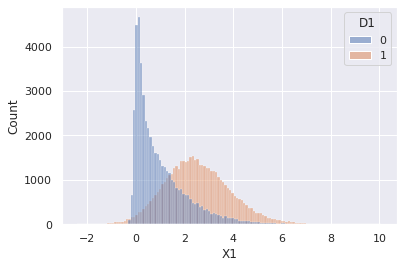

In [ ]:
sns.histplot(sim, x='X1', hue='D1')

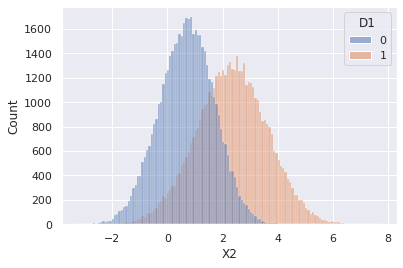

In [ ]:
sns.histplot(sim, x='X2', hue='D1',)

In [ ]:
sim.corr()

,X1,X2,D1,BAD,C1_L1,C1_L2,C1_L3,C2_L1,C2_L2,C2_L3,Amount
X1,1.000000,0.372749,0.525972,-0.368362,-0.434391,0.420437,0.124145,-0.433470,0.419193,0.125207,-0.001681
X2,0.372749,1.000000,0.582151,-0.389715,-0.001728,0.001771,-0.000184,-0.001601,0.001609,0.000047,-0.002449
D1,0.525972,0.582151,1.000000,-0.179612,0.053049,-0.049593,-0.027229,0.054087,-0.050540,-0.027584,-0.001508
BAD,-0.368362,-0.389715,-0.179612,1.000000,0.125881,-0.124500,-0.017634,0.124731,-0.123313,-0.017798,-0.002257
C1_L1,-0.434391,-0.001728,0.053049,0.125881,1.000000,-0.989606,-0.136095,0.922379,-0.911047,-0.137362,0.001170
C1_L2,0.420437,0.001771,-0.049593,-0.124500,-0.989606,1.000000,-0.007789,-0.911102,0.919108,0.005594,-0.001228
C1_L3,0.124145,-0.000184,-0.027229,-0.017634,-0.136095,-0.007789,1.000000,-0.137173,0.003220,0.916616,0.000326
C2_L1,-0.433470,-0.001601,0.054087,0.124731,0.922379,-0.911102,-0.137173,1.000000,-0.989260,-0.138451,0.001798
C2_L2,0.419193,0.001609,-0.050540,-0.123313,-0.911047,0.919108,0.003220,-0.989260,1.000000,-0.007797,-0.001718
C2_L3,0.125207,0.000047,-0.027584,-0.017798,-0.137362,0.005594,0.916616,-0.138451,-0.007797,1.000000,-0.000660


In [ ]:
#Percentage of unprivileged individuals
len(sim[sim.D1==1]) / len(sim)

0.50009

In [ ]:
#Default percentage privileged
def_perc_priv = len(sim[(sim.D1==1) & (sim.BAD==1)]) / len(sim[(sim.D1==1)]) * 100
print(f'{def_perc_priv:.2f}% of customers default in the privileged group')

15.00% of customers default in the privileged group


In [ ]:
#Default percentage unprivileged
def_perc_priv = len(sim[(sim.D1==0) & (sim.BAD==1)]) / len(sim[(sim.D1==0)]) * 100
print(f'{def_perc_priv:.2f}% of customers default in the unprivileged group')

30.00% of customers default in the unprivileged group


In [ ]:
#Disparate Impact in the original data

ratio_unpriv = len(sim.loc[(sim['BAD'] == 0) & (sim['D1'] == 0)]) / len(sim.loc[sim['D1'] == 0])
ratio_priv = len(sim.loc[(sim['BAD'] == 0) & (sim['D1'] == 1)]) / len(sim.loc[sim['D1'] == 1])
ratio = round((ratio_unpriv / ratio_priv),4)
print(f'Disparate Impact in the original data: {ratio}')

Disparate Impact in the original data: 0.8235


###Hyperparameter Tuning

Grid search to determine the models optimal capacity, learning rate and batch size.

In [ ]:
reset_random_seeds(seed=1)
s=1

def create_model(param):
  '''Builds the basic model with variables to be optimized. These variables include number of nodes in both hidden layers, learning rate and batch size.'''

  gain = 0 # No Penalty
  loss = 0 # No Penalty
  input = keras.Input(shape=(9,))
  priv = keras.Input(shape=(1,))
  x = layers.Dense(param['unit_1'], activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(input)
  x = layers.Dense(param['unit_2'], activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
  output = layers.Dense(1, activation="sigmoid", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
  model = keras.Model(inputs=[input, priv], outputs=output, name="model")
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=param['lr']), loss=CustomLoss(priv = priv), metrics = ['binary_crossentropy', tf.keras.metrics.AUC(name='auc')])
  return model

# Parameters to be tested
param_grid = {
  'unit_1': [10,15,20], 
  'unit_2': [10,15,20],
  'lr': [0.00005,0.0001], 
  'epochs': [100], 
  'batch_size': [64,128,256]
}

es = EarlyStopping(patience=10, verbose=1, monitor='val_auc', mode='max', restore_best_weights=True)

hypermodel = create_model

kgs = KerasGridSearch(hypermodel, param_grid, monitor='val_auc', greater_is_better=True, tuner_verbose=1)
kgs.search([X_train, priv_train], y_train, validation_data=([X_test, priv_test], y_test), callbacks=[es])

print(f"The best score was {kgs.best_score} with the following parameters:")
kgs.best_params


54 trials detected for ('unit_1', 'unit_2', 'lr', 'epochs', 'batch_size')

***** (1/54) *****
Search({'unit_1': 10, 'unit_2': 10, 'lr': 0.0001, 'epochs': 100, 'batch_size': 64})
Restoring model weights from the end of the best epoch: 31.
Epoch 41: early stopping
SCORE: 0.82209 at epoch 31

***** (2/54) *****
Search({'unit_1': 10, 'unit_2': 10, 'lr': 0.0001, 'epochs': 100, 'batch_size': 256})
Restoring model weights from the end of the best epoch: 35.
Epoch 45: early stopping
SCORE: 0.82187 at epoch 35

***** (3/54) *****
Search({'unit_1': 10, 'unit_2': 10, 'lr': 0.0001, 'epochs': 100, 'batch_size': 128})
Restoring model weights from the end of the best epoch: 37.
Epoch 47: early stopping
SCORE: 0.82203 at epoch 37

***** (4/54) *****
Search({'unit_1': 10, 'unit_2': 10, 'lr': 5e-05, 'epochs': 100, 'batch_size': 64})
Restoring model weights from the end of the best epoch: 35.
Epoch 45: early stopping
SCORE: 0.82206 at epoch 35

***** (5/54) *****
Search({'unit_1': 10, 'unit_2': 10, 'lr'

{'batch_size': 128,
 'epochs': 10,
 'lr': 0.0001,
 'steps_per_epoch': None,
 'unit_1': 10,
 'unit_2': 15}

The best score was 0.82233 with the following parameters:

{'batch_size': 128,

 'epochs': 10,

 'lr': 0.0001,

 'unit_1': 10,
 
 'unit_2': 15}

###Determining a static cutoff 

In [ ]:
# Generate predictions to then calculate the optimal cutoff

opt = tf.keras.optimizers.Adam(learning_rate=0.0001)

tau = 0
loss = 0
gain = 0

s = 1

reset_random_seeds(s)

input1 = keras.Input(shape=(9,))
priv = keras.Input(shape=(1,))
x = layers.Dense(10, activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(input1)
x = layers.Dense(15, activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
output = layers.Dense(1, activation="sigmoid", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
loop_model = keras.Model(inputs=[input1, priv], outputs=output, name="loop_model")

loop_model.compile(optimizer=opt, loss=CustomLoss(priv = priv), metrics = ['binary_crossentropy', tf.keras.metrics.AUC(name='auc')])

history = loop_model.fit(x=[X_train, priv_train], y=y_train, validation_data=([X_test, priv_test], y_test), epochs=50, batch_size = 128, callbacks=[])

loop_model_pred = loop_model.predict([X_test,priv_test])

del loop_model

Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 4s 36us/sample - loss: 147.5462 - binary_crossentropy: 147.5462 - auc: 0.6167 - val_loss: 0.7537 - val_binary_crossentropy: 0.7537 - val_auc: 0.7562
Epoch 2/50
108502/108502 [==============================] - 3s 31us/sample - loss: 0.5870 - binary_crossentropy: 0.5870 - auc: 0.7515 - val_loss: 0.4421 - val_binary_crossentropy: 0.4421 - val_auc: 0.8099
Epoch 3/50
108502/108502 [==============================] - 4s 33us/sample - loss: 0.5736 - binary_crossentropy: 0.5736 - auc: 0.7696 - val_loss: 0.5860 - val_binary_crossentropy: 0.5860 - val_auc: 0.8030
Epoch 4/50
108502/108502 [==============================] - 3s 27us/sample - loss: 0.5581 - binary_crossentropy: 0.5581 - auc: 0.7857 - val_loss: 0.4979 - val_binary_crossentropy: 0.4979 - val_auc: 0.8144
Epoch 5/50
108502/108502 [==============================] - 3s 32us/sample - loss: 0.5566 - binary_crossentropy: 0.5566 - auc

In [ ]:
# Calculate acceptance rates for 100 different cutoff values

acceptance = pd.DataFrame(columns = ['Cutoff','Acceptance Rate'])

items = np.arange(0.00, 1.01, 0.01)

for index, item in enumerate(items):
  ar = round(get_acceptance_rate(loop_model_pred, item),4)
  acceptance.loc[index,'Cutoff'] = round(item,2)
  acceptance.loc[index,'Acceptance Rate'] = ar

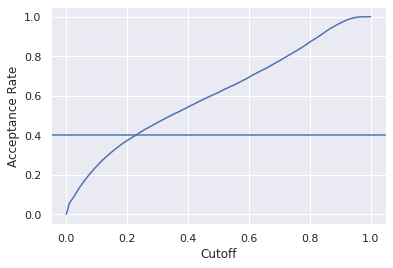

In [ ]:
graph = sns.lineplot(data=acceptance,x='Cutoff',y='Acceptance Rate')
graph.axhline(0.4)
graph.figure.savefig("Cutoff DIO SIM", dpi=300, bbox_inches='tight') 

In [ ]:
acceptance[(acceptance['Acceptance Rate'] < 0.45) & (acceptance['Acceptance Rate'] > 0.35)]

,Cutoff,Acceptance Rate
18,0.18,0.3528
19,0.19,0.3636
20,0.2,0.3743
21,0.21,0.3834
22,0.22,0.3932
23,0.23,0.402
24,0.24,0.4122
25,0.25,0.4221
26,0.26,0.4312
27,0.27,0.4393


As explained in the paper, the cutoff value is set to result in an acceptance rate of around 40% for the unconstrained model.

###Testing

####Time comparison

In [ ]:
opt = tf.keras.optimizers.Adam(learning_rate=0.0001)

tau = 0.23
loss = -0.272
gain = 0.136

s = 1

# Training and timing the unconstrained model
reset_random_seeds(s)
input1 = keras.Input(shape=(9,))
x = layers.Dense(10, activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(input1)
x = layers.Dense(15, activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
output = layers.Dense(1, activation="sigmoid", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
model = keras.Model(inputs=input1, outputs=output, name="model")

model.compile(optimizer=opt, loss=tf.keras.losses.BinaryCrossentropy() , metrics = ['binary_crossentropy', tf.keras.metrics.AUC(name='auc')])

start = time.time()
history = model.fit(x=[X_train, priv_train], y=y_train, validation_data=([X_test, priv_test], y_test), epochs=50, batch_size = 128, callbacks=[], verbose=0)
stop = time.time()

del model

time_unconstrained = stop - start
print(f"Training time unconstrained: {time_unconstrained:.2f}s")

# Training and timing the constrained model
reset_random_seeds(s)
input1 = keras.Input(shape=(9,))
priv = keras.Input(shape=(1,))
x = layers.Dense(10, activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(input1)
x = layers.Dense(15, activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
output = layers.Dense(1, activation="sigmoid", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
model = keras.Model(inputs=[input1, priv], outputs=output, name="model")

model.compile(optimizer=opt, loss=CustomLoss(priv = priv), metrics = ['binary_crossentropy', tf.keras.metrics.AUC(name='auc')])

start = time.time()
history = model.fit(x=[X_train, priv_train], y=y_train, validation_data=([X_test, priv_test], y_test), epochs=50, batch_size = 128, callbacks=[], verbose=0)
stop = time.time()

del model

time_constrained = stop - start
print(f"Training time constrained: {time_constrained:.2f}s")

Training time unconstrained: 108.20s
Training time constrained: 117.63s


In [ ]:
time_constrained / time_unconstrained

1.087158176809603

####Range: 0 - 100
####Interval: 1

The full range is split into smaller sections, to optimize the performance when using Google Colab. Due to it being designed for interactive use, notebooks with cells that run for too long will experience a significant decrease in allocated computational capacity. Thus, reconecting after each of these cells will decrease the overall runtime.

In [ ]:
# Set the cutoff value as previously defined
tau = 0.23

In [ ]:
dio_metrics_sim_1 = rep_test_loop(lower_bound=0,upper_bound=11,interval=1,input_features=9,num_hid_units_1=10,num_hid_units_2=15,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 0.0
The current loss parameter is: -0.0
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 3s 31us/sample - loss: 147.5462 - binary_crossentropy: 147.5462 - val_auc: 0.6167 - val_loss: 0.7537 - val_binary_crossentropy: 0.7537 - val_val_auc: 0.7562
Epoch 2/50
108502/108502 [==============================] - 4s 36us/sample - loss: 0.5870 - binary_crossentropy: 0.5870 - val_auc: 0.7515 - val_loss: 0.4421 - val_binary_crossentropy: 0.4421 - val_val_auc: 0.8099
Epoch 3/50
108502/108502 [==============================] - 5s 42us/sample - loss: 0.5736 - binary_crossentropy: 0.5736 - val_auc: 0.7696 - val_loss: 0.5860 - val_binary_crossentropy: 0.5860 - val_val_auc: 0.8030
Epoch 4/50
108502/108502 [==============================] - 5s 42us/sample - loss: 0.5581 - binary_crossentropy: 0.5581 - val_auc: 0.7857 - val_loss: 0.4979 - val_binary_crossentropy: 0.4979 - val_val_auc: 0.814

1it [10:40, 640.18s/it]

Penalty Weight                                             0
AUC                                                 0.821016
MSE                                                 0.155699
BCE                                                  0.85381
Profit                                        2460611.371077
Profit Per Euro                                     0.011708
DI Difference                                            NaN
Mean DI Privileged                                       NaN
Mean DI Unprivileged                                     NaN
Disparate Impact                                    0.201457
Average Odds Difference (Separation)                0.495885
Predictive Parity Difference (Sufficiency)          0.001329
Acceptance Rate                                      0.45468
Name: 0, dtype: object

The current gain parameter is: 0.136
The current loss parameter is: -0.272
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [========

2it [21:47, 656.21s/it]

Penalty Weight                                             1
AUC                                                 0.821073
MSE                                                 0.155626
BCE                                                 0.853406
Profit                                        2385062.794016
Profit Per Euro                                     0.011349
DI Difference                                       0.211793
Mean DI Privileged                                  0.286127
Mean DI Unprivileged                                0.074333
Disparate Impact                                    0.199999
Average Odds Difference (Separation)                0.495904
Predictive Parity Difference (Sufficiency)          0.001406
Acceptance Rate                                       0.4538
Name: 1, dtype: object

The current gain parameter is: 0.272
The current loss parameter is: -0.544
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [========

3it [33:38, 681.32s/it]

Penalty Weight                                             2
AUC                                                  0.82111
MSE                                                 0.155633
BCE                                                 0.853432
Profit                                        2305734.901056
Profit Per Euro                                     0.010971
DI Difference                                       0.212113
Mean DI Privileged                                  0.286033
Mean DI Unprivileged                                 0.07392
Disparate Impact                                    0.199211
Average Odds Difference (Separation)                0.495717
Predictive Parity Difference (Sufficiency)          0.001261
Acceptance Rate                                     0.453033
Name: 2, dtype: object

The current gain parameter is: 0.40800000000000003
The current loss parameter is: -0.8160000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1

4it [46:16, 711.61s/it]

Penalty Weight                                             3
AUC                                                 0.821126
MSE                                                 0.155521
BCE                                                 0.853373
Profit                                        2316655.812826
Profit Per Euro                                     0.011023
DI Difference                                       0.212447
Mean DI Privileged                                  0.286233
Mean DI Unprivileged                                0.073787
Disparate Impact                                    0.198627
Average Odds Difference (Separation)                0.496428
Predictive Parity Difference (Sufficiency)          0.000886
Acceptance Rate                                      0.45306
Name: 3, dtype: object

The current gain parameter is: 0.544
The current loss parameter is: -1.088
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [========

5it [1:00:25, 761.08s/it]

Penalty Weight                                            4
AUC                                                0.821185
MSE                                                0.155594
BCE                                                 0.85325
Profit                                        2212562.48518
Profit Per Euro                                    0.010528
DI Difference                                       0.21334
Mean DI Privileged                                 0.286467
Mean DI Unprivileged                               0.073127
Disparate Impact                                   0.197272
Average Odds Difference (Separation)               0.495594
Predictive Parity Difference (Sufficiency)         0.001078
Acceptance Rate                                    0.451873
Name: 4, dtype: object

The current gain parameter is: 0.68
The current loss parameter is: -1.36
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=======================

6it [1:15:38, 812.69s/it]

Penalty Weight                                             5
AUC                                                 0.821172
MSE                                                 0.155455
BCE                                                 0.853448
Profit                                        2293012.258139
Profit Per Euro                                     0.010911
DI Difference                                        0.21328
Mean DI Privileged                                   0.28666
Mean DI Unprivileged                                 0.07338
Disparate Impact                                    0.197606
Average Odds Difference (Separation)                0.496585
Predictive Parity Difference (Sufficiency)          0.001515
Acceptance Rate                                       0.4527
Name: 5, dtype: object

The current gain parameter is: 0.8160000000000001
The current loss parameter is: -1.6320000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/

7it [1:32:10, 871.23s/it]

Penalty Weight                                             6
AUC                                                 0.821229
MSE                                                 0.155726
BCE                                                 0.853756
Profit                                        2121164.404272
Profit Per Euro                                     0.010093
DI Difference                                       0.214087
Mean DI Privileged                                  0.286593
Mean DI Unprivileged                                0.072507
Disparate Impact                                    0.195754
Average Odds Difference (Separation)                0.495475
Predictive Parity Difference (Sufficiency)          0.001853
Acceptance Rate                                      0.45082
Name: 6, dtype: object

The current gain parameter is: 0.9520000000000001
The current loss parameter is: -1.9040000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/

8it [1:49:51, 931.77s/it]

Penalty Weight                                             7
AUC                                                 0.821203
MSE                                                  0.15558
BCE                                                 0.853942
Profit                                        2208044.377328
Profit Per Euro                                     0.010506
DI Difference                                       0.213847
Mean DI Privileged                                  0.286767
Mean DI Unprivileged                                 0.07292
Disparate Impact                                    0.196816
Average Odds Difference (Separation)                0.495452
Predictive Parity Difference (Sufficiency)          0.001416
Acceptance Rate                                     0.451667
Name: 7, dtype: object

The current gain parameter is: 1.088
The current loss parameter is: -2.176
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [========

9it [2:09:06, 1001.45s/it]

Penalty Weight                                             8
AUC                                                 0.821268
MSE                                                 0.155842
BCE                                                 0.854183
Profit                                        2030456.109114
Profit Per Euro                                     0.009661
DI Difference                                       0.214587
Mean DI Privileged                                  0.286633
Mean DI Unprivileged                                0.072047
Disparate Impact                                    0.194768
Average Odds Difference (Separation)                0.494982
Predictive Parity Difference (Sufficiency)          0.001745
Acceptance Rate                                      0.44986
Name: 8, dtype: object

The current gain parameter is: 1.2240000000000002
The current loss parameter is: -2.4480000000000004
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/

10it [2:29:42, 1074.02s/it]

Penalty Weight                                             9
AUC                                                 0.821342
MSE                                                 0.156168
BCE                                                 0.854315
Profit                                        1834718.655854
Profit Per Euro                                      0.00873
DI Difference                                       0.215213
Mean DI Privileged                                   0.28636
Mean DI Unprivileged                                0.071147
Disparate Impact                                    0.193099
Average Odds Difference (Separation)                0.493954
Predictive Parity Difference (Sufficiency)           0.00191
Acceptance Rate                                     0.448047
Name: 9, dtype: object

The current gain parameter is: 1.36
The current loss parameter is: -2.72
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==========

11it [2:52:04, 938.62s/it] 

Penalty Weight                                            10
AUC                                                  0.82136
MSE                                                 0.156152
BCE                                                 0.854335
Profit                                        1809262.789443
Profit Per Euro                                     0.008609
DI Difference                                       0.215353
Mean DI Privileged                                  0.286327
Mean DI Unprivileged                                0.070973
Disparate Impact                                    0.192586
Average Odds Difference (Separation)                0.494348
Predictive Parity Difference (Sufficiency)          0.001818
Acceptance Rate                                       0.4478
Name: 10, dtype: object


In [ ]:
dio_metrics_sim_1.to_csv('dio_metrics_sim_1.csv')

In [ ]:
dio_metrics_sim_2 = rep_test_loop(lower_bound=11,upper_bound=21,interval=1,input_features=9,num_hid_units_1=10,num_hid_units_2=15,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 1.36
The current loss parameter is: -2.72
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 2s 22us/sample - loss: 147.5348 - binary_crossentropy: 147.5475 - val_auc: 0.6179 - val_loss: 0.7641 - val_binary_crossentropy: 0.7876 - val_val_auc: 0.7532
Epoch 2/50
108502/108502 [==============================] - 3s 31us/sample - loss: 0.5627 - binary_crossentropy: 0.5876 - val_auc: 0.7506 - val_loss: 0.3230 - val_binary_crossentropy: 0.4417 - val_val_auc: 0.8104
Epoch 3/50
108502/108502 [==============================] - 4s 34us/sample - loss: 0.5404 - binary_crossentropy: 0.5686 - val_auc: 0.7736 - val_loss: 0.4621 - val_binary_crossentropy: 0.5166 - val_val_auc: 0.8098
Epoch 4/50
108502/108502 [==============================] - 4s 33us/sample - loss: 0.5293 - binary_crossentropy: 0.5588 - val_auc: 0.7853 - val_loss: 0.4547 - val_binary_crossentropy: 0.5143 - val_val_auc: 0.8

1it [10:07, 607.32s/it]

Penalty Weight                                            10
AUC                                                 0.821358
MSE                                                 0.156273
BCE                                                 0.854707
Profit                                        1790048.267233
Profit Per Euro                                     0.008517
DI Difference                                        0.21536
Mean DI Privileged                                  0.286287
Mean DI Unprivileged                                0.070927
Disparate Impact                                    0.192537
Average Odds Difference (Separation)                0.493952
Predictive Parity Difference (Sufficiency)          0.001714
Acceptance Rate                                     0.447573
Name: 0, dtype: object

The current gain parameter is: 1.496
The current loss parameter is: -2.992
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [========

2it [20:33, 618.52s/it]

Penalty Weight                                            11
AUC                                                 0.821291
MSE                                                 0.155814
BCE                                                 0.854475
Profit                                        1996104.855467
Profit Per Euro                                     0.009498
DI Difference                                        0.21518
Mean DI Privileged                                  0.286827
Mean DI Unprivileged                                0.071647
Disparate Impact                                    0.193843
Average Odds Difference (Separation)                0.495368
Predictive Parity Difference (Sufficiency)          0.002042
Acceptance Rate                                     0.449513
Name: 1, dtype: object

The current gain parameter is: 1.6320000000000001
The current loss parameter is: -3.2640000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/

3it [32:02, 650.54s/it]

Penalty Weight                                            12
AUC                                                 0.821297
MSE                                                 0.155873
BCE                                                 0.854809
Profit                                        1992643.106217
Profit Per Euro                                     0.009481
DI Difference                                       0.215233
Mean DI Privileged                                  0.286853
Mean DI Unprivileged                                 0.07162
Disparate Impact                                    0.193817
Average Odds Difference (Separation)                0.495318
Predictive Parity Difference (Sufficiency)          0.002624
Acceptance Rate                                     0.449473
Name: 2, dtype: object

The current gain parameter is: 1.7680000000000002
The current loss parameter is: -3.5360000000000005
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/

4it [44:15, 683.23s/it]

Penalty Weight                                            13
AUC                                                 0.821257
MSE                                                 0.156812
BCE                                                 0.857045
Profit                                        1736098.385533
Profit Per Euro                                     0.008261
DI Difference                                       0.214713
Mean DI Privileged                                  0.285713
Mean DI Unprivileged                                   0.071
Disparate Impact                                    0.192983
Average Odds Difference (Separation)                0.492617
Predictive Parity Difference (Sufficiency)          0.001973
Acceptance Rate                                     0.446953
Name: 3, dtype: object

The current gain parameter is: 1.9040000000000001
The current loss parameter is: -3.8080000000000003
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/

5it [57:50, 730.72s/it]

Penalty Weight                                            14
AUC                                                 0.821284
MSE                                                 0.156793
BCE                                                 0.856946
Profit                                        1725943.496532
Profit Per Euro                                     0.008212
DI Difference                                       0.215087
Mean DI Privileged                                  0.285913
Mean DI Unprivileged                                0.070827
Disparate Impact                                    0.192526
Average Odds Difference (Separation)                0.492726
Predictive Parity Difference (Sufficiency)          0.001984
Acceptance Rate                                      0.44682
Name: 4, dtype: object

The current gain parameter is: 2.04
The current loss parameter is: -4.08
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==========

6it [1:11:54, 769.20s/it]

Penalty Weight                                            15
AUC                                                 0.821273
MSE                                                  0.15714
BCE                                                 0.857958
Profit                                        1635806.963802
Profit Per Euro                                     0.007783
DI Difference                                       0.214807
Mean DI Privileged                                  0.285427
Mean DI Unprivileged                                 0.07062
Disparate Impact                                    0.192232
Average Odds Difference (Separation)                0.492001
Predictive Parity Difference (Sufficiency)            0.0017
Acceptance Rate                                     0.445907
Name: 5, dtype: object

The current gain parameter is: 2.176
The current loss parameter is: -4.352
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [========

7it [1:27:41, 827.29s/it]

Penalty Weight                                            16
AUC                                                 0.821289
MSE                                                 0.157511
BCE                                                 0.858735
Profit                                        1499630.366626
Profit Per Euro                                     0.007136
DI Difference                                        0.21496
Mean DI Privileged                                  0.285047
Mean DI Unprivileged                                0.070087
Disparate Impact                                    0.191259
Average Odds Difference (Separation)                0.491194
Predictive Parity Difference (Sufficiency)          0.001645
Acceptance Rate                                     0.444613
Name: 6, dtype: object

The current gain parameter is: 2.3120000000000003
The current loss parameter is: -4.6240000000000006
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/

8it [1:44:11, 878.98s/it]

Penalty Weight                                            17
AUC                                                 0.821316
MSE                                                 0.157803
BCE                                                 0.859279
Profit                                        1395326.808475
Profit Per Euro                                     0.006639
DI Difference                                       0.215067
Mean DI Privileged                                   0.28478
Mean DI Unprivileged                                0.069713
Disparate Impact                                    0.190655
Average Odds Difference (Separation)                0.490153
Predictive Parity Difference (Sufficiency)           0.00134
Acceptance Rate                                     0.443513
Name: 7, dtype: object

The current gain parameter is: 2.4480000000000004
The current loss parameter is: -4.896000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/5

9it [2:01:55, 936.88s/it]

Penalty Weight                                            18
AUC                                                 0.821378
MSE                                                 0.158179
BCE                                                 0.859681
Profit                                        1165162.658251
Profit Per Euro                                     0.005544
DI Difference                                       0.215627
Mean DI Privileged                                   0.28428
Mean DI Unprivileged                                0.068653
Disparate Impact                                    0.188709
Average Odds Difference (Separation)                0.488952
Predictive Parity Difference (Sufficiency)          0.001301
Acceptance Rate                                     0.441233
Name: 8, dtype: object

The current gain parameter is: 2.584
The current loss parameter is: -5.168
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [========

10it [2:20:37, 994.21s/it]

Penalty Weight                                            19
AUC                                                  0.82138
MSE                                                 0.158526
BCE                                                 0.860337
Profit                                        1074130.174667
Profit Per Euro                                     0.005111
DI Difference                                       0.215607
Mean DI Privileged                                  0.284007
Mean DI Unprivileged                                  0.0684
Disparate Impact                                    0.188301
Average Odds Difference (Separation)                 0.48773
Predictive Parity Difference (Sufficiency)          0.001707
Acceptance Rate                                     0.440247
Name: 9, dtype: object

The current gain parameter is: 2.72
The current loss parameter is: -5.44
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==========

11it [2:41:03, 878.49s/it] 

Penalty Weight                                            20
AUC                                                 0.821351
MSE                                                  0.15813
BCE                                                 0.860189
Profit                                        1247716.087784
Profit Per Euro                                     0.005937
DI Difference                                       0.215513
Mean DI Privileged                                  0.284507
Mean DI Unprivileged                                0.068993
Disparate Impact                                    0.189342
Average Odds Difference (Separation)                0.489281
Predictive Parity Difference (Sufficiency)          0.001622
Acceptance Rate                                      0.44202
Name: 10, dtype: object


In [ ]:
dio_metrics_sim_2.to_csv('dio_metrics_sim_2.csv')

In [ ]:
dio_metrics_sim_3 = rep_test_loop(lower_bound=21,upper_bound=31,interval=1,input_features=9,num_hid_units_1=10,num_hid_units_2=15,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 2.8560000000000003
The current loss parameter is: -5.712000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 4s 36us/sample - loss: 147.5249 - binary_crossentropy: 147.5510 - val_auc: 0.6180 - val_loss: 0.6486 - val_binary_crossentropy: 0.7108 - val_val_auc: 0.7619
Epoch 2/50
108502/108502 [==============================] - 4s 33us/sample - loss: 0.5369 - binary_crossentropy: 0.5897 - val_auc: 0.7484 - val_loss: 0.2014 - val_binary_crossentropy: 0.4429 - val_val_auc: 0.8110
Epoch 3/50
108502/108502 [==============================] - 3s 32us/sample - loss: 0.5181 - binary_crossentropy: 0.5743 - val_auc: 0.7689 - val_loss: 0.4271 - val_binary_crossentropy: 0.5335 - val_val_auc: 0.8083
Epoch 4/50
108502/108502 [==============================] - 3s 31us/sample - loss: 0.5000 - binary_crossentropy: 0.5609 - val_auc: 0.7847 - val_loss: 0.3522 - val_binary_crossentropy

1it [10:46, 646.76s/it]

Penalty Weight                                           21
AUC                                                0.821426
MSE                                                0.158902
BCE                                                0.861293
Profit                                        884856.979982
Profit Per Euro                                     0.00421
DI Difference                                      0.216147
Mean DI Privileged                                 0.283673
Mean DI Unprivileged                               0.067527
Disparate Impact                                   0.186619
Average Odds Difference (Separation)               0.486694
Predictive Parity Difference (Sufficiency)         0.001831
Acceptance Rate                                      0.4384
Name: 0, dtype: object

The current gain parameter is: 2.992
The current loss parameter is: -5.984
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=====================

2it [22:24, 676.80s/it]

Penalty Weight                                            22
AUC                                                 0.821389
MSE                                                  0.15858
BCE                                                 0.861446
Profit                                        1047814.238385
Profit Per Euro                                     0.004986
DI Difference                                         0.2159
Mean DI Privileged                                   0.28404
Mean DI Unprivileged                                 0.06814
Disparate Impact                                    0.187729
Average Odds Difference (Separation)                0.487965
Predictive Parity Difference (Sufficiency)          0.001471
Acceptance Rate                                      0.43996
Name: 1, dtype: object

The current gain parameter is: 3.128
The current loss parameter is: -6.256
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [========

3it [35:28, 725.90s/it]

Penalty Weight                                        23
AUC                                             0.821374
MSE                                             0.159253
BCE                                             0.863016
Profit                                        845659.411
Profit Per Euro                                 0.004024
DI Difference                                    0.21582
Mean DI Privileged                              0.283347
Mean DI Unprivileged                            0.067527
Disparate Impact                                0.186776
Average Odds Difference (Separation)            0.485896
Predictive Parity Difference (Sufficiency)      0.001402
Acceptance Rate                                 0.437933
Name: 2, dtype: object

The current gain parameter is: 3.2640000000000002
The current loss parameter is: -6.5280000000000005
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 

4it [49:39, 775.08s/it]

Penalty Weight                                           24
AUC                                                0.821396
MSE                                                0.159674
BCE                                                0.863909
Profit                                        679124.482532
Profit Per Euro                                    0.003231
DI Difference                                      0.215853
Mean DI Privileged                                  0.28276
Mean DI Unprivileged                               0.066907
Disparate Impact                                   0.185601
Average Odds Difference (Separation)               0.485131
Predictive Parity Difference (Sufficiency)         0.001726
Acceptance Rate                                    0.436367
Name: 3, dtype: object

The current gain parameter is: 3.4000000000000004
The current loss parameter is: -6.800000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/1085

5it [1:04:56, 826.21s/it]

Penalty Weight                                           25
AUC                                                0.821432
MSE                                                 0.15941
BCE                                                   0.863
Profit                                        711760.126063
Profit Per Euro                                    0.003387
DI Difference                                      0.216447
Mean DI Privileged                                   0.2832
Mean DI Unprivileged                               0.066753
Disparate Impact                                   0.185064
Average Odds Difference (Separation)               0.485985
Predictive Parity Difference (Sufficiency)         0.001457
Acceptance Rate                                    0.436693
Name: 4, dtype: object

The current gain parameter is: 3.5360000000000005
The current loss parameter is: -7.072000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/1085

6it [1:22:17, 899.41s/it]

Penalty Weight                                           26
AUC                                                0.821441
MSE                                                0.159925
BCE                                                0.864135
Profit                                        564837.471786
Profit Per Euro                                    0.002688
DI Difference                                       0.21644
Mean DI Privileged                                 0.282747
Mean DI Unprivileged                               0.066307
Disparate Impact                                   0.184422
Average Odds Difference (Separation)               0.484195
Predictive Parity Difference (Sufficiency)         0.001775
Acceptance Rate                                    0.435153
Name: 5, dtype: object

The current gain parameter is: 3.672
The current loss parameter is: -7.344
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=====================

7it [1:40:32, 963.19s/it]

Penalty Weight                                           27
AUC                                                0.821423
MSE                                                0.160017
BCE                                                0.864784
Profit                                        565311.249315
Profit Per Euro                                     0.00269
DI Difference                                        0.2162
Mean DI Privileged                                  0.28264
Mean DI Unprivileged                                0.06644
Disparate Impact                                   0.184684
Average Odds Difference (Separation)               0.483784
Predictive Parity Difference (Sufficiency)         0.002197
Acceptance Rate                                     0.43508
Name: 6, dtype: object

The current gain parameter is: 3.8080000000000003
The current loss parameter is: -7.6160000000000005
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108

8it [2:01:48, 1062.93s/it]

Penalty Weight                                          28
AUC                                                0.82142
MSE                                               0.160009
BCE                                               0.865139
Profit                                        540563.16007
Profit Per Euro                                   0.002572
DI Difference                                      0.21596
Mean DI Privileged                                 0.28242
Mean DI Unprivileged                               0.06646
Disparate Impact                                  0.184865
Average Odds Difference (Separation)              0.483895
Predictive Parity Difference (Sufficiency)        0.001616
Acceptance Rate                                    0.43498
Name: 7, dtype: object

The current gain parameter is: 3.9440000000000004
The current loss parameter is: -7.888000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=========

9it [2:24:43, 1160.35s/it]

Penalty Weight                                          29
AUC                                               0.821477
MSE                                               0.160502
BCE                                               0.865879
Profit                                        350018.24245
Profit Per Euro                                   0.001665
DI Difference                                     0.217107
Mean DI Privileged                                0.282547
Mean DI Unprivileged                               0.06544
Disparate Impact                                  0.182715
Average Odds Difference (Separation)              0.481553
Predictive Parity Difference (Sufficiency)        0.002384
Acceptance Rate                                   0.432687
Name: 8, dtype: object

The current gain parameter is: 4.08
The current loss parameter is: -8.16
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 7s

10it [2:50:28, 1022.85s/it]

Penalty Weight                                          30
AUC                                               0.821454
MSE                                               0.161236
BCE                                               0.867239
Profit                                        156908.44708
Profit Per Euro                                   0.000747
DI Difference                                     0.216867
Mean DI Privileged                                0.281813
Mean DI Unprivileged                              0.064947
Disparate Impact                                   0.18199
Average Odds Difference (Separation)               0.47889
Predictive Parity Difference (Sufficiency)        0.002145
Acceptance Rate                                    0.43058
Name: 9, dtype: object


In [ ]:
dio_metrics_sim_3.to_csv('dio_metrics_sim_3.csv')

In [ ]:
dio_metrics_sim_4 = rep_test_loop(lower_bound=31,upper_bound=41,interval=1,input_features=9,num_hid_units_1=10,num_hid_units_2=15,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 4.216
The current loss parameter is: -8.432
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 11s 98us/sample - loss: 147.5264 - binary_crossentropy: 147.5643 - val_auc: 0.6142 - val_loss: 0.5824 - val_binary_crossentropy: 0.6816 - val_val_auc: 0.7656
Epoch 2/50
108502/108502 [==============================] - 4s 36us/sample - loss: 0.5110 - binary_crossentropy: 0.5884 - val_auc: 0.7503 - val_loss: 0.1803 - val_binary_crossentropy: 0.4567 - val_val_auc: 0.8107
Epoch 3/50
108502/108502 [==============================] - 4s 33us/sample - loss: 0.5173 - binary_crossentropy: 0.5902 - val_auc: 0.7602 - val_loss: 0.2891 - val_binary_crossentropy: 0.4907 - val_val_auc: 0.8126
Epoch 4/50
108502/108502 [==============================] - 2s 22us/sample - loss: 0.4659 - binary_crossentropy: 0.5596 - val_auc: 0.7847 - val_loss: 0.3822 - val_binary_crossentropy: 0.5441 - val_val_auc: 

1it [12:53, 773.86s/it]

Penalty Weight                                         31
AUC                                              0.821462
MSE                                              0.161974
BCE                                                 0.869
Profit                                       -33001.10158
Profit Per Euro                                 -0.000157
DI Difference                                    0.216873
Mean DI Privileged                               0.281213
Mean DI Unprivileged                              0.06434
Disparate Impact                                 0.180979
Average Odds Difference (Separation)               0.4772
Predictive Parity Difference (Sufficiency)       0.002658
Acceptance Rate                                  0.428713
Name: 0, dtype: object

The current gain parameter is: 4.352
The current loss parameter is: -8.704
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 3s 26us/sampl

2it [26:05, 784.07s/it]

Penalty Weight                                           32
AUC                                                0.821386
MSE                                                 0.16166
BCE                                                 0.86926
Profit                                        112985.456483
Profit Per Euro                                    0.000538
DI Difference                                      0.216213
Mean DI Privileged                                 0.281313
Mean DI Unprivileged                                 0.0651
Disparate Impact                                   0.182839
Average Odds Difference (Separation)               0.477586
Predictive Parity Difference (Sufficiency)         0.001933
Acceptance Rate                                    0.430133
Name: 1, dtype: object

The current gain parameter is: 4.488
The current loss parameter is: -8.976
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=====================

3it [39:46, 800.98s/it]

Penalty Weight                                           33
AUC                                                0.821462
MSE                                                0.161157
BCE                                                0.868016
Profit                                        155393.872039
Profit Per Euro                                    0.000739
DI Difference                                      0.217287
Mean DI Privileged                                 0.282027
Mean DI Unprivileged                                0.06474
Disparate Impact                                   0.181551
Average Odds Difference (Separation)               0.479021
Predictive Parity Difference (Sufficiency)         0.001957
Acceptance Rate                                    0.430447
Name: 2, dtype: object

The current gain parameter is: 4.6240000000000006
The current loss parameter is: -9.248000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/1085

4it [54:01, 822.32s/it]

Penalty Weight                                          34
AUC                                               0.821463
MSE                                               0.161644
BCE                                               0.869163
Profit                                        27126.668358
Profit Per Euro                                   0.000129
DI Difference                                     0.217473
Mean DI Privileged                                0.281753
Mean DI Unprivileged                               0.06428
Disparate Impact                                  0.180559
Average Odds Difference (Separation)               0.47796
Predictive Parity Difference (Sufficiency)        0.002329
Acceptance Rate                                   0.429173
Name: 3, dtype: object

The current gain parameter is: 4.760000000000001
The current loss parameter is: -9.520000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==========

5it [1:08:47, 845.31s/it]

Penalty Weight                                           35
AUC                                                0.821497
MSE                                                0.161948
BCE                                                0.869315
Profit                                       -108615.520909
Profit Per Euro                                   -0.000517
DI Difference                                      0.217747
Mean DI Privileged                                 0.281533
Mean DI Unprivileged                               0.063787
Disparate Impact                                   0.179659
Average Odds Difference (Separation)               0.476297
Predictive Parity Difference (Sufficiency)         0.002521
Acceptance Rate                                     0.42768
Name: 4, dtype: object

The current gain parameter is: 4.896000000000001
The current loss parameter is: -9.792000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/10850

6it [1:24:05, 869.95s/it]

Penalty Weight                                          36
AUC                                               0.821474
MSE                                               0.161837
BCE                                               0.869408
Profit                                       -63169.136389
Profit Per Euro                                  -0.000301
DI Difference                                      0.21762
Mean DI Privileged                                 0.28156
Mean DI Unprivileged                               0.06394
Disparate Impact                                  0.179875
Average Odds Difference (Separation)              0.476999
Predictive Parity Difference (Sufficiency)        0.001814
Acceptance Rate                                    0.42816
Name: 5, dtype: object

The current gain parameter is: 5.032
The current loss parameter is: -10.064
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] -

7it [1:40:00, 897.94s/it]

Penalty Weight                                           37
AUC                                                0.821459
MSE                                                0.162273
BCE                                                0.870651
Profit                                       -163440.262601
Profit Per Euro                                   -0.000778
DI Difference                                      0.217213
Mean DI Privileged                                 0.281067
Mean DI Unprivileged                               0.063853
Disparate Impact                                   0.180128
Average Odds Difference (Separation)               0.475001
Predictive Parity Difference (Sufficiency)         0.002002
Acceptance Rate                                     0.42706
Name: 6, dtype: object

The current gain parameter is: 5.168
The current loss parameter is: -10.336
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [====================

8it [1:56:30, 927.07s/it]

Penalty Weight                                           38
AUC                                                0.821456
MSE                                                 0.16132
BCE                                                0.869735
Profit                                        142348.403649
Profit Per Euro                                    0.000677
DI Difference                                      0.216873
Mean DI Privileged                                 0.281747
Mean DI Unprivileged                               0.064873
Disparate Impact                                    0.18205
Average Odds Difference (Separation)                0.47925
Predictive Parity Difference (Sufficiency)         0.002222
Acceptance Rate                                     0.43062
Name: 7, dtype: object

The current gain parameter is: 5.304
The current loss parameter is: -10.608
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [====================

9it [2:13:35, 957.93s/it]

Penalty Weight                                         39
AUC                                              0.821546
MSE                                              0.161466
BCE                                              0.868962
Profit                                       -12286.57225
Profit Per Euro                                 -0.000058
DI Difference                                    0.218407
Mean DI Privileged                                0.28224
Mean DI Unprivileged                             0.063833
Disparate Impact                                 0.179558
Average Odds Difference (Separation)             0.477746
Predictive Parity Difference (Sufficiency)       0.003293
Acceptance Rate                                  0.428733
Name: 8, dtype: object

The current gain parameter is: 5.44
The current loss parameter is: -10.88
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 5s 43us/sample

10it [2:31:14, 907.43s/it]

Penalty Weight                                         40
AUC                                              0.821546
MSE                                              0.161393
BCE                                              0.868686
Profit                                       -1976.248811
Profit Per Euro                                 -0.000009
DI Difference                                    0.218353
Mean DI Privileged                               0.282227
Mean DI Unprivileged                             0.063873
Disparate Impact                                  0.17944
Average Odds Difference (Separation)             0.478332
Predictive Parity Difference (Sufficiency)       0.003028
Acceptance Rate                                   0.42888
Name: 9, dtype: object


In [ ]:
dio_metrics_sim_4.to_csv('dio_metrics_sim_4.csv')

In [ ]:
dio_metrics_sim_5 = rep_test_loop(lower_bound=41,upper_bound=51,interval=1,input_features=9,num_hid_units_1=10,num_hid_units_2=15,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 5.5760000000000005
The current loss parameter is: -11.152000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 2s 19us/sample - loss: 147.5406 - binary_crossentropy: 147.5812 - val_auc: 0.6109 - val_loss: 0.5060 - val_binary_crossentropy: 0.6469 - val_val_auc: 0.7700
Epoch 2/50
108502/108502 [==============================] - 2s 14us/sample - loss: 0.4945 - binary_crossentropy: 0.5927 - val_auc: 0.7478 - val_loss: 0.1445 - val_binary_crossentropy: 0.4655 - val_val_auc: 0.8100
Epoch 3/50
108502/108502 [==============================] - 2s 15us/sample - loss: 0.4735 - binary_crossentropy: 0.5846 - val_auc: 0.7623 - val_loss: 0.3463 - val_binary_crossentropy: 0.5455 - val_val_auc: 0.8074
Epoch 4/50
108502/108502 [==============================] - 2s 15us/sample - loss: 0.4613 - binary_crossentropy: 0.5719 - val_auc: 0.7775 - val_loss: 0.9510 - val_binary_crossentrop

1it [09:46, 586.95s/it]

Penalty Weight                                          41
AUC                                               0.821553
MSE                                               0.164468
BCE                                               0.874529
Profit                                       -850706.26828
Profit Per Euro                                  -0.004048
DI Difference                                       0.2183
Mean DI Privileged                                0.279627
Mean DI Unprivileged                              0.061327
Disparate Impact                                   0.17516
Average Odds Difference (Separation)              0.468106
Predictive Parity Difference (Sufficiency)        0.002652
Acceptance Rate                                   0.419913
Name: 0, dtype: object

The current gain parameter is: 5.712000000000001
The current loss parameter is: -11.424000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=========

2it [20:36, 623.56s/it]

Penalty Weight                                           42
AUC                                                0.821561
MSE                                                0.164482
BCE                                                0.875349
Profit                                       -792270.490234
Profit Per Euro                                    -0.00377
DI Difference                                      0.218553
Mean DI Privileged                                 0.280087
Mean DI Unprivileged                               0.061533
Disparate Impact                                    0.17539
Average Odds Difference (Separation)               0.468253
Predictive Parity Difference (Sufficiency)         0.002221
Acceptance Rate                                     0.42048
Name: 1, dtype: object

The current gain parameter is: 5.848000000000001
The current loss parameter is: -11.696000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/1085

3it [32:09, 655.47s/it]

Penalty Weight                                           43
AUC                                                0.821567
MSE                                                0.160668
BCE                                                0.867742
Profit                                        179784.277471
Profit Per Euro                                    0.000855
DI Difference                                      0.218387
Mean DI Privileged                                 0.282887
Mean DI Unprivileged                                 0.0645
Disparate Impact                                   0.180511
Average Odds Difference (Separation)               0.480064
Predictive Parity Difference (Sufficiency)          0.00243
Acceptance Rate                                    0.430827
Name: 2, dtype: object

The current gain parameter is: 5.984
The current loss parameter is: -11.968
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [====================

4it [45:04, 702.65s/it]

Penalty Weight                                           44
AUC                                                0.821543
MSE                                                 0.16483
BCE                                                 0.87701
Profit                                       -844744.926953
Profit Per Euro                                   -0.004019
DI Difference                                      0.218207
Mean DI Privileged                                  0.27964
Mean DI Unprivileged                               0.061433
Disparate Impact                                   0.175322
Average Odds Difference (Separation)               0.468028
Predictive Parity Difference (Sufficiency)          0.00206
Acceptance Rate                                    0.420053
Name: 3, dtype: object

The current gain parameter is: 6.12
The current loss parameter is: -12.24
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [======================

5it [58:47, 746.05s/it]

Penalty Weight                                          45
AUC                                               0.821619
MSE                                               0.162202
BCE                                               0.870804
Profit                                       -297998.13665
Profit Per Euro                                  -0.001418
DI Difference                                       0.2196
Mean DI Privileged                                0.282107
Mean DI Unprivileged                              0.062507
Disparate Impact                                  0.176554
Average Odds Difference (Separation)              0.475077
Predictive Parity Difference (Sufficiency)        0.002311
Acceptance Rate                                   0.425513
Name: 4, dtype: object

The current gain parameter is: 6.256
The current loss parameter is: -12.512
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] -

6it [1:13:47, 798.34s/it]

Penalty Weight                                           46
AUC                                                0.821562
MSE                                                0.162899
BCE                                                 0.87311
Profit                                       -333984.945499
Profit Per Euro                                   -0.001589
DI Difference                                      0.218367
Mean DI Privileged                                 0.281227
Mean DI Unprivileged                                0.06286
Disparate Impact                                   0.177617
Average Odds Difference (Separation)               0.474762
Predictive Parity Difference (Sufficiency)         0.001842
Acceptance Rate                                    0.425467
Name: 5, dtype: object

The current gain parameter is: 6.392
The current loss parameter is: -12.784
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [====================

7it [1:30:33, 866.31s/it]

Penalty Weight                                           47
AUC                                                 0.82158
MSE                                                0.160034
BCE                                                0.866916
Profit                                        339402.460759
Profit Per Euro                                    0.001615
DI Difference                                      0.218287
Mean DI Privileged                                 0.283213
Mean DI Unprivileged                               0.064927
Disparate Impact                                   0.181276
Average Odds Difference (Separation)               0.482756
Predictive Parity Difference (Sufficiency)         0.002685
Acceptance Rate                                      0.4327
Name: 6, dtype: object

The current gain parameter is: 6.5280000000000005
The current loss parameter is: -13.056000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108

8it [1:49:14, 947.46s/it]

Penalty Weight                                           48
AUC                                                0.821524
MSE                                                0.162336
BCE                                                0.871612
Profit                                       -263339.180886
Profit Per Euro                                   -0.001253
DI Difference                                      0.217893
Mean DI Privileged                                 0.281167
Mean DI Unprivileged                               0.063273
Disparate Impact                                   0.178672
Average Odds Difference (Separation)               0.475458
Predictive Parity Difference (Sufficiency)         0.002448
Acceptance Rate                                     0.42638
Name: 7, dtype: object

The current gain parameter is: 6.664000000000001
The current loss parameter is: -13.328000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/1085

9it [2:08:34, 1013.74s/it]

Penalty Weight                                           49
AUC                                                0.821512
MSE                                                0.163583
BCE                                                0.874618
Profit                                       -510210.237766
Profit Per Euro                                   -0.002428
DI Difference                                      0.217867
Mean DI Privileged                                 0.280433
Mean DI Unprivileged                               0.062567
Disparate Impact                                   0.177659
Average Odds Difference (Separation)               0.471837
Predictive Parity Difference (Sufficiency)         0.002163
Acceptance Rate                                      0.4236
Name: 8, dtype: object

The current gain parameter is: 6.800000000000001
The current loss parameter is: -13.600000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/1085

10it [2:29:28, 896.84s/it] 

Penalty Weight                                            50
AUC                                                 0.821326
MSE                                                 0.157254
BCE                                                 0.863326
Profit                                        1568409.453072
Profit Per Euro                                     0.007463
DI Difference                                        0.21454
Mean DI Privileged                                   0.28516
Mean DI Unprivileged                                 0.07062
Disparate Impact                                    0.192692
Average Odds Difference (Separation)                0.490436
Predictive Parity Difference (Sufficiency)          0.002206
Acceptance Rate                                      0.44566
Name: 9, dtype: object


In [ ]:
dio_metrics_sim_5.to_csv('dio_metrics_sim_5.csv')

In [ ]:
dio_metrics_sim_6 = rep_test_loop(lower_bound=51,upper_bound=61,interval=1,input_features=9,num_hid_units_1=10,num_hid_units_2=15,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 6.936000000000001
The current loss parameter is: -13.872000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 2s 19us/sample - loss: 147.5211 - binary_crossentropy: 147.5799 - val_auc: 0.6112 - val_loss: 0.4668 - val_binary_crossentropy: 0.6431 - val_val_auc: 0.7710
Epoch 2/50
108502/108502 [==============================] - 2s 14us/sample - loss: 0.6036 - binary_crossentropy: 0.6437 - val_auc: 0.7217 - val_loss: 0.4663 - val_binary_crossentropy: 0.6434 - val_val_auc: 0.7897
Epoch 3/50
108502/108502 [==============================] - 1s 13us/sample - loss: 0.4651 - binary_crossentropy: 0.5895 - val_auc: 0.7590 - val_loss: 0.3561 - val_binary_crossentropy: 0.5773 - val_val_auc: 0.8045
Epoch 4/50
108502/108502 [==============================] - 2s 14us/sample - loss: 0.5331 - binary_crossentropy: 0.6186 - val_auc: 0.7565 - val_loss: 0.8115 - val_binary_crossentropy

1it [10:15, 615.34s/it]

Penalty Weight                                            51
AUC                                                 0.821513
MSE                                                 0.166669
BCE                                                 0.881476
Profit                                       -1267110.104068
Profit Per Euro                                    -0.006029
DI Difference                                       0.217827
Mean DI Privileged                                    0.2782
Mean DI Unprivileged                                0.060373
Disparate Impact                                    0.173664
Average Odds Difference (Separation)                0.462584
Predictive Parity Difference (Sufficiency)          0.001762
Acceptance Rate                                     0.415673
Name: 0, dtype: object

The current gain parameter is: 7.072000000000001
The current loss parameter is: -14.144000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/5

2it [21:17, 642.75s/it]

Penalty Weight                                            52
AUC                                                 0.820986
MSE                                                 0.155847
BCE                                                 0.863528
Profit                                        2602006.561118
Profit Per Euro                                     0.012381
DI Difference                                        0.20926
Mean DI Privileged                                  0.285247
Mean DI Unprivileged                                0.075987
Disparate Impact                                    0.205445
Average Odds Difference (Separation)                0.494181
Predictive Parity Difference (Sufficiency)          0.003208
Acceptance Rate                                     0.457553
Name: 1, dtype: object

The current gain parameter is: 7.208
The current loss parameter is: -14.416
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=======

3it [33:48, 692.13s/it]

Penalty Weight                                           53
AUC                                                0.821623
MSE                                                0.161876
BCE                                                 0.87162
Profit                                       -158394.896335
Profit Per Euro                                   -0.000754
DI Difference                                      0.218973
Mean DI Privileged                                  0.28218
Mean DI Unprivileged                               0.063207
Disparate Impact                                   0.178037
Average Odds Difference (Separation)               0.476961
Predictive Parity Difference (Sufficiency)         0.002405
Acceptance Rate                                    0.427367
Name: 2, dtype: object

The current gain parameter is: 7.344
The current loss parameter is: -14.688
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [====================

4it [46:30, 719.71s/it]

Penalty Weight                                         54
AUC                                              0.821625
MSE                                              0.161249
BCE                                              0.869798
Profit                                        2133.917321
Profit Per Euro                                   0.00001
DI Difference                                    0.219407
Mean DI Privileged                               0.282947
Mean DI Unprivileged                              0.06354
Disparate Impact                                 0.178487
Average Odds Difference (Separation)             0.478763
Predictive Parity Difference (Sufficiency)       0.003818
Acceptance Rate                                  0.428967
Name: 3, dtype: object

The current gain parameter is: 7.48
The current loss parameter is: -14.96
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 4s 33us/sample

5it [1:00:10, 755.85s/it]

Penalty Weight                                          55
AUC                                               0.821563
MSE                                               0.161306
BCE                                               0.870253
Profit                                        38536.491844
Profit Per Euro                                   0.000183
DI Difference                                     0.218513
Mean DI Privileged                                0.282533
Mean DI Unprivileged                               0.06402
Disparate Impact                                  0.179488
Average Odds Difference (Separation)              0.478974
Predictive Parity Difference (Sufficiency)        0.001521
Acceptance Rate                                   0.429533
Name: 4, dtype: object

The current gain parameter is: 7.6160000000000005
The current loss parameter is: -15.232000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [========

6it [1:15:07, 804.02s/it]

Penalty Weight                                          56
AUC                                               0.821616
MSE                                               0.161089
BCE                                               0.870449
Profit                                        43625.142827
Profit Per Euro                                   0.000208
DI Difference                                     0.219133
Mean DI Privileged                                 0.28286
Mean DI Unprivileged                              0.063727
Disparate Impact                                  0.178842
Average Odds Difference (Separation)              0.479582
Predictive Parity Difference (Sufficiency)        0.001988
Acceptance Rate                                   0.429467
Name: 5, dtype: object

The current gain parameter is: 7.752000000000001
The current loss parameter is: -15.504000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=========

7it [1:31:25, 860.98s/it]

Penalty Weight                                            57
AUC                                                 0.821633
MSE                                                 0.165848
BCE                                                 0.879182
Profit                                       -1256839.379172
Profit Per Euro                                     -0.00598
DI Difference                                        0.21976
Mean DI Privileged                                   0.27944
Mean DI Unprivileged                                 0.05968
Disparate Impact                                    0.171815
Average Odds Difference (Separation)                0.463588
Predictive Parity Difference (Sufficiency)          0.002252
Acceptance Rate                                       0.4157
Name: 6, dtype: object

The current gain parameter is: 7.888000000000001
The current loss parameter is: -15.776000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/5

8it [1:49:45, 936.91s/it]

Penalty Weight                                           58
AUC                                                0.821608
MSE                                                 0.16293
BCE                                                0.873373
Profit                                       -552702.859545
Profit Per Euro                                    -0.00263
DI Difference                                      0.219013
Mean DI Privileged                                   0.2811
Mean DI Unprivileged                               0.062087
Disparate Impact                                   0.176156
Average Odds Difference (Separation)               0.472654
Predictive Parity Difference (Sufficiency)         0.002731
Acceptance Rate                                    0.423567
Name: 7, dtype: object

The current gain parameter is: 8.024000000000001
The current loss parameter is: -16.048000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/1085

9it [2:10:06, 1025.69s/it]

Penalty Weight                                            59
AUC                                                  0.82158
MSE                                                 0.166076
BCE                                                  0.88177
Profit                                       -1216335.574404
Profit Per Euro                                    -0.005788
DI Difference                                         0.2194
Mean DI Privileged                                  0.279347
Mean DI Unprivileged                                0.059947
Disparate Impact                                    0.172244
Average Odds Difference (Separation)                0.464385
Predictive Parity Difference (Sufficiency)          0.001248
Acceptance Rate                                     0.416273
Name: 8, dtype: object

The current gain parameter is: 8.16
The current loss parameter is: -16.32
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=========

10it [2:30:56, 905.60s/it] 

Penalty Weight                                           60
AUC                                                0.711594
MSE                                                0.182685
BCE                                                  0.8461
Profit                                       -184766.188015
Profit Per Euro                                   -0.000879
DI Difference                                       0.18748
Mean DI Privileged                                 0.236707
Mean DI Unprivileged                               0.049227
Disparate Impact                                   0.557075
Average Odds Difference (Separation)               0.312469
Predictive Parity Difference (Sufficiency)         0.001121
Acceptance Rate                                    0.466013
Name: 9, dtype: object


In [ ]:
dio_metrics_sim_6.to_csv('dio_metrics_sim_6.csv')

In [ ]:
dio_metrics_sim_7 = rep_test_loop(lower_bound=61,upper_bound=71,interval=1,input_features=9,num_hid_units_1=10,num_hid_units_2=15,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 8.296000000000001
The current loss parameter is: -16.592000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 3s 28us/sample - loss: 147.5095 - binary_crossentropy: 147.5784 - val_auc: 0.6104 - val_loss: 0.4517 - val_binary_crossentropy: 0.6569 - val_val_auc: 0.7697
Epoch 2/50
108502/108502 [==============================] - 3s 29us/sample - loss: 0.6838 - binary_crossentropy: 0.6800 - val_auc: 0.7127 - val_loss: -0.2637 - val_binary_crossentropy: 0.4423 - val_val_auc: 0.8112
Epoch 3/50
108502/108502 [==============================] - 3s 26us/sample - loss: 0.6501 - binary_crossentropy: 0.6952 - val_auc: 0.7212 - val_loss: 0.0993 - val_binary_crossentropy: 0.4933 - val_val_auc: 0.8120
Epoch 4/50
108502/108502 [==============================] - 3s 30us/sample - loss: 0.6738 - binary_crossentropy: 0.6827 - val_auc: 0.7360 - val_loss: 0.8254 - val_binary_crossentrop

1it [09:30, 570.58s/it]

Penalty Weight                                            61
AUC                                                 0.594845
MSE                                                 0.215917
BCE                                                 0.839609
Profit                                       -3023488.592786
Profit Per Euro                                    -0.014386
DI Difference                                       0.155993
Mean DI Privileged                                   0.18192
Mean DI Unprivileged                                0.025927
Disparate Impact                                    0.979698
Average Odds Difference (Separation)                0.117065
Predictive Parity Difference (Sufficiency)          0.001161
Acceptance Rate                                     0.479847
Name: 0, dtype: object

The current gain parameter is: 8.432
The current loss parameter is: -16.864
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=======

2it [19:07, 574.59s/it]

Penalty Weight                                            62
AUC                                                 0.718206
MSE                                                 0.170353
BCE                                                 0.844373
Profit                                        6048421.806675
Profit Per Euro                                      0.02878
DI Difference                                       0.187067
Mean DI Privileged                                  0.257033
Mean DI Unprivileged                                0.069967
Disparate Impact                                    0.453191
Average Odds Difference (Separation)                0.356589
Predictive Parity Difference (Sufficiency)          0.001714
Acceptance Rate                                      0.53398
Name: 1, dtype: object

The current gain parameter is: 8.568000000000001
The current loss parameter is: -17.136000000000003
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/5

3it [29:21, 592.56s/it]

Penalty Weight                                            63
AUC                                                 0.597636
MSE                                                 0.210888
BCE                                                  0.83448
Profit                                       -1518977.003789
Profit Per Euro                                    -0.007228
DI Difference                                       0.162047
Mean DI Privileged                                  0.190707
Mean DI Unprivileged                                 0.02866
Disparate Impact                                    0.964366
Average Odds Difference (Separation)                0.140087
Predictive Parity Difference (Sufficiency)          0.002264
Acceptance Rate                                     0.495107
Name: 2, dtype: object

The current gain parameter is: 8.704
The current loss parameter is: -17.408
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=======

4it [40:16, 617.16s/it]

Penalty Weight                                            64
AUC                                                 0.588658
MSE                                                 0.225931
BCE                                                 0.844685
Profit                                       -5586602.064475
Profit Per Euro                                    -0.026582
DI Difference                                         0.1542
Mean DI Privileged                                  0.173293
Mean DI Unprivileged                                0.019093
Disparate Impact                                    1.398387
Average Odds Difference (Separation)                0.100339
Predictive Parity Difference (Sufficiency)          0.003094
Acceptance Rate                                     0.453447
Name: 3, dtype: object

The current gain parameter is: 8.84
The current loss parameter is: -17.68
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=========

5it [51:57, 647.38s/it]

Penalty Weight                                           65
AUC                                                0.610235
MSE                                                0.200962
BCE                                                0.847456
Profit                                        3962093.82671
Profit Per Euro                                    0.018852
DI Difference                                       0.17396
Mean DI Privileged                                 0.217093
Mean DI Unprivileged                               0.043133
Disparate Impact                                   0.796775
Average Odds Difference (Separation)               0.187273
Predictive Parity Difference (Sufficiency)         0.002208
Acceptance Rate                                    0.556507
Name: 4, dtype: object

The current gain parameter is: 8.976
The current loss parameter is: -17.952
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [====================

6it [1:04:01, 673.32s/it]

Penalty Weight                                            66
AUC                                                 0.587012
MSE                                                 0.229833
BCE                                                 0.849176
Profit                                       -6298379.504382
Profit Per Euro                                    -0.029969
DI Difference                                       0.152247
Mean DI Privileged                                  0.169933
Mean DI Unprivileged                                0.017687
Disparate Impact                                    1.390962
Average Odds Difference (Separation)                0.097045
Predictive Parity Difference (Sufficiency)           0.00543
Acceptance Rate                                      0.44638
Name: 5, dtype: object

The current gain parameter is: 9.112
The current loss parameter is: -18.224
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=======

7it [1:17:06, 709.70s/it]

Penalty Weight                                           67
AUC                                                0.598233
MSE                                                0.208528
BCE                                                0.842509
Profit                                        650874.088102
Profit Per Euro                                    0.003097
DI Difference                                      0.161653
Mean DI Privileged                                 0.197233
Mean DI Unprivileged                                0.03558
Disparate Impact                                    0.87353
Average Odds Difference (Separation)               0.152489
Predictive Parity Difference (Sufficiency)         0.001635
Acceptance Rate                                    0.519553
Name: 6, dtype: object

The current gain parameter is: 9.248000000000001
The current loss parameter is: -18.496000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/1085

8it [1:33:50, 803.69s/it]

Penalty Weight                                            68
AUC                                                 0.588551
MSE                                                 0.226657
BCE                                                 0.853099
Profit                                       -4593685.924808
Profit Per Euro                                    -0.021858
DI Difference                                       0.152587
Mean DI Privileged                                  0.175247
Mean DI Unprivileged                                 0.02266
Disparate Impact                                    1.223714
Average Odds Difference (Separation)                0.110506
Predictive Parity Difference (Sufficiency)          0.003095
Acceptance Rate                                     0.465147
Name: 7, dtype: object

The current gain parameter is: 9.384
The current loss parameter is: -18.768
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=======

9it [1:55:04, 950.49s/it]

Penalty Weight                                            69
AUC                                                 0.624871
MSE                                                  0.18906
BCE                                                 0.850052
Profit                                        7991708.784349
Profit Per Euro                                     0.038026
DI Difference                                       0.197167
Mean DI Privileged                                  0.245147
Mean DI Unprivileged                                 0.04798
Disparate Impact                                    0.573427
Average Odds Difference (Separation)                0.236203
Predictive Parity Difference (Sufficiency)          0.003145
Acceptance Rate                                     0.598627
Name: 8, dtype: object

The current gain parameter is: 9.520000000000001
The current loss parameter is: -19.040000000000003
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/5

10it [2:10:04, 780.48s/it]

Penalty Weight                                            70
AUC                                                 0.615491
MSE                                                  0.19259
BCE                                                 0.849547
Profit                                        6554600.151045
Profit Per Euro                                     0.031188
DI Difference                                        0.18824
Mean DI Privileged                                  0.233827
Mean DI Unprivileged                                0.045587
Disparate Impact                                     0.61354
Average Odds Difference (Separation)                0.218414
Predictive Parity Difference (Sufficiency)          0.002151
Acceptance Rate                                     0.582093
Name: 9, dtype: object


In [ ]:
dio_metrics_sim_7.to_csv('dio_metrics_sim_7.csv')

In [ ]:
dio_metrics_sim_8 = rep_test_loop(lower_bound=71,upper_bound=81,interval=1,input_features=9,num_hid_units_1=10,num_hid_units_2=15,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 9.656
The current loss parameter is: -19.312
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 2s 18us/sample - loss: 149.2287 - binary_crossentropy: 148.2262 - val_auc: 0.5598 - val_loss: 0.5404 - val_binary_crossentropy: 0.7356 - val_val_auc: 0.7409
Epoch 2/50
108502/108502 [==============================] - 2s 14us/sample - loss: 1.1995 - binary_crossentropy: 0.9108 - val_auc: 0.6402 - val_loss: 0.1364 - val_binary_crossentropy: 0.6664 - val_val_auc: 0.7321
Epoch 3/50
108502/108502 [==============================] - 2s 14us/sample - loss: 1.2689 - binary_crossentropy: 0.9412 - val_auc: 0.6531 - val_loss: 0.1703 - val_binary_crossentropy: 0.5273 - val_val_auc: 0.8054
Epoch 4/50
108502/108502 [==============================] - 2s 14us/sample - loss: 0.6847 - binary_crossentropy: 0.7118 - val_auc: 0.7241 - val_loss: 0.8053 - val_binary_crossentropy: 1.0905 - val_val_auc: 

1it [09:14, 554.38s/it]

Penalty Weight                                            71
AUC                                                 0.586494
MSE                                                 0.230298
BCE                                                 0.858361
Profit                                       -4753607.741701
Profit Per Euro                                    -0.022619
DI Difference                                       0.149933
Mean DI Privileged                                  0.173407
Mean DI Unprivileged                                0.023473
Disparate Impact                                    1.333064
Average Odds Difference (Separation)                0.104885
Predictive Parity Difference (Sufficiency)          0.004296
Acceptance Rate                                      0.46372
Name: 0, dtype: object

The current gain parameter is: 9.792000000000002
The current loss parameter is: -19.584000000000003
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/5

2it [19:03, 575.03s/it]

Penalty Weight                                            72
AUC                                                 0.614883
MSE                                                  0.19218
BCE                                                 0.849754
Profit                                        6665569.693791
Profit Per Euro                                     0.031716
DI Difference                                        0.18664
Mean DI Privileged                                  0.233273
Mean DI Unprivileged                                0.046633
Disparate Impact                                    0.628205
Average Odds Difference (Separation)                0.218764
Predictive Parity Difference (Sufficiency)          0.003042
Acceptance Rate                                     0.584007
Name: 1, dtype: object

The current gain parameter is: 9.928
The current loss parameter is: -19.856
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=======

3it [29:29, 598.23s/it]

Penalty Weight                                            73
AUC                                                 0.618798
MSE                                                 0.188233
BCE                                                 0.848498
Profit                                        8181466.282245
Profit Per Euro                                     0.038929
DI Difference                                        0.18982
Mean DI Privileged                                  0.240667
Mean DI Unprivileged                                0.050847
Disparate Impact                                    0.609842
Average Odds Difference (Separation)                0.235185
Predictive Parity Difference (Sufficiency)          0.000714
Acceptance Rate                                     0.600673
Name: 2, dtype: object

The current gain parameter is: 10.064
The current loss parameter is: -20.128
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [======

4it [40:31, 623.17s/it]

Penalty Weight                                            74
AUC                                                 0.620532
MSE                                                 0.188589
BCE                                                  0.85616
Profit                                        8467359.982156
Profit Per Euro                                     0.040289
DI Difference                                        0.19072
Mean DI Privileged                                  0.242547
Mean DI Unprivileged                                0.051827
Disparate Impact                                     0.60179
Average Odds Difference (Separation)                0.237209
Predictive Parity Difference (Sufficiency)          0.002039
Acceptance Rate                                     0.604593
Name: 3, dtype: object

The current gain parameter is: 10.200000000000001
The current loss parameter is: -20.400000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/

5it [52:17, 653.33s/it]

Penalty Weight                                            75
AUC                                                 0.623638
MSE                                                 0.190526
BCE                                                 0.857077
Profit                                        7664526.105273
Profit Per Euro                                     0.036469
DI Difference                                         0.1963
Mean DI Privileged                                  0.243553
Mean DI Unprivileged                                0.047253
Disparate Impact                                    0.582613
Average Odds Difference (Separation)                0.232703
Predictive Parity Difference (Sufficiency)          0.003655
Acceptance Rate                                     0.596187
Name: 4, dtype: object

The current gain parameter is: 10.336
The current loss parameter is: -20.672
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [======

6it [1:04:40, 683.62s/it]

Penalty Weight                                             76
AUC                                                  0.465731
MSE                                                  0.294449
BCE                                                  0.912085
Profit                                       -13566811.465339
Profit Per Euro                                     -0.064553
DI Difference                                         0.10868
Mean DI Privileged                                   0.094933
Mean DI Unprivileged                                -0.013747
Disparate Impact                                      2.14533
Average Odds Difference (Separation)                -0.146036
Predictive Parity Difference (Sufficiency)           0.002622
Acceptance Rate                                      0.415227
Name: 5, dtype: object

The current gain parameter is: 10.472000000000001
The current loss parameter is: -20.944000000000003
The current seed is: 1
Train on 108502 samples, validate on 30000 sam

7it [1:17:18, 708.13s/it]

Penalty Weight                                            77
AUC                                                 0.608996
MSE                                                 0.213164
BCE                                                 0.871447
Profit                                        2071595.085033
Profit Per Euro                                     0.009857
DI Difference                                       0.175433
Mean DI Privileged                                   0.21284
Mean DI Unprivileged                                0.037407
Disparate Impact                                    1.016957
Average Odds Difference (Separation)                0.171896
Predictive Parity Difference (Sufficiency)          0.003638
Acceptance Rate                                     0.538387
Name: 6, dtype: object

The current gain parameter is: 10.608
The current loss parameter is: -21.216
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [======

8it [1:30:31, 734.90s/it]

Penalty Weight                                           78
AUC                                                0.626139
MSE                                                0.185776
BCE                                                0.852133
Profit                                        9259649.43357
Profit Per Euro                                    0.044059
DI Difference                                       0.19898
Mean DI Privileged                                  0.25084
Mean DI Unprivileged                                0.05186
Disparate Impact                                   0.571253
Average Odds Difference (Separation)               0.250134
Predictive Parity Difference (Sufficiency)         0.001423
Acceptance Rate                                     0.61378
Name: 7, dtype: object

The current gain parameter is: 10.744000000000002
The current loss parameter is: -21.488000000000003
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108

9it [1:44:28, 766.88s/it]

Penalty Weight                                            79
AUC                                                 0.615202
MSE                                                 0.257195
BCE                                                 0.990552
Profit                                       -5005676.521475
Profit Per Euro                                    -0.023818
DI Difference                                       0.160667
Mean DI Privileged                                  0.183767
Mean DI Unprivileged                                  0.0231
Disparate Impact                                    1.284914
Average Odds Difference (Separation)                0.093163
Predictive Parity Difference (Sufficiency)          0.003702
Acceptance Rate                                     0.469947
Name: 8, dtype: object

The current gain parameter is: 10.88
The current loss parameter is: -21.76
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [========

10it [1:59:19, 715.90s/it]

Penalty Weight                                            80
AUC                                                  0.60635
MSE                                                 0.263533
BCE                                                 1.018582
Profit                                       -5445149.735918
Profit Per Euro                                    -0.025909
DI Difference                                        0.14738
Mean DI Privileged                                  0.172733
Mean DI Unprivileged                                0.025353
Disparate Impact                                    1.074722
Average Odds Difference (Separation)                0.079015
Predictive Parity Difference (Sufficiency)          0.003427
Acceptance Rate                                     0.464427
Name: 9, dtype: object


In [ ]:
dio_metrics_sim_8.to_csv('dio_metrics_sim_8.csv')

In [ ]:
dio_metrics_sim_9 = rep_test_loop(lower_bound=81,upper_bound=91,interval=1,input_features=9,num_hid_units_1=10,num_hid_units_2=15,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 11.016
The current loss parameter is: -22.032
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 4s 41us/sample - loss: 148.2988 - binary_crossentropy: 147.8774 - val_auc: 0.5529 - val_loss: 0.4176 - val_binary_crossentropy: 0.6784 - val_val_auc: 0.7623
Epoch 2/50
108502/108502 [==============================] - 3s 24us/sample - loss: 2.3049 - binary_crossentropy: 1.3642 - val_auc: 0.5984 - val_loss: 0.1706 - val_binary_crossentropy: 0.5325 - val_val_auc: 0.7943
Epoch 3/50
108502/108502 [==============================] - 3s 23us/sample - loss: 0.9833 - binary_crossentropy: 0.8749 - val_auc: 0.6761 - val_loss: 0.7732 - val_binary_crossentropy: 1.1011 - val_val_auc: 0.6691
Epoch 4/50
108502/108502 [==============================] - 3s 23us/sample - loss: 0.9903 - binary_crossentropy: 0.9029 - val_auc: 0.6926 - val_loss: 0.5499 - val_binary_crossentropy: 0.7767 - val_val_auc:

1it [14:08, 848.78s/it]

Penalty Weight                                             81
AUC                                                  0.584917
MSE                                                  0.272102
BCE                                                  0.985996
Profit                                       -10618913.426513
Profit Per Euro                                     -0.050527
DI Difference                                        0.133567
Mean DI Privileged                                   0.145813
Mean DI Unprivileged                                 0.012247
Disparate Impact                                     1.349284
Average Odds Difference (Separation)                 0.037681
Predictive Parity Difference (Sufficiency)           0.005568
Acceptance Rate                                       0.40592
Name: 0, dtype: object

The current gain parameter is: 11.152000000000001
The current loss parameter is: -22.304000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 sam

2it [29:25, 888.60s/it]

Penalty Weight                                            82
AUC                                                 0.515716
MSE                                                 0.241582
BCE                                                 0.932567
Profit                                        5198581.559832
Profit Per Euro                                     0.024736
DI Difference                                        0.15456
Mean DI Privileged                                  0.185567
Mean DI Unprivileged                                0.031007
Disparate Impact                                    0.907204
Average Odds Difference (Separation)                0.032276
Predictive Parity Difference (Sufficiency)          0.000697
Acceptance Rate                                     0.617773
Name: 1, dtype: object

The current gain parameter is: 11.288
The current loss parameter is: -22.576
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [======

3it [45:07, 913.16s/it]

Penalty Weight                                            83
AUC                                                 0.581525
MSE                                                 0.256944
BCE                                                 0.912603
Profit                                       -9043266.345573
Profit Per Euro                                     -0.04303
DI Difference                                       0.154873
Mean DI Privileged                                  0.163327
Mean DI Unprivileged                                0.008453
Disparate Impact                                    1.788612
Average Odds Difference (Separation)                0.072327
Predictive Parity Difference (Sufficiency)          0.003159
Acceptance Rate                                      0.41988
Name: 2, dtype: object

The current gain parameter is: 11.424000000000001
The current loss parameter is: -22.848000000000003
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/

4it [1:01:43, 945.68s/it]

Penalty Weight                                           84
AUC                                                0.503652
MSE                                                0.226757
BCE                                                0.860303
Profit                                        6979249.05163
Profit Per Euro                                    0.033209
DI Difference                                      0.164013
Mean DI Privileged                                 0.195547
Mean DI Unprivileged                               0.031533
Disparate Impact                                   1.359611
Average Odds Difference (Separation)               0.067046
Predictive Parity Difference (Sufficiency)          0.00116
Acceptance Rate                                     0.63352
Name: 3, dtype: object

The current gain parameter is: 11.56
The current loss parameter is: -23.12
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=====================

5it [1:18:49, 974.69s/it]

Penalty Weight                                            85
AUC                                                 0.524252
MSE                                                 0.222652
BCE                                                 0.848782
Profit                                        3274038.227017
Profit Per Euro                                     0.015578
DI Difference                                       0.143993
Mean DI Privileged                                  0.171827
Mean DI Unprivileged                                0.027833
Disparate Impact                                    0.736038
Average Odds Difference (Separation)                0.017947
Predictive Parity Difference (Sufficiency)          0.014289
Acceptance Rate                                      0.60036
Name: 4, dtype: object

The current gain parameter is: 11.696000000000002
The current loss parameter is: -23.392000000000003
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/

6it [1:36:20, 1000.81s/it]

Penalty Weight                                             86
AUC                                                  0.519963
MSE                                                  0.197639
BCE                                                  0.840211
Profit                                        14584874.607117
Profit Per Euro                                      0.069398
DI Difference                                         0.17626
Mean DI Privileged                                   0.228007
Mean DI Unprivileged                                 0.051747
Disparate Impact                                     0.835469
Average Odds Difference (Separation)                 0.138549
Predictive Parity Difference (Sufficiency)           0.000135
Acceptance Rate                                      0.714453
Name: 5, dtype: object

The current gain parameter is: 11.832
The current loss parameter is: -23.664
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/1

7it [1:55:10, 1042.84s/it]

Penalty Weight                                            87
AUC                                                 0.497407
MSE                                                 0.240858
BCE                                                 0.892383
Profit                                        3193850.560906
Profit Per Euro                                     0.015197
DI Difference                                        0.16036
Mean DI Privileged                                  0.180627
Mean DI Unprivileged                                0.020267
Disparate Impact                                    1.205425
Average Odds Difference (Separation)                0.032826
Predictive Parity Difference (Sufficiency)          0.002169
Acceptance Rate                                     0.592573
Name: 6, dtype: object

The current gain parameter is: 11.968
The current loss parameter is: -23.936
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [======

8it [2:15:06, 1091.68s/it]

Penalty Weight                                           88
AUC                                                0.505465
MSE                                                0.221336
BCE                                                0.867438
Profit                                        7047252.17698
Profit Per Euro                                    0.033532
DI Difference                                      0.164933
Mean DI Privileged                                 0.195667
Mean DI Unprivileged                               0.030733
Disparate Impact                                   0.925893
Average Odds Difference (Separation)               0.061044
Predictive Parity Difference (Sufficiency)         0.001125
Acceptance Rate                                      0.6329
Name: 7, dtype: object

The current gain parameter is: 12.104000000000001
The current loss parameter is: -24.208000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108

9it [2:36:21, 1149.10s/it]

Penalty Weight                                             89
AUC                                                  0.409003
MSE                                                  0.222281
BCE                                                   0.83294
Profit                                        14054790.219349
Profit Per Euro                                      0.066875
DI Difference                                        0.159833
Mean DI Privileged                                    0.18926
Mean DI Unprivileged                                 0.029427
Disparate Impact                                     1.077174
Average Odds Difference (Separation)                -0.023967
Predictive Parity Difference (Sufficiency)           0.000536
Acceptance Rate                                      0.747947
Name: 8, dtype: object

The current gain parameter is: 12.24
The current loss parameter is: -24.48
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108

10it [3:03:22, 1100.24s/it]

Penalty Weight                                           90
AUC                                                0.416957
MSE                                                0.258985
BCE                                                0.883707
Profit                                        6077660.88102
Profit Per Euro                                    0.028919
DI Difference                                       0.14662
Mean DI Privileged                                   0.1584
Mean DI Unprivileged                                0.01178
Disparate Impact                                   1.657132
Average Odds Difference (Separation)              -0.093259
Predictive Parity Difference (Sufficiency)         0.002834
Acceptance Rate                                       0.669
Name: 9, dtype: object


In [ ]:
dio_metrics_sim_9.to_csv('dio_metrics_sim_9.csv')

In [ ]:
dio_metrics_sim_10 = rep_test_loop(lower_bound=91,upper_bound=101,interval=1,input_features=9,num_hid_units_1=10,num_hid_units_2=15,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 12.376000000000001
The current loss parameter is: -24.752000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 3s 28us/sample - loss: 148.0477 - binary_crossentropy: 147.8035 - val_auc: 0.5653 - val_loss: 1.1691 - val_binary_crossentropy: 1.4476 - val_val_auc: 0.5594
Epoch 2/50
108502/108502 [==============================] - 3s 27us/sample - loss: 3.5754 - binary_crossentropy: 1.8922 - val_auc: 0.6260 - val_loss: 0.4119 - val_binary_crossentropy: 0.8701 - val_val_auc: 0.6699
Epoch 3/50
108502/108502 [==============================] - 3s 30us/sample - loss: 3.1787 - binary_crossentropy: 1.8070 - val_auc: 0.6003 - val_loss: -1.6843 - val_binary_crossentropy: 0.4497 - val_val_auc: 0.7852
Epoch 4/50
108502/108502 [==============================] - 3s 29us/sample - loss: 1.2721 - binary_crossentropy: 0.9748 - val_auc: 0.6572 - val_loss: 0.4421 - val_binary_crossentro

1it [10:37, 637.54s/it]

Penalty Weight                                             91
AUC                                                  0.479113
MSE                                                  0.200488
BCE                                                  0.882614
Profit                                        24480901.927772
Profit Per Euro                                      0.116485
DI Difference                                         0.18466
Mean DI Privileged                                   0.245913
Mean DI Unprivileged                                 0.061253
Disparate Impact                                     0.942118
Average Odds Difference (Separation)                 0.073353
Predictive Parity Difference (Sufficiency)           0.000583
Acceptance Rate                                      0.871667
Name: 0, dtype: object

The current gain parameter is: 12.512
The current loss parameter is: -25.024
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/1

2it [21:36, 650.35s/it]

Penalty Weight                                            92
AUC                                                  0.50498
MSE                                                 0.237263
BCE                                                 0.896253
Profit                                        5115698.845887
Profit Per Euro                                     0.024341
DI Difference                                       0.161387
Mean DI Privileged                                   0.18952
Mean DI Unprivileged                                0.028133
Disparate Impact                                      1.4345
Average Odds Difference (Separation)                0.054212
Predictive Parity Difference (Sufficiency)            0.0044
Acceptance Rate                                     0.614453
Name: 1, dtype: object

The current gain parameter is: 12.648000000000001
The current loss parameter is: -25.296000000000003
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/

3it [33:53, 689.59s/it]

Penalty Weight                                            93
AUC                                                 0.481768
MSE                                                 0.253606
BCE                                                 0.973324
Profit                                        7367887.665247
Profit Per Euro                                     0.035058
DI Difference                                       0.148993
Mean DI Privileged                                  0.166347
Mean DI Unprivileged                                0.017353
Disparate Impact                                    1.624991
Average Odds Difference (Separation)               -0.088649
Predictive Parity Difference (Sufficiency)          0.002842
Acceptance Rate                                      0.68564
Name: 2, dtype: object

The current gain parameter is: 12.784
The current loss parameter is: -25.568
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [======

4it [47:13, 733.14s/it]

Penalty Weight                                            94
AUC                                                 0.606545
MSE                                                 0.264775
BCE                                                 1.027683
Profit                                       -5889128.247556
Profit Per Euro                                    -0.028022
DI Difference                                       0.157373
Mean DI Privileged                                   0.17948
Mean DI Unprivileged                                0.022107
Disparate Impact                                    1.223487
Average Odds Difference (Separation)                0.091961
Predictive Parity Difference (Sufficiency)          0.005516
Acceptance Rate                                     0.462107
Name: 3, dtype: object

The current gain parameter is: 12.920000000000002
The current loss parameter is: -25.840000000000003
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/

5it [1:02:08, 791.77s/it]

Penalty Weight                                             95
AUC                                                   0.55701
MSE                                                  0.222305
BCE                                                  0.914065
Profit                                        10209335.659032
Profit Per Euro                                      0.048578
DI Difference                                        0.158927
Mean DI Privileged                                   0.208507
Mean DI Unprivileged                                  0.04958
Disparate Impact                                     1.096022
Average Odds Difference (Separation)                 0.077801
Predictive Parity Difference (Sufficiency)           0.001705
Acceptance Rate                                      0.679347
Name: 4, dtype: object

The current gain parameter is: 13.056000000000001
The current loss parameter is: -26.112000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 sam

6it [1:16:51, 822.79s/it]

Penalty Weight                                            96
AUC                                                 0.435996
MSE                                                  0.26802
BCE                                                 0.927508
Profit                                        6364833.951523
Profit Per Euro                                     0.030285
DI Difference                                       0.148293
Mean DI Privileged                                  0.162547
Mean DI Unprivileged                                0.014253
Disparate Impact                                     1.93608
Average Odds Difference (Separation)               -0.082721
Predictive Parity Difference (Sufficiency)          0.002853
Acceptance Rate                                      0.67754
Name: 5, dtype: object

The current gain parameter is: 13.192
The current loss parameter is: -26.384
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [======

7it [1:32:46, 866.02s/it]

Penalty Weight                                            97
AUC                                                 0.429195
MSE                                                 0.276103
BCE                                                  0.94575
Profit                                        4510836.013913
Profit Per Euro                                     0.021463
DI Difference                                        0.13968
Mean DI Privileged                                   0.15108
Mean DI Unprivileged                                  0.0114
Disparate Impact                                    1.554266
Average Odds Difference (Separation)                -0.12229
Predictive Parity Difference (Sufficiency)          0.001789
Acceptance Rate                                      0.65936
Name: 6, dtype: object

The current gain parameter is: 13.328000000000001
The current loss parameter is: -26.656000000000002
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/

8it [1:51:17, 943.75s/it]

Penalty Weight                                            98
AUC                                                 0.480358
MSE                                                 0.199173
BCE                                                  0.89888
Profit                                        24860010.66145
Profit Per Euro                                     0.118289
DI Difference                                        0.20148
Mean DI Privileged                                  0.259407
Mean DI Unprivileged                                0.057927
Disparate Impact                                    0.894269
Average Odds Difference (Separation)                0.092124
Predictive Parity Difference (Sufficiency)          0.000547
Acceptance Rate                                     0.877553
Name: 7, dtype: object

The current gain parameter is: 13.464
The current loss parameter is: -26.928
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [======

9it [2:11:13, 1022.86s/it]

Penalty Weight                                            99
AUC                                                  0.46736
MSE                                                 0.212073
BCE                                                 0.902102
Profit                                        22004656.57881
Profit Per Euro                                     0.104702
DI Difference                                       0.168253
Mean DI Privileged                                  0.226887
Mean DI Unprivileged                                0.058633
Disparate Impact                                    1.051676
Average Odds Difference (Separation)                0.035761
Predictive Parity Difference (Sufficiency)          0.000777
Acceptance Rate                                      0.84788
Name: 8, dtype: object

The current gain parameter is: 13.600000000000001
The current loss parameter is: -27.200000000000003
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/

10it [2:31:37, 909.71s/it] 

Penalty Weight                                            100
AUC                                                  0.487469
MSE                                                  0.202013
BCE                                                  0.914524
Profit                                        23734769.616014
Profit Per Euro                                      0.112935
DI Difference                                         0.20994
Mean DI Privileged                                    0.26152
Mean DI Unprivileged                                  0.05158
Disparate Impact                                     0.873167
Average Odds Difference (Separation)                 0.088355
Predictive Parity Difference (Sufficiency)            0.00133
Acceptance Rate                                       0.86638
Name: 9, dtype: object


In [ ]:
dio_metrics_sim_10.to_csv('dio_metrics_sim_10.csv')

In [ ]:
dio_metrics_sim = pd.concat([dio_metrics_sim_1,
                       dio_metrics_sim_2,
                       dio_metrics_sim_3,
                       dio_metrics_sim_4,
                       dio_metrics_sim_5,
                       dio_metrics_sim_6,
                       dio_metrics_sim_7,
                       dio_metrics_sim_8,
                       dio_metrics_sim_9,
                       dio_metrics_sim_10
], ignore_index=True)

In [ ]:
dio_metrics_sim

,Penalty Weight,AUC,MSE,BCE,Profit,Profit Per Euro,DI Difference,Mean DI Privileged,Mean DI Unprivileged,Disparate Impact,Average Odds Difference (Separation),Predictive Parity Difference (Sufficiency),Acceptance Rate
0,0,0.821016,0.155699,0.853810,2.460611e+06,0.011708,NaN,NaN,NaN,0.201457,0.495885,0.001329,0.454680
1,1,0.821073,0.155626,0.853406,2.385063e+06,0.011349,0.211793,0.286127,0.074333,0.199999,0.495904,0.001406,0.453800
2,2,0.821110,0.155633,0.853432,2.305735e+06,0.010971,0.212113,0.286033,0.073920,0.199211,0.495717,0.001261,0.453033
3,3,0.821126,0.155521,0.853373,2.316656e+06,0.011023,0.212447,0.286233,0.073787,0.198627,0.496428,0.000886,0.453060
4,4,0.821185,0.155594,0.853250,2.212562e+06,0.010528,0.213340,0.286467,0.073127,0.197272,0.495594,0.001078,0.451873
...,...,...,...,...,...,...,...,...,...,...,...,...,...
96,96,0.435996,0.268020,0.927508,6.364834e+06,0.030285,0.148293,0.162547,0.014253,1.936080,-0.082721,0.002853,0.677540
97,97,0.429195,0.276103,0.945750,4.510836e+06,0.021463,0.139680,0.151080,0.011400,1.554266,-0.122290,0.001789,0.659360
98,98,0.480358,0.199173,0.898880,2.486001e+07,0.118289,0.201480,0.259407,0.057927,0.894269,0.092124,0.000547,0.877553
99,99,0.467360,0.212073,0.902102,2.200466e+07,0.104702,0.168253,0.226887,0.058633,1.051676,0.035761,0.000777,0.847880


In [ ]:
dio_metrics_sim.to_csv('dio_metrics_sim.csv')

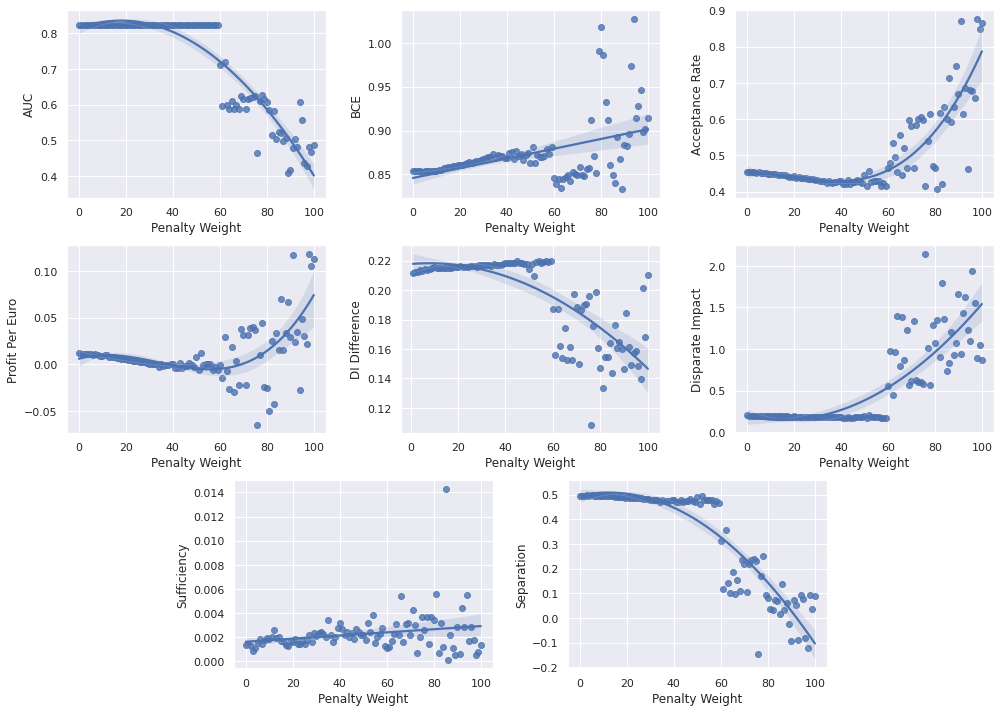

In [ ]:
# Plot all metrics

fig = plt.figure(figsize=(14,10))

plot1 = plt.subplot2grid((6, 6), (0, 0), rowspan=2, colspan=2)
plot2 = plt.subplot2grid((6, 6), (0, 2), rowspan=2, colspan=2)
plot3 = plt.subplot2grid((6, 6), (0, 4), rowspan=2, colspan=2)
plot4 = plt.subplot2grid((6, 6), (2, 0), rowspan=2, colspan=2)
plot5 = plt.subplot2grid((6, 6), (2, 2), rowspan=2, colspan=2)
plot6 = plt.subplot2grid((6, 6), (2, 4), rowspan=2, colspan=2)
plot7 = plt.subplot2grid((6, 6), (4, 1), rowspan=2, colspan=2)
plot8 = plt.subplot2grid((6, 6), (4, 3), rowspan=2, colspan=2)

plot1 = sns.regplot(x="Penalty Weight",y="AUC", data=dio_metrics_sim, order = 2, ax=plot1)

plot2 = sns.regplot(x="Penalty Weight",y="BCE", data=dio_metrics_sim, order = 1, ax=plot2)

plot3 = sns.regplot(x="Penalty Weight",y="Acceptance Rate", data=dio_metrics_sim, order = 3, ax=plot3)

plot4 = sns.regplot(x="Penalty Weight",y="Profit Per Euro", data=dio_metrics_sim, order = 3, ax=plot4)

plot5 = sns.regplot(x="Penalty Weight",y="DI Difference", data=dio_metrics_sim, order = 2, ax=plot5)

plot6 = sns.regplot(x="Penalty Weight",y="Disparate Impact", data=dio_metrics_sim, order = 2, ax=plot6)

plot7 = sns.regplot(x="Penalty Weight",y="Predictive Parity Difference (Sufficiency)", data=dio_metrics_sim, order = 1, ax=plot7)
plot7.set(xlabel='Penalty Weight', ylabel='Sufficiency')

plot8 = sns.regplot(x="Penalty Weight",y="Average Odds Difference (Separation)", data=dio_metrics_sim, order = 2, ax=plot8)
plot8.set(xlabel='Penalty Weight', ylabel='Separation')

plt.tight_layout()
plt.show()
fig.savefig("DIO SIM METRICS",dpi=300)

In [ ]:
# Select columns relevant for the correlation analysis
dio_metrics_sim = dio_metrics_sim[['Penalty Weight', 
                                    'AUC', 
                                    'MSE', 
                                    'BCE', 
                                    'Profit Per Euro', 
                                    'DI Difference', 
                                    'Disparate Impact', 
                                    'Average Odds Difference (Separation)', 
                                    'Predictive Parity Difference (Sufficiency)', 
                                    'Acceptance Rate']]

In [ ]:
# Spearman correlation matrix
dio_metrics_sim_corr = dio_metrics_sim.astype('float64').corr(method='spearman')
dio_metrics_sim_corr

,Penalty Weight,AUC,MSE,BCE,Profit Per Euro,DI Difference,Disparate Impact,Average Odds Difference (Separation),Predictive Parity Difference (Sufficiency),Acceptance Rate
Penalty Weight,1.000000,-0.591567,0.921771,0.373838,0.168818,-0.560944,0.571567,-0.943215,0.220990,0.481934
AUC,-0.591567,1.000000,-0.579977,0.093815,-0.489563,0.962121,-0.963751,0.601048,0.088864,-0.820862
MSE,0.921771,-0.579977,1.000000,0.373128,-0.068177,-0.605264,0.579441,-0.986453,0.314490,0.342889
BCE,0.373838,0.093815,0.373128,1.000000,-0.246430,0.131059,-0.104752,-0.373477,0.258346,-0.272277
Profit Per Euro,0.168818,-0.489563,-0.068177,-0.246430,1.000000,-0.331402,0.380384,-0.032207,-0.423052,0.762947
DI Difference,-0.560944,0.962121,-0.605264,0.131059,-0.331402,1.000000,-0.973720,0.593227,-0.053544,-0.742120
Disparate Impact,0.571567,-0.963751,0.579441,-0.104752,0.380384,-0.973720,1.000000,-0.569854,0.054374,0.775131
Average Odds Difference (Separation),-0.943215,0.601048,-0.986453,-0.373477,-0.032207,0.593227,-0.569854,1.000000,-0.238952,-0.387501
Predictive Parity Difference (Sufficiency),0.220990,0.088864,0.314490,0.258346,-0.423052,-0.053544,0.054374,-0.238952,1.000000,-0.238136
Acceptance Rate,0.481934,-0.820862,0.342889,-0.272277,0.762947,-0.742120,0.775131,-0.387501,-0.238136,1.000000


In [ ]:
# Calculate p-values for the Spearman correlation coefficients
dio_metrics_sim_array = dio_metrics_sim.to_numpy()
rho, pval = stats.spearmanr(dio_metrics_sim_array, nan_policy='omit')
pd.DataFrame(pval, columns=dio_metrics_sim_corr.columns, index=dio_metrics_sim_corr.index).round(6)

,Penalty Weight,AUC,MSE,BCE,Profit Per Euro,DI Difference,Disparate Impact,Average Odds Difference (Separation),Predictive Parity Difference (Sufficiency),Acceptance Rate
Penalty Weight,0.000000,0.000000,0.000000,0.000118,0.091485,0.000000,0.000000,0.000000,0.026364,0.000000
AUC,0.000000,0.000000,0.000000,0.350742,0.000000,0.000000,0.000000,0.000000,0.376853,0.000000
MSE,0.000000,0.000000,0.000000,0.000122,0.498132,0.000000,0.000000,0.000000,0.001360,0.000448
BCE,0.000118,0.350742,0.000122,0.000000,0.012984,0.193693,0.297172,0.000120,0.009095,0.005878
Profit Per Euro,0.091485,0.000000,0.498132,0.012984,0.000000,0.000757,0.000087,0.749170,0.000010,0.000000
DI Difference,0.000000,0.000000,0.000000,0.193693,0.000757,0.000000,0.000000,0.000000,0.596748,0.000000
Disparate Impact,0.000000,0.000000,0.000000,0.297172,0.000087,0.000000,0.000000,0.000000,0.589163,0.000000
Average Odds Difference (Separation),0.000000,0.000000,0.000000,0.000120,0.749170,0.000000,0.000000,0.000000,0.016106,0.000062
Predictive Parity Difference (Sufficiency),0.026364,0.376853,0.001360,0.009095,0.000010,0.596748,0.589163,0.016106,0.000000,0.016482
Acceptance Rate,0.000000,0.000000,0.000448,0.005878,0.000000,0.000000,0.000000,0.000062,0.016482,0.000000


###Pareto Frontiers

In [ ]:
# Create two-column dataframes to find the Pareto efficient combinations
dio_metrics_sim_1 = dio_metrics_sim[['Profit Per Euro', 'DI Difference']]
dio_metrics_sim_2 = dio_metrics_sim[['Profit Per Euro', 'Average Odds Difference (Separation)']]
dio_metrics_sim_3 = dio_metrics_sim[['AUC', 'Average Odds Difference (Separation)']]
dio_metrics_sim_4 = dio_metrics_sim[['AUC', 'DI Difference']]

# Only separation larger than 0
dio_metrics_sim_2 = dio_metrics_sim_2[dio_metrics_sim_2['Average Odds Difference (Separation)']>=0]
dio_metrics_sim_3 = dio_metrics_sim_3[dio_metrics_sim_3['Average Odds Difference (Separation)']>=0]

# Find Pareto efficient solutions for each dataframe
dio_metrics_sim_1['pareto'] = find_skyline_bn_min_max(df=dio_metrics_sim_1, to_max=['Profit Per Euro'], to_min=['DI Difference'])
dio_metrics_sim_1["pareto"] = dio_metrics_sim_1["pareto"].astype(int)
dio_metrics_sim_2['pareto'] = find_skyline_bn_min_max(df=dio_metrics_sim_2, to_max=['Profit Per Euro'], to_min=['Average Odds Difference (Separation)'])
dio_metrics_sim_2["pareto"] = dio_metrics_sim_2["pareto"].astype(int)
dio_metrics_sim_3['pareto'] = find_skyline_bn_min_max(df=dio_metrics_sim_3, to_max=['AUC'], to_min=['Average Odds Difference (Separation)'])
dio_metrics_sim_3["pareto"] = dio_metrics_sim_3["pareto"].astype(int)
dio_metrics_sim_4['pareto'] = find_skyline_bn_min_max(df=dio_metrics_sim_4, to_max=['AUC'], to_min=['DI Difference'])
dio_metrics_sim_4["pareto"] = dio_metrics_sim_4["pareto"].astype(int)

In [ ]:
# Extract and sort Pareto efficient solutions

dio_pareto_sim_1 = dio_metrics_sim_1[dio_metrics_sim_1.pareto==1]
dio_pareto_sim_1.sort_values(by=['Profit Per Euro', 'DI Difference'], inplace=True)

dio_pareto_sim_2 = dio_metrics_sim_2[dio_metrics_sim_2.pareto==1]
dio_pareto_sim_2.sort_values(by=['Profit Per Euro', 'Average Odds Difference (Separation)'], inplace=True)

dio_pareto_sim_3 = dio_metrics_sim_3[dio_metrics_sim_3.pareto==1]
dio_pareto_sim_3.sort_values(by=['AUC', 'Average Odds Difference (Separation)'], inplace=True)

dio_pareto_sim_4 = dio_metrics_sim_4[dio_metrics_sim_4.pareto==1]
dio_pareto_sim_4.sort_values(by=['AUC', 'DI Difference'], inplace=True)

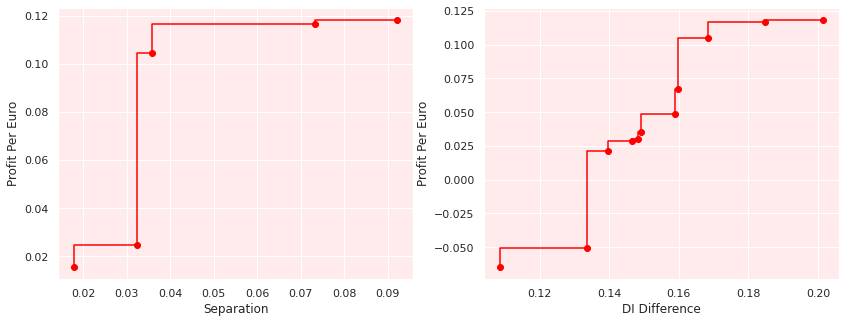

<Figure size 432x288 with 0 Axes>

In [ ]:
# Plot and save the Pareto frontiers 
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False, figsize=(14,5))
ax1.step(dio_pareto_sim_2['Average Odds Difference (Separation)'], dio_pareto_sim_2['Profit Per Euro'], '-o', where='pre', color='red')
ax2.step(dio_pareto_sim_1['DI Difference'], dio_pareto_sim_1['Profit Per Euro'], '-o', where='pre', color='red')
ax1.set_xlabel('Separation')
ax1.set_ylabel('Profit Per Euro')
ax2.set_xlabel('DI Difference')
ax2.set_ylabel('Profit Per Euro')
ax1.patch.set_facecolor('red')
ax1.patch.set_alpha(0.08)
ax2.patch.set_facecolor('red')
ax2.patch.set_alpha(0.08)
plt.show()
plt.tight_layout()
plt.show()
fig.savefig("PARETO DIO SIM PROFIT", dpi=300, bbox_inches='tight')

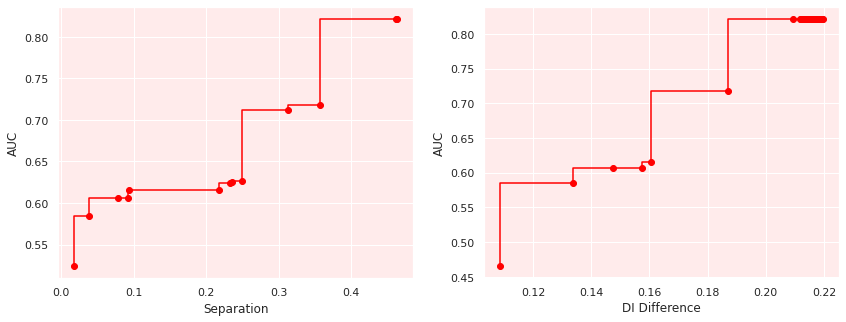

<Figure size 432x288 with 0 Axes>

In [ ]:
# Plot and save the Pareto frontiers 
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False, figsize=(14,5))
ax1.step(dio_pareto_sim_3['Average Odds Difference (Separation)'], dio_pareto_sim_3['AUC'], '-o', where='pre', color='red')
ax2.step(dio_pareto_sim_4['DI Difference'], dio_pareto_sim_4['AUC'], '-o', where='pre', color='red')
ax1.set_xlabel('Separation')
ax1.set_ylabel('AUC')
ax2.set_xlabel('DI Difference')
ax2.set_ylabel('AUC')
ax1.patch.set_facecolor('red')
ax1.patch.set_alpha(0.08)
ax2.patch.set_facecolor('red')
ax2.patch.set_alpha(0.08)
plt.show()
plt.tight_layout()
plt.show()
fig.savefig("PARETO DIO SIM AUC", dpi=300, bbox_inches='tight')

###Prediction Histogram Animation

In [ ]:
# Make and save predictions for penalty weights 0 to 100

preds_dio_sim = []

for i in range(101):
  preds_dio_sim.append(make_predictions(penalty_weight=i,input_features=9,num_hid_units_1=10,num_hid_units_2=15,batch_size=128,learning_rate=0.0001,epochs=50))

np.save('preds_dio_sim.npy', preds_dio_sim, allow_pickle=True)

In [ ]:
# Running this line twice fixes a bug that produces an error when showing animations
%matplotlib notebook
%matplotlib notebook

In [ ]:
fig, ax = plt.subplots(1,1,figsize=(15,10))

def animate(i):
  '''Creates histograms for animation'''
  plt.cla()
  ax = plt.hist(preds_dio_sim[i],50)
  plt.title("Penalty Weight: " +str(i))
  plt.xlim(0, 1)
  plt.ylim(0, 4000)

# Create and show animation of consecutive histograms for different penalty weights
ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(preds_dio_sim),interval=200,blit=False)
HTML(ani.to_html5_video())

<IPython.core.display.Javascript object>

In [ ]:
# Reset the output option
%matplotlib inline

##Give Me Some Credit

###Importing and Preprocessing the Data

In [ ]:
reset_random_seeds(1)

# Import and clean data
gmsc = pd.read_csv("GiveMeSomeCredit.csv")
gmsc.drop('Unnamed: 0', axis = 1, inplace=True)

# Define privileged group
gmsc['Over30'] = np.where(gmsc['age']>30, 1, 0)
gmsc.drop('age', axis = 1, inplace=True)

# Simulate loan amounts
loan_amount_mean = 7000
loan_amount_std = 2000

amount = np.random.normal(loan_amount_mean, loan_amount_std, len(gmsc))
gmsc['Amount'] = amount.tolist()

# Split training data and apply oversampling
gmsc.replace([np.inf, -np.inf], np.nan, inplace=True)
gmsc.dropna(inplace=True)
X = gmsc.drop('SeriousDlqin2yrs', axis=1).copy()
y = gmsc['SeriousDlqin2yrs'].copy()
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1, stratify=y, test_size=0.3, shuffle = True)
oversample = SMOTE()
X_train, y_train = oversample.fit_resample(X_train, y_train)

# Reformatting
y_train_float = y_train.astype('float64')
X_train_float = X_train.astype('float64')
y_test_float = y_test.astype('float64')
X_test_float = X_test.astype('float64')

# Create privileged lists
priv_train =X_train_float['Over30']
X_train = X_train_float.loc[:, X_train_float.columns != 'Over30']
priv_test =X_test_float['Over30']
X_test = X_test_float.loc[:, X_test_float.columns != 'Over30']

gmsc

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents,Over30,Amount
0,1,0.766127,2,0.802982,9120.0,13,0,6,0,2.0,1,10248.690727
1,0,0.957151,0,0.121876,2600.0,4,0,0,0,1.0,1,5776.487173
2,0,0.658180,1,0.085113,3042.0,2,1,0,0,0.0,1,5943.656495
3,0,0.233810,0,0.036050,3300.0,5,0,0,0,0.0,0,4854.062756
4,0,0.907239,1,0.024926,63588.0,7,0,1,0,0.0,1,8730.815259
...,...,...,...,...,...,...,...,...,...,...,...,...
149994,0,0.385742,0,0.404293,3400.0,7,0,0,0,0.0,1,8318.897028
149995,0,0.040674,0,0.225131,2100.0,4,0,1,0,0.0,1,5235.598690
149996,0,0.299745,0,0.716562,5584.0,4,0,1,0,2.0,1,7551.002863
149998,0,0.000000,0,0.000000,5716.0,4,0,0,0,0.0,0,5084.866943


(0.0, 15000.0)

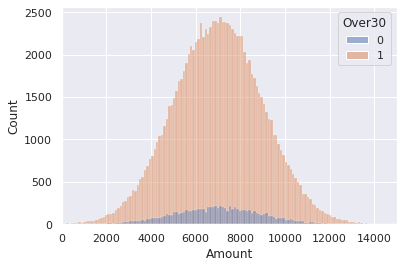

In [ ]:
#Inspecting the credit amount distributions before and after oversampling to rule 
#it out as a source of strictly rising profits with increasing acceptance rates
fig = sns.histplot(gmsc, x='Amount', hue='Over30')
fig.set_xlim(left=0, right=15000)

(0.0, 15000.0)

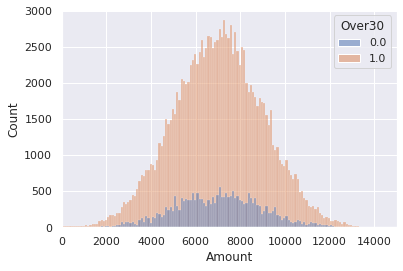

In [ ]:
fig = sns.histplot(pd.concat([X_train, priv_train], axis=1), x='Amount', hue='Over30')
fig.set_xlim(left=0, right=15000)

###Exploratory Data Analysis

(0.0, 40000.0)

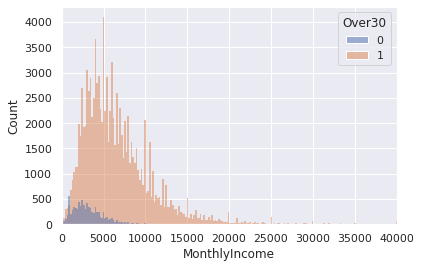

In [ ]:
fig = sns.histplot(gmsc, x='MonthlyIncome', hue='Over30')
fig.set_xlim(left=0, right=40000)

(0.0, 20000.0)

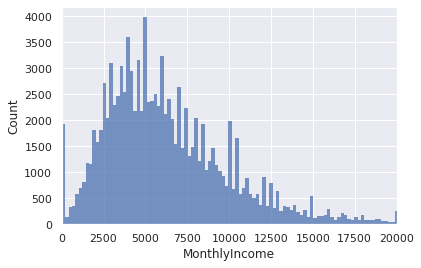

In [ ]:
fig = sns.histplot(gmsc[gmsc.Over30==1], x='MonthlyIncome')
fig.set_xlim(left=0, right=20000)

(0.0, 20000.0)

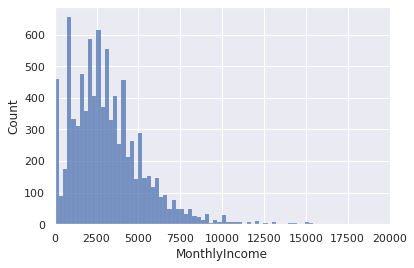

In [ ]:
fig = sns.histplot(gmsc[gmsc.Over30==0], x='MonthlyIncome')
fig.set_xlim(left=0, right=20000)

In [ ]:
gmsc.corr()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents,Over30,Amount
SeriousDlqin2yrs,1.000000,-0.002386,0.123159,-0.003291,-0.019746,-0.027445,0.111149,-0.003005,0.093836,0.046704,-0.046718,0.003161
RevolvingUtilizationOfUnsecuredLines,-0.002386,1.000000,-0.001194,-0.000243,0.007124,-0.010880,-0.000931,0.005895,-0.000955,0.002347,0.002467,-0.001903
NumberOfTime30-59DaysPastDueNotWorse,0.123159,-0.001194,1.000000,-0.001981,-0.010217,-0.043868,0.975259,-0.024036,0.980131,0.003538,-0.052073,-0.000384
DebtRatio,-0.003291,-0.000243,-0.001981,1.000000,-0.028712,0.008685,-0.002703,0.019574,-0.001801,0.009803,0.008512,0.003226
MonthlyIncome,-0.019746,0.007124,-0.010217,-0.028712,1.000000,0.091455,-0.012743,0.124959,-0.011116,0.062647,0.068354,0.001331
NumberOfOpenCreditLinesAndLoans,-0.027445,-0.010880,-0.043868,0.008685,0.091455,1.000000,-0.072249,0.426536,-0.061505,0.038342,0.210729,0.002367
NumberOfTimes90DaysLate,0.111149,-0.000931,0.975259,-0.002703,-0.012743,-0.072249,1.000000,-0.040573,0.989277,-0.003779,-0.058755,-0.000447
NumberRealEstateLoansOrLines,-0.003005,0.005895,-0.024036,0.019574,0.124959,0.426536,-0.040573,1.000000,-0.034118,0.118997,0.204309,0.002603
NumberOfTime60-89DaysPastDueNotWorse,0.093836,-0.000955,0.980131,-0.001801,-0.011116,-0.061505,0.989277,-0.034118,1.000000,-0.005092,-0.056310,-0.000234
NumberOfDependents,0.046704,0.002347,0.003538,0.009803,0.062647,0.038342,-0.003779,0.118997,-0.005092,1.000000,0.122523,-0.000559


In [ ]:
#Percentage of unprivileged individuals
len(gmsc[gmsc.Over30==0]) / len(gmsc)

0.075272929848922

In [ ]:
#Default percentage privileged
def_perc_priv = len(gmsc[(gmsc.Over30==1) & (gmsc.SeriousDlqin2yrs==1)]) / len(gmsc[(gmsc.Over30==1)]) * 100
print(f'{def_perc_priv:.2f}% of customers default in the privileged group')

6.61% of customers default in the privileged group


In [ ]:
#Default percentage unprivileged
def_perc_unpriv = len(gmsc[(gmsc.Over30==0) & (gmsc.SeriousDlqin2yrs==1)]) / len(gmsc[(gmsc.Over30==0)]) * 100
print(f'{def_perc_unpriv:.2f}% of customers default in the unprivileged group')

11.11% of customers default in the unprivileged group


In [ ]:
#Disparate Impact in the original data

ratio_unpriv = len(gmsc.loc[(gmsc['SeriousDlqin2yrs'] == 0) & (gmsc['Over30'] == 0)]) / len(gmsc.loc[gmsc['Over30'] == 0])
ratio_priv = len(gmsc.loc[(gmsc['SeriousDlqin2yrs'] == 0) & (gmsc['Over30'] == 1)]) / len(gmsc.loc[gmsc['Over30'] == 1])
ratio = round((ratio_unpriv / ratio_priv),4)
print(f'Disparate Impact in the original data: {ratio}')

Disparate Impact in the original data: 0.9518


###Hyperparameter Tuning

In [ ]:
reset_random_seeds(seed=1)
s=1

def create_model(param):
  '''Builds the basic model with variables to be optimized. These variables include number of nodes in both hidden layers, learning rate and batch size.'''

  gain = 0 # No Penalty
  loss = 0 # No Penalty
  input = keras.Input(shape=(10,))
  priv = keras.Input(shape=(1,))
  x = layers.Dense(param['unit_1'], activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(input)
  x = layers.Dense(param['unit_2'], activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
  output = layers.Dense(1, activation="sigmoid", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
  model = keras.Model(inputs=[input, priv], outputs=output, name="model")
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=param['lr']), loss=CustomLoss(priv = priv), metrics = ['binary_crossentropy', tf.keras.metrics.AUC(name='auc')])
  return model

# Parameters to be tested
param_grid = {
  'unit_1': [10,15,20], 
  'unit_2': [10,15,20],
  'lr': [0.00005,0.0001], 
  'epochs': [100], 
  'batch_size': [64,128,256]
}

es = EarlyStopping(patience=10, verbose=1, monitor='val_auc', mode='max', restore_best_weights=True)

hypermodel = create_model

kgs = KerasGridSearch(hypermodel, param_grid, monitor='val_auc', greater_is_better=True, tuner_verbose=1)
kgs.search([X_train, priv_train], y_train, validation_data=([X_test, priv_test], y_test), callbacks=[es])

print(f"The best score was {kgs.best_score} with the following parameters:")
kgs.best_params


54 trials detected for ('unit_1', 'unit_2', 'lr', 'epochs', 'batch_size')

***** (1/54) *****
Search({'unit_1': 10, 'unit_2': 10, 'lr': 0.0001, 'epochs': 100, 'batch_size': 64})
Restoring model weights from the end of the best epoch: 20.
Epoch 30: early stopping
SCORE: 0.66935 at epoch 20

***** (2/54) *****
Search({'unit_1': 10, 'unit_2': 10, 'lr': 0.0001, 'epochs': 100, 'batch_size': 256})
Restoring model weights from the end of the best epoch: 21.
Epoch 31: early stopping
SCORE: 0.71921 at epoch 21

***** (3/54) *****
Search({'unit_1': 10, 'unit_2': 10, 'lr': 0.0001, 'epochs': 100, 'batch_size': 128})
Restoring model weights from the end of the best epoch: 15.
Epoch 25: early stopping
SCORE: 0.66259 at epoch 15

***** (4/54) *****
Search({'unit_1': 10, 'unit_2': 10, 'lr': 5e-05, 'epochs': 100, 'batch_size': 64})
Restoring model weights from the end of the best epoch: 5.
Epoch 15: early stopping
SCORE: 0.61006 at epoch 5

***** (5/54) *****
Search({'unit_1': 10, 'unit_2': 10, 'lr': 

{'batch_size': 128,
 'epochs': 27,
 'lr': 0.0001,
 'steps_per_epoch': None,
 'unit_1': 20,
 'unit_2': 10}

The best score was 0.72487 with the following parameters:

{'batch_size': 128,

 'epochs': 27,

 'lr': 0.0001,

 'steps_per_epoch': None,

 'unit_1': 20,

 'unit_2': 10}

###Determining a static cutoff

In [ ]:
# Generate predictions to then calculate the optimal cutoff

opt = tf.keras.optimizers.Adam(learning_rate=0.0001)

tau = 0
loss = 0
gain = 0

s = 1

reset_random_seeds(s)

input1 = keras.Input(shape=(10,))
priv = keras.Input(shape=(1,))
x = layers.Dense(20, activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(input1)
x = layers.Dense(10, activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
output = layers.Dense(1, activation="sigmoid", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
loop_model = keras.Model(inputs=[input1, priv], outputs=output, name="loop_model")

loop_model.compile(optimizer=opt, loss=CustomLoss(priv = priv), metrics = ['binary_crossentropy', tf.keras.metrics.AUC(name='auc')])

history = loop_model.fit(x=[X_train, priv_train], y=y_train, validation_data=([X_test, priv_test], y_test), epochs=50, batch_size = 128, callbacks=[])

loop_model_pred = loop_model.predict([X_test,priv_test])

del loop_model

Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [==============================] - 2s 16us/sample - loss: 76.0052 - binary_crossentropy: 76.0052 - auc: 0.5286 - val_loss: 2.5907 - val_binary_crossentropy: 2.5907 - val_auc: 0.5511
Epoch 2/50
156676/156676 [==============================] - 2s 14us/sample - loss: 2.7271 - binary_crossentropy: 2.7271 - auc: 0.5498 - val_loss: 2.3610 - val_binary_crossentropy: 2.3610 - val_auc: 0.5707
Epoch 3/50
156676/156676 [==============================] - 2s 14us/sample - loss: 1.4304 - binary_crossentropy: 1.4304 - auc: 0.5793 - val_loss: 1.0083 - val_binary_crossentropy: 1.0083 - val_auc: 0.6268
Epoch 4/50
156676/156676 [==============================] - 2s 13us/sample - loss: 0.9086 - binary_crossentropy: 0.9086 - auc: 0.6303 - val_loss: 0.5483 - val_binary_crossentropy: 0.5483 - val_auc: 0.6843
Epoch 5/50
156676/156676 [==============================] - 2s 13us/sample - loss: 0.7797 - binary_crossentropy: 0.7797 - auc: 

In [ ]:
# Calculate acceptance rates for 100 different cutoff values

acceptance = pd.DataFrame(columns = ['Cutoff','Acceptance Rate'])

items = np.arange(0.00, 1.01, 0.01)

for index, item in enumerate(items):
  ar = round(get_acceptance_rate(loop_model_pred, item),4)
  acceptance.loc[index,'Cutoff'] = round(item,2)
  acceptance.loc[index,'Acceptance Rate'] = ar

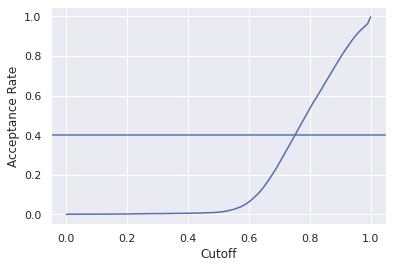

In [ ]:
graph = sns.lineplot(data=acceptance,x='Cutoff',y='Acceptance Rate')
graph.axhline(0.4)
graph.figure.savefig("Cutoff DIO GMSC", dpi=300, bbox_inches='tight') 

In [ ]:
acceptance[(acceptance['Acceptance Rate'] < 0.45) & (acceptance['Acceptance Rate'] > 0.35)]

,Cutoff,Acceptance Rate
74,0.74,0.3691
75,0.75,0.3967
76,0.76,0.4248


###Testing

####Range: 0 - 100
####Interval: 1

In [ ]:
# Set the cutoff value as previously defined
tau = 0.75

In [ ]:
dio_metrics_gmsc_1 = rep_test_loop(lower_bound=0,upper_bound=11,interval=1,input_features=10,num_hid_units_1=20,num_hid_units_2=10,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 0.0
The current loss parameter is: -0.0
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [==============================] - 3s 16us/sample - loss: 76.0052 - binary_crossentropy: 76.0052 - auc: 0.5286 - val_loss: 2.5907 - val_binary_crossentropy: 2.5907 - val_auc: 0.5511
Epoch 2/50
156676/156676 [==============================] - 2s 13us/sample - loss: 2.7271 - binary_crossentropy: 2.7271 - auc: 0.5498 - val_loss: 2.3610 - val_binary_crossentropy: 2.3610 - val_auc: 0.5707
Epoch 3/50
156676/156676 [==============================] - 2s 13us/sample - loss: 1.4304 - binary_crossentropy: 1.4304 - auc: 0.5793 - val_loss: 1.0083 - val_binary_crossentropy: 1.0083 - val_auc: 0.6268
Epoch 4/50
156676/156676 [==============================] - 2s 13us/sample - loss: 0.9086 - binary_crossentropy: 0.9086 - auc: 0.6303 - val_loss: 0.5483 - val_binary_crossentropy: 0.5483 - val_auc: 0.6843
Epoch 5/50
156676/156676 [======

1it [14:19, 859.38s/it]

Penalty Weight                                              0
AUC                                                  0.717635
MSE                                                  0.241982
BCE                                                  0.832401
Profit                                        37255893.050075
Profit Per Euro                                      0.147226
DI Difference                                             NaN
Mean DI Privileged                                        NaN
Mean DI Unprivileged                                      NaN
Disparate Impact                                     0.859063
Average Odds Difference (Separation)                 0.048055
Predictive Parity Difference (Sufficiency)          -0.010771
Acceptance Rate                                      0.825382
Name: 0, dtype: object

The current gain parameter is: 0.136
The current loss parameter is: -0.272
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156

2it [26:28, 782.59s/it]

Penalty Weight                                              1
AUC                                                  0.718328
MSE                                                  0.222244
BCE                                                  0.763849
Profit                                        41101908.615439
Profit Per Euro                                      0.162425
DI Difference                                        0.636911
Mean DI Privileged                                   0.677692
Mean DI Unprivileged                                  0.04078
Disparate Impact                                     0.861335
Average Odds Difference (Separation)                  0.05697
Predictive Parity Difference (Sufficiency)          -0.009968
Acceptance Rate                                      0.855996
Name: 1, dtype: object

The current gain parameter is: 0.272
The current loss parameter is: -0.544
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156

3it [42:02, 851.99s/it]

Penalty Weight                                              2
AUC                                                  0.718981
MSE                                                  0.211593
BCE                                                  0.736038
Profit                                        42451948.021159
Profit Per Euro                                       0.16776
DI Difference                                        0.640304
Mean DI Privileged                                   0.682864
Mean DI Unprivileged                                  0.04256
Disparate Impact                                     0.893927
Average Odds Difference (Separation)                 0.033882
Predictive Parity Difference (Sufficiency)          -0.010613
Acceptance Rate                                      0.866007
Name: 2, dtype: object

The current gain parameter is: 0.40800000000000003
The current loss parameter is: -0.8160000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 sa

4it [56:39, 861.70s/it]

Penalty Weight                                              3
AUC                                                  0.721213
MSE                                                  0.215652
BCE                                                  0.746948
Profit                                        43007254.228528
Profit Per Euro                                      0.169954
DI Difference                                        0.643641
Mean DI Privileged                                   0.686744
Mean DI Unprivileged                                 0.043103
Disparate Impact                                     0.901253
Average Odds Difference (Separation)                 0.029039
Predictive Parity Difference (Sufficiency)          -0.010706
Acceptance Rate                                      0.869034
Name: 3, dtype: object

The current gain parameter is: 0.544
The current loss parameter is: -1.088
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156

5it [1:12:12, 887.46s/it]

Penalty Weight                                              4
AUC                                                  0.718357
MSE                                                  0.208023
BCE                                                  0.724993
Profit                                        43270741.125932
Profit Per Euro                                      0.170995
DI Difference                                        0.644206
Mean DI Privileged                                    0.68737
Mean DI Unprivileged                                 0.043164
Disparate Impact                                     0.903227
Average Odds Difference (Separation)                 0.029949
Predictive Parity Difference (Sufficiency)          -0.010448
Acceptance Rate                                      0.872348
Name: 4, dtype: object

The current gain parameter is: 0.68
The current loss parameter is: -1.36
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15667

6it [1:28:59, 928.05s/it]

Penalty Weight                                              5
AUC                                                  0.720699
MSE                                                  0.219341
BCE                                                  0.753605
Profit                                        43022115.136828
Profit Per Euro                                      0.170013
DI Difference                                        0.642227
Mean DI Privileged                                   0.685851
Mean DI Unprivileged                                 0.043624
Disparate Impact                                     0.918444
Average Odds Difference (Separation)                 0.011393
Predictive Parity Difference (Sufficiency)          -0.009987
Acceptance Rate                                      0.868113
Name: 5, dtype: object

The current gain parameter is: 0.8160000000000001
The current loss parameter is: -1.6320000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

7it [1:47:11, 981.63s/it]

Penalty Weight                                              6
AUC                                                  0.720743
MSE                                                  0.213741
BCE                                                   0.73871
Profit                                        43953570.965594
Profit Per Euro                                      0.173694
DI Difference                                        0.647654
Mean DI Privileged                                   0.691516
Mean DI Unprivileged                                 0.043862
Disparate Impact                                     0.917822
Average Odds Difference (Separation)                   0.0146
Predictive Parity Difference (Sufficiency)          -0.010555
Acceptance Rate                                      0.875813
Name: 6, dtype: object

The current gain parameter is: 0.9520000000000001
The current loss parameter is: -1.9040000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

8it [2:06:40, 1041.49s/it]

Penalty Weight                                              7
AUC                                                  0.720869
MSE                                                  0.212938
BCE                                                  0.735587
Profit                                        44445180.171215
Profit Per Euro                                      0.175636
DI Difference                                         0.64981
Mean DI Privileged                                      0.694
Mean DI Unprivileged                                 0.044189
Disparate Impact                                     0.921927
Average Odds Difference (Separation)                  0.01309
Predictive Parity Difference (Sufficiency)          -0.010657
Acceptance Rate                                      0.879405
Name: 7, dtype: object

The current gain parameter is: 1.088
The current loss parameter is: -2.176
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156

9it [2:27:32, 1107.17s/it]

Penalty Weight                                              8
AUC                                                  0.722301
MSE                                                  0.204834
BCE                                                  0.712905
Profit                                        45374732.839234
Profit Per Euro                                       0.17931
DI Difference                                        0.655209
Mean DI Privileged                                   0.699587
Mean DI Unprivileged                                 0.044378
Disparate Impact                                     0.919588
Average Odds Difference (Separation)                 0.018414
Predictive Parity Difference (Sufficiency)          -0.010239
Acceptance Rate                                      0.887243
Name: 8, dtype: object

The current gain parameter is: 1.2240000000000002
The current loss parameter is: -2.4480000000000004
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

10it [2:50:06, 1183.48s/it]

Penalty Weight                                              9
AUC                                                  0.722526
MSE                                                  0.199607
BCE                                                  0.700842
Profit                                        45679240.227762
Profit Per Euro                                      0.180513
DI Difference                                        0.656157
Mean DI Privileged                                   0.700635
Mean DI Unprivileged                                 0.044478
Disparate Impact                                     0.921309
Average Odds Difference (Separation)                 0.018363
Predictive Parity Difference (Sufficiency)           -0.01069
Acceptance Rate                                      0.890419
Name: 9, dtype: object

The current gain parameter is: 1.36
The current loss parameter is: -2.72
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15667

11it [3:14:18, 1059.84s/it]

Penalty Weight                                             10
AUC                                                  0.721835
MSE                                                  0.196301
BCE                                                  0.689794
Profit                                        46056425.917247
Profit Per Euro                                      0.182004
DI Difference                                        0.657809
Mean DI Privileged                                   0.702447
Mean DI Unprivileged                                 0.044638
Disparate Impact                                      0.92522
Average Odds Difference (Separation)                 0.017068
Predictive Parity Difference (Sufficiency)          -0.011722
Acceptance Rate                                      0.893722
Name: 10, dtype: object


In [ ]:
dio_metrics_gmsc_1.to_csv('dio_metrics_gmsc_1.csv')

In [ ]:
dio_metrics_gmsc_2 = rep_test_loop(lower_bound=11,upper_bound=21,interval=1,input_features=10,num_hid_units_1=20,num_hid_units_2=10,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 1.496
The current loss parameter is: -2.992
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [==============================] - 5s 30us/sample - loss: 76.0123 - binary_crossentropy: 76.0065 - auc: 0.5286 - val_loss: 2.5786 - val_binary_crossentropy: 2.5950 - val_auc: 0.5511
Epoch 2/50
156676/156676 [==============================] - 4s 23us/sample - loss: 2.7682 - binary_crossentropy: 2.7321 - auc: 0.5496 - val_loss: 2.4120 - val_binary_crossentropy: 2.4206 - val_auc: 0.5691
Epoch 3/50
156676/156676 [==============================] - 3s 21us/sample - loss: 1.5233 - binary_crossentropy: 1.4477 - auc: 0.5778 - val_loss: 1.0205 - val_binary_crossentropy: 1.0529 - val_auc: 0.6220
Epoch 4/50
156676/156676 [==============================] - 4s 27us/sample - loss: 1.0437 - binary_crossentropy: 0.9232 - auc: 0.6280 - val_loss: 0.4040 - val_binary_crossentropy: 0.4926 - val_auc: 0.6742
Epoch 5/50
156676/156676 [==

1it [12:04, 724.99s/it]

Penalty Weight                                             11
AUC                                                  0.714888
MSE                                                  0.218506
BCE                                                  0.784096
Profit                                        38929742.544703
Profit Per Euro                                      0.153841
DI Difference                                        0.613098
Mean DI Privileged                                   0.655109
Mean DI Unprivileged                                 0.042011
Disparate Impact                                     0.908071
Average Odds Difference (Separation)                 0.009653
Predictive Parity Difference (Sufficiency)          -0.011739
Acceptance Rate                                      0.839683
Name: 0, dtype: object

The current gain parameter is: 1.6320000000000001
The current loss parameter is: -3.2640000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

2it [25:30, 772.23s/it]

Penalty Weight                                             12
AUC                                                  0.720214
MSE                                                  0.190452
BCE                                                  0.670995
Profit                                        47451272.900943
Profit Per Euro                                      0.187516
DI Difference                                        0.664056
Mean DI Privileged                                   0.709348
Mean DI Unprivileged                                 0.045293
Disparate Impact                                     0.934624
Average Odds Difference (Separation)                 0.014457
Predictive Parity Difference (Sufficiency)          -0.011815
Acceptance Rate                                      0.903839
Name: 1, dtype: object

The current gain parameter is: 1.7680000000000002
The current loss parameter is: -3.5360000000000005
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

3it [39:03, 790.85s/it]

Penalty Weight                                             13
AUC                                                  0.718947
MSE                                                  0.189521
BCE                                                  0.666502
Profit                                        48061834.844605
Profit Per Euro                                      0.189928
DI Difference                                        0.667409
Mean DI Privileged                                   0.713046
Mean DI Unprivileged                                 0.045636
Disparate Impact                                     0.938302
Average Odds Difference (Separation)                 0.013801
Predictive Parity Difference (Sufficiency)          -0.012192
Acceptance Rate                                      0.908445
Name: 2, dtype: object

The current gain parameter is: 1.9040000000000001
The current loss parameter is: -3.8080000000000003
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

4it [54:03, 834.16s/it]

Penalty Weight                                             14
AUC                                                  0.716085
MSE                                                  0.186843
BCE                                                  0.660047
Profit                                        48096181.793327
Profit Per Euro                                      0.190064
DI Difference                                        0.666661
Mean DI Privileged                                   0.712464
Mean DI Unprivileged                                 0.045802
Disparate Impact                                     0.942687
Average Odds Difference (Separation)                 0.012181
Predictive Parity Difference (Sufficiency)          -0.011635
Acceptance Rate                                      0.908794
Name: 3, dtype: object

The current gain parameter is: 2.04
The current loss parameter is: -4.08
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15667

5it [1:11:52, 918.61s/it]

Penalty Weight                                             15
AUC                                                  0.715162
MSE                                                  0.179391
BCE                                                  0.638623
Profit                                        49033850.878238
Profit Per Euro                                       0.19377
DI Difference                                        0.670336
Mean DI Privileged                                   0.716554
Mean DI Unprivileged                                 0.046218
Disparate Impact                                     0.948208
Average Odds Difference (Separation)                 0.010822
Predictive Parity Difference (Sufficiency)          -0.011365
Acceptance Rate                                      0.916044
Name: 4, dtype: object

The current gain parameter is: 2.176
The current loss parameter is: -4.352
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156

6it [1:28:45, 950.96s/it]

Penalty Weight                                             16
AUC                                                  0.712713
MSE                                                  0.179226
BCE                                                  0.637447
Profit                                        48820482.410771
Profit Per Euro                                      0.192926
DI Difference                                        0.668213
Mean DI Privileged                                   0.714426
Mean DI Unprivileged                                 0.046213
Disparate Impact                                      0.95593
Average Odds Difference (Separation)                 0.002688
Predictive Parity Difference (Sufficiency)           -0.01157
Acceptance Rate                                      0.914891
Name: 5, dtype: object

The current gain parameter is: 2.3120000000000003
The current loss parameter is: -4.6240000000000006
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

7it [1:48:09, 1020.60s/it]

Penalty Weight                                             17
AUC                                                  0.713765
MSE                                                   0.18934
BCE                                                  0.663748
Profit                                        49462550.451564
Profit Per Euro                                      0.195464
DI Difference                                        0.671988
Mean DI Privileged                                   0.719032
Mean DI Unprivileged                                 0.047044
Disparate Impact                                     0.963079
Average Odds Difference (Separation)                 0.000563
Predictive Parity Difference (Sufficiency)          -0.010923
Acceptance Rate                                      0.916554
Name: 6, dtype: object

The current gain parameter is: 2.4480000000000004
The current loss parameter is: -4.896000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

8it [2:08:30, 1084.14s/it]

Penalty Weight                                             18
AUC                                                   0.70991
MSE                                                   0.18167
BCE                                                  0.644886
Profit                                        49764510.241442
Profit Per Euro                                      0.196657
DI Difference                                        0.671007
Mean DI Privileged                                    0.71809
Mean DI Unprivileged                                 0.047083
Disparate Impact                                     0.970066
Average Odds Difference (Separation)                -0.003143
Predictive Parity Difference (Sufficiency)          -0.010843
Acceptance Rate                                      0.919941
Name: 7, dtype: object

The current gain parameter is: 2.584
The current loss parameter is: -5.168
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156

9it [2:28:51, 1127.00s/it]

Penalty Weight                                             19
AUC                                                   0.70879
MSE                                                  0.179688
BCE                                                  0.642538
Profit                                        49819434.333023
Profit Per Euro                                      0.196874
DI Difference                                        0.670453
Mean DI Privileged                                   0.717663
Mean DI Unprivileged                                  0.04721
Disparate Impact                                     0.971601
Average Odds Difference (Separation)                 -0.00152
Predictive Parity Difference (Sufficiency)          -0.011103
Acceptance Rate                                      0.920407
Name: 8, dtype: object

The current gain parameter is: 2.72
The current loss parameter is: -5.44
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15667

10it [2:51:49, 1030.96s/it]

Penalty Weight                                             20
AUC                                                  0.709392
MSE                                                  0.173415
BCE                                                  0.624413
Profit                                        51536083.384536
Profit Per Euro                                      0.203658
DI Difference                                        0.678812
Mean DI Privileged                                   0.727075
Mean DI Unprivileged                                 0.048264
Disparate Impact                                     0.980734
Average Odds Difference (Separation)                -0.004908
Predictive Parity Difference (Sufficiency)          -0.011691
Acceptance Rate                                      0.932785
Name: 9, dtype: object


In [ ]:
dio_metrics_gmsc_2.to_csv('dio_metrics_gmsc_2.csv')

In [ ]:
dio_metrics_gmsc_3 = rep_test_loop(lower_bound=21,upper_bound=31,interval=1,input_features=10,num_hid_units_1=20,num_hid_units_2=10,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 2.8560000000000003
The current loss parameter is: -5.712000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [==============================] - 3s 16us/sample - loss: 76.0186 - binary_crossentropy: 76.0077 - auc: 0.5286 - val_loss: 2.5685 - val_binary_crossentropy: 2.5997 - val_auc: 0.5511
Epoch 2/50
156676/156676 [==============================] - 2s 13us/sample - loss: 2.8062 - binary_crossentropy: 2.7372 - auc: 0.5496 - val_loss: 2.4589 - val_binary_crossentropy: 2.4740 - val_auc: 0.5678
Epoch 3/50
156676/156676 [==============================] - 2s 14us/sample - loss: 1.6069 - binary_crossentropy: 1.4639 - auc: 0.5764 - val_loss: 0.9759 - val_binary_crossentropy: 1.0418 - val_auc: 0.6202
Epoch 4/50
156676/156676 [==============================] - 4s 23us/sample - loss: 1.1667 - binary_crossentropy: 0.9384 - auc: 0.6265 - val_loss: 0.2773 - val_binary_crossentropy: 0.4622 - val_auc: 0.6650
Epo

1it [11:51, 711.28s/it]

Penalty Weight                                             21
AUC                                                  0.703684
MSE                                                  0.194217
BCE                                                  0.694577
Profit                                        47667389.924857
Profit Per Euro                                       0.18837
DI Difference                                        0.658047
Mean DI Privileged                                   0.704282
Mean DI Unprivileged                                 0.046235
Disparate Impact                                     0.966442
Average Odds Difference (Separation)                 0.000645
Predictive Parity Difference (Sufficiency)          -0.010698
Acceptance Rate                                      0.902375
Name: 0, dtype: object

The current gain parameter is: 2.992
The current loss parameter is: -5.984
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156

2it [23:53, 717.57s/it]

Penalty Weight                                             22
AUC                                                  0.705133
MSE                                                  0.163814
BCE                                                   0.60589
Profit                                        52299000.350365
Profit Per Euro                                      0.206673
DI Difference                                         0.67798
Mean DI Privileged                                    0.72712
Mean DI Unprivileged                                 0.049139
Disparate Impact                                     1.003989
Average Odds Difference (Separation)                -0.021315
Predictive Parity Difference (Sufficiency)          -0.012154
Acceptance Rate                                      0.936099
Name: 1, dtype: object

The current gain parameter is: 3.128
The current loss parameter is: -6.256
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156

3it [38:27, 789.14s/it]

Penalty Weight                                             23
AUC                                                  0.701324
MSE                                                  0.156943
BCE                                                  0.593781
Profit                                        52214507.557398
Profit Per Euro                                      0.206339
DI Difference                                        0.672675
Mean DI Privileged                                   0.721926
Mean DI Unprivileged                                  0.04925
Disparate Impact                                     1.017502
Average Odds Difference (Separation)                -0.028433
Predictive Parity Difference (Sufficiency)          -0.012245
Acceptance Rate                                      0.935024
Name: 2, dtype: object

The current gain parameter is: 3.2640000000000002
The current loss parameter is: -6.5280000000000005
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

4it [52:21, 806.75s/it]

Penalty Weight                                             24
AUC                                                  0.700528
MSE                                                  0.160577
BCE                                                  0.608332
Profit                                        52251347.085656
Profit Per Euro                                      0.206484
DI Difference                                        0.673939
Mean DI Privileged                                   0.723245
Mean DI Unprivileged                                 0.049306
Disparate Impact                                     1.015746
Average Odds Difference (Separation)                -0.027966
Predictive Parity Difference (Sufficiency)          -0.011993
Acceptance Rate                                      0.935368
Name: 3, dtype: object

The current gain parameter is: 3.4000000000000004
The current loss parameter is: -6.800000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

5it [1:07:01, 833.06s/it]

Penalty Weight                                             25
AUC                                                  0.704124
MSE                                                  0.143471
BCE                                                  0.568026
Profit                                        54807514.540836
Profit Per Euro                                      0.216586
DI Difference                                        0.693523
Mean DI Privileged                                   0.742873
Mean DI Unprivileged                                  0.04935
Disparate Impact                                     0.991617
Average Odds Difference (Separation)                -0.013254
Predictive Parity Difference (Sufficiency)          -0.012032
Acceptance Rate                                      0.959763
Name: 4, dtype: object

The current gain parameter is: 3.5360000000000005
The current loss parameter is: -7.072000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

6it [1:23:37, 888.66s/it]

Penalty Weight                                             26
AUC                                                  0.694101
MSE                                                  0.132954
BCE                                                  0.558499
Profit                                        53650782.397567
Profit Per Euro                                      0.212015
DI Difference                                        0.680474
Mean DI Privileged                                   0.729958
Mean DI Unprivileged                                 0.049483
Disparate Impact                                     1.017688
Average Odds Difference (Separation)                -0.031539
Predictive Parity Difference (Sufficiency)          -0.011631
Acceptance Rate                                      0.950722
Name: 5, dtype: object

The current gain parameter is: 3.672
The current loss parameter is: -7.344
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156

7it [1:40:40, 932.46s/it]

Penalty Weight                                             27
AUC                                                  0.695514
MSE                                                  0.165699
BCE                                                  0.613428
Profit                                        51778670.657997
Profit Per Euro                                      0.204616
DI Difference                                        0.674793
Mean DI Privileged                                    0.72386
Mean DI Unprivileged                                 0.049067
Disparate Impact                                     1.010682
Average Odds Difference (Separation)                -0.025984
Predictive Parity Difference (Sufficiency)          -0.011779
Acceptance Rate                                      0.935678
Name: 6, dtype: object

The current gain parameter is: 3.8080000000000003
The current loss parameter is: -7.6160000000000005
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

8it [1:59:21, 992.57s/it]

Penalty Weight                                             28
AUC                                                  0.691342
MSE                                                  0.111839
BCE                                                    0.4961
Profit                                        55412463.923351
Profit Per Euro                                      0.218976
DI Difference                                        0.692098
Mean DI Privileged                                   0.741448
Mean DI Unprivileged                                  0.04935
Disparate Impact                                      1.00271
Average Odds Difference (Separation)                -0.020989
Predictive Parity Difference (Sufficiency)           -0.01154
Acceptance Rate                                      0.967917
Name: 7, dtype: object

The current gain parameter is: 3.9440000000000004
The current loss parameter is: -7.888000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

9it [2:18:27, 1040.43s/it]

Penalty Weight                                            29
AUC                                                 0.694134
MSE                                                  0.14944
BCE                                                 0.588175
Profit                                        54020446.10304
Profit Per Euro                                     0.213475
DI Difference                                       0.686672
Mean DI Privileged                                  0.735972
Mean DI Unprivileged                                  0.0493
Disparate Impact                                    1.004865
Average Odds Difference (Separation)               -0.026655
Predictive Parity Difference (Sufficiency)         -0.011712
Acceptance Rate                                     0.953028
Name: 8, dtype: object

The current gain parameter is: 4.08
The current loss parameter is: -8.16
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [==========

10it [2:38:05, 948.51s/it] 

Penalty Weight                                             30
AUC                                                  0.692197
MSE                                                  0.128509
BCE                                                  0.533952
Profit                                        55791191.895983
Profit Per Euro                                      0.220473
DI Difference                                         0.69487
Mean DI Privileged                                   0.744115
Mean DI Unprivileged                                 0.049245
Disparate Impact                                     1.003859
Average Odds Difference (Separation)                -0.028636
Predictive Parity Difference (Sufficiency)          -0.010997
Acceptance Rate                                      0.971242
Name: 9, dtype: object


In [ ]:
dio_metrics_gmsc_3.to_csv('dio_metrics_gmsc_3.csv')

In [ ]:
dio_metrics_gmsc_4 = rep_test_loop(lower_bound=31,upper_bound=41,interval=1,input_features=10,num_hid_units_1=20,num_hid_units_2=10,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 4.216
The current loss parameter is: -8.432
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [==============================] - 3s 16us/sample - loss: 76.0251 - binary_crossentropy: 76.0092 - auc: 0.5286 - val_loss: 2.5568 - val_binary_crossentropy: 2.6026 - val_auc: 0.5511
Epoch 2/50
156676/156676 [==============================] - 3s 19us/sample - loss: 2.8438 - binary_crossentropy: 2.7421 - auc: 0.5494 - val_loss: 2.5157 - val_binary_crossentropy: 2.5367 - val_auc: 0.5662
Epoch 3/50
156676/156676 [==============================] - 4s 23us/sample - loss: 1.6893 - binary_crossentropy: 1.4800 - auc: 0.5750 - val_loss: 0.8806 - val_binary_crossentropy: 0.9893 - val_auc: 0.6200
Epoch 4/50
156676/156676 [==============================] - 4s 25us/sample - loss: 1.2878 - binary_crossentropy: 0.9560 - auc: 0.6234 - val_loss: 0.1556 - val_binary_crossentropy: 0.4452 - val_auc: 0.6553
Epoch 5/50
156676/156676 [==

1it [11:36, 696.36s/it]

Penalty Weight                                             31
AUC                                                  0.689379
MSE                                                  0.154422
BCE                                                  0.623207
Profit                                        53038539.205192
Profit Per Euro                                      0.209595
DI Difference                                         0.67997
Mean DI Privileged                                   0.728661
Mean DI Unprivileged                                  0.04869
Disparate Impact                                      1.00518
Average Odds Difference (Separation)                -0.025977
Predictive Parity Difference (Sufficiency)          -0.011255
Acceptance Rate                                      0.945789
Name: 0, dtype: object

The current gain parameter is: 4.352
The current loss parameter is: -8.704
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156

2it [23:36, 710.09s/it]

Penalty Weight                                             32
AUC                                                  0.693011
MSE                                                  0.188344
BCE                                                    0.6893
Profit                                        52333914.213705
Profit Per Euro                                      0.206811
DI Difference                                        0.679432
Mean DI Privileged                                   0.728272
Mean DI Unprivileged                                  0.04884
Disparate Impact                                     1.009112
Average Odds Difference (Separation)                -0.039085
Predictive Parity Difference (Sufficiency)          -0.010717
Acceptance Rate                                      0.936404
Name: 1, dtype: object

The current gain parameter is: 4.488
The current loss parameter is: -8.976
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156

3it [36:34, 741.28s/it]

Penalty Weight                                             33
AUC                                                  0.690256
MSE                                                  0.195299
BCE                                                  0.711865
Profit                                        51416893.120837
Profit Per Euro                                      0.203187
DI Difference                                        0.672947
Mean DI Privileged                                   0.721687
Mean DI Unprivileged                                  0.04874
Disparate Impact                                     1.012984
Average Odds Difference (Separation)                -0.033578
Predictive Parity Difference (Sufficiency)          -0.011465
Acceptance Rate                                      0.931399
Name: 2, dtype: object

The current gain parameter is: 4.6240000000000006
The current loss parameter is: -9.248000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

4it [50:18, 773.87s/it]

Penalty Weight                                             34
AUC                                                  0.684931
MSE                                                  0.155273
BCE                                                  0.609281
Profit                                        53679964.952848
Profit Per Euro                                       0.21213
DI Difference                                        0.681012
Mean DI Privileged                                   0.730168
Mean DI Unprivileged                                 0.049156
Disparate Impact                                     1.012005
Average Odds Difference (Separation)                -0.027307
Predictive Parity Difference (Sufficiency)          -0.011817
Acceptance Rate                                      0.951886
Name: 3, dtype: object

The current gain parameter is: 4.760000000000001
The current loss parameter is: -9.520000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 sampl

5it [1:05:25, 822.02s/it]

Penalty Weight                                             35
AUC                                                  0.674102
MSE                                                  0.196402
BCE                                                  0.701639
Profit                                        49139396.687157
Profit Per Euro                                      0.194187
DI Difference                                        0.653762
Mean DI Privileged                                   0.702602
Mean DI Unprivileged                                  0.04884
Disparate Impact                                     1.045379
Average Odds Difference (Separation)                -0.047611
Predictive Parity Difference (Sufficiency)          -0.012588
Acceptance Rate                                      0.913378
Name: 4, dtype: object

The current gain parameter is: 4.896000000000001
The current loss parameter is: -9.792000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 sampl

6it [1:21:19, 866.74s/it]

Penalty Weight                                             36
AUC                                                   0.68437
MSE                                                  0.191963
BCE                                                   0.71447
Profit                                        48910835.396293
Profit Per Euro                                      0.193283
DI Difference                                        0.655891
Mean DI Privileged                                   0.703955
Mean DI Unprivileged                                 0.048064
Disparate Impact                                      1.02418
Average Odds Difference (Separation)                 -0.02879
Predictive Parity Difference (Sufficiency)          -0.011512
Acceptance Rate                                      0.912325
Name: 5, dtype: object

The current gain parameter is: 5.032
The current loss parameter is: -10.064
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15

7it [1:38:21, 917.63s/it]

Penalty Weight                                             37
AUC                                                  0.687079
MSE                                                  0.159055
BCE                                                  0.624412
Profit                                        52423749.725578
Profit Per Euro                                      0.207166
DI Difference                                        0.673529
Mean DI Privileged                                   0.722502
Mean DI Unprivileged                                 0.048973
Disparate Impact                                      1.02365
Average Odds Difference (Separation)                -0.036207
Predictive Parity Difference (Sufficiency)          -0.012245
Acceptance Rate                                      0.942757
Name: 6, dtype: object

The current gain parameter is: 5.168
The current loss parameter is: -10.336
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15

8it [1:56:10, 965.62s/it]

Penalty Weight                                             38
AUC                                                  0.684922
MSE                                                  0.180102
BCE                                                  0.673918
Profit                                        47505820.096035
Profit Per Euro                                      0.187731
DI Difference                                        0.642737
Mean DI Privileged                                   0.690984
Mean DI Unprivileged                                 0.048247
Disparate Impact                                     1.069653
Average Odds Difference (Separation)                -0.049584
Predictive Parity Difference (Sufficiency)          -0.011194
Acceptance Rate                                      0.902298
Name: 7, dtype: object

The current gain parameter is: 5.304
The current loss parameter is: -10.608
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15

9it [2:15:30, 1026.49s/it]

Penalty Weight                                             39
AUC                                                  0.683212
MSE                                                  0.173638
BCE                                                  0.674428
Profit                                        48117836.307188
Profit Per Euro                                       0.19015
DI Difference                                        0.645808
Mean DI Privileged                                   0.694099
Mean DI Unprivileged                                 0.048291
Disparate Impact                                      1.06681
Average Odds Difference (Separation)                -0.050634
Predictive Parity Difference (Sufficiency)          -0.012223
Acceptance Rate                                      0.907868
Name: 8, dtype: object

The current gain parameter is: 5.44
The current loss parameter is: -10.88
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/1566

10it [2:36:14, 937.41s/it] 

Penalty Weight                                             40
AUC                                                  0.691314
MSE                                                  0.198139
BCE                                                   0.72086
Profit                                        50366156.271072
Profit Per Euro                                      0.199035
DI Difference                                        0.664527
Mean DI Privileged                                   0.713423
Mean DI Unprivileged                                 0.048896
Disparate Impact                                      1.02351
Average Odds Difference (Separation)                -0.033648
Predictive Parity Difference (Sufficiency)          -0.012458
Acceptance Rate                                       0.92151
Name: 9, dtype: object


In [ ]:
dio_metrics_gmsc_4.to_csv('dio_metrics_gmsc_4.csv')

In [ ]:
dio_metrics_gmsc_5 = rep_test_loop(lower_bound=41,upper_bound=51,interval=1,input_features=10,num_hid_units_1=20,num_hid_units_2=10,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 5.5760000000000005
The current loss parameter is: -11.152000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [==============================] - 3s 17us/sample - loss: 76.0312 - binary_crossentropy: 76.0101 - auc: 0.5286 - val_loss: 2.5464 - val_binary_crossentropy: 2.6067 - val_auc: 0.5512
Epoch 2/50
156676/156676 [==============================] - 2s 12us/sample - loss: 2.8815 - binary_crossentropy: 2.7475 - auc: 0.5493 - val_loss: 2.5737 - val_binary_crossentropy: 2.5991 - val_auc: 0.5645
Epoch 3/50
156676/156676 [==============================] - 2s 16us/sample - loss: 1.7716 - binary_crossentropy: 1.4976 - auc: 0.5737 - val_loss: 0.8532 - val_binary_crossentropy: 0.9968 - val_auc: 0.6169
Epoch 4/50
156676/156676 [==============================] - 4s 25us/sample - loss: 1.4092 - binary_crossentropy: 0.9813 - auc: 0.6158 - val_loss: 0.0420 - val_binary_crossentropy: 0.4388 - val_auc: 0.6470
Ep

1it [11:19, 679.07s/it]

Penalty Weight                                             41
AUC                                                  0.684167
MSE                                                  0.197666
BCE                                                  0.747992
Profit                                        47214840.596398
Profit Per Euro                                      0.186581
DI Difference                                        0.645431
Mean DI Privileged                                   0.693384
Mean DI Unprivileged                                 0.047953
Disparate Impact                                     1.060479
Average Odds Difference (Separation)                -0.058264
Predictive Parity Difference (Sufficiency)          -0.011702
Acceptance Rate                                      0.897519
Name: 0, dtype: object

The current gain parameter is: 5.712000000000001
The current loss parameter is: -11.424000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

2it [24:32, 746.28s/it]

Penalty Weight                                             42
AUC                                                  0.689865
MSE                                                  0.132736
BCE                                                  0.558565
Profit                                        55329600.202269
Profit Per Euro                                      0.218649
DI Difference                                        0.693046
Mean DI Privileged                                   0.742274
Mean DI Unprivileged                                 0.049228
Disparate Impact                                     0.998325
Average Odds Difference (Separation)                -0.018652
Predictive Parity Difference (Sufficiency)          -0.011617
Acceptance Rate                                      0.966924
Name: 1, dtype: object

The current gain parameter is: 5.848000000000001
The current loss parameter is: -11.696000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

3it [38:35, 790.31s/it]

Penalty Weight                                             43
AUC                                                  0.669057
MSE                                                  0.159768
BCE                                                  0.610357
Profit                                        52243944.328097
Profit Per Euro                                      0.206455
DI Difference                                        0.674588
Mean DI Privileged                                   0.722569
Mean DI Unprivileged                                 0.047981
Disparate Impact                                     0.997491
Average Odds Difference (Separation)                -0.011329
Predictive Parity Difference (Sufficiency)          -0.010905
Acceptance Rate                                      0.940783
Name: 2, dtype: object

The current gain parameter is: 5.984
The current loss parameter is: -11.968
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15

4it [54:30, 855.64s/it]

Penalty Weight                                             44
AUC                                                   0.68716
MSE                                                  0.114553
BCE                                                  0.497091
Profit                                        55572857.327631
Profit Per Euro                                       0.21961
DI Difference                                        0.692525
Mean DI Privileged                                   0.741487
Mean DI Unprivileged                                 0.048962
Disparate Impact                                     0.996464
Average Odds Difference (Separation)                -0.012469
Predictive Parity Difference (Sufficiency)          -0.012217
Acceptance Rate                                      0.972257
Name: 3, dtype: object

The current gain parameter is: 6.12
The current loss parameter is: -12.24
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/1566

5it [1:12:17, 931.55s/it]

Penalty Weight                                             45
AUC                                                  0.673307
MSE                                                  0.137644
BCE                                                  0.557665
Profit                                        54291486.640036
Profit Per Euro                                      0.214546
DI Difference                                        0.684454
Mean DI Privileged                                   0.733522
Mean DI Unprivileged                                 0.049067
Disparate Impact                                     1.010184
Average Odds Difference (Separation)                -0.026617
Predictive Parity Difference (Sufficiency)          -0.011918
Acceptance Rate                                      0.958976
Name: 4, dtype: object

The current gain parameter is: 6.256
The current loss parameter is: -12.512
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15

6it [1:31:35, 1008.77s/it]

Penalty Weight                                             46
AUC                                                  0.667993
MSE                                                  0.181382
BCE                                                  0.668721
Profit                                        51151659.689727
Profit Per Euro                                      0.202139
DI Difference                                        0.663369
Mean DI Privileged                                   0.712292
Mean DI Unprivileged                                 0.048923
Disparate Impact                                     1.043757
Average Odds Difference (Separation)                -0.060851
Predictive Parity Difference (Sufficiency)          -0.011673
Acceptance Rate                                      0.928173
Name: 5, dtype: object

The current gain parameter is: 6.392
The current loss parameter is: -12.784
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15

7it [1:50:59, 1059.39s/it]

Penalty Weight                                             47
AUC                                                  0.669626
MSE                                                  0.143934
BCE                                                  0.545372
Profit                                        52999451.356594
Profit Per Euro                                      0.209441
DI Difference                                        0.675336
Mean DI Privileged                                   0.723943
Mean DI Unprivileged                                 0.048607
Disparate Impact                                     1.014394
Average Odds Difference (Separation)                -0.028987
Predictive Parity Difference (Sufficiency)          -0.010741
Acceptance Rate                                       0.94621
Name: 6, dtype: object

The current gain parameter is: 6.5280000000000005
The current loss parameter is: -13.056000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

8it [2:13:02, 1143.33s/it]

Penalty Weight                                             48
AUC                                                  0.686326
MSE                                                  0.112086
BCE                                                  0.461078
Profit                                        54571099.833656
Profit Per Euro                                      0.215651
DI Difference                                        0.692509
Mean DI Privileged                                   0.739985
Mean DI Unprivileged                                 0.047477
Disparate Impact                                     0.964333
Average Odds Difference (Separation)                 0.015885
Predictive Parity Difference (Sufficiency)          -0.010493
Acceptance Rate                                      0.965345
Name: 7, dtype: object

The current gain parameter is: 6.664000000000001
The current loss parameter is: -13.328000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

9it [2:37:22, 1242.38s/it]

Penalty Weight                                             49
AUC                                                  0.655197
MSE                                                  0.338571
BCE                                                  1.293232
Profit                                        27745502.459868
Profit Per Euro                                      0.109643
DI Difference                                        0.527253
Mean DI Privileged                                   0.566581
Mean DI Unprivileged                                 0.039328
Disparate Impact                                     1.029553
Average Odds Difference (Separation)                -0.055777
Predictive Parity Difference (Sufficiency)          -0.027851
Acceptance Rate                                      0.732009
Name: 8, dtype: object

The current gain parameter is: 6.800000000000001
The current loss parameter is: -13.600000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

10it [3:04:37, 1107.74s/it]

Penalty Weight                                             50
AUC                                                  0.669836
MSE                                                  0.379424
BCE                                                  1.439651
Profit                                        20429514.045894
Profit Per Euro                                      0.080732
DI Difference                                        0.483795
Mean DI Privileged                                   0.522075
Mean DI Unprivileged                                 0.038281
Disparate Impact                                     1.114577
Average Odds Difference (Separation)                -0.082617
Predictive Parity Difference (Sufficiency)          -0.020055
Acceptance Rate                                      0.672304
Name: 9, dtype: object


In [ ]:
dio_metrics_gmsc_5.to_csv('dio_metrics_gmsc_5.csv')

In [ ]:
dio_metrics_gmsc_6 = rep_test_loop(lower_bound=51,upper_bound=61,interval=1,input_features=10,num_hid_units_1=20,num_hid_units_2=10,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 6.936000000000001
The current loss parameter is: -13.872000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [==============================] - 3s 17us/sample - loss: 76.0376 - binary_crossentropy: 76.0114 - auc: 0.5286 - val_loss: 2.5361 - val_binary_crossentropy: 2.6107 - val_auc: 0.5512
Epoch 2/50
156676/156676 [==============================] - 2s 15us/sample - loss: 2.9195 - binary_crossentropy: 2.7530 - auc: 0.5492 - val_loss: 2.6363 - val_binary_crossentropy: 2.6656 - val_auc: 0.5627
Epoch 3/50
156676/156676 [==============================] - 4s 25us/sample - loss: 1.8529 - binary_crossentropy: 1.5158 - auc: 0.5724 - val_loss: 0.8724 - val_binary_crossentropy: 1.0438 - val_auc: 0.6117
Epoch 4/50
156676/156676 [==============================] - 4s 23us/sample - loss: 1.5222 - binary_crossentropy: 1.0169 - auc: 0.6046 - val_loss: -0.0122 - val_binary_crossentropy: 0.4602 - val_auc: 0.6010
Ep

1it [12:01, 721.08s/it]

Penalty Weight                                             51
AUC                                                  0.677033
MSE                                                  0.260222
BCE                                                  1.204529
Profit                                        32166927.134109
Profit Per Euro                                      0.127116
DI Difference                                        0.554536
Mean DI Privileged                                   0.593598
Mean DI Unprivileged                                 0.039062
Disparate Impact                                     0.984563
Average Odds Difference (Separation)                -0.014107
Predictive Parity Difference (Sufficiency)          -0.007557
Acceptance Rate                                      0.779529
Name: 0, dtype: object

The current gain parameter is: 7.072000000000001
The current loss parameter is: -14.144000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

2it [24:44, 745.82s/it]

Penalty Weight                                            52
AUC                                                 0.665731
MSE                                                 0.161075
BCE                                                 0.592128
Profit                                        53675678.72306
Profit Per Euro                                     0.212113
DI Difference                                       0.681971
Mean DI Privileged                                  0.731094
Mean DI Unprivileged                                0.049123
Disparate Impact                                    1.012569
Average Odds Difference (Separation)               -0.033967
Predictive Parity Difference (Sufficiency)         -0.011657
Acceptance Rate                                     0.949918
Name: 1, dtype: object

The current gain parameter is: 7.208
The current loss parameter is: -14.416
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [=======

3it [38:15, 775.84s/it]

Penalty Weight                                             53
AUC                                                  0.684999
MSE                                                  0.195847
BCE                                                  0.692093
Profit                                        48051733.732162
Profit Per Euro                                      0.189889
DI Difference                                        0.661512
Mean DI Privileged                                   0.706372
Mean DI Unprivileged                                  0.04486
Disparate Impact                                     0.940487
Average Odds Difference (Separation)                 0.012381
Predictive Parity Difference (Sufficiency)          -0.010898
Acceptance Rate                                      0.906449
Name: 2, dtype: object

The current gain parameter is: 7.344
The current loss parameter is: -14.688
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15

4it [52:58, 818.05s/it]

Penalty Weight                                             54
AUC                                                  0.652249
MSE                                                  0.137112
BCE                                                  0.562739
Profit                                        54347350.677524
Profit Per Euro                                      0.214767
DI Difference                                        0.684715
Mean DI Privileged                                   0.733755
Mean DI Unprivileged                                  0.04904
Disparate Impact                                      1.01079
Average Odds Difference (Separation)                -0.028298
Predictive Parity Difference (Sufficiency)          -0.012078
Acceptance Rate                                      0.959447
Name: 3, dtype: object

The current gain parameter is: 7.48
The current loss parameter is: -14.96
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/1566

5it [1:09:17, 876.20s/it]

Penalty Weight                                             55
AUC                                                  0.684531
MSE                                                  0.320339
BCE                                                  1.078934
Profit                                        27138877.795252
Profit Per Euro                                      0.107246
DI Difference                                        0.541665
Mean DI Privileged                                   0.578764
Mean DI Unprivileged                                   0.0371
Disparate Impact                                     0.887195
Average Odds Difference (Separation)                 0.011454
Predictive Parity Difference (Sufficiency)          -0.015661
Acceptance Rate                                      0.736825
Name: 4, dtype: object

The current gain parameter is: 7.6160000000000005
The current loss parameter is: -15.232000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

6it [1:26:52, 936.73s/it]

Penalty Weight                                             56
AUC                                                  0.667498
MSE                                                  0.254238
BCE                                                   0.83664
Profit                                        41924179.066961
Profit Per Euro                                      0.165674
DI Difference                                        0.626956
Mean DI Privileged                                   0.669477
Mean DI Unprivileged                                 0.042521
Disparate Impact                                     0.925852
Average Odds Difference (Separation)                 0.021641
Predictive Parity Difference (Sufficiency)          -0.011644
Acceptance Rate                                       0.85042
Name: 5, dtype: object

The current gain parameter is: 7.752000000000001
The current loss parameter is: -15.504000000000001
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

7it [1:45:40, 999.30s/it]

Penalty Weight                                             57
AUC                                                  0.666224
MSE                                                   0.13636
BCE                                                  0.579817
Profit                                        54485366.959613
Profit Per Euro                                      0.215313
DI Difference                                        0.686666
Mean DI Privileged                                    0.73585
Mean DI Unprivileged                                 0.049184
Disparate Impact                                     1.005314
Average Odds Difference (Separation)                 -0.02204
Predictive Parity Difference (Sufficiency)          -0.012332
Acceptance Rate                                       0.95999
Name: 6, dtype: object

The current gain parameter is: 7.888000000000001
The current loss parameter is: -15.776000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

8it [2:05:44, 1064.60s/it]

Penalty Weight                                             58
AUC                                                  0.646216
MSE                                                  0.198297
BCE                                                  0.743759
Profit                                        48926867.728403
Profit Per Euro                                      0.193347
DI Difference                                        0.660497
Mean DI Privileged                                   0.707281
Mean DI Unprivileged                                 0.046784
Disparate Impact                                     0.992134
Average Odds Difference (Separation)                -0.022791
Predictive Parity Difference (Sufficiency)          -0.012991
Acceptance Rate                                      0.912358
Name: 7, dtype: object

The current gain parameter is: 8.024000000000001
The current loss parameter is: -16.048000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

9it [2:28:10, 1152.47s/it]

Penalty Weight                                             59
AUC                                                  0.639331
MSE                                                  0.231964
BCE                                                   0.88717
Profit                                        41536998.165287
Profit Per Euro                                      0.164144
DI Difference                                        0.622067
Mean DI Privileged                                   0.664466
Mean DI Unprivileged                                 0.042399
Disparate Impact                                     0.925238
Average Odds Difference (Separation)                 0.013587
Predictive Parity Difference (Sufficiency)          -0.009545
Acceptance Rate                                      0.855281
Name: 8, dtype: object

The current gain parameter is: 8.16
The current loss parameter is: -16.32
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/1566

10it [2:51:28, 1028.88s/it]

Penalty Weight                                             60
AUC                                                  0.646637
MSE                                                  0.174911
BCE                                                  0.653911
Profit                                        50305124.723366
Profit Per Euro                                      0.198793
DI Difference                                         0.67374
Mean DI Privileged                                    0.71957
Mean DI Unprivileged                                  0.04583
Disparate Impact                                     0.950806
Average Odds Difference (Separation)                 0.009393
Predictive Parity Difference (Sufficiency)          -0.011687
Acceptance Rate                                      0.928034
Name: 9, dtype: object


In [ ]:
dio_metrics_gmsc_6.to_csv('dio_metrics_gmsc_6.csv')

In [ ]:
dio_metrics_gmsc_7 = rep_test_loop(lower_bound=61,upper_bound=71,interval=1,input_features=10,num_hid_units_1=20,num_hid_units_2=10,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 8.296000000000001
The current loss parameter is: -16.592000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [==============================] - 3s 22us/sample - loss: 76.0439 - binary_crossentropy: 76.0126 - auc: 0.5286 - val_loss: 2.5256 - val_binary_crossentropy: 2.6146 - val_auc: 0.5511
Epoch 2/50
156676/156676 [==============================] - 3s 16us/sample - loss: 2.9566 - binary_crossentropy: 2.7585 - auc: 0.5491 - val_loss: 2.6953 - val_binary_crossentropy: 2.7277 - val_auc: 0.5615
Epoch 3/50
156676/156676 [==============================] - 3s 18us/sample - loss: 1.9331 - binary_crossentropy: 1.5344 - auc: 0.5710 - val_loss: 0.8331 - val_binary_crossentropy: 1.0393 - val_auc: 0.6062
Epoch 4/50
156676/156676 [==============================] - 3s 18us/sample - loss: 1.6324 - binary_crossentropy: 1.0479 - auc: 0.5973 - val_loss: -0.1491 - val_binary_crossentropy: 0.4455 - val_auc: 0.6373
Ep

1it [15:09, 909.97s/it]

Penalty Weight                                             61
AUC                                                  0.645176
MSE                                                  0.155549
BCE                                                  0.650031
Profit                                        50646820.610355
Profit Per Euro                                      0.200144
DI Difference                                        0.663147
Mean DI Privileged                                   0.710302
Mean DI Unprivileged                                 0.047155
Disparate Impact                                     1.010056
Average Odds Difference (Separation)                -0.032848
Predictive Parity Difference (Sufficiency)          -0.012016
Acceptance Rate                                       0.92636
Name: 0, dtype: object

The current gain parameter is: 8.432
The current loss parameter is: -16.864
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15

2it [30:51, 928.67s/it]

Penalty Weight                                             62
AUC                                                  0.642114
MSE                                                   0.26176
BCE                                                  0.967615
Profit                                        39592673.212373
Profit Per Euro                                       0.15646
DI Difference                                        0.595072
Mean DI Privileged                                   0.640409
Mean DI Unprivileged                                 0.045337
Disparate Impact                                     1.129305
Average Odds Difference (Separation)                -0.057723
Predictive Parity Difference (Sufficiency)          -0.012775
Acceptance Rate                                      0.829689
Name: 1, dtype: object

The current gain parameter is: 8.568000000000001
The current loss parameter is: -17.136000000000003
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

3it [48:36, 990.59s/it]

Penalty Weight                                             63
AUC                                                  0.658945
MSE                                                  0.333255
BCE                                                  1.328984
Profit                                        29341447.195351
Profit Per Euro                                       0.11595
DI Difference                                        0.541831
Mean DI Privileged                                   0.580727
Mean DI Unprivileged                                 0.038896
Disparate Impact                                     1.033849
Average Odds Difference (Separation)                -0.026696
Predictive Parity Difference (Sufficiency)          -0.018169
Acceptance Rate                                      0.747402
Name: 2, dtype: object

The current gain parameter is: 8.704
The current loss parameter is: -17.408
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15

4it [1:08:09, 1062.94s/it]

Penalty Weight                                             64
AUC                                                  0.680527
MSE                                                  0.208211
BCE                                                   0.71768
Profit                                        46681914.540599
Profit Per Euro                                      0.184475
DI Difference                                        0.648203
Mean DI Privileged                                   0.693695
Mean DI Unprivileged                                 0.045492
Disparate Impact                                     0.974005
Average Odds Difference (Separation)                 0.003299
Predictive Parity Difference (Sufficiency)          -0.013195
Acceptance Rate                                      0.886971
Name: 3, dtype: object

The current gain parameter is: 8.84
The current loss parameter is: -17.68
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/1566

5it [1:29:55, 1150.58s/it]

Penalty Weight                                             65
AUC                                                  0.642307
MSE                                                  0.209472
BCE                                                  0.983362
Profit                                        43362132.497187
Profit Per Euro                                      0.171356
DI Difference                                        0.639273
Mean DI Privileged                                   0.680729
Mean DI Unprivileged                                 0.041457
Disparate Impact                                     0.864439
Average Odds Difference (Separation)                 0.051846
Predictive Parity Difference (Sufficiency)          -0.008315
Acceptance Rate                                      0.874194
Name: 4, dtype: object

The current gain parameter is: 8.976
The current loss parameter is: -17.952
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15

6it [1:53:02, 1230.84s/it]

Penalty Weight                                             66
AUC                                                  0.658113
MSE                                                  0.218738
BCE                                                  0.772777
Profit                                        46902871.496545
Profit Per Euro                                      0.185349
DI Difference                                         0.63695
Mean DI Privileged                                   0.685136
Mean DI Unprivileged                                 0.048186
Disparate Impact                                     1.062789
Average Odds Difference (Separation)                -0.070942
Predictive Parity Difference (Sufficiency)            -0.0134
Acceptance Rate                                      0.883085
Name: 5, dtype: object

The current gain parameter is: 9.112
The current loss parameter is: -18.224
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/15

7it [2:18:04, 1319.50s/it]

Penalty Weight                                             67
AUC                                                  0.639423
MSE                                                  0.185862
BCE                                                  0.674036
Profit                                        50648278.249798
Profit Per Euro                                      0.200149
DI Difference                                        0.656345
Mean DI Privileged                                   0.705113
Mean DI Unprivileged                                 0.048768
Disparate Impact                                     1.046647
Average Odds Difference (Separation)                -0.055635
Predictive Parity Difference (Sufficiency)          -0.012475
Acceptance Rate                                      0.921172
Name: 6, dtype: object

The current gain parameter is: 9.248000000000001
The current loss parameter is: -18.496000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

8it [2:45:03, 1414.70s/it]

Penalty Weight                                            68
AUC                                                 0.631333
MSE                                                 0.190323
BCE                                                 0.743891
Profit                                        47944464.30071
Profit Per Euro                                     0.189465
DI Difference                                       0.646185
Mean DI Privileged                                  0.692775
Mean DI Unprivileged                                 0.04659
Disparate Impact                                    1.010034
Average Odds Difference (Separation)               -0.017879
Predictive Parity Difference (Sufficiency)         -0.011847
Acceptance Rate                                      0.89962
Name: 7, dtype: object

The current gain parameter is: 9.384
The current loss parameter is: -18.768
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [=======

9it [3:14:38, 1527.33s/it]

Penalty Weight                                             69
AUC                                                  0.659673
MSE                                                  0.282774
BCE                                                   0.89181
Profit                                        42248236.933994
Profit Per Euro                                      0.166955
DI Difference                                        0.635393
Mean DI Privileged                                   0.678612
Mean DI Unprivileged                                 0.043219
Disparate Impact                                     0.927044
Average Odds Difference (Separation)                 0.025255
Predictive Parity Difference (Sufficiency)          -0.011706
Acceptance Rate                                      0.851789
Name: 8, dtype: object

The current gain parameter is: 9.520000000000001
The current loss parameter is: -19.040000000000003
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

10it [3:46:20, 1358.09s/it]

Penalty Weight                                             70
AUC                                                  0.675295
MSE                                                  0.246234
BCE                                                  0.897883
Profit                                        33066192.610254
Profit Per Euro                                      0.130669
DI Difference                                        0.567662
Mean DI Privileged                                   0.607522
Mean DI Unprivileged                                  0.03986
Disparate Impact                                     0.909647
Average Odds Difference (Separation)                -0.001021
Predictive Parity Difference (Sufficiency)          -0.018418
Acceptance Rate                                      0.788348
Name: 9, dtype: object


In [ ]:
dio_metrics_gmsc_7.to_csv('dio_metrics_gmsc_7.csv')

In [ ]:
dio_metrics_gmsc_8 = rep_test_loop(lower_bound=71,upper_bound=81,interval=1,input_features=10,num_hid_units_1=20,num_hid_units_2=10,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 9.656
The current loss parameter is: -19.312
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [==============================] - 3s 17us/sample - loss: 76.0504 - binary_crossentropy: 76.0141 - auc: 0.5286 - val_loss: 2.5146 - val_binary_crossentropy: 2.6180 - val_auc: 0.5512
Epoch 2/50
156676/156676 [==============================] - 2s 13us/sample - loss: 2.9967 - binary_crossentropy: 2.7675 - auc: 0.5490 - val_loss: 2.7567 - val_binary_crossentropy: 2.7919 - val_auc: 0.5605
Epoch 3/50
156676/156676 [==============================] - 2s 13us/sample - loss: 2.0138 - binary_crossentropy: 1.5576 - auc: 0.5695 - val_loss: 0.7868 - val_binary_crossentropy: 1.0299 - val_auc: 0.6021
Epoch 4/50
156676/156676 [==============================] - 2s 13us/sample - loss: 1.7356 - binary_crossentropy: 1.0922 - auc: 0.5868 - val_loss: 0.4886 - val_binary_crossentropy: 0.8043 - val_auc: 0.5801
Epoch 5/50
156676/156676 [=

1it [11:44, 704.82s/it]

Penalty Weight                                             71
AUC                                                  0.669167
MSE                                                  0.199418
BCE                                                  0.676068
Profit                                        49126358.432248
Profit Per Euro                                      0.194135
DI Difference                                        0.663324
Mean DI Privileged                                   0.710828
Mean DI Unprivileged                                 0.047504
Disparate Impact                                     0.994341
Average Odds Difference (Separation)                -0.023458
Predictive Parity Difference (Sufficiency)          -0.013465
Acceptance Rate                                      0.908644
Name: 0, dtype: object

The current gain parameter is: 9.792000000000002
The current loss parameter is: -19.584000000000003
The current seed is: 1
Train on 156676 samples, validate on 36081 samp

2it [24:41, 747.08s/it]

Penalty Weight                                           72
AUC                                                0.634484
MSE                                                0.341423
BCE                                                1.417203
Profit                                        26173470.4895
Profit Per Euro                                    0.103431
DI Difference                                      0.518683
Mean DI Privileged                                 0.556581
Mean DI Unprivileged                               0.037898
Disparate Impact                                   1.102323
Average Odds Difference (Separation)              -0.020062
Predictive Parity Difference (Sufficiency)        -0.018757
Acceptance Rate                                    0.720745
Name: 1, dtype: object

The current gain parameter is: 9.928
The current loss parameter is: -19.856
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [====================

3it [39:10, 802.76s/it]

Penalty Weight                                             73
AUC                                                  0.654262
MSE                                                   0.26746
BCE                                                   1.38995
Profit                                        34518207.581842
Profit Per Euro                                      0.136407
DI Difference                                        0.594346
Mean DI Privileged                                   0.631219
Mean DI Unprivileged                                 0.036873
Disparate Impact                                     0.800884
Average Odds Difference (Separation)                 0.094298
Predictive Parity Difference (Sufficiency)          -0.007457
Acceptance Rate                                      0.801125
Name: 2, dtype: object

The current gain parameter is: 10.064
The current loss parameter is: -20.128
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/1

4it [54:47, 855.92s/it]

Penalty Weight                                             74
AUC                                                  0.640543
MSE                                                  0.148381
BCE                                                  0.636314
Profit                                        53309973.348449
Profit Per Euro                                      0.210668
DI Difference                                        0.676761
Mean DI Privileged                                   0.725118
Mean DI Unprivileged                                 0.048358
Disparate Impact                                     1.002254
Average Odds Difference (Separation)                -0.014956
Predictive Parity Difference (Sufficiency)           -0.01209
Acceptance Rate                                      0.949746
Name: 3, dtype: object

The current gain parameter is: 10.200000000000001
The current loss parameter is: -20.400000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

5it [1:11:16, 903.58s/it]

Penalty Weight                                             75
AUC                                                  0.656424
MSE                                                  0.181431
BCE                                                  0.639599
Profit                                        49932406.520799
Profit Per Euro                                       0.19732
DI Difference                                        0.675719
Mean DI Privileged                                   0.720374
Mean DI Unprivileged                                 0.044655
Disparate Impact                                     0.918611
Average Odds Difference (Separation)                 0.045426
Predictive Parity Difference (Sufficiency)          -0.011564
Acceptance Rate                                      0.920113
Name: 4, dtype: object

The current gain parameter is: 10.336
The current loss parameter is: -20.672
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/1

6it [1:29:09, 961.33s/it]

Penalty Weight                                             76
AUC                                                  0.623213
MSE                                                  0.343854
BCE                                                  1.705768
Profit                                        26720724.265268
Profit Per Euro                                      0.105594
DI Difference                                        0.518228
Mean DI Privileged                                   0.557185
Mean DI Unprivileged                                 0.038957
Disparate Impact                                     0.932711
Average Odds Difference (Separation)                -0.048509
Predictive Parity Difference (Sufficiency)          -0.056663
Acceptance Rate                                      0.724952
Name: 5, dtype: object

The current gain parameter is: 10.472000000000001
The current loss parameter is: -20.944000000000003
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

7it [1:49:37, 1048.69s/it]

Penalty Weight                                             77
AUC                                                    0.6337
MSE                                                  0.177638
BCE                                                  0.677774
Profit                                        48109158.872165
Profit Per Euro                                      0.190115
DI Difference                                         0.64986
Mean DI Privileged                                    0.69543
Mean DI Unprivileged                                  0.04557
Disparate Impact                                     0.983243
Average Odds Difference (Separation)                 0.003153
Predictive Parity Difference (Sufficiency)          -0.012449
Acceptance Rate                                      0.907924
Name: 6, dtype: object

The current gain parameter is: 10.608
The current loss parameter is: -21.216
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/1

8it [2:11:13, 1127.15s/it]

Penalty Weight                                             78
AUC                                                  0.662382
MSE                                                  0.122216
BCE                                                  0.495787
Profit                                        54509763.836163
Profit Per Euro                                      0.215409
DI Difference                                        0.689393
Mean DI Privileged                                   0.738067
Mean DI Unprivileged                                 0.048674
Disparate Impact                                     0.991923
Average Odds Difference (Separation)                -0.012734
Predictive Parity Difference (Sufficiency)          -0.013136
Acceptance Rate                                      0.960567
Name: 7, dtype: object

The current gain parameter is: 10.744000000000002
The current loss parameter is: -21.488000000000003
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

9it [2:34:30, 1211.73s/it]

Penalty Weight                                             79
AUC                                                  0.617369
MSE                                                  0.217258
BCE                                                  0.801306
Profit                                        45845037.277116
Profit Per Euro                                      0.181168
DI Difference                                        0.631762
Mean DI Privileged                                    0.67854
Mean DI Unprivileged                                 0.046778
Disparate Impact                                     1.033751
Average Odds Difference (Separation)                -0.038312
Predictive Parity Difference (Sufficiency)          -0.013286
Acceptance Rate                                      0.879654
Name: 8, dtype: object

The current gain parameter is: 10.88
The current loss parameter is: -21.76
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156

10it [3:00:46, 1084.69s/it]

Penalty Weight                                             80
AUC                                                  0.627467
MSE                                                  0.200431
BCE                                                  0.733942
Profit                                        45816209.791343
Profit Per Euro                                      0.181054
DI Difference                                        0.640149
Mean DI Privileged                                    0.68548
Mean DI Unprivileged                                 0.045331
Disparate Impact                                     0.988435
Average Odds Difference (Separation)                -0.015719
Predictive Parity Difference (Sufficiency)          -0.015092
Acceptance Rate                                      0.885097
Name: 9, dtype: object


In [ ]:
dio_metrics_gmsc_8.to_csv('dio_metrics_gmsc_8.csv')

In [ ]:
dio_metrics_gmsc_9 = rep_test_loop(lower_bound=81,upper_bound=91,interval=1,input_features=10,num_hid_units_1=20,num_hid_units_2=10,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 11.016
The current loss parameter is: -22.032
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [==============================] - 3s 17us/sample - loss: 76.0567 - binary_crossentropy: 76.0152 - auc: 0.5286 - val_loss: 2.5039 - val_binary_crossentropy: 2.6214 - val_auc: 0.5513
Epoch 2/50
156676/156676 [==============================] - 3s 21us/sample - loss: 3.0337 - binary_crossentropy: 2.7727 - auc: 0.5488 - val_loss: 2.8035 - val_binary_crossentropy: 2.8420 - val_auc: 0.5595
Epoch 3/50
156676/156676 [==============================] - 4s 24us/sample - loss: 2.0921 - binary_crossentropy: 1.5788 - auc: 0.5678 - val_loss: 0.7156 - val_binary_crossentropy: 1.0022 - val_auc: 0.5979
Epoch 4/50
156676/156676 [==============================] - 4s 26us/sample - loss: 1.8371 - binary_crossentropy: 1.1409 - auc: 0.5773 - val_loss: 0.0441 - val_binary_crossentropy: 0.5853 - val_auc: 0.6265
Epoch 5/50
156676/156676 [

1it [11:59, 719.87s/it]

Penalty Weight                                             81
AUC                                                  0.649722
MSE                                                    0.2952
BCE                                                  1.027873
Profit                                        31696245.535628
Profit Per Euro                                      0.125256
DI Difference                                        0.581492
Mean DI Privileged                                   0.618021
Mean DI Unprivileged                                 0.036529
Disparate Impact                                     0.837828
Average Odds Difference (Separation)                  0.05185
Predictive Parity Difference (Sufficiency)          -0.009478
Acceptance Rate                                      0.779651
Name: 0, dtype: object

The current gain parameter is: 11.152000000000001
The current loss parameter is: -22.304000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

2it [24:30, 737.73s/it]

Penalty Weight                                           82
AUC                                                0.654685
MSE                                                0.237542
BCE                                                0.812898
Profit                                        36844056.5895
Profit Per Euro                                    0.145599
DI Difference                                      0.596613
Mean DI Privileged                                 0.637394
Mean DI Unprivileged                                0.04078
Disparate Impact                                   0.904905
Average Odds Difference (Separation)               0.011686
Predictive Parity Difference (Sufficiency)        -0.012834
Acceptance Rate                                      0.8221
Name: 1, dtype: object

The current gain parameter is: 11.288
The current loss parameter is: -22.576
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [===================

3it [37:43, 762.92s/it]

Penalty Weight                                             83
AUC                                                  0.640789
MSE                                                  0.242089
BCE                                                  0.802914
Profit                                        43047912.019752
Profit Per Euro                                      0.170115
DI Difference                                        0.633042
Mean DI Privileged                                   0.674859
Mean DI Unprivileged                                 0.041817
Disparate Impact                                     0.913458
Average Odds Difference (Separation)                 0.039104
Predictive Parity Difference (Sufficiency)          -0.014186
Acceptance Rate                                      0.857825
Name: 2, dtype: object

The current gain parameter is: 11.424000000000001
The current loss parameter is: -22.848000000000003
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

4it [51:49, 795.80s/it]

Penalty Weight                                             84
AUC                                                  0.638117
MSE                                                  0.244319
BCE                                                   0.96705
Profit                                        41671853.787995
Profit Per Euro                                      0.164677
DI Difference                                        0.618082
Mean DI Privileged                                   0.661207
Mean DI Unprivileged                                 0.043125
Disparate Impact                                     0.972711
Average Odds Difference (Separation)                 0.001545
Predictive Parity Difference (Sufficiency)          -0.012666
Acceptance Rate                                      0.845448
Name: 3, dtype: object

The current gain parameter is: 11.56
The current loss parameter is: -23.12
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156

5it [1:08:21, 866.66s/it]

Penalty Weight                                             85
AUC                                                  0.646551
MSE                                                  0.272028
BCE                                                  0.900765
Profit                                        38921994.647335
Profit Per Euro                                       0.15381
DI Difference                                        0.605715
Mean DI Privileged                                   0.649805
Mean DI Unprivileged                                  0.04409
Disparate Impact                                      1.00926
Average Odds Difference (Separation)                 -0.00709
Predictive Parity Difference (Sufficiency)          -0.014969
Acceptance Rate                                      0.825548
Name: 4, dtype: object

The current gain parameter is: 11.696000000000002
The current loss parameter is: -23.392000000000003
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

6it [1:27:41, 966.48s/it]

Penalty Weight                                             86
AUC                                                  0.626066
MSE                                                  0.198385
BCE                                                  0.701882
Profit                                        48265426.518534
Profit Per Euro                                      0.190733
DI Difference                                        0.647338
Mean DI Privileged                                   0.694559
Mean DI Unprivileged                                 0.047222
Disparate Impact                                     1.024561
Average Odds Difference (Separation)                 -0.04134
Predictive Parity Difference (Sufficiency)          -0.012208
Acceptance Rate                                      0.898778
Name: 5, dtype: object

The current gain parameter is: 11.832
The current loss parameter is: -23.664
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/1

7it [1:44:50, 986.70s/it]

Penalty Weight                                             87
AUC                                                  0.647655
MSE                                                   0.30554
BCE                                                  1.044443
Profit                                        26068531.527719
Profit Per Euro                                      0.103016
DI Difference                                        0.538494
Mean DI Privileged                                   0.573665
Mean DI Unprivileged                                 0.035171
Disparate Impact                                     0.856233
Average Odds Difference (Separation)                 0.032639
Predictive Parity Difference (Sufficiency)          -0.016601
Acceptance Rate                                      0.734786
Name: 6, dtype: object

The current gain parameter is: 11.968
The current loss parameter is: -23.936
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/1

8it [2:02:57, 1018.69s/it]

Penalty Weight                                            88
AUC                                                 0.634866
MSE                                                 0.233335
BCE                                                 0.830023
Profit                                        39708221.16923
Profit Per Euro                                     0.156917
DI Difference                                       0.611252
Mean DI Privileged                                  0.652155
Mean DI Unprivileged                                0.040902
Disparate Impact                                    0.913407
Average Odds Difference (Separation)                 0.03582
Predictive Parity Difference (Sufficiency)         -0.011192
Acceptance Rate                                     0.834955
Name: 7, dtype: object

The current gain parameter is: 12.104000000000001
The current loss parameter is: -24.208000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/

9it [2:22:57, 1075.46s/it]

Penalty Weight                                             89
AUC                                                  0.628788
MSE                                                  0.201638
BCE                                                  0.804858
Profit                                        41222603.724283
Profit Per Euro                                      0.162902
DI Difference                                        0.608625
Mean DI Privileged                                   0.652875
Mean DI Unprivileged                                  0.04425
Disparate Impact                                     1.039481
Average Odds Difference (Separation)                -0.028836
Predictive Parity Difference (Sufficiency)          -0.011481
Acceptance Rate                                      0.855636
Name: 8, dtype: object

The current gain parameter is: 12.24
The current loss parameter is: -24.48
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156

10it [2:44:12, 985.28s/it] 

Penalty Weight                                             90
AUC                                                  0.615834
MSE                                                  0.179764
BCE                                                  0.740131
Profit                                        46825853.795653
Profit Per Euro                                      0.185044
DI Difference                                        0.649289
Mean DI Privileged                                   0.692647
Mean DI Unprivileged                                 0.043358
Disparate Impact                                     0.931843
Average Odds Difference (Separation)                 0.035383
Predictive Parity Difference (Sufficiency)          -0.011328
Acceptance Rate                                       0.89992
Name: 9, dtype: object


In [ ]:
dio_metrics_gmsc_9.to_csv('dio_metrics_gmsc_9.csv')

In [ ]:
dio_metrics_gmsc_10 = rep_test_loop(lower_bound=91,upper_bound=101,interval=1,input_features=10,num_hid_units_1=20,num_hid_units_2=10,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 12.376000000000001
The current loss parameter is: -24.752000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/156676 [==============================] - 5s 31us/sample - loss: 76.0630 - binary_crossentropy: 76.0164 - auc: 0.5286 - val_loss: 2.4929 - val_binary_crossentropy: 2.6246 - val_auc: 0.5513
Epoch 2/50
156676/156676 [==============================] - 3s 20us/sample - loss: 3.0707 - binary_crossentropy: 2.7785 - auc: 0.5486 - val_loss: 2.8412 - val_binary_crossentropy: 2.8829 - val_auc: 0.5587
Epoch 3/50
156676/156676 [==============================] - 3s 19us/sample - loss: 2.1680 - binary_crossentropy: 1.6029 - auc: 0.5654 - val_loss: 0.6178 - val_binary_crossentropy: 0.9584 - val_auc: 0.5946
Epoch 4/50
156676/156676 [==============================] - 2s 12us/sample - loss: 1.9284 - binary_crossentropy: 1.1715 - auc: 0.5739 - val_loss: 0.0807 - val_binary_crossentropy: 0.6324 - val_auc: 0.6412
Ep

1it [11:44, 704.39s/it]

Penalty Weight                                             91
AUC                                                  0.664473
MSE                                                  0.212249
BCE                                                  0.740434
Profit                                        42947475.389494
Profit Per Euro                                      0.169718
DI Difference                                        0.625942
Mean DI Privileged                                   0.670569
Mean DI Unprivileged                                 0.044627
Disparate Impact                                     0.982163
Average Odds Difference (Separation)                 0.002301
Predictive Parity Difference (Sufficiency)          -0.013322
Acceptance Rate                                      0.859455
Name: 0, dtype: object

The current gain parameter is: 12.512
The current loss parameter is: -25.024
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/1

2it [24:31, 740.99s/it]

Penalty Weight                                            92
AUC                                                 0.627241
MSE                                                 0.225843
BCE                                                 0.832273
Profit                                        42039219.28096
Profit Per Euro                                     0.166129
DI Difference                                       0.611901
Mean DI Privileged                                  0.656911
Mean DI Unprivileged                                 0.04501
Disparate Impact                                     1.05177
Average Odds Difference (Separation)               -0.026532
Predictive Parity Difference (Sufficiency)         -0.013025
Acceptance Rate                                     0.859084
Name: 1, dtype: object

The current gain parameter is: 12.648000000000001
The current loss parameter is: -25.296000000000003
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/

3it [38:07, 775.42s/it]

Penalty Weight                                             93
AUC                                                  0.613862
MSE                                                   0.23217
BCE                                                  0.970026
Profit                                        39609260.726078
Profit Per Euro                                      0.156526
DI Difference                                        0.594207
Mean DI Privileged                                   0.638386
Mean DI Unprivileged                                 0.044178
Disparate Impact                                     1.084116
Average Odds Difference (Separation)                 -0.02118
Predictive Parity Difference (Sufficiency)          -0.013634
Acceptance Rate                                      0.833641
Name: 2, dtype: object

The current gain parameter is: 12.784
The current loss parameter is: -25.568
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/1

4it [52:13, 803.38s/it]

Penalty Weight                                             94
AUC                                                  0.637861
MSE                                                  0.197319
BCE                                                  0.771599
Profit                                        42801905.576538
Profit Per Euro                                      0.169143
DI Difference                                        0.633392
Mean DI Privileged                                   0.674449
Mean DI Unprivileged                                 0.041058
Disparate Impact                                     0.885821
Average Odds Difference (Separation)                 0.052178
Predictive Parity Difference (Sufficiency)          -0.012331
Acceptance Rate                                      0.870408
Name: 3, dtype: object

The current gain parameter is: 12.920000000000002
The current loss parameter is: -25.840000000000003
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

5it [1:07:24, 842.23s/it]

Penalty Weight                                             95
AUC                                                   0.64542
MSE                                                   0.16416
BCE                                                  0.697622
Profit                                        47570671.726389
Profit Per Euro                                      0.187988
DI Difference                                        0.661362
Mean DI Privileged                                   0.704781
Mean DI Unprivileged                                 0.043419
Disparate Impact                                     0.898543
Average Odds Difference (Separation)                 0.068735
Predictive Parity Difference (Sufficiency)          -0.011093
Acceptance Rate                                      0.909254
Name: 4, dtype: object

The current gain parameter is: 13.056000000000001
The current loss parameter is: -26.112000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

6it [1:24:03, 895.53s/it]

Penalty Weight                                             96
AUC                                                  0.597631
MSE                                                  0.241438
BCE                                                  1.081251
Profit                                        37240265.496459
Profit Per Euro                                      0.147164
DI Difference                                        0.570195
Mean DI Privileged                                   0.614079
Mean DI Unprivileged                                 0.043885
Disparate Impact                                      1.14976
Average Odds Difference (Separation)                -0.061362
Predictive Parity Difference (Sufficiency)           -0.01296
Acceptance Rate                                      0.811236
Name: 5, dtype: object

The current gain parameter is: 13.192
The current loss parameter is: -26.384
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/1

7it [1:41:27, 943.89s/it]

Penalty Weight                                             97
AUC                                                  0.631436
MSE                                                  0.128805
BCE                                                  0.545519
Profit                                        52907140.469701
Profit Per Euro                                      0.209076
DI Difference                                        0.669843
Mean DI Privileged                                   0.718256
Mean DI Unprivileged                                 0.048413
Disparate Impact                                     1.023203
Average Odds Difference (Separation)                -0.038994
Predictive Parity Difference (Sufficiency)          -0.012217
Acceptance Rate                                      0.943355
Name: 6, dtype: object

The current gain parameter is: 13.328000000000001
The current loss parameter is: -26.656000000000002
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

8it [2:03:28, 1064.18s/it]

Penalty Weight                                             98
AUC                                                  0.621735
MSE                                                  0.243709
BCE                                                  0.948458
Profit                                        40569248.256097
Profit Per Euro                                       0.16032
DI Difference                                        0.598415
Mean DI Privileged                                   0.643242
Mean DI Unprivileged                                 0.044827
Disparate Impact                                     1.049837
Average Odds Difference (Separation)                -0.034792
Predictive Parity Difference (Sufficiency)          -0.012633
Acceptance Rate                                      0.840675
Name: 7, dtype: object

The current gain parameter is: 13.464
The current loss parameter is: -26.928
The current seed is: 1
Train on 156676 samples, validate on 36081 samples
Epoch 1/50
156676/1

9it [2:26:06, 1155.95s/it]

Penalty Weight                                             99
AUC                                                  0.625464
MSE                                                  0.248821
BCE                                                  0.987329
Profit                                        38832728.466221
Profit Per Euro                                      0.153457
DI Difference                                        0.596746
Mean DI Privileged                                   0.639849
Mean DI Unprivileged                                 0.043103
Disparate Impact                                     1.000055
Average Odds Difference (Separation)                -0.014542
Predictive Parity Difference (Sufficiency)           -0.01118
Acceptance Rate                                      0.826945
Name: 8, dtype: object

The current gain parameter is: 13.600000000000001
The current loss parameter is: -27.200000000000003
The current seed is: 1
Train on 156676 samples, validate on 36081 sam

10it [2:49:51, 1019.15s/it]

Penalty Weight                                            100
AUC                                                   0.61811
MSE                                                  0.153966
BCE                                                  0.593817
Profit                                        51069428.437704
Profit Per Euro                                      0.201814
DI Difference                                        0.656445
Mean DI Privileged                                   0.705169
Mean DI Unprivileged                                 0.048724
Disparate Impact                                     1.046898
Average Odds Difference (Separation)                -0.057392
Predictive Parity Difference (Sufficiency)          -0.011789
Acceptance Rate                                      0.924176
Name: 9, dtype: object


In [ ]:
dio_metrics_gmsc_10.to_csv('dio_metrics_gmsc_10.csv')

In [ ]:
dio_metrics_gmsc = pd.concat([dio_metrics_gmsc_1,
                       dio_metrics_gmsc_2,
                       dio_metrics_gmsc_3,
                       dio_metrics_gmsc_4,
                       dio_metrics_gmsc_5,
                       dio_metrics_gmsc_6,
                       dio_metrics_gmsc_7,
                       dio_metrics_gmsc_8,
                       dio_metrics_gmsc_9,
                       dio_metrics_gmsc_10
], ignore_index=True).astype('float64')
dio_metrics_gmsc.drop('Unnamed: 0', inplace=True, axis=1)

In [ ]:
dio_metrics_gmsc

,Unnamed: 0,Penalty Weight,AUC,MSE,BCE,Profit,Profit Per Euro,DI Difference,Mean DI Privileged,Mean DI Unprivileged,Disparate Impact,Average Odds Difference (Separation),Predictive Parity Difference (Sufficiency),Acceptance Rate
0,0,0.0,0.717635,0.241982,0.832401,3.725589e+07,0.147226,NaN,NaN,NaN,0.859063,0.048055,-0.010771,0.825382
1,1,1.0,0.718328,0.222244,0.763849,4.110191e+07,0.162425,0.636911,0.677692,0.040780,0.861335,0.056970,-0.009968,0.855996
2,2,2.0,0.718981,0.211593,0.736038,4.245195e+07,0.167760,0.640304,0.682864,0.042560,0.893927,0.033882,-0.010613,0.866007
3,3,3.0,0.721213,0.215652,0.746948,4.300725e+07,0.169954,0.643641,0.686744,0.043103,0.901253,0.029039,-0.010706,0.869034
4,4,4.0,0.718357,0.208023,0.724993,4.327074e+07,0.170995,0.644206,0.687370,0.043164,0.903227,0.029949,-0.010448,0.872348
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96,96,96.0,0.597631,0.241438,1.081251,3.724027e+07,0.147164,0.570195,0.614079,0.043885,1.149760,-0.061362,-0.012960,0.811236
97,97,97.0,0.631436,0.128805,0.545519,5.290714e+07,0.209076,0.669843,0.718256,0.048413,1.023203,-0.038994,-0.012217,0.943355
98,98,98.0,0.621735,0.243709,0.948458,4.056925e+07,0.160320,0.598415,0.643242,0.044827,1.049837,-0.034792,-0.012633,0.840675
99,99,99.0,0.625464,0.248821,0.987329,3.883273e+07,0.153457,0.596746,0.639849,0.043103,1.000055,-0.014542,-0.011180,0.826945


In [ ]:
dio_metrics_gmsc.to_csv('dio_metrics_gmsc.csv')

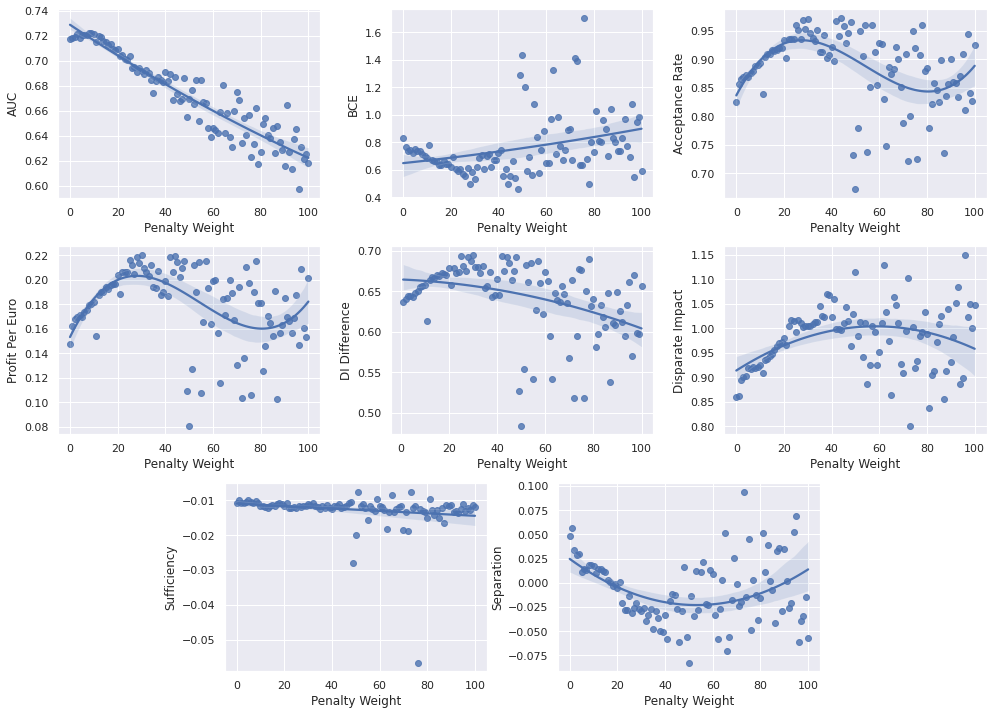

In [ ]:
# Plot all metrics

fig = plt.figure(figsize=(14,10))

plot1 = plt.subplot2grid((6, 6), (0, 0), rowspan=2, colspan=2)
plot2 = plt.subplot2grid((6, 6), (0, 2), rowspan=2, colspan=2)
plot3 = plt.subplot2grid((6, 6), (0, 4), rowspan=2, colspan=2)
plot4 = plt.subplot2grid((6, 6), (2, 0), rowspan=2, colspan=2)
plot5 = plt.subplot2grid((6, 6), (2, 2), rowspan=2, colspan=2)
plot6 = plt.subplot2grid((6, 6), (2, 4), rowspan=2, colspan=2)
plot7 = plt.subplot2grid((6, 6), (4, 1), rowspan=2, colspan=2)
plot8 = plt.subplot2grid((6, 6), (4, 3), rowspan=2, colspan=2)

plot1 = sns.regplot(x="Penalty Weight",y="AUC", data=dio_metrics_gmsc, order = 2, ax=plot1)

plot2 = sns.regplot(x="Penalty Weight",y="BCE", data=dio_metrics_gmsc, order = 2, ax=plot2)

plot3 = sns.regplot(x="Penalty Weight",y="Acceptance Rate", data=dio_metrics_gmsc, order = 3, ax=plot3)

plot4 = sns.regplot(x="Penalty Weight",y="Profit Per Euro", data=dio_metrics_gmsc, order = 3, ax=plot4)

plot5 = sns.regplot(x="Penalty Weight",y="DI Difference", data=dio_metrics_gmsc, order = 2, ax=plot5)

plot6 = sns.regplot(x="Penalty Weight",y="Disparate Impact", data=dio_metrics_gmsc, order = 2, ax=plot6)

plot7 = sns.regplot(x="Penalty Weight",y="Predictive Parity Difference (Sufficiency)", data=dio_metrics_gmsc, order = 1, ax=plot7)
plot7.set(xlabel='Penalty Weight', ylabel='Sufficiency')

plot8 = sns.regplot(x="Penalty Weight",y="Average Odds Difference (Separation)", data=dio_metrics_gmsc, order = 2, ax=plot8)
plot8.set(xlabel='Penalty Weight', ylabel='Separation')

plt.tight_layout()
plt.show()
fig.savefig("DIO GMSC METRICS",dpi=300)

In [ ]:
# Select columns relevant for correlation analysis
dio_metrics_gmsc = dio_metrics_gmsc[['Penalty Weight', 
                                      'AUC', 
                                      'MSE', 
                                      'BCE', 
                                      'Profit Per Euro', 
                                      'DI Difference', 
                                      'Disparate Impact', 
                                      'Average Odds Difference (Separation)', 
                                      'Predictive Parity Difference (Sufficiency)', 
                                      'Acceptance Rate']]

In [ ]:
# Spearman correlation matrix
dio_metrics_gmsc_corr = dio_metrics_gmsc.astype('float64').corr(method='spearman')
dio_metrics_gmsc_corr

,Penalty Weight,AUC,MSE,BCE,Profit Per Euro,DI Difference,Disparate Impact,Average Odds Difference (Separation),Predictive Parity Difference (Sufficiency),Acceptance Rate
Penalty Weight,1.000000,-0.942656,0.246465,0.352964,-0.271765,-0.420606,0.215562,-0.145347,-0.483634,-0.290949
AUC,-0.942656,1.000000,-0.233955,-0.366372,0.252848,0.422802,-0.325160,0.261025,0.462935,0.275923
MSE,0.246465,-0.233955,1.000000,0.964333,-0.950181,-0.927849,-0.220431,0.213547,-0.193826,-0.962679
BCE,0.352964,-0.366372,0.964333,1.000000,-0.950763,-0.952943,-0.171392,0.178626,-0.192801,-0.958905
Profit Per Euro,-0.271765,0.252848,-0.950181,-0.950763,1.000000,0.969193,0.283413,-0.296459,0.146803,0.996179
DI Difference,-0.420606,0.422802,-0.927849,-0.952943,0.969193,1.000000,0.104458,-0.114875,0.269859,0.977162
Disparate Impact,0.215562,-0.325160,-0.220431,-0.171392,0.283413,0.104458,1.000000,-0.917100,-0.428492,0.251485
Average Odds Difference (Separation),-0.145347,0.261025,0.213547,0.178626,-0.296459,-0.114875,-0.917100,1.000000,0.429971,-0.261642
Predictive Parity Difference (Sufficiency),-0.483634,0.462935,-0.193826,-0.192801,0.146803,0.269859,-0.428492,0.429971,1.000000,0.176308
Acceptance Rate,-0.290949,0.275923,-0.962679,-0.958905,0.996179,0.977162,0.251485,-0.261642,0.176308,1.000000


In [ ]:
# Calculate p-values for the Spearman correlation coefficients
dio_metrics_gmsc_array = dio_metrics_gmsc.to_numpy()
rho, pval = stats.spearmanr(dio_metrics_gmsc_array, nan_policy='omit')
pd.DataFrame(pval, columns=dio_metrics_gmsc_corr.columns, index=dio_metrics_gmsc_corr.index).round(6)

,Penalty Weight,AUC,MSE,BCE,Profit Per Euro,DI Difference,Disparate Impact,Average Odds Difference (Separation),Predictive Parity Difference (Sufficiency),Acceptance Rate
Penalty Weight,0.000000,0.000000,0.012971,0.000294,0.005975,0.000013,0.030393,0.146990,0.000000,0.003160
AUC,0.000000,0.000000,0.018536,0.000165,0.010740,0.000012,0.000907,0.008377,0.000001,0.005224
MSE,0.012971,0.018536,0.000000,0.000000,0.000000,0.000000,0.026757,0.032016,0.052119,0.000000
BCE,0.000294,0.000165,0.000000,0.000000,0.000000,0.000000,0.086578,0.073902,0.053399,0.000000
Profit Per Euro,0.005975,0.010740,0.000000,0.000000,0.000000,0.000000,0.004080,0.002610,0.142939,0.000000
DI Difference,0.000013,0.000012,0.000000,0.000000,0.000000,0.000000,0.301003,0.255085,0.006623,0.000000
Disparate Impact,0.030393,0.000907,0.026757,0.086578,0.004080,0.301003,0.000000,0.000000,0.000008,0.011186
Average Odds Difference (Separation),0.146990,0.008377,0.032016,0.073902,0.002610,0.255085,0.000000,0.000000,0.000007,0.008219
Predictive Parity Difference (Sufficiency),0.000000,0.000001,0.052119,0.053399,0.142939,0.006623,0.000008,0.000007,0.000000,0.077790
Acceptance Rate,0.003160,0.005224,0.000000,0.000000,0.000000,0.000000,0.011186,0.008219,0.077790,0.000000


###Pareto Frontiers

In [ ]:
# Create two-column dataframes to find the Pareto efficient combinations
dio_metrics_gmsc_1 = dio_metrics_gmsc[['Profit Per Euro', 'DI Difference']]
dio_metrics_gmsc_2 = dio_metrics_gmsc[['Profit Per Euro', 'Average Odds Difference (Separation)']]
dio_metrics_gmsc_3 = dio_metrics_gmsc[['AUC', 'Average Odds Difference (Separation)']]
dio_metrics_gmsc_4 = dio_metrics_gmsc[['AUC', 'DI Difference']]

# Only separation larger than 0
dio_metrics_gmsc_2 = dio_metrics_gmsc_2[dio_metrics_gmsc_2['Average Odds Difference (Separation)']>=0]
dio_metrics_gmsc_3 = dio_metrics_gmsc_3[dio_metrics_gmsc_3['Average Odds Difference (Separation)']>=0]

# Find Pareto efficient solutions for each dataframe
dio_metrics_gmsc_1['pareto'] = find_skyline_bn_min_max(df=dio_metrics_gmsc_1, to_max=['Profit Per Euro'], to_min=['DI Difference'])
dio_metrics_gmsc_1["pareto"] = dio_metrics_gmsc_1["pareto"].astype(int)
dio_metrics_gmsc_2['pareto'] = find_skyline_bn_min_max(df=dio_metrics_gmsc_2, to_max=['Profit Per Euro'], to_min=['Average Odds Difference (Separation)'])
dio_metrics_gmsc_2["pareto"] = dio_metrics_gmsc_2["pareto"].astype(int)
dio_metrics_gmsc_3['pareto'] = find_skyline_bn_min_max(df=dio_metrics_gmsc_3, to_max=['AUC'], to_min=['Average Odds Difference (Separation)'])
dio_metrics_gmsc_3["pareto"] = dio_metrics_gmsc_3["pareto"].astype(int)
dio_metrics_gmsc_4['pareto'] = find_skyline_bn_min_max(df=dio_metrics_gmsc_4, to_max=['AUC'], to_min=['DI Difference'])
dio_metrics_gmsc_4["pareto"] = dio_metrics_gmsc_4["pareto"].astype(int)

In [ ]:
# Extract and sort Pareto efficient solutions

dio_pareto_gmsc_1 = dio_metrics_gmsc_1[dio_metrics_gmsc_1.pareto==1]
dio_pareto_gmsc_1.sort_values(by=['Profit Per Euro', 'DI Difference'], inplace=True)

dio_pareto_gmsc_2 = dio_metrics_gmsc_2[dio_metrics_gmsc_2.pareto==1]
dio_pareto_gmsc_2.sort_values(by=['Profit Per Euro', 'Average Odds Difference (Separation)'], inplace=True)

dio_pareto_gmsc_3 = dio_metrics_gmsc_3[dio_metrics_gmsc_3.pareto==1]
dio_pareto_gmsc_3.sort_values(by=['AUC', 'Average Odds Difference (Separation)'], inplace=True)

dio_pareto_gmsc_4 = dio_metrics_gmsc_4[dio_metrics_gmsc_4.pareto==1]
dio_pareto_gmsc_4.sort_values(by=['AUC', 'DI Difference'], inplace=True)

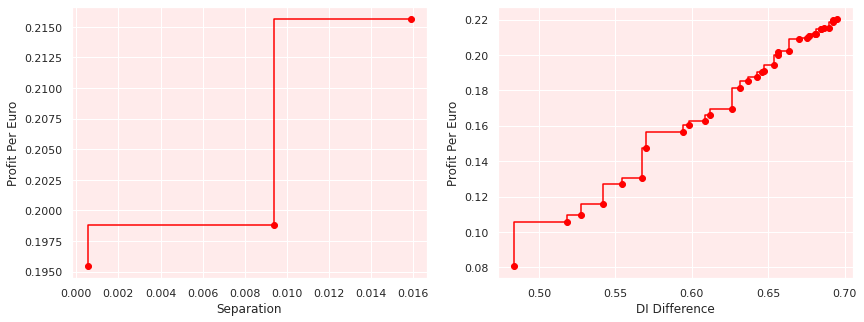

<Figure size 432x288 with 0 Axes>

In [ ]:
# Plot and save the Pareto frontiers 
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False, figsize=(14,5))
ax1.step(dio_pareto_gmsc_2['Average Odds Difference (Separation)'], dio_pareto_gmsc_2['Profit Per Euro'], '-o', where='pre', color='red')
ax2.step(dio_pareto_gmsc_1['DI Difference'], dio_pareto_gmsc_1['Profit Per Euro'], '-o', where='pre', color='red')
ax1.set_xlabel('Separation')
ax1.set_ylabel('Profit Per Euro')
ax2.set_xlabel('DI Difference')
ax2.set_ylabel('Profit Per Euro')
ax1.patch.set_facecolor('red')
ax1.patch.set_alpha(0.08)
ax2.patch.set_facecolor('red')
ax2.patch.set_alpha(0.08)
plt.show()
plt.tight_layout()
plt.show()
fig.savefig("PARETO DIO GMSC PROFIT", dpi=300, bbox_inches='tight')

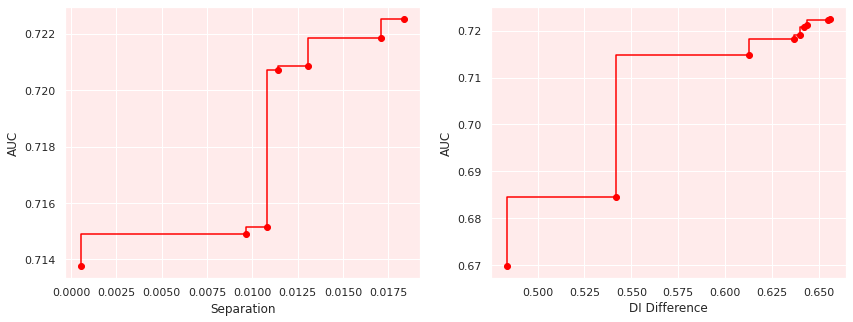

<Figure size 432x288 with 0 Axes>

In [ ]:
# Plot and save the Pareto frontiers 
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False, figsize=(14,5))
ax1.step(dio_pareto_gmsc_3['Average Odds Difference (Separation)'], dio_pareto_gmsc_3['AUC'], '-o', where='pre', color='red')
ax2.step(dio_pareto_gmsc_4['DI Difference'], dio_pareto_gmsc_4['AUC'], '-o', where='pre', color='red')
ax1.set_xlabel('Separation')
ax1.set_ylabel('AUC')
ax2.set_xlabel('DI Difference')
ax2.set_ylabel('AUC')
ax1.patch.set_facecolor('red')
ax1.patch.set_alpha(0.08)
ax2.patch.set_facecolor('red')
ax2.patch.set_alpha(0.08)
plt.show()
plt.tight_layout()
plt.show()
fig.savefig("PARETO DIO GMSC AUC", dpi=300, bbox_inches='tight')

###Prediction Histogram Animation

In [ ]:
# Make and save predictions for penalty weights 0 to 100

preds_dio_gmsc = []

for i in range(101):
  preds_dio_gmsc.append(make_predictions(penalty_weight=i,input_features=10,num_hid_units_1=20,num_hid_units_2=10,batch_size=128,learning_rate=0.0001,epochs=50))

np.save('preds_dio_gmsc.npy', preds_dio_gmsc, allow_pickle=True)

In [ ]:
# Running this line twice fixes a bug that produces an error when showing animations
%matplotlib notebook
%matplotlib notebook

In [ ]:
fig, ax = plt.subplots(1,1,figsize=(15,10))

def animate(i):
  '''Creates histograms for animation'''
  plt.cla()
  ax = plt.hist(preds_dio_gmsc[i],50)
  plt.title("Penalty Weight: " +str(i))
  plt.xlim(0, 1)
  plt.ylim(0, 4000)

# Create and show animation of consecutive histograms for different penalty weights
ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(preds_dio_gmsc),interval=200,blit=False)
HTML(ani.to_html5_video())

<IPython.core.display.Javascript object>

In [ ]:
# Reset the output option
%matplotlib inline

#Adversarial Debiasing

In [ ]:
# Close possibly open sessions and define session

try:
  sess.close()
  K.clear_session()
except:
  pass

sess = K.get_session()

##Repeated Testing Loop Adversarial Debiasing

In [ ]:
def adv_debias(lower_bound, upper_bound, interval, num_hidden_units, batch_size, epochs):
  '''Builds and trains a model using adversarial debiasing with increasing adversary loss weights, then returns relevant metrics for each weight in a dataframe. Takes the lowest weight, highest weight, weight intervals, number of hidden units, batch size and number of epochs as inputs.'''

  # Create dataframe for saving the metrics
  ad_metrics = pd.DataFrame(columns = ['Adversary Loss Weight','Profit','Profit Per Euro','AUC','MSE','BCE','DI Difference','Mean DI Privileged','Mean DI Unprivileged','Disparate Impact','Statistical Parity Difference (Independence)','Average Odds Difference (Separation)','Predictive Parity Difference (Sufficiency)','Acceptance Rate'])

  # Define weight range and intervals
  ad_weights = np.arange(lower_bound, upper_bound, interval)

  # Build and train a model for each weight, then calculate all metrics
  for index, item in tqdm(enumerate(ad_weights)):

    reset_random_seeds(1)

    sess = K.get_session()

    # Define model
    AD_model = AdversarialDebiasing(privileged_groups = privileged_groups,
                                unprivileged_groups = unprivileged_groups,
                                scope_name='AD_classifier',
                                debias=True,
                                sess=sess, 
                                num_epochs=epochs, 
                                batch_size=batch_size, 
                                classifier_num_hidden_units=num_hidden_units, 
                                seed=1,
                                adversary_loss_weight=item)
    
    # Train model
    AD_model.fit(dataset_train)

    # Make predictions
    pred_test = AD_model.predict(dataset_test)

    # Create combined data set to make use of the aif360 metric functionality
    classified_metric_test = ClassificationMetric(dataset_test, 
                                                    pred_test,
                                                    unprivileged_groups=unprivileged_groups,
                                                    privileged_groups=privileged_groups)

    # Save predictions, true labels and privileged class membership to lists

    scores = pred_test.scores.tolist()
    scores = [item for sublist in scores for item in sublist]

    labels = dataset_test.labels.tolist()
    labels = [item for sublist in labels for item in sublist]

    priv = pred_test.protected_attributes.tolist()
    priv = [item for sublist in priv for item in sublist]

    # Calculate metrics from probabilistic predictions and save them in the dataframe
    ad_metrics.loc[index,'Adversary Loss Weight'] = item
    ad_metrics.loc[index,'MSE'] = mean_squared_error(labels, scores)
    ad_metrics.loc[index,'BCE'] = bin_cross_ent(np.asarray(labels), np.asarray(scores))
    ad_metrics.loc[index,'Statistical Parity Difference (Independence)'] = round(classified_metric_test.statistical_parity_difference(),5)
    ad_metrics.loc[index,'Average Odds Difference (Separation)'] = round(classified_metric_test.average_odds_difference(),5)
    ad_metrics.loc[index,'AUC'] = get_auc(labels, scores)
 
    # Transform lists to series for the function to work
    labels  =   pd.Series(labels)
    scores  =   pd.Series(scores)
    amount  =   pd.Series(amount_unscaled)
    priv    =   pd.Series(priv)
    diff, av_priv, av_unpriv = delayed_impact_group_specific_value(y_true=labels, y_pred=scores, y_priv=priv)

    # Turn probabilistic predictions into binary predictions with the previously defined cutoff
    scores = [1 if x >= tau else 0 for x in scores]
    scores = pd.Series(scores)

    # Create combined dataframe from predictions and privileged group membership
    df = pd.DataFrame(np.concatenate([pd.DataFrame(scores), pd.DataFrame(priv)], axis=1))

    # Calculate metrics from binary predictions and save them in the dataframe
    ad_metrics.loc[index,'Disparate Impact'] = disparate_impact(df)
    ad_metrics.loc[index,'DI Difference'] = diff
    ad_metrics.loc[index,'Mean DI Privileged'] = av_priv
    ad_metrics.loc[index,'Mean DI Unprivileged'] = av_unpriv
    ad_metrics.loc[index,'Acceptance Rate'] = get_acceptance_rate(scores, tau)
    ad_metrics.loc[index,'Profit'] = round(calc_profit(y_true=labels, y_pred=scores, amount=amount, interest_rate=0.2644), 2)
    ad_metrics.loc[index,'Profit Per Euro'] = round(calc_profit(y_true=labels, y_pred=scores, amount=amount, interest_rate=0.2644), 2) / sum(amount)
    
    #In the unlikely case of a model that predicts no negatives, a division by zero error would stop the loop when calculating the sufficiency
    try:
      ad_metrics.loc[index,'Predictive Parity Difference (Sufficiency)'] = predictive_parity_difference(labels, scores, priv)
    except:
      pass

    print(ad_metrics.head())

    del AD_model
    sess.close()
    K.clear_session()

  return ad_metrics

##Simulated Data

###Data Preprocessing

In [ ]:
# Define the privileged and unprivileged group
privileged_groups   = [{'D1': 1}] 
unprivileged_groups = [{'D1': 0}]

# Split data into train and test set
X = sim.drop('BAD', axis=1).copy()
y = sim['BAD'].copy()
reset_random_seeds(1)
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1, stratify=y, test_size=0.3, shuffle = True)

# Merge X and y back together for aif360
train_data = pd.concat([X_train, y_train], axis=1)
test_data = pd.concat([X_test, y_test], axis=1)

# Create aif360 BinaryLabelDatasets from the DataFrames and save unscaled amount values
dataset_train = aif360.datasets.BinaryLabelDataset(df=train_data, label_names=['BAD'], protected_attribute_names=['D1'], privileged_protected_attributes=['D1'])
dataset_test = aif360.datasets.BinaryLabelDataset(df=test_data, label_names=['BAD'], protected_attribute_names=['D1'], privileged_protected_attributes=['D1'])
amount_unscaled = pd.DataFrame(dataset_test.features)[9]

# Scale the features
min_max_scaler = MaxAbsScaler()
dataset_train.features = min_max_scaler.fit_transform(dataset_train.features)
dataset_test.features = min_max_scaler.transform(dataset_test.features)

###Determining a static cutoff

In [ ]:
# Create the adversarial debiasing model similar to the DIO model
AD_model = AdversarialDebiasing(privileged_groups = privileged_groups,
                                unprivileged_groups = unprivileged_groups,
                                scope_name='AD_classifier',
                                debias=False,
                                sess=sess, 
                                num_epochs=50, 
                                batch_size=128, 
                                classifier_num_hidden_units=25, 
                                seed=1,
                                adversary_loss_weight=0)

# Train the model
AD_model.fit(dataset_train)

# Make predictions
pred_test = AD_model.predict(dataset_test)

# Extract predictions, true labels sensitive group membership and transform them into lists

scores = pred_test.scores.tolist()
scores = [item for sublist in scores for item in sublist]

labels = dataset_test.labels.tolist()
labels = [item for sublist in labels for item in sublist]

priv = pred_test.protected_attributes.tolist()
priv = [item for sublist in priv for item in sublist]

# Calculate the acceptance rate for 100 different thresholds

acceptance = pd.DataFrame(columns = ['Cutoff','Acceptance Rate'])

items = np.arange(0.00, 1.01, 0.01)

for index, item in enumerate(items):
  ar = round(get_acceptance_rate(scores, item),4)
  acceptance.loc[index,'Cutoff'] = round(item,2)
  acceptance.loc[index,'Acceptance Rate'] = ar

epoch 0; iter: 0; batch classifier loss: 0.758450
epoch 0; iter: 200; batch classifier loss: 0.550626
epoch 0; iter: 400; batch classifier loss: 0.449983
epoch 1; iter: 0; batch classifier loss: 0.495872
epoch 1; iter: 200; batch classifier loss: 0.397758
epoch 1; iter: 400; batch classifier loss: 0.352508
epoch 2; iter: 0; batch classifier loss: 0.357425
epoch 2; iter: 200; batch classifier loss: 0.382404
epoch 2; iter: 400; batch classifier loss: 0.367195
epoch 3; iter: 0; batch classifier loss: 0.381508
epoch 3; iter: 200; batch classifier loss: 0.358653
epoch 3; iter: 400; batch classifier loss: 0.380564
epoch 4; iter: 0; batch classifier loss: 0.525124
epoch 4; iter: 200; batch classifier loss: 0.332606
epoch 4; iter: 400; batch classifier loss: 0.419857
epoch 5; iter: 0; batch classifier loss: 0.411085
epoch 5; iter: 200; batch classifier loss: 0.351545
epoch 5; iter: 400; batch classifier loss: 0.376222
epoch 6; iter: 0; batch classifier loss: 0.326072


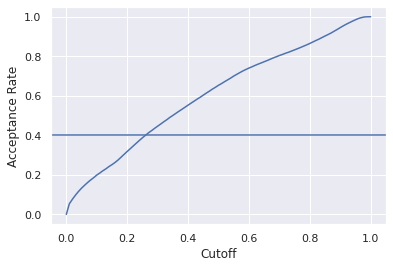

In [ ]:
graph = sns.lineplot(data=acceptance,x='Cutoff',y='Acceptance Rate')
graph.axhline(0.4)
graph.figure.savefig("Cutoff AD Sim", dpi=300, bbox_inches='tight') 

In [ ]:
# Choose threshold that results in an acceptance rate close to 40%
acceptance[(acceptance['Acceptance Rate'] < 0.45) & (acceptance['Acceptance Rate'] > 0.35)]

,Cutoff,Acceptance Rate
8,0.08,0.3685
9,0.09,0.3945
10,0.1,0.4195
11,0.11,0.4421


###Testing

####Range: 0.000 - 0.080
####Interval: 0.001

In [ ]:
# Set the cutoff value as previously defined
tau = 0.09

In [ ]:
# Close possibly open sessions, a new one is defined in the loop function
try:
  sess.close()
  K.clear_session()
except:
  pass

In [ ]:
ad_metrics_sim = adv_debias(lower_bound=0.000, upper_bound=0.081, interval=0.001, num_hidden_units=25, batch_size=128, epochs=50)

0it [00:00, ?it/s]

epoch 0; iter: 0; batch classifier loss: 0.758450; batch adversarial loss: 0.717922
epoch 0; iter: 200; batch classifier loss: 0.558457; batch adversarial loss: 0.695615
epoch 0; iter: 400; batch classifier loss: 0.450732; batch adversarial loss: 0.672844
epoch 1; iter: 0; batch classifier loss: 0.485461; batch adversarial loss: 0.661612
epoch 1; iter: 200; batch classifier loss: 0.392688; batch adversarial loss: 0.646540
epoch 1; iter: 400; batch classifier loss: 0.356260; batch adversarial loss: 0.610681
epoch 2; iter: 0; batch classifier loss: 0.360775; batch adversarial loss: 0.634284
epoch 2; iter: 200; batch classifier loss: 0.385918; batch adversarial loss: 0.644846
epoch 2; iter: 400; batch classifier loss: 0.366582; batch adversarial loss: 0.684123
epoch 3; iter: 0; batch classifier loss: 0.379763; batch adversarial loss: 0.615983
epoch 3; iter: 200; batch classifier loss: 0.354214; batch adversarial loss: 0.620763
epoch 3; iter: 400; batch classifier loss: 0.379363; batch adv

1it [01:05, 65.49s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   

       BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0  0.37064      0.050333           0.204067             0.153733   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   

  Average Odds Difference (Separation)  \
0                              0.26294   

  Predictive Parity Difference (Sufficiency) Acceptance Rate  
0                                   0.007986          0.3966  
epoch 0; iter: 0; batch classifier loss: 0.758450; batch adversarial loss: 0.717922
epoch 0; iter: 200; batch classifier loss: 0.556125; batch adversarial loss: 0.695951
epoch 0; iter: 400; batch classifier loss: 0.448852; batch adversarial loss: 0.676124
epoch 1; iter: 0; batch classifier loss: 0.487176; batch adversarial loss: 0.672273
epoch 1; iter: 200; batch 

2it [02:10, 65.45s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   
1         0.772666                                       0.1783   

  Average Odds Difference (Separation)  \
0                              0.26294   
1                              0.20235   

  Predictive Parity Difference (Sufficiency) Acceptance Rate  
0                                   0.007986          0.3966  
1                                   0.004536          0.4315  
epoch 0; iter: 0; batch classifier loss: 0.75845

3it [03:15, 64.83s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   
1         0.772666                                       0.1783   
2         0.782198                                      0.17616   

  Average Odds Difference (Separation)  \
0                              0.26294   
1                              0.20235   
2                          

4it [04:23, 66.18s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   
1         0.772666                                       0.1783   
2         0.782198                                      0.17616   
3         

5it [05:27, 65.59s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


6it [06:31, 65.01s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


7it [07:37, 65.28s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


8it [08:41, 65.02s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


9it [09:45, 64.55s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


10it [10:49, 64.39s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


11it [11:54, 64.48s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


12it [13:02, 65.72s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


13it [14:07, 65.53s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


14it [15:14, 65.85s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


15it [16:19, 65.58s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


16it [17:25, 65.85s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


17it [18:32, 66.03s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


18it [19:39, 66.33s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


19it [20:45, 66.30s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


20it [21:50, 66.02s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


21it [22:56, 66.03s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


22it [24:03, 66.18s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


23it [25:10, 66.38s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


24it [26:18, 66.83s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


25it [27:23, 66.22s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


26it [28:28, 65.90s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


27it [29:34, 65.97s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


28it [30:42, 66.57s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


29it [31:50, 67.04s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


30it [32:58, 67.27s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


31it [34:04, 66.92s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


32it [35:09, 66.37s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


33it [36:15, 66.38s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


34it [37:22, 66.32s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


35it [38:27, 65.98s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


36it [39:35, 66.80s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


37it [40:41, 66.56s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


38it [41:51, 67.58s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


39it [43:01, 68.23s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


40it [44:12, 68.89s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


41it [45:21, 69.09s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


42it [46:27, 68.25s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


43it [47:41, 69.78s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


44it [48:51, 70.06s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


45it [49:59, 69.15s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


46it [51:07, 69.06s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


47it [52:16, 69.00s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


48it [53:26, 69.10s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


49it [54:38, 70.18s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


50it [55:50, 70.52s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


51it [56:57, 69.52s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


52it [58:04, 68.83s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


53it [59:13, 68.96s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


54it [1:00:25, 69.68s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


55it [1:01:34, 69.52s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


56it [1:02:47, 70.76s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


57it [1:03:57, 70.38s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


58it [1:05:05, 69.81s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


59it [1:06:13, 69.01s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


60it [1:07:27, 70.76s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


61it [1:08:39, 71.00s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


62it [1:09:51, 71.36s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


63it [1:11:01, 71.02s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


64it [1:12:14, 71.54s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


65it [1:13:24, 71.08s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


66it [1:14:33, 70.38s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


67it [1:15:41, 69.84s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


68it [1:16:51, 69.72s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


69it [1:18:03, 70.34s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


70it [1:19:12, 70.09s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


71it [1:20:19, 69.22s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


72it [1:21:29, 69.47s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


73it [1:22:46, 71.55s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


74it [1:23:56, 71.22s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


75it [1:25:14, 73.21s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


76it [1:26:39, 76.85s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


77it [1:27:53, 75.96s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


78it [1:29:02, 73.77s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


79it [1:30:13, 72.95s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


80it [1:31:24, 72.26s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


81it [1:32:33, 68.56s/it]

  Adversary Loss Weight      Profit Profit Per Euro       AUC       MSE  \
0                   0.0 -1259020.32       -0.005991  0.858334  0.117284   
1                 0.001  1958465.18        0.009319  0.856879  0.118076   
2                 0.002  1840808.79        0.008759  0.856748  0.118126   
3                 0.003  2509771.81        0.011942  0.856621  0.118311   
4                 0.004  2485191.63        0.011825  0.856516   0.11837   

        BCE DI Difference Mean DI Privileged Mean DI Unprivileged  \
0   0.37064      0.050333           0.204067             0.153733   
1  0.372606      0.048367           0.214933             0.166567   
2  0.372731        0.0461             0.2134               0.1673   
3  0.373209      0.049867             0.2179             0.168033   
4  0.373354      0.048967           0.217367               0.1684   

  Disparate Impact Statistical Parity Difference (Independence)  \
0         0.742798                                      0.22539   


In [ ]:
ad_metrics_sim

,Unnamed: 0,Adversary Loss Weight,Profit,Profit Per Euro,AUC,MSE,BCE,DI Difference,Mean DI Privileged,Mean DI Unprivileged,Disparate Impact,Statistical Parity Difference (Independence),Average Odds Difference (Separation),Predictive Parity Difference (Sufficiency),Acceptance Rate
0,0,0.000,-1259020.32,-0.005991,0.858334,0.117284,0.370640,0.050333,0.204067,0.153733,0.742798,0.22539,0.26294,0.007986,0.396600
1,1,0.001,1958465.18,0.009319,0.856879,0.118076,0.372606,0.048367,0.214933,0.166567,0.772666,0.17830,0.20235,0.004536,0.431500
2,2,0.002,1840808.79,0.008759,0.856748,0.118126,0.372731,0.046100,0.213400,0.167300,0.782198,0.17616,0.19870,0.004331,0.430200
3,3,0.003,2509771.81,0.011942,0.856621,0.118311,0.373209,0.049867,0.217900,0.168033,0.768869,0.16827,0.18714,0.004526,0.437033
4,4,0.004,2485191.63,0.011825,0.856516,0.118370,0.373354,0.048967,0.217367,0.168400,0.773150,0.16580,0.18316,0.004253,0.436967
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76,76,0.076,2050383.27,0.009756,0.852097,0.120941,0.379405,0.032967,0.207500,0.174533,0.861855,0.10491,0.09856,-0.003515,0.432633
77,77,0.077,2249423.48,0.010703,0.851680,0.121179,0.379844,0.037033,0.210300,0.173267,0.835513,0.09715,0.08630,-0.000469,0.434767
78,78,0.078,2510662.78,0.011946,0.851293,0.121491,0.380707,0.036600,0.211067,0.174467,0.841873,0.09364,0.08212,-0.001735,0.438033
79,79,0.079,2321946.45,0.011048,0.851610,0.121238,0.380003,0.037100,0.210567,0.173467,0.835927,0.09628,0.08515,-0.000647,0.435533


In [ ]:
ad_metrics_sim = ad_metrics_sim.astype('float64')

In [ ]:
ad_metrics_sim.to_csv('ad_metrics_sim.csv')

In [ ]:
# Remove first row because it is a strong outlier
ad_metrics_sim = ad_metrics_sim.iloc[1: , :]

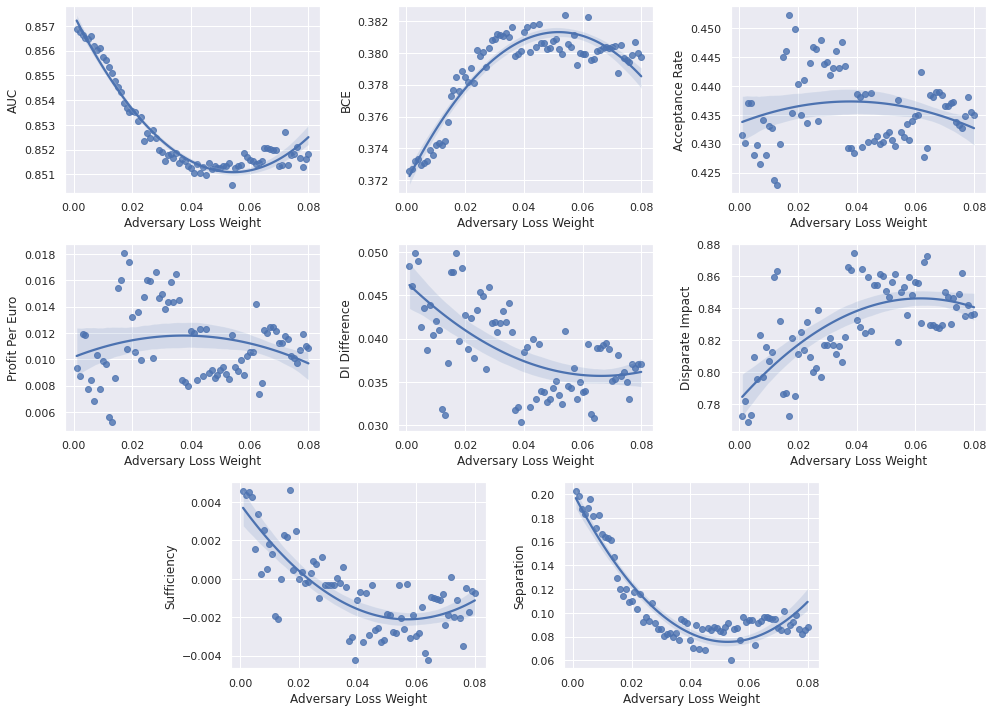

In [ ]:
# Plot all metrics

fig = plt.figure(figsize=(14,10))

plot1 = plt.subplot2grid((6, 6), (0, 0), rowspan=2, colspan=2)
plot2 = plt.subplot2grid((6, 6), (0, 2), rowspan=2, colspan=2)
plot3 = plt.subplot2grid((6, 6), (0, 4), rowspan=2, colspan=2)
plot4 = plt.subplot2grid((6, 6), (2, 0), rowspan=2, colspan=2)
plot5 = plt.subplot2grid((6, 6), (2, 2), rowspan=2, colspan=2)
plot6 = plt.subplot2grid((6, 6), (2, 4), rowspan=2, colspan=2)
plot7 = plt.subplot2grid((6, 6), (4, 1), rowspan=2, colspan=2)
plot8 = plt.subplot2grid((6, 6), (4, 3), rowspan=2, colspan=2)

plot1 = sns.regplot(x="Adversary Loss Weight",y="AUC", data=ad_metrics_sim, order = 2, ax=plot1)

plot2 = sns.regplot(x="Adversary Loss Weight",y="BCE", data=ad_metrics_sim, order = 2, ax=plot2)

plot3 = sns.regplot(x="Adversary Loss Weight",y="Acceptance Rate", data=ad_metrics_sim, order = 2, ax=plot3)

plot4 = sns.regplot(x="Adversary Loss Weight",y="Profit Per Euro", data=ad_metrics_sim, order = 2, ax=plot4)

plot5 = sns.regplot(x="Adversary Loss Weight",y="DI Difference", data=ad_metrics_sim, order = 2, ax=plot5)

plot6 = sns.regplot(x="Adversary Loss Weight",y="Disparate Impact", data=ad_metrics_sim, order = 2, ax=plot6)

plot7 = sns.regplot(x="Adversary Loss Weight",y="Predictive Parity Difference (Sufficiency)", data=ad_metrics_sim, order = 2, ax=plot7)
plot7.set(xlabel='Adversary Loss Weight', ylabel='Sufficiency')

plot8 = sns.regplot(x="Adversary Loss Weight",y="Average Odds Difference (Separation)", data=ad_metrics_sim, order = 2, ax=plot8)
plot8.set(xlabel='Adversary Loss Weight', ylabel='Separation')

plt.tight_layout()
plt.show()
fig.savefig("AD SIM METRICS",dpi=300)

In [ ]:
# Select columns relevant for correlation analysis
ad_metrics_sim = ad_metrics_sim[['Adversary Loss Weight', 
                                  'AUC', 
                                  'MSE', 
                                  'BCE', 
                                  'Profit Per Euro', 
                                  'DI Difference', 
                                  'Disparate Impact', 
                                  'Average Odds Difference (Separation)', 
                                  'Predictive Parity Difference (Sufficiency)', 
                                  'Acceptance Rate']]

In [ ]:
# Spearman correlation matrix
ad_metrics_sim_corr = ad_metrics_sim.astype('float64').corr(method='spearman')
ad_metrics_sim_corr

,Adversary Loss Weight,AUC,MSE,BCE,Profit Per Euro,DI Difference,Disparate Impact,Average Odds Difference (Separation),Predictive Parity Difference (Sufficiency),Acceptance Rate
Adversary Loss Weight,1.000000,-0.656259,0.594679,0.516526,0.017112,-0.557495,0.610056,-0.572199,-0.663338,0.013901
AUC,-0.656259,1.000000,-0.859939,-0.826278,0.044046,0.554002,-0.607595,0.876793,0.687037,0.038562
MSE,0.594679,-0.859939,1.000000,0.984505,0.326887,-0.216221,0.286076,-0.969245,-0.410080,0.332745
BCE,0.516526,-0.826278,0.984505,1.000000,0.370253,-0.161764,0.234529,-0.949226,-0.373816,0.376863
Profit Per Euro,0.017112,0.044046,0.326887,0.370253,1.000000,0.691398,-0.619269,-0.280872,0.472433,0.998939
DI Difference,-0.557495,0.554002,-0.216221,-0.161764,0.691398,1.000000,-0.992340,0.240320,0.927252,0.688406
Disparate Impact,0.610056,-0.607595,0.286076,0.234529,-0.619269,-0.992340,1.000000,-0.307314,-0.957736,-0.616450
Average Odds Difference (Separation),-0.572199,0.876793,-0.969245,-0.949226,-0.280872,0.240320,-0.307314,1.000000,0.407196,-0.285615
Predictive Parity Difference (Sufficiency),-0.663338,0.687037,-0.410080,-0.373816,0.472433,0.927252,-0.957736,0.407196,1.000000,0.470994
Acceptance Rate,0.013901,0.038562,0.332745,0.376863,0.998939,0.688406,-0.616450,-0.285615,0.470994,1.000000


In [ ]:
# Calculate p-values for the Spearman correlation coefficients
ad_metrics_sim_array = ad_metrics_sim.to_numpy()
rho, pval = stats.spearmanr(ad_metrics_sim_array, nan_policy='omit')
pd.DataFrame(pval, columns=ad_metrics_sim_corr.columns, index=ad_metrics_sim_corr.index).round(6)

,Adversary Loss Weight,AUC,MSE,BCE,Profit Per Euro,DI Difference,Disparate Impact,Average Odds Difference (Separation),Predictive Parity Difference (Sufficiency),Acceptance Rate
Adversary Loss Weight,0.000000,0.000000,0.000000,0.000001,0.880246,0.000000,0.000000,0.000000,0.000000,0.902595
AUC,0.000000,0.000000,0.000000,0.000000,0.698055,0.000000,0.000000,0.000000,0.000000,0.734154
MSE,0.000000,0.000000,0.000000,0.000000,0.003081,0.054060,0.010097,0.000000,0.000158,0.002563
BCE,0.000001,0.000000,0.000000,0.000000,0.000723,0.151700,0.036262,0.000000,0.000636,0.000570
Profit Per Euro,0.880246,0.698055,0.003081,0.000723,0.000000,0.000000,0.000000,0.011613,0.000010,0.000000
DI Difference,0.000000,0.000000,0.054060,0.151700,0.000000,0.000000,0.000000,0.031775,0.000000,0.000000
Disparate Impact,0.000000,0.000000,0.010097,0.036262,0.000000,0.000000,0.000000,0.005556,0.000000,0.000000
Average Odds Difference (Separation),0.000000,0.000000,0.000000,0.000000,0.011613,0.031775,0.005556,0.000000,0.000178,0.010224
Predictive Parity Difference (Sufficiency),0.000000,0.000000,0.000158,0.000636,0.000010,0.000000,0.000000,0.000178,0.000000,0.000010
Acceptance Rate,0.902595,0.734154,0.002563,0.000570,0.000000,0.000000,0.000000,0.010224,0.000010,0.000000


###Pareto Frontiers

In [ ]:
# Create two-column dataframes to find the Pareto efficient combinations
ad_metrics_sim_1 = ad_metrics_sim[['Profit Per Euro', 'DI Difference']]
ad_metrics_sim_2 = ad_metrics_sim[['Profit Per Euro', 'Average Odds Difference (Separation)']]
ad_metrics_sim_3 = ad_metrics_sim[['AUC', 'Average Odds Difference (Separation)']]
ad_metrics_sim_4 = ad_metrics_sim[['AUC', 'DI Difference']]

# Only separation larger than 0
ad_metrics_sim_2 = ad_metrics_sim_2[ad_metrics_sim_2['Average Odds Difference (Separation)']>=0]
ad_metrics_sim_3 = ad_metrics_sim_3[ad_metrics_sim_3['Average Odds Difference (Separation)']>=0]

# Find Pareto efficient solutions for each dataframe
ad_metrics_sim_1['pareto'] = find_skyline_bn_min_max(df=ad_metrics_sim_1, to_max=['Profit Per Euro'], to_min=['DI Difference'])
ad_metrics_sim_1["pareto"] = ad_metrics_sim_1["pareto"].astype(int)
ad_metrics_sim_2['pareto'] = find_skyline_bn_min_max(df=ad_metrics_sim_2, to_max=['Profit Per Euro'], to_min=['Average Odds Difference (Separation)'])
ad_metrics_sim_2["pareto"] = ad_metrics_sim_2["pareto"].astype(int)
ad_metrics_sim_3['pareto'] = find_skyline_bn_min_max(df=ad_metrics_sim_3, to_max=['AUC'], to_min=['Average Odds Difference (Separation)'])
ad_metrics_sim_3["pareto"] = ad_metrics_sim_3["pareto"].astype(int)
ad_metrics_sim_4['pareto'] = find_skyline_bn_min_max(df=ad_metrics_sim_4, to_max=['AUC'], to_min=['DI Difference'])
ad_metrics_sim_4["pareto"] = ad_metrics_sim_4["pareto"].astype(int)

In [ ]:
# Extract and sort Pareto efficient solutions

ad_pareto_sim_1 = ad_metrics_sim_1[ad_metrics_sim_1.pareto==1]
ad_pareto_sim_1.sort_values(by=['Profit Per Euro', 'DI Difference'], inplace=True)

ad_pareto_sim_2 = ad_metrics_sim_2[ad_metrics_sim_2.pareto==1]
ad_pareto_sim_2.sort_values(by=['Profit Per Euro', 'Average Odds Difference (Separation)'], inplace=True)

ad_pareto_sim_3 = ad_metrics_sim_3[ad_metrics_sim_3.pareto==1]
ad_pareto_sim_3.sort_values(by=['AUC', 'Average Odds Difference (Separation)'], inplace=True)

ad_pareto_sim_4 = ad_metrics_sim_4[ad_metrics_sim_4.pareto==1]
ad_pareto_sim_4.sort_values(by=['AUC', 'DI Difference'], inplace=True)

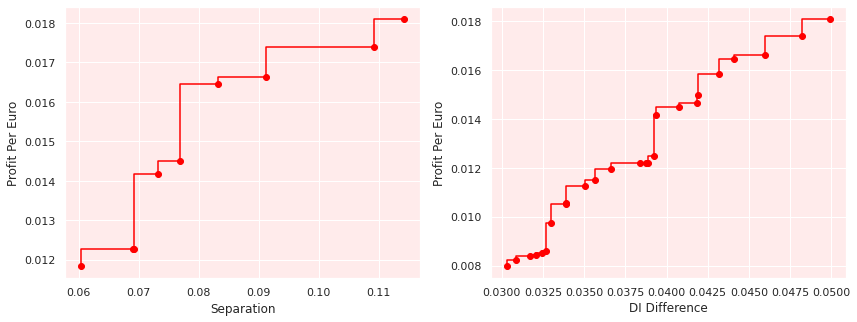

<Figure size 432x288 with 0 Axes>

In [ ]:
# Plot and save the Pareto frontiers 
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False, figsize=(14,5))
ax1.step(ad_pareto_sim_2['Average Odds Difference (Separation)'], ad_pareto_sim_2['Profit Per Euro'], '-o', where='pre', color='red')
ax2.step(ad_pareto_sim_1['DI Difference'], ad_pareto_sim_1['Profit Per Euro'], '-o', where='pre', color='red')
ax1.set_xlabel('Separation')
ax1.set_ylabel('Profit Per Euro')
ax2.set_xlabel('DI Difference')
ax2.set_ylabel('Profit Per Euro')
ax1.patch.set_facecolor('red')
ax1.patch.set_alpha(0.08)
ax2.patch.set_facecolor('red')
ax2.patch.set_alpha(0.08)
plt.show()
plt.tight_layout()
plt.show()
fig.savefig("PARETO AD SIM PROFIT", dpi=300, bbox_inches='tight')

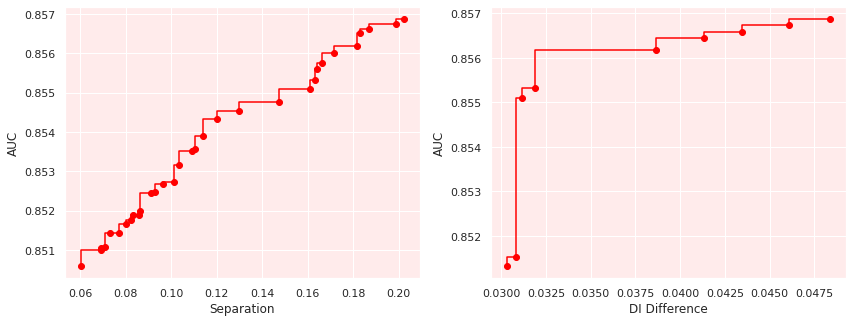

<Figure size 432x288 with 0 Axes>

In [ ]:
# Plot and save the Pareto frontiers 
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False, figsize=(14,5))
ax1.step(ad_pareto_sim_3['Average Odds Difference (Separation)'], ad_pareto_sim_3['AUC'], '-o', where='pre', color='red')
ax2.step(ad_pareto_sim_4['DI Difference'], ad_pareto_sim_4['AUC'], '-o', where='pre', color='red')
ax1.set_xlabel('Separation')
ax1.set_ylabel('AUC')
ax2.set_xlabel('DI Difference')
ax2.set_ylabel('AUC')
ax1.patch.set_facecolor('red')
ax1.patch.set_alpha(0.08)
ax2.patch.set_facecolor('red')
ax2.patch.set_alpha(0.08)
plt.show()
plt.tight_layout()
plt.show()
fig.savefig("PARETO AD SIM AUC", dpi=300, bbox_inches='tight')

###Prediction Histogram Animation

In [ ]:
# Close possibly open sessions and define session

try:
  sess.close()
  K.clear_session()
except:
  pass

sess = K.get_session()

In [ ]:
# Make and save predictions for penalty weights 1 to 100, again separated to decrease the overall runtime by restarting colab

preds_ad_sim = []

for i in tqdm(np.arange(0.000, 0.081, 0.001)):
  preds_ad_sim.append(make_predictions_ad(adversary_loss_weight=i, num_hidden_units=25, batch_size=128, epochs=50))

  0%|          | 0/81 [00:00<?, ?it/s]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.601935; batch adversarial loss: 0.701715
epoch 0; iter: 400; batch classifier loss: 0.444291; batch adversarial loss: 0.695493
epoch 1; iter: 0; batch classifier loss: 0.516774; batch adversarial loss: 0.692656
epoch 1; iter: 200; batch classifier loss: 0.382449; batch adversarial loss: 0.690923
epoch 1; iter: 400; batch classifier loss: 0.363237; batch adversarial loss: 0.669108
epoch 2; iter: 0; batch classifier loss: 0.388498; batch adversarial loss: 0.670371
epoch 2; iter: 200; batch classifier loss: 0.407386; batch adversarial loss: 0.681530
epoch 2; iter: 400; batch classifier loss: 0.393453; batch adversarial loss: 0.697995
epoch 3; iter: 0; batch classifier loss: 0.408025; batch adversarial loss: 0.638733
epoch 3; iter: 200; batch classifier loss: 0.344808; batch adversarial loss: 0.623389
epoch 3; iter: 400; batch classifier loss: 0.386918; batch adv

  1%|          | 1/81 [00:51<1:08:13, 51.16s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.610077; batch adversarial loss: 0.704286
epoch 0; iter: 400; batch classifier loss: 0.449997; batch adversarial loss: 0.695994
epoch 1; iter: 0; batch classifier loss: 0.522769; batch adversarial loss: 0.693437
epoch 1; iter: 200; batch classifier loss: 0.385453; batch adversarial loss: 0.691958
epoch 1; iter: 400; batch classifier loss: 0.363074; batch adversarial loss: 0.672505
epoch 2; iter: 0; batch classifier loss: 0.390158; batch adversarial loss: 0.673624
epoch 2; iter: 200; batch classifier loss: 0.407007; batch adversarial loss: 0.684479
epoch 2; iter: 400; batch classifier loss: 0.393335; batch adversarial loss: 0.701203
epoch 3; iter: 0; batch classifier loss: 0.401688; batch adversarial loss: 0.648472
epoch 3; iter: 200; batch classifier loss: 0.348955; batch adversarial loss: 0.635642
epoch 3; iter: 400; batch classifier loss: 0.382667; batch adv

  2%|▏         | 2/81 [01:42<1:07:32, 51.30s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.610382; batch adversarial loss: 0.704428
epoch 0; iter: 400; batch classifier loss: 0.450356; batch adversarial loss: 0.696057
epoch 1; iter: 0; batch classifier loss: 0.523154; batch adversarial loss: 0.693509
epoch 1; iter: 200; batch classifier loss: 0.385550; batch adversarial loss: 0.691999
epoch 1; iter: 400; batch classifier loss: 0.363042; batch adversarial loss: 0.672652
epoch 2; iter: 0; batch classifier loss: 0.390129; batch adversarial loss: 0.673716
epoch 2; iter: 200; batch classifier loss: 0.407029; batch adversarial loss: 0.684507
epoch 2; iter: 400; batch classifier loss: 0.393357; batch adversarial loss: 0.701273
epoch 3; iter: 0; batch classifier loss: 0.401699; batch adversarial loss: 0.648631
epoch 3; iter: 200; batch classifier loss: 0.348936; batch adversarial loss: 0.635986
epoch 3; iter: 400; batch classifier loss: 0.382997; batch adv

  4%|▎         | 3/81 [02:33<1:06:44, 51.33s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.610748; batch adversarial loss: 0.704589
epoch 0; iter: 400; batch classifier loss: 0.450657; batch adversarial loss: 0.696062
epoch 1; iter: 0; batch classifier loss: 0.523484; batch adversarial loss: 0.693558
epoch 1; iter: 200; batch classifier loss: 0.385643; batch adversarial loss: 0.692057
epoch 1; iter: 400; batch classifier loss: 0.363116; batch adversarial loss: 0.672860
epoch 2; iter: 0; batch classifier loss: 0.390234; batch adversarial loss: 0.673847
epoch 2; iter: 200; batch classifier loss: 0.407009; batch adversarial loss: 0.684549
epoch 2; iter: 400; batch classifier loss: 0.393422; batch adversarial loss: 0.701308
epoch 3; iter: 0; batch classifier loss: 0.401711; batch adversarial loss: 0.648905
epoch 3; iter: 200; batch classifier loss: 0.348958; batch adversarial loss: 0.636333
epoch 3; iter: 400; batch classifier loss: 0.383210; batch adv

  5%|▍         | 4/81 [03:25<1:05:52, 51.34s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.611036; batch adversarial loss: 0.704721
epoch 0; iter: 400; batch classifier loss: 0.450962; batch adversarial loss: 0.696109
epoch 1; iter: 0; batch classifier loss: 0.523750; batch adversarial loss: 0.693603
epoch 1; iter: 200; batch classifier loss: 0.385687; batch adversarial loss: 0.692091
epoch 1; iter: 400; batch classifier loss: 0.363030; batch adversarial loss: 0.672955
epoch 2; iter: 0; batch classifier loss: 0.390191; batch adversarial loss: 0.673933
epoch 2; iter: 200; batch classifier loss: 0.407007; batch adversarial loss: 0.684572
epoch 2; iter: 400; batch classifier loss: 0.393489; batch adversarial loss: 0.701319
epoch 3; iter: 0; batch classifier loss: 0.401667; batch adversarial loss: 0.648930
epoch 3; iter: 200; batch classifier loss: 0.348965; batch adversarial loss: 0.636518
epoch 3; iter: 400; batch classifier loss: 0.383477; batch adv

  6%|▌         | 5/81 [04:16<1:05:02, 51.36s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.611273; batch adversarial loss: 0.704819
epoch 0; iter: 400; batch classifier loss: 0.451278; batch adversarial loss: 0.696154
epoch 1; iter: 0; batch classifier loss: 0.523979; batch adversarial loss: 0.693644
epoch 1; iter: 200; batch classifier loss: 0.385714; batch adversarial loss: 0.692125
epoch 1; iter: 400; batch classifier loss: 0.362969; batch adversarial loss: 0.673075
epoch 2; iter: 0; batch classifier loss: 0.390136; batch adversarial loss: 0.673997
epoch 2; iter: 200; batch classifier loss: 0.407032; batch adversarial loss: 0.684599
epoch 2; iter: 400; batch classifier loss: 0.393495; batch adversarial loss: 0.701443
epoch 3; iter: 0; batch classifier loss: 0.401748; batch adversarial loss: 0.649348
epoch 3; iter: 200; batch classifier loss: 0.348908; batch adversarial loss: 0.636899
epoch 3; iter: 400; batch classifier loss: 0.383839; batch adv

  7%|▋         | 6/81 [05:08<1:04:24, 51.52s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.611480; batch adversarial loss: 0.704903
epoch 0; iter: 400; batch classifier loss: 0.451589; batch adversarial loss: 0.696211
epoch 1; iter: 0; batch classifier loss: 0.524277; batch adversarial loss: 0.693698
epoch 1; iter: 200; batch classifier loss: 0.385778; batch adversarial loss: 0.692157
epoch 1; iter: 400; batch classifier loss: 0.362923; batch adversarial loss: 0.673190
epoch 2; iter: 0; batch classifier loss: 0.390150; batch adversarial loss: 0.674098
epoch 2; iter: 200; batch classifier loss: 0.407072; batch adversarial loss: 0.684647
epoch 2; iter: 400; batch classifier loss: 0.393521; batch adversarial loss: 0.701602
epoch 3; iter: 0; batch classifier loss: 0.401871; batch adversarial loss: 0.649660
epoch 3; iter: 200; batch classifier loss: 0.348937; batch adversarial loss: 0.637271
epoch 3; iter: 400; batch classifier loss: 0.384026; batch adv

  9%|▊         | 7/81 [06:00<1:03:42, 51.65s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.611742; batch adversarial loss: 0.705013
epoch 0; iter: 400; batch classifier loss: 0.451797; batch adversarial loss: 0.696243
epoch 1; iter: 0; batch classifier loss: 0.524428; batch adversarial loss: 0.693724
epoch 1; iter: 200; batch classifier loss: 0.385821; batch adversarial loss: 0.692173
epoch 1; iter: 400; batch classifier loss: 0.362906; batch adversarial loss: 0.673290
epoch 2; iter: 0; batch classifier loss: 0.390175; batch adversarial loss: 0.674185
epoch 2; iter: 200; batch classifier loss: 0.407081; batch adversarial loss: 0.684694
epoch 2; iter: 400; batch classifier loss: 0.393576; batch adversarial loss: 0.701672
epoch 3; iter: 0; batch classifier loss: 0.401907; batch adversarial loss: 0.649952
epoch 3; iter: 200; batch classifier loss: 0.348938; batch adversarial loss: 0.637658
epoch 3; iter: 400; batch classifier loss: 0.384249; batch adv

 10%|▉         | 8/81 [06:52<1:02:53, 51.69s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.611969; batch adversarial loss: 0.705110
epoch 0; iter: 400; batch classifier loss: 0.452289; batch adversarial loss: 0.696326
epoch 1; iter: 0; batch classifier loss: 0.524789; batch adversarial loss: 0.693768
epoch 1; iter: 200; batch classifier loss: 0.385882; batch adversarial loss: 0.692174
epoch 1; iter: 400; batch classifier loss: 0.362769; batch adversarial loss: 0.673355
epoch 2; iter: 0; batch classifier loss: 0.390078; batch adversarial loss: 0.674192
epoch 2; iter: 200; batch classifier loss: 0.407041; batch adversarial loss: 0.684608
epoch 2; iter: 400; batch classifier loss: 0.393610; batch adversarial loss: 0.701672
epoch 3; iter: 0; batch classifier loss: 0.401920; batch adversarial loss: 0.650059
epoch 3; iter: 200; batch classifier loss: 0.348959; batch adversarial loss: 0.637979
epoch 3; iter: 400; batch classifier loss: 0.384566; batch adv

 11%|█         | 9/81 [07:43<1:01:53, 51.58s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.612258; batch adversarial loss: 0.705233
epoch 0; iter: 400; batch classifier loss: 0.452652; batch adversarial loss: 0.696379
epoch 1; iter: 0; batch classifier loss: 0.525005; batch adversarial loss: 0.693780
epoch 1; iter: 200; batch classifier loss: 0.385931; batch adversarial loss: 0.692186
epoch 1; iter: 400; batch classifier loss: 0.362725; batch adversarial loss: 0.673445
epoch 2; iter: 0; batch classifier loss: 0.390081; batch adversarial loss: 0.674280
epoch 2; iter: 200; batch classifier loss: 0.407084; batch adversarial loss: 0.684675
epoch 2; iter: 400; batch classifier loss: 0.393640; batch adversarial loss: 0.701813
epoch 3; iter: 0; batch classifier loss: 0.402049; batch adversarial loss: 0.650296
epoch 3; iter: 200; batch classifier loss: 0.348912; batch adversarial loss: 0.638292
epoch 3; iter: 400; batch classifier loss: 0.384766; batch adv

 12%|█▏        | 10/81 [08:35<1:01:04, 51.61s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.612441; batch adversarial loss: 0.705312
epoch 0; iter: 400; batch classifier loss: 0.453079; batch adversarial loss: 0.696445
epoch 1; iter: 0; batch classifier loss: 0.525318; batch adversarial loss: 0.693814
epoch 1; iter: 200; batch classifier loss: 0.385904; batch adversarial loss: 0.692193
epoch 1; iter: 400; batch classifier loss: 0.362660; batch adversarial loss: 0.673517
epoch 2; iter: 0; batch classifier loss: 0.390051; batch adversarial loss: 0.674332
epoch 2; iter: 200; batch classifier loss: 0.407113; batch adversarial loss: 0.684706
epoch 2; iter: 400; batch classifier loss: 0.393663; batch adversarial loss: 0.701849
epoch 3; iter: 0; batch classifier loss: 0.402169; batch adversarial loss: 0.650581
epoch 3; iter: 200; batch classifier loss: 0.348880; batch adversarial loss: 0.638724
epoch 3; iter: 400; batch classifier loss: 0.385255; batch adv

 14%|█▎        | 11/81 [09:26<1:00:14, 51.63s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.612717; batch adversarial loss: 0.705420
epoch 0; iter: 400; batch classifier loss: 0.453458; batch adversarial loss: 0.696494
epoch 1; iter: 0; batch classifier loss: 0.525548; batch adversarial loss: 0.693843
epoch 1; iter: 200; batch classifier loss: 0.385957; batch adversarial loss: 0.692202
epoch 1; iter: 400; batch classifier loss: 0.362580; batch adversarial loss: 0.673620
epoch 2; iter: 0; batch classifier loss: 0.390076; batch adversarial loss: 0.674403
epoch 2; iter: 200; batch classifier loss: 0.407097; batch adversarial loss: 0.684761
epoch 2; iter: 400; batch classifier loss: 0.393712; batch adversarial loss: 0.701865
epoch 3; iter: 0; batch classifier loss: 0.402213; batch adversarial loss: 0.650911
epoch 3; iter: 200; batch classifier loss: 0.348987; batch adversarial loss: 0.639182
epoch 3; iter: 400; batch classifier loss: 0.385512; batch adv

 15%|█▍        | 12/81 [10:18<59:24, 51.66s/it]  

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.613004; batch adversarial loss: 0.705539
epoch 0; iter: 400; batch classifier loss: 0.453781; batch adversarial loss: 0.696531
epoch 1; iter: 0; batch classifier loss: 0.525829; batch adversarial loss: 0.693859
epoch 1; iter: 200; batch classifier loss: 0.385953; batch adversarial loss: 0.692201
epoch 1; iter: 400; batch classifier loss: 0.362537; batch adversarial loss: 0.673701
epoch 2; iter: 0; batch classifier loss: 0.390051; batch adversarial loss: 0.674506
epoch 2; iter: 200; batch classifier loss: 0.407130; batch adversarial loss: 0.684745
epoch 2; iter: 400; batch classifier loss: 0.393760; batch adversarial loss: 0.701976
epoch 3; iter: 0; batch classifier loss: 0.402285; batch adversarial loss: 0.651054
epoch 3; iter: 200; batch classifier loss: 0.348945; batch adversarial loss: 0.639394
epoch 3; iter: 400; batch classifier loss: 0.385658; batch adv

 16%|█▌        | 13/81 [11:09<58:21, 51.49s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.613235; batch adversarial loss: 0.705633
epoch 0; iter: 400; batch classifier loss: 0.454076; batch adversarial loss: 0.696565
epoch 1; iter: 0; batch classifier loss: 0.526137; batch adversarial loss: 0.693897
epoch 1; iter: 200; batch classifier loss: 0.386004; batch adversarial loss: 0.692219
epoch 1; iter: 400; batch classifier loss: 0.362539; batch adversarial loss: 0.673819
epoch 2; iter: 0; batch classifier loss: 0.389995; batch adversarial loss: 0.674562
epoch 2; iter: 200; batch classifier loss: 0.407179; batch adversarial loss: 0.684805
epoch 2; iter: 400; batch classifier loss: 0.393840; batch adversarial loss: 0.702100
epoch 3; iter: 0; batch classifier loss: 0.402380; batch adversarial loss: 0.651249
epoch 3; iter: 200; batch classifier loss: 0.348904; batch adversarial loss: 0.639600
epoch 3; iter: 400; batch classifier loss: 0.386102; batch adv

 17%|█▋        | 14/81 [12:01<57:39, 51.64s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.613586; batch adversarial loss: 0.705788
epoch 0; iter: 400; batch classifier loss: 0.454615; batch adversarial loss: 0.696619
epoch 1; iter: 0; batch classifier loss: 0.526587; batch adversarial loss: 0.693927
epoch 1; iter: 200; batch classifier loss: 0.386029; batch adversarial loss: 0.692222
epoch 1; iter: 400; batch classifier loss: 0.362428; batch adversarial loss: 0.673900
epoch 2; iter: 0; batch classifier loss: 0.389986; batch adversarial loss: 0.674636
epoch 2; iter: 200; batch classifier loss: 0.407162; batch adversarial loss: 0.684877
epoch 2; iter: 400; batch classifier loss: 0.393892; batch adversarial loss: 0.702162
epoch 3; iter: 0; batch classifier loss: 0.402488; batch adversarial loss: 0.651490
epoch 3; iter: 200; batch classifier loss: 0.348940; batch adversarial loss: 0.639916
epoch 3; iter: 400; batch classifier loss: 0.386336; batch adv

 19%|█▊        | 15/81 [12:53<56:46, 51.62s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.613854; batch adversarial loss: 0.705896
epoch 0; iter: 400; batch classifier loss: 0.454958; batch adversarial loss: 0.696642
epoch 1; iter: 0; batch classifier loss: 0.526867; batch adversarial loss: 0.693957
epoch 1; iter: 200; batch classifier loss: 0.386072; batch adversarial loss: 0.692223
epoch 1; iter: 400; batch classifier loss: 0.362409; batch adversarial loss: 0.673974
epoch 2; iter: 0; batch classifier loss: 0.390032; batch adversarial loss: 0.674741
epoch 2; iter: 200; batch classifier loss: 0.407187; batch adversarial loss: 0.684936
epoch 2; iter: 400; batch classifier loss: 0.393940; batch adversarial loss: 0.702347
epoch 3; iter: 0; batch classifier loss: 0.402657; batch adversarial loss: 0.651837
epoch 3; iter: 200; batch classifier loss: 0.348928; batch adversarial loss: 0.640206
epoch 3; iter: 400; batch classifier loss: 0.386919; batch adv

 20%|█▉        | 16/81 [13:44<55:51, 51.56s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.614213; batch adversarial loss: 0.706042
epoch 0; iter: 400; batch classifier loss: 0.455751; batch adversarial loss: 0.696687
epoch 1; iter: 0; batch classifier loss: 0.527467; batch adversarial loss: 0.694014
epoch 1; iter: 200; batch classifier loss: 0.386095; batch adversarial loss: 0.692266
epoch 1; iter: 400; batch classifier loss: 0.362302; batch adversarial loss: 0.674137
epoch 2; iter: 0; batch classifier loss: 0.389850; batch adversarial loss: 0.674786
epoch 2; iter: 200; batch classifier loss: 0.407165; batch adversarial loss: 0.684957
epoch 2; iter: 400; batch classifier loss: 0.394003; batch adversarial loss: 0.702401
epoch 3; iter: 0; batch classifier loss: 0.402741; batch adversarial loss: 0.652079
epoch 3; iter: 200; batch classifier loss: 0.348928; batch adversarial loss: 0.640641
epoch 3; iter: 400; batch classifier loss: 0.387360; batch adv

 21%|██        | 17/81 [14:36<55:05, 51.65s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.614418; batch adversarial loss: 0.706118
epoch 0; iter: 400; batch classifier loss: 0.455822; batch adversarial loss: 0.696736
epoch 1; iter: 0; batch classifier loss: 0.527593; batch adversarial loss: 0.694017
epoch 1; iter: 200; batch classifier loss: 0.386031; batch adversarial loss: 0.692237
epoch 1; iter: 400; batch classifier loss: 0.362208; batch adversarial loss: 0.674121
epoch 2; iter: 0; batch classifier loss: 0.389911; batch adversarial loss: 0.674847
epoch 2; iter: 200; batch classifier loss: 0.407211; batch adversarial loss: 0.684986
epoch 2; iter: 400; batch classifier loss: 0.394072; batch adversarial loss: 0.702493
epoch 3; iter: 0; batch classifier loss: 0.402766; batch adversarial loss: 0.652223
epoch 3; iter: 200; batch classifier loss: 0.348917; batch adversarial loss: 0.640906
epoch 3; iter: 400; batch classifier loss: 0.387588; batch adv

 22%|██▏       | 18/81 [15:28<54:21, 51.77s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.614696; batch adversarial loss: 0.706229
epoch 0; iter: 400; batch classifier loss: 0.456395; batch adversarial loss: 0.696753
epoch 1; iter: 0; batch classifier loss: 0.527982; batch adversarial loss: 0.694028
epoch 1; iter: 200; batch classifier loss: 0.386005; batch adversarial loss: 0.692245
epoch 1; iter: 400; batch classifier loss: 0.362163; batch adversarial loss: 0.674227
epoch 2; iter: 0; batch classifier loss: 0.389805; batch adversarial loss: 0.674886
epoch 2; iter: 200; batch classifier loss: 0.407176; batch adversarial loss: 0.685002
epoch 2; iter: 400; batch classifier loss: 0.394088; batch adversarial loss: 0.702540
epoch 3; iter: 0; batch classifier loss: 0.402862; batch adversarial loss: 0.652453
epoch 3; iter: 200; batch classifier loss: 0.348975; batch adversarial loss: 0.641307
epoch 3; iter: 400; batch classifier loss: 0.387912; batch adv

 23%|██▎       | 19/81 [16:20<53:25, 51.70s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.614898; batch adversarial loss: 0.706305
epoch 0; iter: 400; batch classifier loss: 0.456696; batch adversarial loss: 0.696781
epoch 1; iter: 0; batch classifier loss: 0.528288; batch adversarial loss: 0.694060
epoch 1; iter: 200; batch classifier loss: 0.385996; batch adversarial loss: 0.692249
epoch 1; iter: 400; batch classifier loss: 0.362103; batch adversarial loss: 0.674304
epoch 2; iter: 0; batch classifier loss: 0.389770; batch adversarial loss: 0.674918
epoch 2; iter: 200; batch classifier loss: 0.407253; batch adversarial loss: 0.685074
epoch 2; iter: 400; batch classifier loss: 0.394114; batch adversarial loss: 0.702582
epoch 3; iter: 0; batch classifier loss: 0.402910; batch adversarial loss: 0.652676
epoch 3; iter: 200; batch classifier loss: 0.348952; batch adversarial loss: 0.641550
epoch 3; iter: 400; batch classifier loss: 0.388186; batch adv

 25%|██▍       | 20/81 [17:12<52:38, 51.78s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.615267; batch adversarial loss: 0.706461
epoch 0; iter: 400; batch classifier loss: 0.457549; batch adversarial loss: 0.696880
epoch 1; iter: 0; batch classifier loss: 0.528860; batch adversarial loss: 0.694087
epoch 1; iter: 200; batch classifier loss: 0.385947; batch adversarial loss: 0.692248
epoch 1; iter: 400; batch classifier loss: 0.361915; batch adversarial loss: 0.674344
epoch 2; iter: 0; batch classifier loss: 0.389587; batch adversarial loss: 0.674904
epoch 2; iter: 200; batch classifier loss: 0.407188; batch adversarial loss: 0.684985
epoch 2; iter: 400; batch classifier loss: 0.394124; batch adversarial loss: 0.702646
epoch 3; iter: 0; batch classifier loss: 0.402963; batch adversarial loss: 0.652799
epoch 3; iter: 200; batch classifier loss: 0.348998; batch adversarial loss: 0.641916
epoch 3; iter: 400; batch classifier loss: 0.388449; batch adv

 26%|██▌       | 21/81 [18:03<51:40, 51.67s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.615530; batch adversarial loss: 0.706568
epoch 0; iter: 400; batch classifier loss: 0.457911; batch adversarial loss: 0.696910
epoch 1; iter: 0; batch classifier loss: 0.529156; batch adversarial loss: 0.694093
epoch 1; iter: 200; batch classifier loss: 0.385945; batch adversarial loss: 0.692241
epoch 1; iter: 400; batch classifier loss: 0.361865; batch adversarial loss: 0.674379
epoch 2; iter: 0; batch classifier loss: 0.389607; batch adversarial loss: 0.674990
epoch 2; iter: 200; batch classifier loss: 0.407197; batch adversarial loss: 0.685053
epoch 2; iter: 400; batch classifier loss: 0.394190; batch adversarial loss: 0.702752
epoch 3; iter: 0; batch classifier loss: 0.403049; batch adversarial loss: 0.653003
epoch 3; iter: 200; batch classifier loss: 0.348980; batch adversarial loss: 0.642203
epoch 3; iter: 400; batch classifier loss: 0.388800; batch adv

 27%|██▋       | 22/81 [18:55<50:59, 51.85s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.615827; batch adversarial loss: 0.706681
epoch 0; iter: 400; batch classifier loss: 0.458230; batch adversarial loss: 0.696936
epoch 1; iter: 0; batch classifier loss: 0.529406; batch adversarial loss: 0.694092
epoch 1; iter: 200; batch classifier loss: 0.385850; batch adversarial loss: 0.692226
epoch 1; iter: 400; batch classifier loss: 0.361890; batch adversarial loss: 0.674450
epoch 2; iter: 0; batch classifier loss: 0.389617; batch adversarial loss: 0.675059
epoch 2; iter: 200; batch classifier loss: 0.407206; batch adversarial loss: 0.685107
epoch 2; iter: 400; batch classifier loss: 0.394192; batch adversarial loss: 0.702806
epoch 3; iter: 0; batch classifier loss: 0.403055; batch adversarial loss: 0.653207
epoch 3; iter: 200; batch classifier loss: 0.349014; batch adversarial loss: 0.642570
epoch 3; iter: 400; batch classifier loss: 0.389044; batch adv

 28%|██▊       | 23/81 [19:47<50:04, 51.79s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.616147; batch adversarial loss: 0.706809
epoch 0; iter: 400; batch classifier loss: 0.458791; batch adversarial loss: 0.696981
epoch 1; iter: 0; batch classifier loss: 0.529784; batch adversarial loss: 0.694077
epoch 1; iter: 200; batch classifier loss: 0.385564; batch adversarial loss: 0.692180
epoch 1; iter: 400; batch classifier loss: 0.361806; batch adversarial loss: 0.674466
epoch 2; iter: 0; batch classifier loss: 0.389597; batch adversarial loss: 0.675109
epoch 2; iter: 200; batch classifier loss: 0.407255; batch adversarial loss: 0.685159
epoch 2; iter: 400; batch classifier loss: 0.394171; batch adversarial loss: 0.702908
epoch 3; iter: 0; batch classifier loss: 0.403116; batch adversarial loss: 0.653527
epoch 3; iter: 200; batch classifier loss: 0.348995; batch adversarial loss: 0.642958
epoch 3; iter: 400; batch classifier loss: 0.389422; batch adv

 30%|██▉       | 24/81 [20:39<49:20, 51.93s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.616487; batch adversarial loss: 0.706939
epoch 0; iter: 400; batch classifier loss: 0.459432; batch adversarial loss: 0.697027
epoch 1; iter: 0; batch classifier loss: 0.530128; batch adversarial loss: 0.694055
epoch 1; iter: 200; batch classifier loss: 0.385559; batch adversarial loss: 0.692165
epoch 1; iter: 400; batch classifier loss: 0.361769; batch adversarial loss: 0.674555
epoch 2; iter: 0; batch classifier loss: 0.389590; batch adversarial loss: 0.675176
epoch 2; iter: 200; batch classifier loss: 0.407273; batch adversarial loss: 0.685212
epoch 2; iter: 400; batch classifier loss: 0.394203; batch adversarial loss: 0.702960
epoch 3; iter: 0; batch classifier loss: 0.403159; batch adversarial loss: 0.653799
epoch 3; iter: 200; batch classifier loss: 0.349004; batch adversarial loss: 0.643263
epoch 3; iter: 400; batch classifier loss: 0.389780; batch adv

 31%|███       | 25/81 [21:31<48:27, 51.93s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.616798; batch adversarial loss: 0.707075
epoch 0; iter: 400; batch classifier loss: 0.459780; batch adversarial loss: 0.697045
epoch 1; iter: 0; batch classifier loss: 0.530325; batch adversarial loss: 0.694037
epoch 1; iter: 200; batch classifier loss: 0.385519; batch adversarial loss: 0.692129
epoch 1; iter: 400; batch classifier loss: 0.361768; batch adversarial loss: 0.674559
epoch 2; iter: 0; batch classifier loss: 0.389614; batch adversarial loss: 0.675223
epoch 2; iter: 200; batch classifier loss: 0.407289; batch adversarial loss: 0.685279
epoch 2; iter: 400; batch classifier loss: 0.394222; batch adversarial loss: 0.703053
epoch 3; iter: 0; batch classifier loss: 0.403239; batch adversarial loss: 0.654062
epoch 3; iter: 200; batch classifier loss: 0.348992; batch adversarial loss: 0.643639
epoch 3; iter: 400; batch classifier loss: 0.390039; batch adv

 32%|███▏      | 26/81 [22:23<47:39, 51.99s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.617000; batch adversarial loss: 0.707148
epoch 0; iter: 400; batch classifier loss: 0.460240; batch adversarial loss: 0.697080
epoch 1; iter: 0; batch classifier loss: 0.530597; batch adversarial loss: 0.694023
epoch 1; iter: 200; batch classifier loss: 0.385517; batch adversarial loss: 0.692127
epoch 1; iter: 400; batch classifier loss: 0.361727; batch adversarial loss: 0.674637
epoch 2; iter: 0; batch classifier loss: 0.389580; batch adversarial loss: 0.675283
epoch 2; iter: 200; batch classifier loss: 0.407308; batch adversarial loss: 0.685306
epoch 2; iter: 400; batch classifier loss: 0.394251; batch adversarial loss: 0.703124
epoch 3; iter: 0; batch classifier loss: 0.403325; batch adversarial loss: 0.654273
epoch 3; iter: 200; batch classifier loss: 0.348993; batch adversarial loss: 0.643965
epoch 3; iter: 400; batch classifier loss: 0.390481; batch adv

 33%|███▎      | 27/81 [23:15<46:44, 51.94s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.617351; batch adversarial loss: 0.707279
epoch 0; iter: 400; batch classifier loss: 0.460821; batch adversarial loss: 0.697084
epoch 1; iter: 0; batch classifier loss: 0.530921; batch adversarial loss: 0.693999
epoch 1; iter: 200; batch classifier loss: 0.385557; batch adversarial loss: 0.692118
epoch 1; iter: 400; batch classifier loss: 0.361741; batch adversarial loss: 0.674743
epoch 2; iter: 0; batch classifier loss: 0.389551; batch adversarial loss: 0.675363
epoch 2; iter: 200; batch classifier loss: 0.407273; batch adversarial loss: 0.685351
epoch 2; iter: 400; batch classifier loss: 0.394309; batch adversarial loss: 0.703303
epoch 3; iter: 0; batch classifier loss: 0.403512; batch adversarial loss: 0.654718
epoch 3; iter: 200; batch classifier loss: 0.348919; batch adversarial loss: 0.644401
epoch 3; iter: 400; batch classifier loss: 0.391073; batch adv

 35%|███▍      | 28/81 [24:10<46:40, 52.85s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.617640; batch adversarial loss: 0.707391
epoch 0; iter: 400; batch classifier loss: 0.461376; batch adversarial loss: 0.697109
epoch 1; iter: 0; batch classifier loss: 0.531636; batch adversarial loss: 0.693941
epoch 1; iter: 200; batch classifier loss: 0.385522; batch adversarial loss: 0.692095
epoch 1; iter: 400; batch classifier loss: 0.361714; batch adversarial loss: 0.674816
epoch 2; iter: 0; batch classifier loss: 0.389503; batch adversarial loss: 0.675415
epoch 2; iter: 200; batch classifier loss: 0.407276; batch adversarial loss: 0.685386
epoch 2; iter: 400; batch classifier loss: 0.394379; batch adversarial loss: 0.703394
epoch 3; iter: 0; batch classifier loss: 0.403604; batch adversarial loss: 0.655005
epoch 3; iter: 200; batch classifier loss: 0.348938; batch adversarial loss: 0.644777
epoch 3; iter: 400; batch classifier loss: 0.391277; batch adv

 36%|███▌      | 29/81 [25:04<46:08, 53.24s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.617905; batch adversarial loss: 0.707485
epoch 0; iter: 400; batch classifier loss: 0.461811; batch adversarial loss: 0.697146
epoch 1; iter: 0; batch classifier loss: 0.531831; batch adversarial loss: 0.693937
epoch 1; iter: 200; batch classifier loss: 0.385439; batch adversarial loss: 0.692066
epoch 1; iter: 400; batch classifier loss: 0.361672; batch adversarial loss: 0.674819
epoch 2; iter: 0; batch classifier loss: 0.389447; batch adversarial loss: 0.675431
epoch 2; iter: 200; batch classifier loss: 0.407309; batch adversarial loss: 0.685426
epoch 2; iter: 400; batch classifier loss: 0.394383; batch adversarial loss: 0.703496
epoch 3; iter: 0; batch classifier loss: 0.403697; batch adversarial loss: 0.655277
epoch 3; iter: 200; batch classifier loss: 0.348938; batch adversarial loss: 0.645108
epoch 3; iter: 400; batch classifier loss: 0.391735; batch adv

 37%|███▋      | 30/81 [25:58<45:21, 53.36s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.618103; batch adversarial loss: 0.707552
epoch 0; iter: 400; batch classifier loss: 0.462237; batch adversarial loss: 0.697155
epoch 1; iter: 0; batch classifier loss: 0.532282; batch adversarial loss: 0.693912
epoch 1; iter: 200; batch classifier loss: 0.385463; batch adversarial loss: 0.692071
epoch 1; iter: 400; batch classifier loss: 0.361596; batch adversarial loss: 0.674859
epoch 2; iter: 0; batch classifier loss: 0.389564; batch adversarial loss: 0.675514
epoch 2; iter: 200; batch classifier loss: 0.407368; batch adversarial loss: 0.685544
epoch 2; iter: 400; batch classifier loss: 0.394488; batch adversarial loss: 0.703507
epoch 3; iter: 0; batch classifier loss: 0.403746; batch adversarial loss: 0.655580
epoch 3; iter: 200; batch classifier loss: 0.349013; batch adversarial loss: 0.645476
epoch 3; iter: 400; batch classifier loss: 0.392131; batch adv

 38%|███▊      | 31/81 [26:51<44:27, 53.35s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.618468; batch adversarial loss: 0.707692
epoch 0; iter: 400; batch classifier loss: 0.462593; batch adversarial loss: 0.697150
epoch 1; iter: 0; batch classifier loss: 0.532594; batch adversarial loss: 0.693868
epoch 1; iter: 200; batch classifier loss: 0.385471; batch adversarial loss: 0.692063
epoch 1; iter: 400; batch classifier loss: 0.361642; batch adversarial loss: 0.674910
epoch 2; iter: 0; batch classifier loss: 0.389629; batch adversarial loss: 0.675601
epoch 2; iter: 200; batch classifier loss: 0.407375; batch adversarial loss: 0.685607
epoch 2; iter: 400; batch classifier loss: 0.394506; batch adversarial loss: 0.703581
epoch 3; iter: 0; batch classifier loss: 0.403853; batch adversarial loss: 0.655804
epoch 3; iter: 200; batch classifier loss: 0.349037; batch adversarial loss: 0.645791
epoch 3; iter: 400; batch classifier loss: 0.392375; batch adv

 40%|███▉      | 32/81 [27:44<43:26, 53.19s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.618898; batch adversarial loss: 0.707861
epoch 0; iter: 400; batch classifier loss: 0.464301; batch adversarial loss: 0.697059
epoch 1; iter: 0; batch classifier loss: 0.533559; batch adversarial loss: 0.693797
epoch 1; iter: 200; batch classifier loss: 0.385685; batch adversarial loss: 0.692038
epoch 1; iter: 400; batch classifier loss: 0.361613; batch adversarial loss: 0.675032
epoch 2; iter: 0; batch classifier loss: 0.389542; batch adversarial loss: 0.675658
epoch 2; iter: 200; batch classifier loss: 0.407272; batch adversarial loss: 0.685659
epoch 2; iter: 400; batch classifier loss: 0.394497; batch adversarial loss: 0.703815
epoch 3; iter: 0; batch classifier loss: 0.404128; batch adversarial loss: 0.656310
epoch 3; iter: 200; batch classifier loss: 0.349036; batch adversarial loss: 0.646435
epoch 3; iter: 400; batch classifier loss: 0.393248; batch adv

 41%|████      | 33/81 [28:39<42:56, 53.67s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.619173; batch adversarial loss: 0.707957
epoch 0; iter: 400; batch classifier loss: 0.465081; batch adversarial loss: 0.697044
epoch 1; iter: 0; batch classifier loss: 0.533878; batch adversarial loss: 0.693763
epoch 1; iter: 200; batch classifier loss: 0.385623; batch adversarial loss: 0.692003
epoch 1; iter: 400; batch classifier loss: 0.361572; batch adversarial loss: 0.675025
epoch 2; iter: 0; batch classifier loss: 0.389638; batch adversarial loss: 0.675727
epoch 2; iter: 200; batch classifier loss: 0.407319; batch adversarial loss: 0.685733
epoch 2; iter: 400; batch classifier loss: 0.394521; batch adversarial loss: 0.703850
epoch 3; iter: 0; batch classifier loss: 0.404315; batch adversarial loss: 0.656600
epoch 3; iter: 200; batch classifier loss: 0.349116; batch adversarial loss: 0.646987
epoch 3; iter: 400; batch classifier loss: 0.393750; batch adv

 42%|████▏     | 34/81 [29:32<41:56, 53.55s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.619470; batch adversarial loss: 0.708071
epoch 0; iter: 400; batch classifier loss: 0.465283; batch adversarial loss: 0.697098
epoch 1; iter: 0; batch classifier loss: 0.534115; batch adversarial loss: 0.693734
epoch 1; iter: 200; batch classifier loss: 0.385579; batch adversarial loss: 0.691967
epoch 1; iter: 400; batch classifier loss: 0.361547; batch adversarial loss: 0.675029
epoch 2; iter: 0; batch classifier loss: 0.389537; batch adversarial loss: 0.675728
epoch 2; iter: 200; batch classifier loss: 0.407411; batch adversarial loss: 0.685764
epoch 2; iter: 400; batch classifier loss: 0.394541; batch adversarial loss: 0.703954
epoch 3; iter: 0; batch classifier loss: 0.404392; batch adversarial loss: 0.656799
epoch 3; iter: 200; batch classifier loss: 0.348978; batch adversarial loss: 0.647247
epoch 3; iter: 400; batch classifier loss: 0.394052; batch adv

 43%|████▎     | 35/81 [30:25<40:59, 53.48s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.619759; batch adversarial loss: 0.708174
epoch 0; iter: 400; batch classifier loss: 0.466311; batch adversarial loss: 0.697081
epoch 1; iter: 0; batch classifier loss: 0.534512; batch adversarial loss: 0.693697
epoch 1; iter: 200; batch classifier loss: 0.385556; batch adversarial loss: 0.691910
epoch 1; iter: 400; batch classifier loss: 0.361544; batch adversarial loss: 0.675012
epoch 2; iter: 0; batch classifier loss: 0.389554; batch adversarial loss: 0.675762
epoch 2; iter: 200; batch classifier loss: 0.407434; batch adversarial loss: 0.685851
epoch 2; iter: 400; batch classifier loss: 0.394561; batch adversarial loss: 0.704021
epoch 3; iter: 0; batch classifier loss: 0.404638; batch adversarial loss: 0.656922
epoch 3; iter: 200; batch classifier loss: 0.349023; batch adversarial loss: 0.647431
epoch 3; iter: 400; batch classifier loss: 0.394335; batch adv

 44%|████▍     | 36/81 [31:19<40:08, 53.52s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.620083; batch adversarial loss: 0.708290
epoch 0; iter: 400; batch classifier loss: 0.467760; batch adversarial loss: 0.697082
epoch 1; iter: 0; batch classifier loss: 0.535126; batch adversarial loss: 0.693662
epoch 1; iter: 200; batch classifier loss: 0.385527; batch adversarial loss: 0.691871
epoch 1; iter: 400; batch classifier loss: 0.361396; batch adversarial loss: 0.674994
epoch 2; iter: 0; batch classifier loss: 0.389702; batch adversarial loss: 0.675804
epoch 2; iter: 200; batch classifier loss: 0.407463; batch adversarial loss: 0.686012
epoch 2; iter: 400; batch classifier loss: 0.394621; batch adversarial loss: 0.704041
epoch 3; iter: 0; batch classifier loss: 0.404530; batch adversarial loss: 0.657315
epoch 3; iter: 200; batch classifier loss: 0.349168; batch adversarial loss: 0.647887
epoch 3; iter: 400; batch classifier loss: 0.394503; batch adv

 46%|████▌     | 37/81 [32:13<39:15, 53.52s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.620373; batch adversarial loss: 0.708389
epoch 0; iter: 400; batch classifier loss: 0.469311; batch adversarial loss: 0.697080
epoch 1; iter: 0; batch classifier loss: 0.535818; batch adversarial loss: 0.693624
epoch 1; iter: 200; batch classifier loss: 0.385534; batch adversarial loss: 0.691822
epoch 1; iter: 400; batch classifier loss: 0.361436; batch adversarial loss: 0.675038
epoch 2; iter: 0; batch classifier loss: 0.389899; batch adversarial loss: 0.675934
epoch 2; iter: 200; batch classifier loss: 0.407381; batch adversarial loss: 0.686141
epoch 2; iter: 400; batch classifier loss: 0.394615; batch adversarial loss: 0.704045
epoch 3; iter: 0; batch classifier loss: 0.404836; batch adversarial loss: 0.657596
epoch 3; iter: 200; batch classifier loss: 0.349353; batch adversarial loss: 0.648142
epoch 3; iter: 400; batch classifier loss: 0.394575; batch adv

 47%|████▋     | 38/81 [33:08<38:52, 54.24s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.620759; batch adversarial loss: 0.708529
epoch 0; iter: 400; batch classifier loss: 0.470719; batch adversarial loss: 0.697121
epoch 1; iter: 0; batch classifier loss: 0.536405; batch adversarial loss: 0.693572
epoch 1; iter: 200; batch classifier loss: 0.385488; batch adversarial loss: 0.691765
epoch 1; iter: 400; batch classifier loss: 0.361364; batch adversarial loss: 0.675006
epoch 2; iter: 0; batch classifier loss: 0.389812; batch adversarial loss: 0.675936
epoch 2; iter: 200; batch classifier loss: 0.407421; batch adversarial loss: 0.686200
epoch 2; iter: 400; batch classifier loss: 0.394662; batch adversarial loss: 0.704221
epoch 3; iter: 0; batch classifier loss: 0.404780; batch adversarial loss: 0.657990
epoch 3; iter: 200; batch classifier loss: 0.349373; batch adversarial loss: 0.648637
epoch 3; iter: 400; batch classifier loss: 0.394941; batch adv

 48%|████▊     | 39/81 [34:02<37:52, 54.10s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.621017; batch adversarial loss: 0.708618
epoch 0; iter: 400; batch classifier loss: 0.472058; batch adversarial loss: 0.697140
epoch 1; iter: 0; batch classifier loss: 0.536930; batch adversarial loss: 0.693530
epoch 1; iter: 200; batch classifier loss: 0.385420; batch adversarial loss: 0.691720
epoch 1; iter: 400; batch classifier loss: 0.361442; batch adversarial loss: 0.675040
epoch 2; iter: 0; batch classifier loss: 0.389854; batch adversarial loss: 0.676011
epoch 2; iter: 200; batch classifier loss: 0.407439; batch adversarial loss: 0.686316
epoch 2; iter: 400; batch classifier loss: 0.394665; batch adversarial loss: 0.704200
epoch 3; iter: 0; batch classifier loss: 0.405074; batch adversarial loss: 0.658129
epoch 3; iter: 200; batch classifier loss: 0.349391; batch adversarial loss: 0.648979
epoch 3; iter: 400; batch classifier loss: 0.395405; batch adv

 49%|████▉     | 40/81 [34:56<36:50, 53.92s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.621414; batch adversarial loss: 0.708764
epoch 0; iter: 400; batch classifier loss: 0.472988; batch adversarial loss: 0.697141
epoch 1; iter: 0; batch classifier loss: 0.537303; batch adversarial loss: 0.693471
epoch 1; iter: 200; batch classifier loss: 0.385323; batch adversarial loss: 0.691664
epoch 1; iter: 400; batch classifier loss: 0.361459; batch adversarial loss: 0.675012
epoch 2; iter: 0; batch classifier loss: 0.389941; batch adversarial loss: 0.676075
epoch 2; iter: 200; batch classifier loss: 0.407434; batch adversarial loss: 0.686369
epoch 2; iter: 400; batch classifier loss: 0.394670; batch adversarial loss: 0.704343
epoch 3; iter: 0; batch classifier loss: 0.405213; batch adversarial loss: 0.658438
epoch 3; iter: 200; batch classifier loss: 0.349404; batch adversarial loss: 0.649248
epoch 3; iter: 400; batch classifier loss: 0.395486; batch adv

 51%|█████     | 41/81 [35:50<36:04, 54.11s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.621723; batch adversarial loss: 0.708876
epoch 0; iter: 400; batch classifier loss: 0.473590; batch adversarial loss: 0.697154
epoch 1; iter: 0; batch classifier loss: 0.537624; batch adversarial loss: 0.693423
epoch 1; iter: 200; batch classifier loss: 0.385257; batch adversarial loss: 0.691610
epoch 1; iter: 400; batch classifier loss: 0.361480; batch adversarial loss: 0.674988
epoch 2; iter: 0; batch classifier loss: 0.389958; batch adversarial loss: 0.676131
epoch 2; iter: 200; batch classifier loss: 0.407505; batch adversarial loss: 0.686468
epoch 2; iter: 400; batch classifier loss: 0.394705; batch adversarial loss: 0.704408
epoch 3; iter: 0; batch classifier loss: 0.405377; batch adversarial loss: 0.658675
epoch 3; iter: 200; batch classifier loss: 0.349492; batch adversarial loss: 0.649568
epoch 3; iter: 400; batch classifier loss: 0.395804; batch adv

 52%|█████▏    | 42/81 [36:44<35:10, 54.10s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.622069; batch adversarial loss: 0.709008
epoch 0; iter: 400; batch classifier loss: 0.474511; batch adversarial loss: 0.697174
epoch 1; iter: 0; batch classifier loss: 0.538077; batch adversarial loss: 0.693375
epoch 1; iter: 200; batch classifier loss: 0.385204; batch adversarial loss: 0.691566
epoch 1; iter: 400; batch classifier loss: 0.361450; batch adversarial loss: 0.674972
epoch 2; iter: 0; batch classifier loss: 0.390008; batch adversarial loss: 0.676184
epoch 2; iter: 200; batch classifier loss: 0.407526; batch adversarial loss: 0.686513
epoch 2; iter: 400; batch classifier loss: 0.394823; batch adversarial loss: 0.704448
epoch 3; iter: 0; batch classifier loss: 0.405521; batch adversarial loss: 0.658979
epoch 3; iter: 200; batch classifier loss: 0.349526; batch adversarial loss: 0.649871
epoch 3; iter: 400; batch classifier loss: 0.395951; batch adv

 53%|█████▎    | 43/81 [37:38<34:08, 53.91s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.622401; batch adversarial loss: 0.709122
epoch 0; iter: 400; batch classifier loss: 0.475407; batch adversarial loss: 0.697186
epoch 1; iter: 0; batch classifier loss: 0.538398; batch adversarial loss: 0.693319
epoch 1; iter: 200; batch classifier loss: 0.385181; batch adversarial loss: 0.691513
epoch 1; iter: 400; batch classifier loss: 0.361503; batch adversarial loss: 0.674985
epoch 2; iter: 0; batch classifier loss: 0.390000; batch adversarial loss: 0.676209
epoch 2; iter: 200; batch classifier loss: 0.407547; batch adversarial loss: 0.686586
epoch 2; iter: 400; batch classifier loss: 0.394820; batch adversarial loss: 0.704522
epoch 3; iter: 0; batch classifier loss: 0.405561; batch adversarial loss: 0.659220
epoch 3; iter: 200; batch classifier loss: 0.349522; batch adversarial loss: 0.650154
epoch 3; iter: 400; batch classifier loss: 0.396131; batch adv

 54%|█████▍    | 44/81 [38:32<33:17, 54.00s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.622672; batch adversarial loss: 0.709211
epoch 0; iter: 400; batch classifier loss: 0.475645; batch adversarial loss: 0.697179
epoch 1; iter: 0; batch classifier loss: 0.538537; batch adversarial loss: 0.693276
epoch 1; iter: 200; batch classifier loss: 0.385106; batch adversarial loss: 0.691470
epoch 1; iter: 400; batch classifier loss: 0.361498; batch adversarial loss: 0.674971
epoch 2; iter: 0; batch classifier loss: 0.390016; batch adversarial loss: 0.676246
epoch 2; iter: 200; batch classifier loss: 0.407527; batch adversarial loss: 0.686608
epoch 2; iter: 400; batch classifier loss: 0.394837; batch adversarial loss: 0.704552
epoch 3; iter: 0; batch classifier loss: 0.405630; batch adversarial loss: 0.659389
epoch 3; iter: 200; batch classifier loss: 0.349559; batch adversarial loss: 0.650388
epoch 3; iter: 400; batch classifier loss: 0.396402; batch adv

 56%|█████▌    | 45/81 [39:25<32:14, 53.74s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.623055; batch adversarial loss: 0.709345
epoch 0; iter: 400; batch classifier loss: 0.476524; batch adversarial loss: 0.697186
epoch 1; iter: 0; batch classifier loss: 0.538944; batch adversarial loss: 0.693222
epoch 1; iter: 200; batch classifier loss: 0.385073; batch adversarial loss: 0.691413
epoch 1; iter: 400; batch classifier loss: 0.361560; batch adversarial loss: 0.674947
epoch 2; iter: 0; batch classifier loss: 0.390061; batch adversarial loss: 0.676294
epoch 2; iter: 200; batch classifier loss: 0.407588; batch adversarial loss: 0.686693
epoch 2; iter: 400; batch classifier loss: 0.394866; batch adversarial loss: 0.704611
epoch 3; iter: 0; batch classifier loss: 0.405762; batch adversarial loss: 0.659615
epoch 3; iter: 200; batch classifier loss: 0.349621; batch adversarial loss: 0.650644
epoch 3; iter: 400; batch classifier loss: 0.396662; batch adv

 57%|█████▋    | 46/81 [40:18<31:14, 53.55s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.623338; batch adversarial loss: 0.709445
epoch 0; iter: 400; batch classifier loss: 0.477731; batch adversarial loss: 0.697218
epoch 1; iter: 0; batch classifier loss: 0.539375; batch adversarial loss: 0.693167
epoch 1; iter: 200; batch classifier loss: 0.385045; batch adversarial loss: 0.691379
epoch 1; iter: 400; batch classifier loss: 0.361581; batch adversarial loss: 0.674962
epoch 2; iter: 0; batch classifier loss: 0.390158; batch adversarial loss: 0.676351
epoch 2; iter: 200; batch classifier loss: 0.407692; batch adversarial loss: 0.686835
epoch 2; iter: 400; batch classifier loss: 0.394916; batch adversarial loss: 0.704723
epoch 3; iter: 0; batch classifier loss: 0.405834; batch adversarial loss: 0.659933
epoch 3; iter: 200; batch classifier loss: 0.349659; batch adversarial loss: 0.650925
epoch 3; iter: 400; batch classifier loss: 0.396864; batch adv

 58%|█████▊    | 47/81 [41:12<30:21, 53.58s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.623678; batch adversarial loss: 0.709566
epoch 0; iter: 400; batch classifier loss: 0.478489; batch adversarial loss: 0.697229
epoch 1; iter: 0; batch classifier loss: 0.539316; batch adversarial loss: 0.693115
epoch 1; iter: 200; batch classifier loss: 0.384992; batch adversarial loss: 0.691328
epoch 1; iter: 400; batch classifier loss: 0.361641; batch adversarial loss: 0.674965
epoch 2; iter: 0; batch classifier loss: 0.390247; batch adversarial loss: 0.676411
epoch 2; iter: 200; batch classifier loss: 0.407730; batch adversarial loss: 0.686933
epoch 2; iter: 400; batch classifier loss: 0.394886; batch adversarial loss: 0.704798
epoch 3; iter: 0; batch classifier loss: 0.405962; batch adversarial loss: 0.660188
epoch 3; iter: 200; batch classifier loss: 0.349668; batch adversarial loss: 0.651188
epoch 3; iter: 400; batch classifier loss: 0.397127; batch adv

 59%|█████▉    | 48/81 [42:06<29:28, 53.60s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.623914; batch adversarial loss: 0.709647
epoch 0; iter: 400; batch classifier loss: 0.478854; batch adversarial loss: 0.697217
epoch 1; iter: 0; batch classifier loss: 0.539634; batch adversarial loss: 0.693079
epoch 1; iter: 200; batch classifier loss: 0.384982; batch adversarial loss: 0.691297
epoch 1; iter: 400; batch classifier loss: 0.361667; batch adversarial loss: 0.674952
epoch 2; iter: 0; batch classifier loss: 0.390205; batch adversarial loss: 0.676422
epoch 2; iter: 200; batch classifier loss: 0.407703; batch adversarial loss: 0.686947
epoch 2; iter: 400; batch classifier loss: 0.394953; batch adversarial loss: 0.704852
epoch 3; iter: 0; batch classifier loss: 0.406021; batch adversarial loss: 0.660293
epoch 3; iter: 200; batch classifier loss: 0.349714; batch adversarial loss: 0.651421
epoch 3; iter: 400; batch classifier loss: 0.397476; batch adv

 60%|██████    | 49/81 [42:59<28:31, 53.49s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.624281; batch adversarial loss: 0.709779
epoch 0; iter: 400; batch classifier loss: 0.479822; batch adversarial loss: 0.697241
epoch 1; iter: 0; batch classifier loss: 0.539770; batch adversarial loss: 0.693029
epoch 1; iter: 200; batch classifier loss: 0.384856; batch adversarial loss: 0.691243
epoch 1; iter: 400; batch classifier loss: 0.361786; batch adversarial loss: 0.674986
epoch 2; iter: 0; batch classifier loss: 0.390337; batch adversarial loss: 0.676530
epoch 2; iter: 200; batch classifier loss: 0.407772; batch adversarial loss: 0.687052
epoch 2; iter: 400; batch classifier loss: 0.394980; batch adversarial loss: 0.704914
epoch 3; iter: 0; batch classifier loss: 0.406180; batch adversarial loss: 0.660621
epoch 3; iter: 200; batch classifier loss: 0.349743; batch adversarial loss: 0.651803
epoch 3; iter: 400; batch classifier loss: 0.397720; batch adv

 62%|██████▏   | 50/81 [43:53<27:43, 53.65s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.624547; batch adversarial loss: 0.709864
epoch 0; iter: 400; batch classifier loss: 0.480745; batch adversarial loss: 0.697247
epoch 1; iter: 0; batch classifier loss: 0.539974; batch adversarial loss: 0.692978
epoch 1; iter: 200; batch classifier loss: 0.384726; batch adversarial loss: 0.691185
epoch 1; iter: 400; batch classifier loss: 0.361940; batch adversarial loss: 0.674985
epoch 2; iter: 0; batch classifier loss: 0.390526; batch adversarial loss: 0.676624
epoch 2; iter: 200; batch classifier loss: 0.407807; batch adversarial loss: 0.687172
epoch 2; iter: 400; batch classifier loss: 0.394972; batch adversarial loss: 0.704914
epoch 3; iter: 0; batch classifier loss: 0.406309; batch adversarial loss: 0.660801
epoch 3; iter: 200; batch classifier loss: 0.349812; batch adversarial loss: 0.652077
epoch 3; iter: 400; batch classifier loss: 0.397893; batch adv

 63%|██████▎   | 51/81 [44:46<26:47, 53.57s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.624973; batch adversarial loss: 0.710009
epoch 0; iter: 400; batch classifier loss: 0.481457; batch adversarial loss: 0.697241
epoch 1; iter: 0; batch classifier loss: 0.539829; batch adversarial loss: 0.692928
epoch 1; iter: 200; batch classifier loss: 0.384890; batch adversarial loss: 0.691142
epoch 1; iter: 400; batch classifier loss: 0.362031; batch adversarial loss: 0.675025
epoch 2; iter: 0; batch classifier loss: 0.390577; batch adversarial loss: 0.676675
epoch 2; iter: 200; batch classifier loss: 0.407804; batch adversarial loss: 0.687220
epoch 2; iter: 400; batch classifier loss: 0.395019; batch adversarial loss: 0.704956
epoch 3; iter: 0; batch classifier loss: 0.406450; batch adversarial loss: 0.661025
epoch 3; iter: 200; batch classifier loss: 0.349880; batch adversarial loss: 0.652296
epoch 3; iter: 400; batch classifier loss: 0.398088; batch adv

 64%|██████▍   | 52/81 [45:40<25:52, 53.54s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.625101; batch adversarial loss: 0.710052
epoch 0; iter: 400; batch classifier loss: 0.482103; batch adversarial loss: 0.697253
epoch 1; iter: 0; batch classifier loss: 0.539604; batch adversarial loss: 0.692897
epoch 1; iter: 200; batch classifier loss: 0.384964; batch adversarial loss: 0.691117
epoch 1; iter: 400; batch classifier loss: 0.362053; batch adversarial loss: 0.675047
epoch 2; iter: 0; batch classifier loss: 0.390713; batch adversarial loss: 0.676767
epoch 2; iter: 200; batch classifier loss: 0.407866; batch adversarial loss: 0.687291
epoch 2; iter: 400; batch classifier loss: 0.395090; batch adversarial loss: 0.705007
epoch 3; iter: 0; batch classifier loss: 0.406534; batch adversarial loss: 0.661202
epoch 3; iter: 200; batch classifier loss: 0.349891; batch adversarial loss: 0.652512
epoch 3; iter: 400; batch classifier loss: 0.398200; batch adv

 65%|██████▌   | 53/81 [46:34<25:06, 53.79s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.625377; batch adversarial loss: 0.710138
epoch 0; iter: 400; batch classifier loss: 0.482936; batch adversarial loss: 0.697256
epoch 1; iter: 0; batch classifier loss: 0.539309; batch adversarial loss: 0.692859
epoch 1; iter: 200; batch classifier loss: 0.384984; batch adversarial loss: 0.691067
epoch 1; iter: 400; batch classifier loss: 0.362137; batch adversarial loss: 0.675064
epoch 2; iter: 0; batch classifier loss: 0.390747; batch adversarial loss: 0.676812
epoch 2; iter: 200; batch classifier loss: 0.407905; batch adversarial loss: 0.687378
epoch 2; iter: 400; batch classifier loss: 0.395108; batch adversarial loss: 0.705054
epoch 3; iter: 0; batch classifier loss: 0.406624; batch adversarial loss: 0.661361
epoch 3; iter: 200; batch classifier loss: 0.349987; batch adversarial loss: 0.652703
epoch 3; iter: 400; batch classifier loss: 0.398577; batch adv

 67%|██████▋   | 54/81 [47:28<24:10, 53.73s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.625720; batch adversarial loss: 0.710254
epoch 0; iter: 400; batch classifier loss: 0.483639; batch adversarial loss: 0.697243
epoch 1; iter: 0; batch classifier loss: 0.538554; batch adversarial loss: 0.692821
epoch 1; iter: 200; batch classifier loss: 0.385133; batch adversarial loss: 0.690956
epoch 1; iter: 400; batch classifier loss: 0.362300; batch adversarial loss: 0.675029
epoch 2; iter: 0; batch classifier loss: 0.390936; batch adversarial loss: 0.676907
epoch 2; iter: 200; batch classifier loss: 0.407947; batch adversarial loss: 0.687476
epoch 2; iter: 400; batch classifier loss: 0.395157; batch adversarial loss: 0.705058
epoch 3; iter: 0; batch classifier loss: 0.406714; batch adversarial loss: 0.661541
epoch 3; iter: 200; batch classifier loss: 0.349996; batch adversarial loss: 0.652892
epoch 3; iter: 400; batch classifier loss: 0.398680; batch adv

 68%|██████▊   | 55/81 [48:22<23:22, 53.96s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.626170; batch adversarial loss: 0.710414
epoch 0; iter: 400; batch classifier loss: 0.484364; batch adversarial loss: 0.697225
epoch 1; iter: 0; batch classifier loss: 0.537847; batch adversarial loss: 0.692796
epoch 1; iter: 200; batch classifier loss: 0.385071; batch adversarial loss: 0.690860
epoch 1; iter: 400; batch classifier loss: 0.362421; batch adversarial loss: 0.674949
epoch 2; iter: 0; batch classifier loss: 0.390987; batch adversarial loss: 0.676909
epoch 2; iter: 200; batch classifier loss: 0.407953; batch adversarial loss: 0.687576
epoch 2; iter: 400; batch classifier loss: 0.395175; batch adversarial loss: 0.705169
epoch 3; iter: 0; batch classifier loss: 0.406823; batch adversarial loss: 0.661857
epoch 3; iter: 200; batch classifier loss: 0.350097; batch adversarial loss: 0.653275
epoch 3; iter: 400; batch classifier loss: 0.399033; batch adv

 69%|██████▉   | 56/81 [49:16<22:30, 54.02s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.626574; batch adversarial loss: 0.710549
epoch 0; iter: 400; batch classifier loss: 0.485199; batch adversarial loss: 0.697191
epoch 1; iter: 0; batch classifier loss: 0.536649; batch adversarial loss: 0.692763
epoch 1; iter: 200; batch classifier loss: 0.385023; batch adversarial loss: 0.690745
epoch 1; iter: 400; batch classifier loss: 0.362450; batch adversarial loss: 0.674848
epoch 2; iter: 0; batch classifier loss: 0.391082; batch adversarial loss: 0.676949
epoch 2; iter: 200; batch classifier loss: 0.408065; batch adversarial loss: 0.687695
epoch 2; iter: 400; batch classifier loss: 0.395211; batch adversarial loss: 0.705260
epoch 3; iter: 0; batch classifier loss: 0.406947; batch adversarial loss: 0.662161
epoch 3; iter: 200; batch classifier loss: 0.350126; batch adversarial loss: 0.653695
epoch 3; iter: 400; batch classifier loss: 0.399224; batch adv

 70%|███████   | 57/81 [50:11<21:43, 54.30s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.626966; batch adversarial loss: 0.710679
epoch 0; iter: 400; batch classifier loss: 0.485733; batch adversarial loss: 0.697165
epoch 1; iter: 0; batch classifier loss: 0.536027; batch adversarial loss: 0.692749
epoch 1; iter: 200; batch classifier loss: 0.384949; batch adversarial loss: 0.690661
epoch 1; iter: 400; batch classifier loss: 0.362398; batch adversarial loss: 0.674791
epoch 2; iter: 0; batch classifier loss: 0.391066; batch adversarial loss: 0.676937
epoch 2; iter: 200; batch classifier loss: 0.408074; batch adversarial loss: 0.687765
epoch 2; iter: 400; batch classifier loss: 0.395222; batch adversarial loss: 0.705380
epoch 3; iter: 0; batch classifier loss: 0.407035; batch adversarial loss: 0.662397
epoch 3; iter: 200; batch classifier loss: 0.350151; batch adversarial loss: 0.653943
epoch 3; iter: 400; batch classifier loss: 0.399630; batch adv

 72%|███████▏  | 58/81 [51:08<21:07, 55.10s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.627334; batch adversarial loss: 0.710806
epoch 0; iter: 400; batch classifier loss: 0.486679; batch adversarial loss: 0.697147
epoch 1; iter: 0; batch classifier loss: 0.534734; batch adversarial loss: 0.692731
epoch 1; iter: 200; batch classifier loss: 0.384859; batch adversarial loss: 0.690580
epoch 1; iter: 400; batch classifier loss: 0.362430; batch adversarial loss: 0.674793
epoch 2; iter: 0; batch classifier loss: 0.391183; batch adversarial loss: 0.677030
epoch 2; iter: 200; batch classifier loss: 0.408138; batch adversarial loss: 0.687902
epoch 2; iter: 400; batch classifier loss: 0.395232; batch adversarial loss: 0.705437
epoch 3; iter: 0; batch classifier loss: 0.407181; batch adversarial loss: 0.662693
epoch 3; iter: 200; batch classifier loss: 0.350224; batch adversarial loss: 0.654236
epoch 3; iter: 400; batch classifier loss: 0.399655; batch adv

 73%|███████▎  | 59/81 [52:06<20:28, 55.83s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.627604; batch adversarial loss: 0.710889
epoch 0; iter: 400; batch classifier loss: 0.487162; batch adversarial loss: 0.697126
epoch 1; iter: 0; batch classifier loss: 0.533893; batch adversarial loss: 0.692726
epoch 1; iter: 200; batch classifier loss: 0.384761; batch adversarial loss: 0.690512
epoch 1; iter: 400; batch classifier loss: 0.362467; batch adversarial loss: 0.674771
epoch 2; iter: 0; batch classifier loss: 0.391185; batch adversarial loss: 0.677049
epoch 2; iter: 200; batch classifier loss: 0.408140; batch adversarial loss: 0.687948
epoch 2; iter: 400; batch classifier loss: 0.395242; batch adversarial loss: 0.705568
epoch 3; iter: 0; batch classifier loss: 0.407269; batch adversarial loss: 0.662958
epoch 3; iter: 200; batch classifier loss: 0.350221; batch adversarial loss: 0.654595
epoch 3; iter: 400; batch classifier loss: 0.399902; batch adv

 74%|███████▍  | 60/81 [53:00<19:22, 55.34s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.627922; batch adversarial loss: 0.710997
epoch 0; iter: 400; batch classifier loss: 0.487921; batch adversarial loss: 0.697107
epoch 1; iter: 0; batch classifier loss: 0.532980; batch adversarial loss: 0.692718
epoch 1; iter: 200; batch classifier loss: 0.384669; batch adversarial loss: 0.690429
epoch 1; iter: 400; batch classifier loss: 0.362576; batch adversarial loss: 0.674663
epoch 2; iter: 0; batch classifier loss: 0.391253; batch adversarial loss: 0.677076
epoch 2; iter: 200; batch classifier loss: 0.408158; batch adversarial loss: 0.688050
epoch 2; iter: 400; batch classifier loss: 0.395197; batch adversarial loss: 0.705567
epoch 3; iter: 0; batch classifier loss: 0.407329; batch adversarial loss: 0.663079
epoch 3; iter: 200; batch classifier loss: 0.350256; batch adversarial loss: 0.654721
epoch 3; iter: 400; batch classifier loss: 0.400129; batch adv

 75%|███████▌  | 61/81 [53:54<18:18, 54.92s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.628288; batch adversarial loss: 0.711116
epoch 0; iter: 400; batch classifier loss: 0.488548; batch adversarial loss: 0.697081
epoch 1; iter: 0; batch classifier loss: 0.531885; batch adversarial loss: 0.692712
epoch 1; iter: 200; batch classifier loss: 0.384633; batch adversarial loss: 0.690406
epoch 1; iter: 400; batch classifier loss: 0.362677; batch adversarial loss: 0.674709
epoch 2; iter: 0; batch classifier loss: 0.391348; batch adversarial loss: 0.677148
epoch 2; iter: 200; batch classifier loss: 0.408161; batch adversarial loss: 0.688106
epoch 2; iter: 400; batch classifier loss: 0.395219; batch adversarial loss: 0.705606
epoch 3; iter: 0; batch classifier loss: 0.407415; batch adversarial loss: 0.663273
epoch 3; iter: 200; batch classifier loss: 0.350297; batch adversarial loss: 0.654981
epoch 3; iter: 400; batch classifier loss: 0.400437; batch adv

 77%|███████▋  | 62/81 [54:48<17:16, 54.56s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.628544; batch adversarial loss: 0.711191
epoch 0; iter: 400; batch classifier loss: 0.489407; batch adversarial loss: 0.697068
epoch 1; iter: 0; batch classifier loss: 0.531250; batch adversarial loss: 0.692713
epoch 1; iter: 200; batch classifier loss: 0.384646; batch adversarial loss: 0.690350
epoch 1; iter: 400; batch classifier loss: 0.362786; batch adversarial loss: 0.674743
epoch 2; iter: 0; batch classifier loss: 0.391500; batch adversarial loss: 0.677232
epoch 2; iter: 200; batch classifier loss: 0.408169; batch adversarial loss: 0.688211
epoch 2; iter: 400; batch classifier loss: 0.395224; batch adversarial loss: 0.705677
epoch 3; iter: 0; batch classifier loss: 0.407586; batch adversarial loss: 0.663595
epoch 3; iter: 200; batch classifier loss: 0.350403; batch adversarial loss: 0.655249
epoch 3; iter: 400; batch classifier loss: 0.400536; batch adv

 78%|███████▊  | 63/81 [55:41<16:15, 54.18s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.628872; batch adversarial loss: 0.711302
epoch 0; iter: 400; batch classifier loss: 0.489952; batch adversarial loss: 0.697035
epoch 1; iter: 0; batch classifier loss: 0.530369; batch adversarial loss: 0.692706
epoch 1; iter: 200; batch classifier loss: 0.384661; batch adversarial loss: 0.690324
epoch 1; iter: 400; batch classifier loss: 0.362882; batch adversarial loss: 0.674765
epoch 2; iter: 0; batch classifier loss: 0.391633; batch adversarial loss: 0.677310
epoch 2; iter: 200; batch classifier loss: 0.408187; batch adversarial loss: 0.688314
epoch 2; iter: 400; batch classifier loss: 0.395276; batch adversarial loss: 0.705738
epoch 3; iter: 0; batch classifier loss: 0.407621; batch adversarial loss: 0.663790
epoch 3; iter: 200; batch classifier loss: 0.350423; batch adversarial loss: 0.655492
epoch 3; iter: 400; batch classifier loss: 0.400668; batch adv

 79%|███████▉  | 64/81 [56:35<15:18, 54.05s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.629272; batch adversarial loss: 0.711428
epoch 0; iter: 400; batch classifier loss: 0.490754; batch adversarial loss: 0.697001
epoch 1; iter: 0; batch classifier loss: 0.529195; batch adversarial loss: 0.692693
epoch 1; iter: 200; batch classifier loss: 0.384649; batch adversarial loss: 0.690252
epoch 1; iter: 400; batch classifier loss: 0.362995; batch adversarial loss: 0.674694
epoch 2; iter: 0; batch classifier loss: 0.391754; batch adversarial loss: 0.677335
epoch 2; iter: 200; batch classifier loss: 0.408259; batch adversarial loss: 0.688442
epoch 2; iter: 400; batch classifier loss: 0.395318; batch adversarial loss: 0.705813
epoch 3; iter: 0; batch classifier loss: 0.407841; batch adversarial loss: 0.664109
epoch 3; iter: 200; batch classifier loss: 0.350478; batch adversarial loss: 0.655908
epoch 3; iter: 400; batch classifier loss: 0.401054; batch adv

 80%|████████  | 65/81 [57:29<14:25, 54.12s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.629715; batch adversarial loss: 0.711571
epoch 0; iter: 400; batch classifier loss: 0.491632; batch adversarial loss: 0.696965
epoch 1; iter: 0; batch classifier loss: 0.527806; batch adversarial loss: 0.692673
epoch 1; iter: 200; batch classifier loss: 0.384716; batch adversarial loss: 0.690141
epoch 1; iter: 400; batch classifier loss: 0.362781; batch adversarial loss: 0.674636
epoch 2; iter: 0; batch classifier loss: 0.392096; batch adversarial loss: 0.677354
epoch 2; iter: 200; batch classifier loss: 0.407936; batch adversarial loss: 0.688555
epoch 2; iter: 400; batch classifier loss: 0.395290; batch adversarial loss: 0.705611
epoch 3; iter: 0; batch classifier loss: 0.407621; batch adversarial loss: 0.663995
epoch 3; iter: 200; batch classifier loss: 0.350521; batch adversarial loss: 0.655924
epoch 3; iter: 400; batch classifier loss: 0.401067; batch adv

 81%|████████▏ | 66/81 [58:23<13:33, 54.20s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.629987; batch adversarial loss: 0.711645
epoch 0; iter: 400; batch classifier loss: 0.492264; batch adversarial loss: 0.696933
epoch 1; iter: 0; batch classifier loss: 0.526685; batch adversarial loss: 0.692654
epoch 1; iter: 200; batch classifier loss: 0.384677; batch adversarial loss: 0.690081
epoch 1; iter: 400; batch classifier loss: 0.362844; batch adversarial loss: 0.674602
epoch 2; iter: 0; batch classifier loss: 0.392204; batch adversarial loss: 0.677384
epoch 2; iter: 200; batch classifier loss: 0.407971; batch adversarial loss: 0.688654
epoch 2; iter: 400; batch classifier loss: 0.395305; batch adversarial loss: 0.705673
epoch 3; iter: 0; batch classifier loss: 0.407707; batch adversarial loss: 0.664175
epoch 3; iter: 200; batch classifier loss: 0.350575; batch adversarial loss: 0.656164
epoch 3; iter: 400; batch classifier loss: 0.401318; batch adv

 83%|████████▎ | 67/81 [59:17<12:36, 54.03s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.630310; batch adversarial loss: 0.711747
epoch 0; iter: 400; batch classifier loss: 0.492918; batch adversarial loss: 0.696901
epoch 1; iter: 0; batch classifier loss: 0.525430; batch adversarial loss: 0.692627
epoch 1; iter: 200; batch classifier loss: 0.384710; batch adversarial loss: 0.689999
epoch 1; iter: 400; batch classifier loss: 0.362920; batch adversarial loss: 0.674541
epoch 2; iter: 0; batch classifier loss: 0.392246; batch adversarial loss: 0.677383
epoch 2; iter: 200; batch classifier loss: 0.407997; batch adversarial loss: 0.688753
epoch 2; iter: 400; batch classifier loss: 0.395336; batch adversarial loss: 0.705778
epoch 3; iter: 0; batch classifier loss: 0.407887; batch adversarial loss: 0.664429
epoch 3; iter: 200; batch classifier loss: 0.350611; batch adversarial loss: 0.656455
epoch 3; iter: 400; batch classifier loss: 0.401614; batch adv

 84%|████████▍ | 68/81 [1:00:11<11:43, 54.10s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.630752; batch adversarial loss: 0.711889
epoch 0; iter: 400; batch classifier loss: 0.493606; batch adversarial loss: 0.696854
epoch 1; iter: 0; batch classifier loss: 0.523522; batch adversarial loss: 0.692590
epoch 1; iter: 200; batch classifier loss: 0.384496; batch adversarial loss: 0.689851
epoch 1; iter: 400; batch classifier loss: 0.362965; batch adversarial loss: 0.674382
epoch 2; iter: 0; batch classifier loss: 0.392336; batch adversarial loss: 0.677396
epoch 2; iter: 200; batch classifier loss: 0.408115; batch adversarial loss: 0.688849
epoch 2; iter: 400; batch classifier loss: 0.395399; batch adversarial loss: 0.705857
epoch 3; iter: 0; batch classifier loss: 0.408047; batch adversarial loss: 0.664701
epoch 3; iter: 200; batch classifier loss: 0.350733; batch adversarial loss: 0.656717
epoch 3; iter: 400; batch classifier loss: 0.401878; batch adv

 85%|████████▌ | 69/81 [1:01:05<10:48, 54.04s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.631094; batch adversarial loss: 0.712003
epoch 0; iter: 400; batch classifier loss: 0.494376; batch adversarial loss: 0.696817
epoch 1; iter: 0; batch classifier loss: 0.521679; batch adversarial loss: 0.692550
epoch 1; iter: 200; batch classifier loss: 0.384383; batch adversarial loss: 0.689758
epoch 1; iter: 400; batch classifier loss: 0.363087; batch adversarial loss: 0.674358
epoch 2; iter: 0; batch classifier loss: 0.392409; batch adversarial loss: 0.677426
epoch 2; iter: 200; batch classifier loss: 0.408214; batch adversarial loss: 0.688915
epoch 2; iter: 400; batch classifier loss: 0.395435; batch adversarial loss: 0.705915
epoch 3; iter: 0; batch classifier loss: 0.408154; batch adversarial loss: 0.664929
epoch 3; iter: 200; batch classifier loss: 0.350836; batch adversarial loss: 0.656981
epoch 3; iter: 400; batch classifier loss: 0.402106; batch adv

 86%|████████▋ | 70/81 [1:02:00<09:55, 54.16s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.631627; batch adversarial loss: 0.712173
epoch 0; iter: 400; batch classifier loss: 0.495191; batch adversarial loss: 0.696767
epoch 1; iter: 0; batch classifier loss: 0.519752; batch adversarial loss: 0.692499
epoch 1; iter: 200; batch classifier loss: 0.384193; batch adversarial loss: 0.689570
epoch 1; iter: 400; batch classifier loss: 0.363069; batch adversarial loss: 0.674178
epoch 2; iter: 0; batch classifier loss: 0.392463; batch adversarial loss: 0.677417
epoch 2; iter: 200; batch classifier loss: 0.408277; batch adversarial loss: 0.689022
epoch 2; iter: 400; batch classifier loss: 0.395441; batch adversarial loss: 0.706042
epoch 3; iter: 0; batch classifier loss: 0.408243; batch adversarial loss: 0.665194
epoch 3; iter: 200; batch classifier loss: 0.350860; batch adversarial loss: 0.657304
epoch 3; iter: 400; batch classifier loss: 0.402420; batch adv

 88%|████████▊ | 71/81 [1:02:54<09:01, 54.16s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.631930; batch adversarial loss: 0.712264
epoch 0; iter: 400; batch classifier loss: 0.496061; batch adversarial loss: 0.696734
epoch 1; iter: 0; batch classifier loss: 0.518406; batch adversarial loss: 0.692437
epoch 1; iter: 200; batch classifier loss: 0.383954; batch adversarial loss: 0.689382
epoch 1; iter: 400; batch classifier loss: 0.363083; batch adversarial loss: 0.673964
epoch 2; iter: 0; batch classifier loss: 0.392389; batch adversarial loss: 0.677358
epoch 2; iter: 200; batch classifier loss: 0.408270; batch adversarial loss: 0.689135
epoch 2; iter: 400; batch classifier loss: 0.395388; batch adversarial loss: 0.706154
epoch 3; iter: 0; batch classifier loss: 0.408376; batch adversarial loss: 0.665506
epoch 3; iter: 200; batch classifier loss: 0.350918; batch adversarial loss: 0.657682
epoch 3; iter: 400; batch classifier loss: 0.402846; batch adv

 89%|████████▉ | 72/81 [1:03:48<08:07, 54.20s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.632231; batch adversarial loss: 0.712349
epoch 0; iter: 400; batch classifier loss: 0.496852; batch adversarial loss: 0.696701
epoch 1; iter: 0; batch classifier loss: 0.517408; batch adversarial loss: 0.692383
epoch 1; iter: 200; batch classifier loss: 0.383837; batch adversarial loss: 0.689201
epoch 1; iter: 400; batch classifier loss: 0.363097; batch adversarial loss: 0.673823
epoch 2; iter: 0; batch classifier loss: 0.392399; batch adversarial loss: 0.677364
epoch 2; iter: 200; batch classifier loss: 0.408279; batch adversarial loss: 0.689231
epoch 2; iter: 400; batch classifier loss: 0.395390; batch adversarial loss: 0.706166
epoch 3; iter: 0; batch classifier loss: 0.408491; batch adversarial loss: 0.665771
epoch 3; iter: 200; batch classifier loss: 0.350989; batch adversarial loss: 0.658011
epoch 3; iter: 400; batch classifier loss: 0.403108; batch adv

 90%|█████████ | 73/81 [1:04:42<07:12, 54.09s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.632530; batch adversarial loss: 0.712438
epoch 0; iter: 400; batch classifier loss: 0.497772; batch adversarial loss: 0.696663
epoch 1; iter: 0; batch classifier loss: 0.516784; batch adversarial loss: 0.692336
epoch 1; iter: 200; batch classifier loss: 0.383844; batch adversarial loss: 0.689098
epoch 1; iter: 400; batch classifier loss: 0.363075; batch adversarial loss: 0.673788
epoch 2; iter: 0; batch classifier loss: 0.392320; batch adversarial loss: 0.677381
epoch 2; iter: 200; batch classifier loss: 0.408294; batch adversarial loss: 0.689335
epoch 2; iter: 400; batch classifier loss: 0.395383; batch adversarial loss: 0.706199
epoch 3; iter: 0; batch classifier loss: 0.408534; batch adversarial loss: 0.665941
epoch 3; iter: 200; batch classifier loss: 0.351025; batch adversarial loss: 0.658262
epoch 3; iter: 400; batch classifier loss: 0.403252; batch adv

 91%|█████████▏| 74/81 [1:05:35<06:17, 53.89s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.632949; batch adversarial loss: 0.712565
epoch 0; iter: 400; batch classifier loss: 0.498873; batch adversarial loss: 0.696610
epoch 1; iter: 0; batch classifier loss: 0.516587; batch adversarial loss: 0.692276
epoch 1; iter: 200; batch classifier loss: 0.384089; batch adversarial loss: 0.689128
epoch 1; iter: 400; batch classifier loss: 0.363379; batch adversarial loss: 0.673912
epoch 2; iter: 0; batch classifier loss: 0.392546; batch adversarial loss: 0.677492
epoch 2; iter: 200; batch classifier loss: 0.408299; batch adversarial loss: 0.689423
epoch 2; iter: 400; batch classifier loss: 0.395421; batch adversarial loss: 0.706218
epoch 3; iter: 0; batch classifier loss: 0.408855; batch adversarial loss: 0.666191
epoch 3; iter: 200; batch classifier loss: 0.351103; batch adversarial loss: 0.658544
epoch 3; iter: 400; batch classifier loss: 0.403446; batch adv

 93%|█████████▎| 75/81 [1:06:29<05:22, 53.83s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.633276; batch adversarial loss: 0.712660
epoch 0; iter: 400; batch classifier loss: 0.499703; batch adversarial loss: 0.696575
epoch 1; iter: 0; batch classifier loss: 0.515919; batch adversarial loss: 0.692188
epoch 1; iter: 200; batch classifier loss: 0.383862; batch adversarial loss: 0.688892
epoch 1; iter: 400; batch classifier loss: 0.363359; batch adversarial loss: 0.673616
epoch 2; iter: 0; batch classifier loss: 0.392642; batch adversarial loss: 0.677438
epoch 2; iter: 200; batch classifier loss: 0.408596; batch adversarial loss: 0.689526
epoch 2; iter: 400; batch classifier loss: 0.395476; batch adversarial loss: 0.706304
epoch 3; iter: 0; batch classifier loss: 0.408919; batch adversarial loss: 0.666290
epoch 3; iter: 200; batch classifier loss: 0.351088; batch adversarial loss: 0.658717
epoch 3; iter: 400; batch classifier loss: 0.403594; batch adv

 94%|█████████▍| 76/81 [1:07:23<04:30, 54.02s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.633722; batch adversarial loss: 0.712802
epoch 0; iter: 400; batch classifier loss: 0.500524; batch adversarial loss: 0.696526
epoch 1; iter: 0; batch classifier loss: 0.514358; batch adversarial loss: 0.692079
epoch 1; iter: 200; batch classifier loss: 0.383459; batch adversarial loss: 0.688561
epoch 1; iter: 400; batch classifier loss: 0.363206; batch adversarial loss: 0.673188
epoch 2; iter: 0; batch classifier loss: 0.392510; batch adversarial loss: 0.677284
epoch 2; iter: 200; batch classifier loss: 0.408581; batch adversarial loss: 0.689657
epoch 2; iter: 400; batch classifier loss: 0.395373; batch adversarial loss: 0.706525
epoch 3; iter: 0; batch classifier loss: 0.409032; batch adversarial loss: 0.666681
epoch 3; iter: 200; batch classifier loss: 0.351191; batch adversarial loss: 0.659191
epoch 3; iter: 400; batch classifier loss: 0.403957; batch adv

 95%|█████████▌| 77/81 [1:08:17<03:36, 54.02s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.633953; batch adversarial loss: 0.712878
epoch 0; iter: 400; batch classifier loss: 0.501191; batch adversarial loss: 0.696492
epoch 1; iter: 0; batch classifier loss: 0.513803; batch adversarial loss: 0.692040
epoch 1; iter: 200; batch classifier loss: 0.383316; batch adversarial loss: 0.688450
epoch 1; iter: 400; batch classifier loss: 0.363033; batch adversarial loss: 0.673065
epoch 2; iter: 0; batch classifier loss: 0.392440; batch adversarial loss: 0.677272
epoch 2; iter: 200; batch classifier loss: 0.408654; batch adversarial loss: 0.689736
epoch 2; iter: 400; batch classifier loss: 0.395362; batch adversarial loss: 0.706591
epoch 3; iter: 0; batch classifier loss: 0.409177; batch adversarial loss: 0.666851
epoch 3; iter: 200; batch classifier loss: 0.351173; batch adversarial loss: 0.659433
epoch 3; iter: 400; batch classifier loss: 0.404253; batch adv

 96%|█████████▋| 78/81 [1:09:11<02:41, 53.89s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.634356; batch adversarial loss: 0.712991
epoch 0; iter: 400; batch classifier loss: 0.502066; batch adversarial loss: 0.696434
epoch 1; iter: 0; batch classifier loss: 0.512580; batch adversarial loss: 0.691990
epoch 1; iter: 200; batch classifier loss: 0.382988; batch adversarial loss: 0.688195
epoch 1; iter: 400; batch classifier loss: 0.362823; batch adversarial loss: 0.672731
epoch 2; iter: 0; batch classifier loss: 0.392334; batch adversarial loss: 0.677183
epoch 2; iter: 200; batch classifier loss: 0.408636; batch adversarial loss: 0.689890
epoch 2; iter: 400; batch classifier loss: 0.395396; batch adversarial loss: 0.706820
epoch 3; iter: 0; batch classifier loss: 0.409329; batch adversarial loss: 0.667247
epoch 3; iter: 200; batch classifier loss: 0.351232; batch adversarial loss: 0.659819
epoch 3; iter: 400; batch classifier loss: 0.404511; batch adv

 98%|█████████▊| 79/81 [1:10:04<01:47, 53.74s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.634614; batch adversarial loss: 0.713070
epoch 0; iter: 400; batch classifier loss: 0.502723; batch adversarial loss: 0.696389
epoch 1; iter: 0; batch classifier loss: 0.512171; batch adversarial loss: 0.691973
epoch 1; iter: 200; batch classifier loss: 0.382898; batch adversarial loss: 0.688130
epoch 1; iter: 400; batch classifier loss: 0.362769; batch adversarial loss: 0.672714
epoch 2; iter: 0; batch classifier loss: 0.392427; batch adversarial loss: 0.677256
epoch 2; iter: 200; batch classifier loss: 0.408661; batch adversarial loss: 0.689962
epoch 2; iter: 400; batch classifier loss: 0.395435; batch adversarial loss: 0.706874
epoch 3; iter: 0; batch classifier loss: 0.409350; batch adversarial loss: 0.667404
epoch 3; iter: 200; batch classifier loss: 0.351377; batch adversarial loss: 0.660046
epoch 3; iter: 400; batch classifier loss: 0.404570; batch adv

 99%|█████████▉| 80/81 [1:10:58<00:53, 53.72s/it]

epoch 0; iter: 0; batch classifier loss: 0.692992; batch adversarial loss: 0.741894
epoch 0; iter: 200; batch classifier loss: 0.634979; batch adversarial loss: 0.713164
epoch 0; iter: 400; batch classifier loss: 0.503539; batch adversarial loss: 0.696342
epoch 1; iter: 0; batch classifier loss: 0.511625; batch adversarial loss: 0.691933
epoch 1; iter: 200; batch classifier loss: 0.382790; batch adversarial loss: 0.688008
epoch 1; iter: 400; batch classifier loss: 0.362718; batch adversarial loss: 0.672609
epoch 2; iter: 0; batch classifier loss: 0.392363; batch adversarial loss: 0.677222
epoch 2; iter: 200; batch classifier loss: 0.408727; batch adversarial loss: 0.690010
epoch 2; iter: 400; batch classifier loss: 0.395526; batch adversarial loss: 0.706997
epoch 3; iter: 0; batch classifier loss: 0.409458; batch adversarial loss: 0.667609
epoch 3; iter: 200; batch classifier loss: 0.351378; batch adversarial loss: 0.660265
epoch 3; iter: 400; batch classifier loss: 0.404891; batch adv

100%|██████████| 81/81 [1:11:53<00:00, 53.25s/it]


In [ ]:
#Running this line twice fixes a bug that produces an error when showing animations
%matplotlib notebook
%matplotlib notebook

In [ ]:
fig, ax = plt.subplots(1,1,figsize=(15,10))

def animate(i):
  '''Creates histograms for animation'''
  plt.cla()
  ax = plt.hist(preds_ad_sim[i],50)
  plt.title("Adversary Loss Weight: " +str(i))
  plt.xlim(0, 1)
  plt.ylim(0, 5500)

#Create and show animation of consecutive histograms for different penalty weights
ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(preds_ad_sim),interval=200,blit=False)
HTML(ani.to_html5_video())

<IPython.core.display.Javascript object>

In [ ]:
# Reset the output option
%matplotlib inline

##Give Me Some Credit

###Data Preprocessing

In [ ]:
# Close possibly open sessions and define session

try:
  sess.close()
  K.clear_session()
except:
  pass

sess = K.get_session()

In [ ]:
# Define the privileged and unprivileged group
privileged_groups   = [{'Over30': 1}] 
unprivileged_groups = [{'Over30': 0}]

# Split data into train and test set
X = gmsc.drop('SeriousDlqin2yrs', axis=1).copy()
y = gmsc['SeriousDlqin2yrs'].copy()
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1, stratify=y, test_size=0.3, shuffle = True)
oversample = SMOTE()
X_train, y_train = oversample.fit_resample(X_train, y_train)

# Merge X and y back together for aif360
train_data = pd.concat([X_train, y_train], axis=1)
test_data = pd.concat([X_test, y_test], axis=1)

# Create aif360 BinaryLabelDatasets from the DataFrames and save unscaled amount values
dataset_train = aif360.datasets.BinaryLabelDataset(df=train_data, label_names=['SeriousDlqin2yrs'], protected_attribute_names=['Over30'], privileged_protected_attributes=['Over30'])
dataset_test = aif360.datasets.BinaryLabelDataset(df=test_data, label_names=['SeriousDlqin2yrs'], protected_attribute_names=['Over30'], privileged_protected_attributes=['Over30'])
amount_unscaled = pd.DataFrame(dataset_test.features)[10]

# Scale the features
min_max_scaler = MaxAbsScaler()
dataset_train.features = min_max_scaler.fit_transform(dataset_train.features)
dataset_test.features = min_max_scaler.transform(dataset_test.features)

###Determining a static cutoff

In [ ]:
#Create the adversarial debiasing model similar to the DIO model
AD_model = AdversarialDebiasing(privileged_groups = privileged_groups,
                                unprivileged_groups = unprivileged_groups,
                                scope_name='AD_classifier',
                                debias=False,
                                sess=sess, 
                                num_epochs=50, 
                                batch_size=128, 
                                classifier_num_hidden_units=30, 
                                seed=1,
                                adversary_loss_weight=0)

#Train the model
AD_model.fit(dataset_train)

#Make predictions
pred_test = AD_model.predict(dataset_test)

#Extract predictions, true labels sensitive group membership and transform them into lists

scores = pred_test.scores.tolist()
scores = [item for sublist in scores for item in sublist]

labels = dataset_test.labels.tolist()
labels = [item for sublist in labels for item in sublist]

priv = pred_test.protected_attributes.tolist()
priv = [item for sublist in priv for item in sublist]

#Calculate the acceptance rate for 100 different thresholds

acceptance = pd.DataFrame(columns = ['Cutoff','Acceptance Rate'])

items = np.arange(0.00, 1.01, 0.01)

for index, item in enumerate(items):
  ar = round(get_acceptance_rate(scores, item),4)
  acceptance.loc[index,'Cutoff'] = round(item,2)
  acceptance.loc[index,'Acceptance Rate'] = ar

epoch 0; iter: 0; batch classifier loss: 0.754317
epoch 0; iter: 200; batch classifier loss: 0.689371
epoch 0; iter: 400; batch classifier loss: 0.668192
epoch 0; iter: 600; batch classifier loss: 0.667360
epoch 0; iter: 800; batch classifier loss: 0.624333
epoch 0; iter: 1000; batch classifier loss: 0.652245
epoch 0; iter: 1200; batch classifier loss: 0.652519
epoch 1; iter: 0; batch classifier loss: 0.610286
epoch 1; iter: 200; batch classifier loss: 0.636872
epoch 1; iter: 400; batch classifier loss: 0.600132
epoch 1; iter: 600; batch classifier loss: 0.620641
epoch 1; iter: 800; batch classifier loss: 0.635422
epoch 1; iter: 1000; batch classifier loss: 0.619828
epoch 1; iter: 1200; batch classifier loss: 0.632571
epoch 2; iter: 0; batch classifier loss: 0.598466
epoch 2; iter: 200; batch classifier loss: 0.668064
epoch 2; iter: 400; batch classifier loss: 0.596123
epoch 2; iter: 600; batch classifier loss: 0.583111
epoch 2; iter: 800; batch classifier loss: 0.585262
epoch 2; iter:

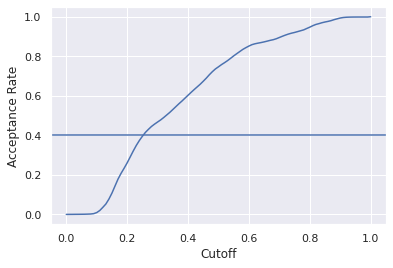

In [ ]:
graph = sns.lineplot(data=acceptance,x='Cutoff',y='Acceptance Rate')
graph.axhline(0.4)
graph.figure.savefig("Cutoff AD GMSC", dpi=300, bbox_inches='tight') 

In [ ]:
#Choose threshold that results in an acceptance rate close to 40%
acceptance[(acceptance['Acceptance Rate'] < 0.45) & (acceptance['Acceptance Rate'] > 0.35)]

,Cutoff,Acceptance Rate
24,0.24,0.3737
25,0.25,0.3954
26,0.26,0.415
27,0.27,0.4306
28,0.28,0.4451


###Testing

####Range: 0.00 - 0.02
####Interval: 0.0002

In [ ]:
# Close possibly open sessions and define session

try:
  sess.close()
  K.clear_session()
except:
  pass

sess = K.get_session()

In [ ]:
# Set the cutoff value as previously defined
tau = 0.26

In [ ]:
ad_metrics_gmsc = adv_debias(lower_bound=0.0, upper_bound=0.0202, interval=0.0002, num_hidden_units=30, batch_size=128, epochs=50)

In [ ]:
ad_metrics_gmsc = ad_metrics_gmsc.astype('float64')

In [ ]:
ad_metrics_gmsc.to_csv('ad_metrics_gmsc.csv')

In [ ]:
# Remove first row because it is a strong outlier
ad_metrics_gmsc = ad_metrics_gmsc.iloc[1: , :]

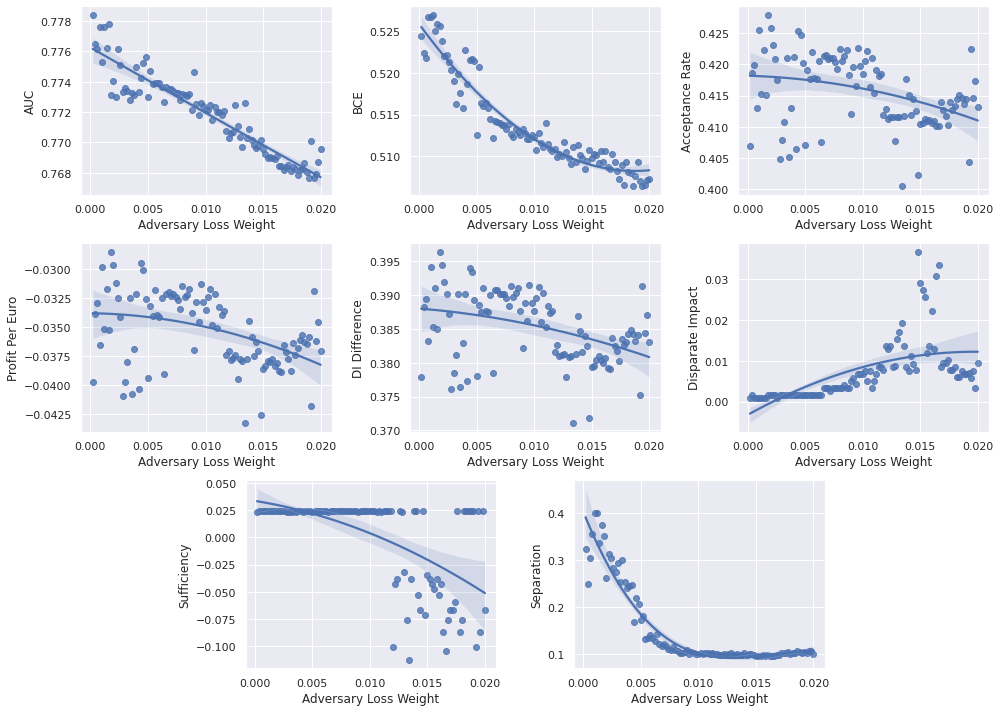

In [ ]:
# Plot all metrics

fig = plt.figure(figsize=(14,10))

plot1 = plt.subplot2grid((6, 6), (0, 0), rowspan=2, colspan=2)
plot2 = plt.subplot2grid((6, 6), (0, 2), rowspan=2, colspan=2)
plot3 = plt.subplot2grid((6, 6), (0, 4), rowspan=2, colspan=2)
plot4 = plt.subplot2grid((6, 6), (2, 0), rowspan=2, colspan=2)
plot5 = plt.subplot2grid((6, 6), (2, 2), rowspan=2, colspan=2)
plot6 = plt.subplot2grid((6, 6), (2, 4), rowspan=2, colspan=2)
plot7 = plt.subplot2grid((6, 6), (4, 1), rowspan=2, colspan=2)
plot8 = plt.subplot2grid((6, 6), (4, 3), rowspan=2, colspan=2)

plot1 = sns.regplot(x="Adversary Loss Weight",y="AUC", data=ad_metrics_gmsc, order = 2, ax=plot1)

plot2 = sns.regplot(x="Adversary Loss Weight",y="BCE", data=ad_metrics_gmsc, order = 2, ax=plot2)

plot3 = sns.regplot(x="Adversary Loss Weight",y="Acceptance Rate", data=ad_metrics_gmsc, order = 2, ax=plot3)

plot4 = sns.regplot(x="Adversary Loss Weight",y="Profit Per Euro", data=ad_metrics_gmsc, order = 2, ax=plot4)

plot5 = sns.regplot(x="Adversary Loss Weight",y="DI Difference", data=ad_metrics_gmsc, order = 2, ax=plot5)

plot6 = sns.regplot(x="Adversary Loss Weight",y="Disparate Impact", data=ad_metrics_gmsc, order = 2, ax=plot6)

plot7 = sns.regplot(x="Adversary Loss Weight",y="Predictive Parity Difference (Sufficiency)", data=ad_metrics_gmsc, order = 2, ax=plot7)
plot7.set(xlabel='Adversary Loss Weight', ylabel='Sufficiency')

plot8 = sns.regplot(x="Adversary Loss Weight",y="Average Odds Difference (Separation)", data=ad_metrics_gmsc, order = 3, ax=plot8)
plot8.set(xlabel='Adversary Loss Weight', ylabel='Separation')

plt.tight_layout()
plt.show()
fig.savefig("AD GMSC METRICS",dpi=300)

In [ ]:
# Select columns relevant for correlation analysis
ad_metrics_gmsc = ad_metrics_gmsc[['Adversary Loss Weight', 
                                    'AUC', 
                                    'MSE', 
                                    'BCE', 
                                    'Profit Per Euro', 
                                    'DI Difference', 
                                    'Disparate Impact', 
                                    'Average Odds Difference (Separation)', 
                                    'Predictive Parity Difference (Sufficiency)', 
                                    'Acceptance Rate']]

In [ ]:
# Spearman correlation matrix
ad_metrics_gmsc_corr = ad_metrics_gmsc.astype('float64').corr(method='spearman')
ad_metrics_gmsc_corr

,Adversary Loss Weight,AUC,MSE,BCE,Profit Per Euro,DI Difference,Disparate Impact,Average Odds Difference (Separation),Predictive Parity Difference (Sufficiency),Acceptance Rate
Adversary Loss Weight,1.000000,-0.943810,-0.970465,-0.964980,-0.399820,-0.400456,0.839856,-0.796408,-0.548251,-0.389457
AUC,-0.943810,1.000000,0.937714,0.939898,0.437456,0.436796,-0.825419,0.768943,0.547087,0.423631
MSE,-0.970465,0.937714,1.000000,0.994695,0.485737,0.483752,-0.845617,0.764005,0.609793,0.475064
BCE,-0.964980,0.939898,0.994695,1.000000,0.449409,0.447339,-0.839820,0.763549,0.586343,0.437367
Profit Per Euro,-0.399820,0.437456,0.485737,0.449409,1.000000,0.996997,-0.572289,0.394481,0.850945,0.997828
DI Difference,-0.400456,0.436796,0.483752,0.447339,0.996997,1.000000,-0.582085,0.411000,0.840403,0.998152
Disparate Impact,0.839856,-0.825419,-0.845617,-0.839820,-0.572289,-0.582085,1.000000,-0.935874,-0.673603,-0.565303
Average Odds Difference (Separation),-0.796408,0.768943,0.764005,0.763549,0.394481,0.411000,-0.935874,1.000000,0.516503,0.392011
Predictive Parity Difference (Sufficiency),-0.548251,0.547087,0.609793,0.586343,0.850945,0.840403,-0.673603,0.516503,1.000000,0.843992
Acceptance Rate,-0.389457,0.423631,0.475064,0.437367,0.997828,0.998152,-0.565303,0.392011,0.843992,1.000000


In [ ]:
# Calculate p-values for the Spearman correlation coefficients
ad_metrics_gmsc_array = ad_metrics_gmsc.to_numpy()
rho, pval = stats.spearmanr(ad_metrics_gmsc_array, nan_policy='omit')
pd.DataFrame(pval, columns=ad_metrics_gmsc_corr.columns, index=ad_metrics_gmsc_corr.index).round(6)

,Adversary Loss Weight,AUC,MSE,BCE,Profit Per Euro,DI Difference,Disparate Impact,Average Odds Difference (Separation),Predictive Parity Difference (Sufficiency),Acceptance Rate
Adversary Loss Weight,0.000000,0.000000,0.000000,0.000000,0.000038,0.000037,0.0,0.000000,0.0,0.000062
AUC,0.000000,0.000000,0.000000,0.000000,0.000005,0.000006,0.0,0.000000,0.0,0.000011
MSE,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000001
BCE,0.000000,0.000000,0.000000,0.000000,0.000003,0.000003,0.0,0.000000,0.0,0.000005
Profit Per Euro,0.000038,0.000005,0.000000,0.000003,0.000000,0.000000,0.0,0.000049,0.0,0.000000
DI Difference,0.000037,0.000006,0.000000,0.000003,0.000000,0.000000,0.0,0.000022,0.0,0.000000
Disparate Impact,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000
Average Odds Difference (Separation),0.000000,0.000000,0.000000,0.000000,0.000049,0.000022,0.0,0.000000,0.0,0.000055
Predictive Parity Difference (Sufficiency),0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000
Acceptance Rate,0.000062,0.000011,0.000001,0.000005,0.000000,0.000000,0.0,0.000055,0.0,0.000000


###Pareto Frontiers

In [ ]:
# Create two-column dataframes to find the Pareto efficient combinations
ad_metrics_gmsc_1 = ad_metrics_gmsc[['Profit Per Euro', 'DI Difference']]
ad_metrics_gmsc_2 = ad_metrics_gmsc[['Profit Per Euro', 'Average Odds Difference (Separation)']]
ad_metrics_gmsc_3 = ad_metrics_gmsc[['AUC', 'Average Odds Difference (Separation)']]
ad_metrics_gmsc_4 = ad_metrics_gmsc[['AUC', 'DI Difference']]

# Only separation larger than 0
ad_metrics_gmsc_2 = ad_metrics_gmsc_2[ad_metrics_gmsc_2['Average Odds Difference (Separation)']>=0]
ad_metrics_gmsc_3 = ad_metrics_gmsc_3[ad_metrics_gmsc_3['Average Odds Difference (Separation)']>=0]

# Find Pareto efficient solutions for each dataframe
ad_metrics_gmsc_1['pareto'] = find_skyline_bn_min_max(df=ad_metrics_gmsc_1, to_max=['Profit Per Euro'], to_min=['DI Difference'])
ad_metrics_gmsc_1["pareto"] = ad_metrics_gmsc_1["pareto"].astype(int)
ad_metrics_gmsc_2['pareto'] = find_skyline_bn_min_max(df=ad_metrics_gmsc_2, to_max=['Profit Per Euro'], to_min=['Average Odds Difference (Separation)'])
ad_metrics_gmsc_2["pareto"] = ad_metrics_gmsc_2["pareto"].astype(int)
ad_metrics_gmsc_3['pareto'] = find_skyline_bn_min_max(df=ad_metrics_gmsc_3, to_max=['AUC'], to_min=['Average Odds Difference (Separation)'])
ad_metrics_gmsc_3["pareto"] = ad_metrics_gmsc_3["pareto"].astype(int)
ad_metrics_gmsc_4['pareto'] = find_skyline_bn_min_max(df=ad_metrics_gmsc_4, to_max=['AUC'], to_min=['DI Difference'])
ad_metrics_gmsc_4["pareto"] = ad_metrics_gmsc_4["pareto"].astype(int)

In [ ]:
# Extract and sort Pareto efficient solutions

ad_pareto_gmsc_1 = ad_metrics_gmsc_1[ad_metrics_gmsc_1.pareto==1]
ad_pareto_gmsc_1.sort_values(by=['Profit Per Euro', 'DI Difference'], inplace=True)

ad_pareto_gmsc_2 = ad_metrics_gmsc_2[ad_metrics_gmsc_2.pareto==1]
ad_pareto_gmsc_2.sort_values(by=['Profit Per Euro', 'Average Odds Difference (Separation)'], inplace=True)

ad_pareto_gmsc_3 = ad_metrics_gmsc_3[ad_metrics_gmsc_3.pareto==1]
ad_pareto_gmsc_3.sort_values(by=['AUC', 'Average Odds Difference (Separation)'], inplace=True)

ad_pareto_gmsc_4 = ad_metrics_gmsc_4[ad_metrics_gmsc_4.pareto==1]
ad_pareto_gmsc_4.sort_values(by=['AUC', 'DI Difference'], inplace=True)

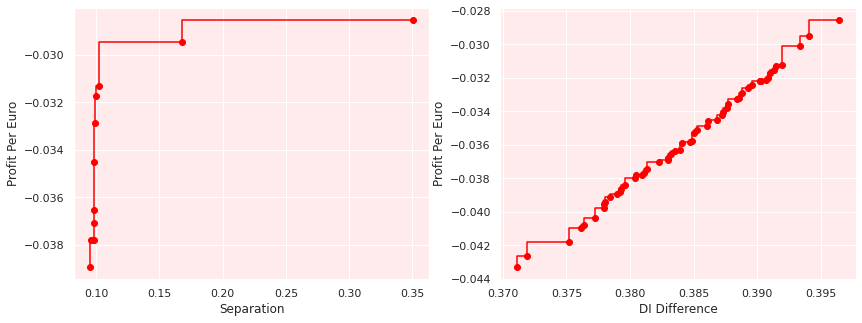

<Figure size 432x288 with 0 Axes>

In [ ]:
# Plot and save the Pareto frontiers 
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False, figsize=(14,5))
ax1.step(ad_pareto_gmsc_2['Average Odds Difference (Separation)'], ad_pareto_gmsc_2['Profit Per Euro'], '-o', where='pre', color='red')
ax2.step(ad_pareto_gmsc_1['DI Difference'], ad_pareto_gmsc_1['Profit Per Euro'], '-o', where='pre', color='red')
ax1.set_xlabel('Separation')
ax1.set_ylabel('Profit Per Euro')
ax2.set_xlabel('DI Difference')
ax2.set_ylabel('Profit Per Euro')
ax1.patch.set_facecolor('red')
ax1.patch.set_alpha(0.08)
ax2.patch.set_facecolor('red')
ax2.patch.set_alpha(0.08)
plt.show()
plt.tight_layout()
plt.show()
fig.savefig("PARETO AD GMSC PROFIT", dpi=300, bbox_inches='tight')

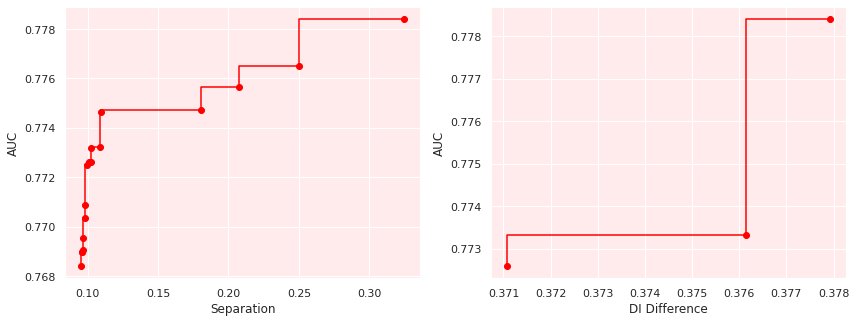

<Figure size 432x288 with 0 Axes>

In [ ]:
# Plot and save the Pareto frontiers 
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False, figsize=(14,5))
ax1.step(ad_pareto_gmsc_3['Average Odds Difference (Separation)'], ad_pareto_gmsc_3['AUC'], '-o', where='pre', color='red')
ax2.step(ad_pareto_gmsc_4['DI Difference'], ad_pareto_gmsc_4['AUC'], '-o', where='pre', color='red')
ax1.set_xlabel('Separation')
ax1.set_ylabel('AUC')
ax2.set_xlabel('DI Difference')
ax2.set_ylabel('AUC')
ax1.patch.set_facecolor('red')
ax1.patch.set_alpha(0.08)
ax2.patch.set_facecolor('red')
ax2.patch.set_alpha(0.08)
plt.show()
plt.tight_layout()
plt.show()
fig.savefig("PARETO AD GMSC AUC", dpi=300, bbox_inches='tight')

###Prediction Histogram Animation

In [ ]:
sess.close()
K.clear_session()
sess = K.get_session()

In [ ]:
#Make and save predictions for penalty weights 1 to 100, separated to decrease the overall runtime by restarting colab

preds_ad_gmsc = []

for i in tqdm(np.arange(0.000, 0.0202, 0.0002)):
  preds_ad_gmsc.append(make_predictions_ad(adversary_loss_weight=i, num_hidden_units=30, batch_size=128, epochs=50))

  0%|          | 0/101 [00:00<?, ?it/s]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.691958; batch adversarial loss: 0.727524
epoch 0; iter: 400; batch classifier loss: 0.768172; batch adversarial loss: 0.599553
epoch 0; iter: 600; batch classifier loss: 0.672513; batch adversarial loss: 0.536102
epoch 0; iter: 800; batch classifier loss: 0.645193; batch adversarial loss: 0.526847
epoch 0; iter: 1000; batch classifier loss: 0.657453; batch adversarial loss: 0.437411
epoch 0; iter: 1200; batch classifier loss: 0.659665; batch adversarial loss: 0.421633
epoch 1; iter: 0; batch classifier loss: 0.622921; batch adversarial loss: 0.491825
epoch 1; iter: 200; batch classifier loss: 0.649167; batch adversarial loss: 0.377061
epoch 1; iter: 400; batch classifier loss: 0.651466; batch adversarial loss: 0.450899
epoch 1; iter: 600; batch classifier loss: 0.645635; batch adversarial loss: 0.366167
epoch 1; iter: 800; batch classifier loss: 0.648916; bat

  1%|          | 1/101 [01:51<3:05:22, 111.22s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.703848; batch adversarial loss: 0.731374
epoch 0; iter: 400; batch classifier loss: 0.793099; batch adversarial loss: 0.597824
epoch 0; iter: 600; batch classifier loss: 0.677334; batch adversarial loss: 0.531756
epoch 0; iter: 800; batch classifier loss: 0.652927; batch adversarial loss: 0.523207
epoch 0; iter: 1000; batch classifier loss: 0.657950; batch adversarial loss: 0.436885
epoch 0; iter: 1200; batch classifier loss: 0.655093; batch adversarial loss: 0.422741
epoch 1; iter: 0; batch classifier loss: 0.618126; batch adversarial loss: 0.492922
epoch 1; iter: 200; batch classifier loss: 0.650025; batch adversarial loss: 0.381737
epoch 1; iter: 400; batch classifier loss: 0.628482; batch adversarial loss: 0.458531
epoch 1; iter: 600; batch classifier loss: 0.627906; batch adversarial loss: 0.374199
epoch 1; iter: 800; batch classifier loss: 0.646794; bat

  2%|▏         | 2/101 [03:40<3:01:53, 110.24s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.704050; batch adversarial loss: 0.731425
epoch 0; iter: 400; batch classifier loss: 0.794187; batch adversarial loss: 0.597752
epoch 0; iter: 600; batch classifier loss: 0.677728; batch adversarial loss: 0.531495
epoch 0; iter: 800; batch classifier loss: 0.653464; batch adversarial loss: 0.522885
epoch 0; iter: 1000; batch classifier loss: 0.658209; batch adversarial loss: 0.436559
epoch 0; iter: 1200; batch classifier loss: 0.655342; batch adversarial loss: 0.422455
epoch 1; iter: 0; batch classifier loss: 0.618320; batch adversarial loss: 0.492710
epoch 1; iter: 200; batch classifier loss: 0.649831; batch adversarial loss: 0.381617
epoch 1; iter: 400; batch classifier loss: 0.628553; batch adversarial loss: 0.458659
epoch 1; iter: 600; batch classifier loss: 0.627602; batch adversarial loss: 0.374554
epoch 1; iter: 800; batch classifier loss: 0.645941; bat

  3%|▎         | 3/101 [05:32<3:00:56, 110.78s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.704255; batch adversarial loss: 0.731475
epoch 0; iter: 400; batch classifier loss: 0.794194; batch adversarial loss: 0.597730
epoch 0; iter: 600; batch classifier loss: 0.678023; batch adversarial loss: 0.531423
epoch 0; iter: 800; batch classifier loss: 0.654090; batch adversarial loss: 0.522810
epoch 0; iter: 1000; batch classifier loss: 0.658175; batch adversarial loss: 0.435616
epoch 0; iter: 1200; batch classifier loss: 0.656634; batch adversarial loss: 0.422126
epoch 1; iter: 0; batch classifier loss: 0.620860; batch adversarial loss: 0.492558
epoch 1; iter: 200; batch classifier loss: 0.650053; batch adversarial loss: 0.381342
epoch 1; iter: 400; batch classifier loss: 0.628477; batch adversarial loss: 0.458648
epoch 1; iter: 600; batch classifier loss: 0.628192; batch adversarial loss: 0.374083
epoch 1; iter: 800; batch classifier loss: 0.647198; bat

  4%|▍         | 4/101 [07:26<3:01:30, 112.27s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.704446; batch adversarial loss: 0.731551
epoch 0; iter: 400; batch classifier loss: 0.794747; batch adversarial loss: 0.597708
epoch 0; iter: 600; batch classifier loss: 0.677837; batch adversarial loss: 0.531336
epoch 0; iter: 800; batch classifier loss: 0.653799; batch adversarial loss: 0.522704
epoch 0; iter: 1000; batch classifier loss: 0.658108; batch adversarial loss: 0.436679
epoch 0; iter: 1200; batch classifier loss: 0.655226; batch adversarial loss: 0.422713
epoch 1; iter: 0; batch classifier loss: 0.618029; batch adversarial loss: 0.493014
epoch 1; iter: 200; batch classifier loss: 0.649644; batch adversarial loss: 0.382015
epoch 1; iter: 400; batch classifier loss: 0.627005; batch adversarial loss: 0.459124
epoch 1; iter: 600; batch classifier loss: 0.626582; batch adversarial loss: 0.375000
epoch 1; iter: 800; batch classifier loss: 0.645558; bat

  5%|▍         | 5/101 [09:19<3:00:01, 112.52s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.704684; batch adversarial loss: 0.731614
epoch 0; iter: 400; batch classifier loss: 0.794837; batch adversarial loss: 0.597688
epoch 0; iter: 600; batch classifier loss: 0.677955; batch adversarial loss: 0.531292
epoch 0; iter: 800; batch classifier loss: 0.653863; batch adversarial loss: 0.522722
epoch 0; iter: 1000; batch classifier loss: 0.658178; batch adversarial loss: 0.436725
epoch 0; iter: 1200; batch classifier loss: 0.654988; batch adversarial loss: 0.422878
epoch 1; iter: 0; batch classifier loss: 0.617873; batch adversarial loss: 0.493196
epoch 1; iter: 200; batch classifier loss: 0.649632; batch adversarial loss: 0.382203
epoch 1; iter: 400; batch classifier loss: 0.626494; batch adversarial loss: 0.459397
epoch 1; iter: 600; batch classifier loss: 0.626409; batch adversarial loss: 0.375305
epoch 1; iter: 800; batch classifier loss: 0.644736; bat

  6%|▌         | 6/101 [11:14<2:59:07, 113.13s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.704856; batch adversarial loss: 0.731672
epoch 0; iter: 400; batch classifier loss: 0.794999; batch adversarial loss: 0.597677
epoch 0; iter: 600; batch classifier loss: 0.678173; batch adversarial loss: 0.531316
epoch 0; iter: 800; batch classifier loss: 0.653611; batch adversarial loss: 0.522838
epoch 0; iter: 1000; batch classifier loss: 0.658110; batch adversarial loss: 0.436842
epoch 0; iter: 1200; batch classifier loss: 0.654895; batch adversarial loss: 0.423066
epoch 1; iter: 0; batch classifier loss: 0.617870; batch adversarial loss: 0.493334
epoch 1; iter: 200; batch classifier loss: 0.649574; batch adversarial loss: 0.382419
epoch 1; iter: 400; batch classifier loss: 0.625975; batch adversarial loss: 0.459574
epoch 1; iter: 600; batch classifier loss: 0.626029; batch adversarial loss: 0.375582
epoch 1; iter: 800; batch classifier loss: 0.644353; bat

  7%|▋         | 7/101 [13:14<3:00:55, 115.49s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.705208; batch adversarial loss: 0.731768
epoch 0; iter: 400; batch classifier loss: 0.796025; batch adversarial loss: 0.597592
epoch 0; iter: 600; batch classifier loss: 0.678418; batch adversarial loss: 0.531085
epoch 0; iter: 800; batch classifier loss: 0.654095; batch adversarial loss: 0.522537
epoch 0; iter: 1000; batch classifier loss: 0.658400; batch adversarial loss: 0.436464
epoch 0; iter: 1200; batch classifier loss: 0.654736; batch adversarial loss: 0.422890
epoch 1; iter: 0; batch classifier loss: 0.617886; batch adversarial loss: 0.493223
epoch 1; iter: 200; batch classifier loss: 0.649582; batch adversarial loss: 0.382384
epoch 1; iter: 400; batch classifier loss: 0.625716; batch adversarial loss: 0.459688
epoch 1; iter: 600; batch classifier loss: 0.625731; batch adversarial loss: 0.375428
epoch 1; iter: 800; batch classifier loss: 0.645185; bat

  8%|▊         | 8/101 [15:10<2:59:19, 115.69s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.705413; batch adversarial loss: 0.731819
epoch 0; iter: 400; batch classifier loss: 0.795787; batch adversarial loss: 0.597578
epoch 0; iter: 600; batch classifier loss: 0.677980; batch adversarial loss: 0.531274
epoch 0; iter: 800; batch classifier loss: 0.653611; batch adversarial loss: 0.522811
epoch 0; iter: 1000; batch classifier loss: 0.658039; batch adversarial loss: 0.436846
epoch 0; iter: 1200; batch classifier loss: 0.654607; batch adversarial loss: 0.423225
epoch 1; iter: 0; batch classifier loss: 0.617553; batch adversarial loss: 0.493511
epoch 1; iter: 200; batch classifier loss: 0.649305; batch adversarial loss: 0.382724
epoch 1; iter: 400; batch classifier loss: 0.624859; batch adversarial loss: 0.460008
epoch 1; iter: 600; batch classifier loss: 0.625074; batch adversarial loss: 0.375988
epoch 1; iter: 800; batch classifier loss: 0.644337; bat

  9%|▉         | 9/101 [17:09<2:58:50, 116.64s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.705612; batch adversarial loss: 0.731887
epoch 0; iter: 400; batch classifier loss: 0.795641; batch adversarial loss: 0.597584
epoch 0; iter: 600; batch classifier loss: 0.678012; batch adversarial loss: 0.531272
epoch 0; iter: 800; batch classifier loss: 0.653671; batch adversarial loss: 0.522843
epoch 0; iter: 1000; batch classifier loss: 0.657999; batch adversarial loss: 0.437136
epoch 0; iter: 1200; batch classifier loss: 0.654466; batch adversarial loss: 0.423685
epoch 1; iter: 0; batch classifier loss: 0.617275; batch adversarial loss: 0.494008
epoch 1; iter: 200; batch classifier loss: 0.649020; batch adversarial loss: 0.383164
epoch 1; iter: 400; batch classifier loss: 0.623188; batch adversarial loss: 0.460508
epoch 1; iter: 600; batch classifier loss: 0.624383; batch adversarial loss: 0.376224
epoch 1; iter: 800; batch classifier loss: 0.644373; bat

 10%|▉         | 10/101 [19:17<3:02:13, 120.15s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.705916; batch adversarial loss: 0.731964
epoch 0; iter: 400; batch classifier loss: 0.796297; batch adversarial loss: 0.597545
epoch 0; iter: 600; batch classifier loss: 0.677953; batch adversarial loss: 0.531227
epoch 0; iter: 800; batch classifier loss: 0.653985; batch adversarial loss: 0.522686
epoch 0; iter: 1000; batch classifier loss: 0.658259; batch adversarial loss: 0.436883
epoch 0; iter: 1200; batch classifier loss: 0.654520; batch adversarial loss: 0.423444
epoch 1; iter: 0; batch classifier loss: 0.617436; batch adversarial loss: 0.493789
epoch 1; iter: 200; batch classifier loss: 0.649044; batch adversarial loss: 0.383124
epoch 1; iter: 400; batch classifier loss: 0.623947; batch adversarial loss: 0.460348
epoch 1; iter: 600; batch classifier loss: 0.624209; batch adversarial loss: 0.376315
epoch 1; iter: 800; batch classifier loss: 0.644254; bat

 11%|█         | 11/101 [21:22<3:02:42, 121.81s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.706145; batch adversarial loss: 0.732035
epoch 0; iter: 400; batch classifier loss: 0.796605; batch adversarial loss: 0.597508
epoch 0; iter: 600; batch classifier loss: 0.678059; batch adversarial loss: 0.531121
epoch 0; iter: 800; batch classifier loss: 0.654127; batch adversarial loss: 0.522575
epoch 0; iter: 1000; batch classifier loss: 0.658173; batch adversarial loss: 0.436919
epoch 0; iter: 1200; batch classifier loss: 0.654341; batch adversarial loss: 0.423553
epoch 1; iter: 0; batch classifier loss: 0.617397; batch adversarial loss: 0.493910
epoch 1; iter: 200; batch classifier loss: 0.649108; batch adversarial loss: 0.383246
epoch 1; iter: 400; batch classifier loss: 0.623788; batch adversarial loss: 0.460389
epoch 1; iter: 600; batch classifier loss: 0.623970; batch adversarial loss: 0.376437
epoch 1; iter: 800; batch classifier loss: 0.643653; bat

 12%|█▏        | 12/101 [23:21<2:59:07, 120.76s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.706444; batch adversarial loss: 0.732104
epoch 0; iter: 400; batch classifier loss: 0.797384; batch adversarial loss: 0.597476
epoch 0; iter: 600; batch classifier loss: 0.678511; batch adversarial loss: 0.530910
epoch 0; iter: 800; batch classifier loss: 0.654908; batch adversarial loss: 0.522404
epoch 0; iter: 1000; batch classifier loss: 0.658343; batch adversarial loss: 0.435646
epoch 0; iter: 1200; batch classifier loss: 0.656918; batch adversarial loss: 0.422362
epoch 1; iter: 0; batch classifier loss: 0.620770; batch adversarial loss: 0.492670
epoch 1; iter: 200; batch classifier loss: 0.650010; batch adversarial loss: 0.381682
epoch 1; iter: 400; batch classifier loss: 0.626817; batch adversarial loss: 0.459590
epoch 1; iter: 600; batch classifier loss: 0.626906; batch adversarial loss: 0.375938
epoch 1; iter: 800; batch classifier loss: 0.644181; bat

 13%|█▎        | 13/101 [25:23<2:57:49, 121.24s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.706689; batch adversarial loss: 0.732168
epoch 0; iter: 400; batch classifier loss: 0.797791; batch adversarial loss: 0.597403
epoch 0; iter: 600; batch classifier loss: 0.678901; batch adversarial loss: 0.530763
epoch 0; iter: 800; batch classifier loss: 0.655100; batch adversarial loss: 0.522251
epoch 0; iter: 1000; batch classifier loss: 0.658308; batch adversarial loss: 0.435538
epoch 0; iter: 1200; batch classifier loss: 0.657012; batch adversarial loss: 0.422274
epoch 1; iter: 0; batch classifier loss: 0.620753; batch adversarial loss: 0.492614
epoch 1; iter: 200; batch classifier loss: 0.649808; batch adversarial loss: 0.381826
epoch 1; iter: 400; batch classifier loss: 0.626082; batch adversarial loss: 0.459895
epoch 1; iter: 600; batch classifier loss: 0.626648; batch adversarial loss: 0.376072
epoch 1; iter: 800; batch classifier loss: 0.644006; bat

 14%|█▍        | 14/101 [27:20<2:53:52, 119.92s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.706961; batch adversarial loss: 0.732249
epoch 0; iter: 400; batch classifier loss: 0.798204; batch adversarial loss: 0.597413
epoch 0; iter: 600; batch classifier loss: 0.679402; batch adversarial loss: 0.530668
epoch 0; iter: 800; batch classifier loss: 0.655266; batch adversarial loss: 0.522188
epoch 0; iter: 1000; batch classifier loss: 0.658436; batch adversarial loss: 0.435505
epoch 0; iter: 1200; batch classifier loss: 0.656959; batch adversarial loss: 0.422369
epoch 1; iter: 0; batch classifier loss: 0.620804; batch adversarial loss: 0.492724
epoch 1; iter: 200; batch classifier loss: 0.649868; batch adversarial loss: 0.381839
epoch 1; iter: 400; batch classifier loss: 0.626101; batch adversarial loss: 0.459943
epoch 1; iter: 600; batch classifier loss: 0.626363; batch adversarial loss: 0.376378
epoch 1; iter: 800; batch classifier loss: 0.643634; bat

 15%|█▍        | 15/101 [29:17<2:50:53, 119.23s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.707165; batch adversarial loss: 0.732314
epoch 0; iter: 400; batch classifier loss: 0.798161; batch adversarial loss: 0.597374
epoch 0; iter: 600; batch classifier loss: 0.679192; batch adversarial loss: 0.530828
epoch 0; iter: 800; batch classifier loss: 0.654762; batch adversarial loss: 0.522439
epoch 0; iter: 1000; batch classifier loss: 0.658120; batch adversarial loss: 0.435862
epoch 0; iter: 1200; batch classifier loss: 0.656821; batch adversarial loss: 0.422648
epoch 1; iter: 0; batch classifier loss: 0.620519; batch adversarial loss: 0.492979
epoch 1; iter: 200; batch classifier loss: 0.649636; batch adversarial loss: 0.382190
epoch 1; iter: 400; batch classifier loss: 0.625215; batch adversarial loss: 0.460186
epoch 1; iter: 600; batch classifier loss: 0.625719; batch adversarial loss: 0.376709
epoch 1; iter: 800; batch classifier loss: 0.643300; bat

 16%|█▌        | 16/101 [31:13<2:47:28, 118.22s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.707350; batch adversarial loss: 0.732361
epoch 0; iter: 400; batch classifier loss: 0.799025; batch adversarial loss: 0.597304
epoch 0; iter: 600; batch classifier loss: 0.679108; batch adversarial loss: 0.530616
epoch 0; iter: 800; batch classifier loss: 0.654727; batch adversarial loss: 0.522221
epoch 0; iter: 1000; batch classifier loss: 0.657822; batch adversarial loss: 0.436770
epoch 0; iter: 1200; batch classifier loss: 0.653976; batch adversarial loss: 0.423681
epoch 1; iter: 0; batch classifier loss: 0.617037; batch adversarial loss: 0.494156
epoch 1; iter: 200; batch classifier loss: 0.648830; batch adversarial loss: 0.383637
epoch 1; iter: 400; batch classifier loss: 0.621864; batch adversarial loss: 0.461122
epoch 1; iter: 600; batch classifier loss: 0.622818; batch adversarial loss: 0.377169
epoch 1; iter: 800; batch classifier loss: 0.642822; bat

 17%|█▋        | 17/101 [33:11<2:45:13, 118.02s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.707600; batch adversarial loss: 0.732433
epoch 0; iter: 400; batch classifier loss: 0.798818; batch adversarial loss: 0.597314
epoch 0; iter: 600; batch classifier loss: 0.678926; batch adversarial loss: 0.530748
epoch 0; iter: 800; batch classifier loss: 0.655063; batch adversarial loss: 0.522367
epoch 0; iter: 1000; batch classifier loss: 0.658059; batch adversarial loss: 0.435936
epoch 0; iter: 1200; batch classifier loss: 0.655873; batch adversarial loss: 0.423099
epoch 1; iter: 0; batch classifier loss: 0.620352; batch adversarial loss: 0.493641
epoch 1; iter: 200; batch classifier loss: 0.649294; batch adversarial loss: 0.383210
epoch 1; iter: 400; batch classifier loss: 0.621777; batch adversarial loss: 0.461154
epoch 1; iter: 600; batch classifier loss: 0.622927; batch adversarial loss: 0.377542
epoch 1; iter: 800; batch classifier loss: 0.643401; bat

 18%|█▊        | 18/101 [35:06<2:42:04, 117.16s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.707933; batch adversarial loss: 0.732515
epoch 0; iter: 400; batch classifier loss: 0.799491; batch adversarial loss: 0.597238
epoch 0; iter: 600; batch classifier loss: 0.679808; batch adversarial loss: 0.530541
epoch 0; iter: 800; batch classifier loss: 0.655295; batch adversarial loss: 0.522116
epoch 0; iter: 1000; batch classifier loss: 0.658251; batch adversarial loss: 0.435661
epoch 0; iter: 1200; batch classifier loss: 0.655990; batch adversarial loss: 0.422868
epoch 1; iter: 0; batch classifier loss: 0.620111; batch adversarial loss: 0.493680
epoch 1; iter: 200; batch classifier loss: 0.649121; batch adversarial loss: 0.383384
epoch 1; iter: 400; batch classifier loss: 0.620988; batch adversarial loss: 0.461438
epoch 1; iter: 600; batch classifier loss: 0.622429; batch adversarial loss: 0.377977
epoch 1; iter: 800; batch classifier loss: 0.642896; bat

 19%|█▉        | 19/101 [37:04<2:40:23, 117.35s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.708123; batch adversarial loss: 0.732587
epoch 0; iter: 400; batch classifier loss: 0.799711; batch adversarial loss: 0.597252
epoch 0; iter: 600; batch classifier loss: 0.679071; batch adversarial loss: 0.530574
epoch 0; iter: 800; batch classifier loss: 0.655093; batch adversarial loss: 0.522145
epoch 0; iter: 1000; batch classifier loss: 0.658216; batch adversarial loss: 0.436961
epoch 0; iter: 1200; batch classifier loss: 0.653886; batch adversarial loss: 0.424131
epoch 1; iter: 0; batch classifier loss: 0.616868; batch adversarial loss: 0.494591
epoch 1; iter: 200; batch classifier loss: 0.648541; batch adversarial loss: 0.384318
epoch 1; iter: 400; batch classifier loss: 0.619480; batch adversarial loss: 0.461985
epoch 1; iter: 600; batch classifier loss: 0.621868; batch adversarial loss: 0.377984
epoch 1; iter: 800; batch classifier loss: 0.641735; bat

 20%|█▉        | 20/101 [39:01<2:38:31, 117.42s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.708462; batch adversarial loss: 0.732672
epoch 0; iter: 400; batch classifier loss: 0.800356; batch adversarial loss: 0.597228
epoch 0; iter: 600; batch classifier loss: 0.679422; batch adversarial loss: 0.530442
epoch 0; iter: 800; batch classifier loss: 0.655453; batch adversarial loss: 0.522025
epoch 0; iter: 1000; batch classifier loss: 0.658314; batch adversarial loss: 0.436921
epoch 0; iter: 1200; batch classifier loss: 0.653672; batch adversarial loss: 0.424201
epoch 1; iter: 0; batch classifier loss: 0.616829; batch adversarial loss: 0.494681
epoch 1; iter: 200; batch classifier loss: 0.648516; batch adversarial loss: 0.384506
epoch 1; iter: 400; batch classifier loss: 0.619205; batch adversarial loss: 0.462099
epoch 1; iter: 600; batch classifier loss: 0.621451; batch adversarial loss: 0.378220
epoch 1; iter: 800; batch classifier loss: 0.641253; bat

 21%|██        | 21/101 [41:02<2:37:57, 118.47s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.708637; batch adversarial loss: 0.732722
epoch 0; iter: 400; batch classifier loss: 0.800422; batch adversarial loss: 0.597202
epoch 0; iter: 600; batch classifier loss: 0.679138; batch adversarial loss: 0.530502
epoch 0; iter: 800; batch classifier loss: 0.655553; batch adversarial loss: 0.522096
epoch 0; iter: 1000; batch classifier loss: 0.658273; batch adversarial loss: 0.435860
epoch 0; iter: 1200; batch classifier loss: 0.655586; batch adversarial loss: 0.423350
epoch 1; iter: 0; batch classifier loss: 0.620239; batch adversarial loss: 0.493998
epoch 1; iter: 200; batch classifier loss: 0.649101; batch adversarial loss: 0.383776
epoch 1; iter: 400; batch classifier loss: 0.619969; batch adversarial loss: 0.462009
epoch 1; iter: 600; batch classifier loss: 0.622428; batch adversarial loss: 0.378078
epoch 1; iter: 800; batch classifier loss: 0.641838; bat

 22%|██▏       | 22/101 [43:03<2:36:46, 119.07s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.708750; batch adversarial loss: 0.732723
epoch 0; iter: 400; batch classifier loss: 0.800075; batch adversarial loss: 0.597232
epoch 0; iter: 600; batch classifier loss: 0.679350; batch adversarial loss: 0.530485
epoch 0; iter: 800; batch classifier loss: 0.654973; batch adversarial loss: 0.522193
epoch 0; iter: 1000; batch classifier loss: 0.658061; batch adversarial loss: 0.437149
epoch 0; iter: 1200; batch classifier loss: 0.653135; batch adversarial loss: 0.424626
epoch 1; iter: 0; batch classifier loss: 0.616352; batch adversarial loss: 0.495089
epoch 1; iter: 200; batch classifier loss: 0.648371; batch adversarial loss: 0.384846
epoch 1; iter: 400; batch classifier loss: 0.618211; batch adversarial loss: 0.462400
epoch 1; iter: 600; batch classifier loss: 0.621094; batch adversarial loss: 0.378469
epoch 1; iter: 800; batch classifier loss: 0.640515; bat

 23%|██▎       | 23/101 [45:05<2:35:49, 119.87s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.709006; batch adversarial loss: 0.732787
epoch 0; iter: 400; batch classifier loss: 0.800460; batch adversarial loss: 0.597218
epoch 0; iter: 600; batch classifier loss: 0.679296; batch adversarial loss: 0.530461
epoch 0; iter: 800; batch classifier loss: 0.655032; batch adversarial loss: 0.522193
epoch 0; iter: 1000; batch classifier loss: 0.658082; batch adversarial loss: 0.437214
epoch 0; iter: 1200; batch classifier loss: 0.653044; batch adversarial loss: 0.424768
epoch 1; iter: 0; batch classifier loss: 0.616262; batch adversarial loss: 0.495162
epoch 1; iter: 200; batch classifier loss: 0.648347; batch adversarial loss: 0.385074
epoch 1; iter: 400; batch classifier loss: 0.618549; batch adversarial loss: 0.462393
epoch 1; iter: 600; batch classifier loss: 0.620627; batch adversarial loss: 0.378759
epoch 1; iter: 800; batch classifier loss: 0.640081; bat

 24%|██▍       | 24/101 [47:05<2:34:01, 120.02s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.709259; batch adversarial loss: 0.732852
epoch 0; iter: 400; batch classifier loss: 0.800980; batch adversarial loss: 0.597169
epoch 0; iter: 600; batch classifier loss: 0.679594; batch adversarial loss: 0.530372
epoch 0; iter: 800; batch classifier loss: 0.655177; batch adversarial loss: 0.522111
epoch 0; iter: 1000; batch classifier loss: 0.658091; batch adversarial loss: 0.437188
epoch 0; iter: 1200; batch classifier loss: 0.653011; batch adversarial loss: 0.424777
epoch 1; iter: 0; batch classifier loss: 0.616187; batch adversarial loss: 0.495241
epoch 1; iter: 200; batch classifier loss: 0.648116; batch adversarial loss: 0.385202
epoch 1; iter: 400; batch classifier loss: 0.617127; batch adversarial loss: 0.462795
epoch 1; iter: 600; batch classifier loss: 0.620059; batch adversarial loss: 0.379043
epoch 1; iter: 800; batch classifier loss: 0.639909; bat

 25%|██▍       | 25/101 [49:10<2:34:03, 121.62s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.709512; batch adversarial loss: 0.732918
epoch 0; iter: 400; batch classifier loss: 0.800766; batch adversarial loss: 0.597157
epoch 0; iter: 600; batch classifier loss: 0.679617; batch adversarial loss: 0.530354
epoch 0; iter: 800; batch classifier loss: 0.655169; batch adversarial loss: 0.522102
epoch 0; iter: 1000; batch classifier loss: 0.658144; batch adversarial loss: 0.437259
epoch 0; iter: 1200; batch classifier loss: 0.653028; batch adversarial loss: 0.424887
epoch 1; iter: 0; batch classifier loss: 0.616137; batch adversarial loss: 0.495314
epoch 1; iter: 200; batch classifier loss: 0.648006; batch adversarial loss: 0.385349
epoch 1; iter: 400; batch classifier loss: 0.616894; batch adversarial loss: 0.462914
epoch 1; iter: 600; batch classifier loss: 0.620192; batch adversarial loss: 0.379081
epoch 1; iter: 800; batch classifier loss: 0.640082; bat

 26%|██▌       | 26/101 [51:12<2:32:14, 121.79s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.709799; batch adversarial loss: 0.732993
epoch 0; iter: 400; batch classifier loss: 0.801187; batch adversarial loss: 0.597113
epoch 0; iter: 600; batch classifier loss: 0.679647; batch adversarial loss: 0.530298
epoch 0; iter: 800; batch classifier loss: 0.655405; batch adversarial loss: 0.522027
epoch 0; iter: 1000; batch classifier loss: 0.658079; batch adversarial loss: 0.437194
epoch 0; iter: 1200; batch classifier loss: 0.652945; batch adversarial loss: 0.424928
epoch 1; iter: 0; batch classifier loss: 0.616121; batch adversarial loss: 0.495351
epoch 1; iter: 200; batch classifier loss: 0.647890; batch adversarial loss: 0.385481
epoch 1; iter: 400; batch classifier loss: 0.616284; batch adversarial loss: 0.463139
epoch 1; iter: 600; batch classifier loss: 0.619874; batch adversarial loss: 0.379266
epoch 1; iter: 800; batch classifier loss: 0.639622; bat

 27%|██▋       | 27/101 [53:12<2:29:25, 121.15s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.710045; batch adversarial loss: 0.733052
epoch 0; iter: 400; batch classifier loss: 0.801539; batch adversarial loss: 0.597098
epoch 0; iter: 600; batch classifier loss: 0.679802; batch adversarial loss: 0.530276
epoch 0; iter: 800; batch classifier loss: 0.655308; batch adversarial loss: 0.522052
epoch 0; iter: 1000; batch classifier loss: 0.657941; batch adversarial loss: 0.437373
epoch 0; iter: 1200; batch classifier loss: 0.652799; batch adversarial loss: 0.425109
epoch 1; iter: 0; batch classifier loss: 0.615968; batch adversarial loss: 0.495632
epoch 1; iter: 200; batch classifier loss: 0.648037; batch adversarial loss: 0.385664
epoch 1; iter: 400; batch classifier loss: 0.616457; batch adversarial loss: 0.463071
epoch 1; iter: 600; batch classifier loss: 0.619753; batch adversarial loss: 0.379374
epoch 1; iter: 800; batch classifier loss: 0.639801; bat

 28%|██▊       | 28/101 [55:13<2:27:08, 120.94s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.710230; batch adversarial loss: 0.733094
epoch 0; iter: 400; batch classifier loss: 0.802219; batch adversarial loss: 0.597060
epoch 0; iter: 600; batch classifier loss: 0.679880; batch adversarial loss: 0.530220
epoch 0; iter: 800; batch classifier loss: 0.655888; batch adversarial loss: 0.522007
epoch 0; iter: 1000; batch classifier loss: 0.658077; batch adversarial loss: 0.436089
epoch 0; iter: 1200; batch classifier loss: 0.655171; batch adversarial loss: 0.424097
epoch 1; iter: 0; batch classifier loss: 0.619443; batch adversarial loss: 0.494820
epoch 1; iter: 200; batch classifier loss: 0.648533; batch adversarial loss: 0.385050
epoch 1; iter: 400; batch classifier loss: 0.617243; batch adversarial loss: 0.463098
epoch 1; iter: 600; batch classifier loss: 0.620471; batch adversarial loss: 0.379368
epoch 1; iter: 800; batch classifier loss: 0.640512; bat

 29%|██▊       | 29/101 [57:13<2:24:56, 120.78s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.710545; batch adversarial loss: 0.733175
epoch 0; iter: 400; batch classifier loss: 0.801980; batch adversarial loss: 0.597030
epoch 0; iter: 600; batch classifier loss: 0.679983; batch adversarial loss: 0.530180
epoch 0; iter: 800; batch classifier loss: 0.656022; batch adversarial loss: 0.521959
epoch 0; iter: 1000; batch classifier loss: 0.658008; batch adversarial loss: 0.436236
epoch 0; iter: 1200; batch classifier loss: 0.654992; batch adversarial loss: 0.424293
epoch 1; iter: 0; batch classifier loss: 0.619378; batch adversarial loss: 0.495001
epoch 1; iter: 200; batch classifier loss: 0.648295; batch adversarial loss: 0.385302
epoch 1; iter: 400; batch classifier loss: 0.616057; batch adversarial loss: 0.463431
epoch 1; iter: 600; batch classifier loss: 0.620332; batch adversarial loss: 0.379521
epoch 1; iter: 800; batch classifier loss: 0.640387; bat

 30%|██▉       | 30/101 [59:14<2:23:03, 120.90s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.710765; batch adversarial loss: 0.733238
epoch 0; iter: 400; batch classifier loss: 0.802372; batch adversarial loss: 0.596986
epoch 0; iter: 600; batch classifier loss: 0.680191; batch adversarial loss: 0.530024
epoch 0; iter: 800; batch classifier loss: 0.656267; batch adversarial loss: 0.521807
epoch 0; iter: 1000; batch classifier loss: 0.658105; batch adversarial loss: 0.436086
epoch 0; iter: 1200; batch classifier loss: 0.655027; batch adversarial loss: 0.424208
epoch 1; iter: 0; batch classifier loss: 0.619514; batch adversarial loss: 0.494922
epoch 1; iter: 200; batch classifier loss: 0.648466; batch adversarial loss: 0.385353
epoch 1; iter: 400; batch classifier loss: 0.615199; batch adversarial loss: 0.463617
epoch 1; iter: 600; batch classifier loss: 0.619519; batch adversarial loss: 0.379616
epoch 1; iter: 800; batch classifier loss: 0.641289; bat

 31%|███       | 31/101 [1:01:15<2:20:57, 120.82s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.711022; batch adversarial loss: 0.733297
epoch 0; iter: 400; batch classifier loss: 0.802500; batch adversarial loss: 0.596969
epoch 0; iter: 600; batch classifier loss: 0.680230; batch adversarial loss: 0.530051
epoch 0; iter: 800; batch classifier loss: 0.656216; batch adversarial loss: 0.521910
epoch 0; iter: 1000; batch classifier loss: 0.657941; batch adversarial loss: 0.436259
epoch 0; iter: 1200; batch classifier loss: 0.654838; batch adversarial loss: 0.424458
epoch 1; iter: 0; batch classifier loss: 0.619056; batch adversarial loss: 0.495269
epoch 1; iter: 200; batch classifier loss: 0.648177; batch adversarial loss: 0.385592
epoch 1; iter: 400; batch classifier loss: 0.615071; batch adversarial loss: 0.463749
epoch 1; iter: 600; batch classifier loss: 0.619417; batch adversarial loss: 0.379930
epoch 1; iter: 800; batch classifier loss: 0.639919; bat

 32%|███▏      | 32/101 [1:03:15<2:18:49, 120.72s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.711225; batch adversarial loss: 0.733350
epoch 0; iter: 400; batch classifier loss: 0.803610; batch adversarial loss: 0.596940
epoch 0; iter: 600; batch classifier loss: 0.680378; batch adversarial loss: 0.530048
epoch 0; iter: 800; batch classifier loss: 0.656017; batch adversarial loss: 0.521922
epoch 0; iter: 1000; batch classifier loss: 0.657988; batch adversarial loss: 0.436275
epoch 0; iter: 1200; batch classifier loss: 0.654728; batch adversarial loss: 0.424495
epoch 1; iter: 0; batch classifier loss: 0.619226; batch adversarial loss: 0.495193
epoch 1; iter: 200; batch classifier loss: 0.648211; batch adversarial loss: 0.385747
epoch 1; iter: 400; batch classifier loss: 0.614369; batch adversarial loss: 0.463914
epoch 1; iter: 600; batch classifier loss: 0.619044; batch adversarial loss: 0.379988
epoch 1; iter: 800; batch classifier loss: 0.640567; bat

 33%|███▎      | 33/101 [1:05:24<2:19:33, 123.14s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.711447; batch adversarial loss: 0.733398
epoch 0; iter: 400; batch classifier loss: 0.803190; batch adversarial loss: 0.596925
epoch 0; iter: 600; batch classifier loss: 0.680431; batch adversarial loss: 0.529929
epoch 0; iter: 800; batch classifier loss: 0.656507; batch adversarial loss: 0.521758
epoch 0; iter: 1000; batch classifier loss: 0.658061; batch adversarial loss: 0.436228
epoch 0; iter: 1200; batch classifier loss: 0.654825; batch adversarial loss: 0.424601
epoch 1; iter: 0; batch classifier loss: 0.619238; batch adversarial loss: 0.495367
epoch 1; iter: 200; batch classifier loss: 0.647951; batch adversarial loss: 0.385865
epoch 1; iter: 400; batch classifier loss: 0.613835; batch adversarial loss: 0.464098
epoch 1; iter: 600; batch classifier loss: 0.618728; batch adversarial loss: 0.380097
epoch 1; iter: 800; batch classifier loss: 0.641128; bat

 34%|███▎      | 34/101 [1:07:46<2:23:56, 128.90s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.711711; batch adversarial loss: 0.733461
epoch 0; iter: 400; batch classifier loss: 0.803354; batch adversarial loss: 0.596910
epoch 0; iter: 600; batch classifier loss: 0.680624; batch adversarial loss: 0.529991
epoch 0; iter: 800; batch classifier loss: 0.656130; batch adversarial loss: 0.521917
epoch 0; iter: 1000; batch classifier loss: 0.657901; batch adversarial loss: 0.436368
epoch 0; iter: 1200; batch classifier loss: 0.654646; batch adversarial loss: 0.424788
epoch 1; iter: 0; batch classifier loss: 0.618743; batch adversarial loss: 0.495601
epoch 1; iter: 200; batch classifier loss: 0.647897; batch adversarial loss: 0.386030
epoch 1; iter: 400; batch classifier loss: 0.614164; batch adversarial loss: 0.463994
epoch 1; iter: 600; batch classifier loss: 0.618552; batch adversarial loss: 0.380282
epoch 1; iter: 800; batch classifier loss: 0.640712; bat

 35%|███▍      | 35/101 [1:10:05<2:24:53, 131.72s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.712010; batch adversarial loss: 0.733560
epoch 0; iter: 400; batch classifier loss: 0.804017; batch adversarial loss: 0.596850
epoch 0; iter: 600; batch classifier loss: 0.680863; batch adversarial loss: 0.529835
epoch 0; iter: 800; batch classifier loss: 0.656456; batch adversarial loss: 0.521700
epoch 0; iter: 1000; batch classifier loss: 0.658098; batch adversarial loss: 0.436152
epoch 0; iter: 1200; batch classifier loss: 0.654683; batch adversarial loss: 0.424613
epoch 1; iter: 0; batch classifier loss: 0.619036; batch adversarial loss: 0.495451
epoch 1; iter: 200; batch classifier loss: 0.647826; batch adversarial loss: 0.386099
epoch 1; iter: 400; batch classifier loss: 0.612820; batch adversarial loss: 0.464365
epoch 1; iter: 600; batch classifier loss: 0.618100; batch adversarial loss: 0.380422
epoch 1; iter: 800; batch classifier loss: 0.640489; bat

 36%|███▌      | 36/101 [1:12:07<2:19:42, 128.96s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.712231; batch adversarial loss: 0.733599
epoch 0; iter: 400; batch classifier loss: 0.803860; batch adversarial loss: 0.596867
epoch 0; iter: 600; batch classifier loss: 0.680644; batch adversarial loss: 0.529949
epoch 0; iter: 800; batch classifier loss: 0.656212; batch adversarial loss: 0.521904
epoch 0; iter: 1000; batch classifier loss: 0.657756; batch adversarial loss: 0.436551
epoch 0; iter: 1200; batch classifier loss: 0.654364; batch adversarial loss: 0.425198
epoch 1; iter: 0; batch classifier loss: 0.618766; batch adversarial loss: 0.495902
epoch 1; iter: 200; batch classifier loss: 0.647812; batch adversarial loss: 0.386421
epoch 1; iter: 400; batch classifier loss: 0.612824; batch adversarial loss: 0.464525
epoch 1; iter: 600; batch classifier loss: 0.618523; batch adversarial loss: 0.380572
epoch 1; iter: 800; batch classifier loss: 0.639217; bat

 37%|███▋      | 37/101 [1:14:10<2:15:27, 126.98s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.712493; batch adversarial loss: 0.733664
epoch 0; iter: 400; batch classifier loss: 0.804315; batch adversarial loss: 0.596818
epoch 0; iter: 600; batch classifier loss: 0.680858; batch adversarial loss: 0.529843
epoch 0; iter: 800; batch classifier loss: 0.656384; batch adversarial loss: 0.521751
epoch 0; iter: 1000; batch classifier loss: 0.657896; batch adversarial loss: 0.436304
epoch 0; iter: 1200; batch classifier loss: 0.654547; batch adversarial loss: 0.424831
epoch 1; iter: 0; batch classifier loss: 0.618805; batch adversarial loss: 0.495738
epoch 1; iter: 200; batch classifier loss: 0.647923; batch adversarial loss: 0.386473
epoch 1; iter: 400; batch classifier loss: 0.613267; batch adversarial loss: 0.464425
epoch 1; iter: 600; batch classifier loss: 0.618218; batch adversarial loss: 0.380823
epoch 1; iter: 800; batch classifier loss: 0.639221; bat

 38%|███▊      | 38/101 [1:16:12<2:11:43, 125.46s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.712750; batch adversarial loss: 0.733732
epoch 0; iter: 400; batch classifier loss: 0.804344; batch adversarial loss: 0.596792
epoch 0; iter: 600; batch classifier loss: 0.680705; batch adversarial loss: 0.529828
epoch 0; iter: 800; batch classifier loss: 0.656432; batch adversarial loss: 0.521777
epoch 0; iter: 1000; batch classifier loss: 0.657637; batch adversarial loss: 0.436468
epoch 0; iter: 1200; batch classifier loss: 0.654406; batch adversarial loss: 0.425257
epoch 1; iter: 0; batch classifier loss: 0.618773; batch adversarial loss: 0.495978
epoch 1; iter: 200; batch classifier loss: 0.647581; batch adversarial loss: 0.386697
epoch 1; iter: 400; batch classifier loss: 0.611621; batch adversarial loss: 0.464746
epoch 1; iter: 600; batch classifier loss: 0.617063; batch adversarial loss: 0.381209
epoch 1; iter: 800; batch classifier loss: 0.640451; bat

 39%|███▊      | 39/101 [1:18:13<2:08:20, 124.20s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.712975; batch adversarial loss: 0.733783
epoch 0; iter: 400; batch classifier loss: 0.804719; batch adversarial loss: 0.596759
epoch 0; iter: 600; batch classifier loss: 0.680965; batch adversarial loss: 0.529784
epoch 0; iter: 800; batch classifier loss: 0.656441; batch adversarial loss: 0.521744
epoch 0; iter: 1000; batch classifier loss: 0.657722; batch adversarial loss: 0.436490
epoch 0; iter: 1200; batch classifier loss: 0.653788; batch adversarial loss: 0.425471
epoch 1; iter: 0; batch classifier loss: 0.617403; batch adversarial loss: 0.496403
epoch 1; iter: 200; batch classifier loss: 0.647465; batch adversarial loss: 0.387154
epoch 1; iter: 400; batch classifier loss: 0.611391; batch adversarial loss: 0.464874
epoch 1; iter: 600; batch classifier loss: 0.617236; batch adversarial loss: 0.381229
epoch 1; iter: 800; batch classifier loss: 0.638498; bat

 40%|███▉      | 40/101 [1:20:14<2:05:15, 123.20s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.713288; batch adversarial loss: 0.733861
epoch 0; iter: 400; batch classifier loss: 0.805945; batch adversarial loss: 0.596694
epoch 0; iter: 600; batch classifier loss: 0.681185; batch adversarial loss: 0.529503
epoch 0; iter: 800; batch classifier loss: 0.656633; batch adversarial loss: 0.521379
epoch 0; iter: 1000; batch classifier loss: 0.658140; batch adversarial loss: 0.437212
epoch 0; iter: 1200; batch classifier loss: 0.652048; batch adversarial loss: 0.425942
epoch 1; iter: 0; batch classifier loss: 0.615794; batch adversarial loss: 0.496654
epoch 1; iter: 200; batch classifier loss: 0.647464; batch adversarial loss: 0.387361
epoch 1; iter: 400; batch classifier loss: 0.611199; batch adversarial loss: 0.465093
epoch 1; iter: 600; batch classifier loss: 0.616603; batch adversarial loss: 0.381405
epoch 1; iter: 800; batch classifier loss: 0.638123; bat

 41%|████      | 41/101 [1:22:18<2:03:30, 123.50s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.713396; batch adversarial loss: 0.733889
epoch 0; iter: 400; batch classifier loss: 0.805392; batch adversarial loss: 0.596683
epoch 0; iter: 600; batch classifier loss: 0.681328; batch adversarial loss: 0.529584
epoch 0; iter: 800; batch classifier loss: 0.656206; batch adversarial loss: 0.521584
epoch 0; iter: 1000; batch classifier loss: 0.657640; batch adversarial loss: 0.437625
epoch 0; iter: 1200; batch classifier loss: 0.651937; batch adversarial loss: 0.426303
epoch 1; iter: 0; batch classifier loss: 0.615313; batch adversarial loss: 0.496941
epoch 1; iter: 200; batch classifier loss: 0.647307; batch adversarial loss: 0.387719
epoch 1; iter: 400; batch classifier loss: 0.611295; batch adversarial loss: 0.465004
epoch 1; iter: 600; batch classifier loss: 0.616375; batch adversarial loss: 0.381489
epoch 1; iter: 800; batch classifier loss: 0.637911; bat

 42%|████▏     | 42/101 [1:24:19<2:00:52, 122.92s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.713817; batch adversarial loss: 0.733854
epoch 0; iter: 400; batch classifier loss: 0.805762; batch adversarial loss: 0.596716
epoch 0; iter: 600; batch classifier loss: 0.681727; batch adversarial loss: 0.529401
epoch 0; iter: 800; batch classifier loss: 0.656401; batch adversarial loss: 0.521435
epoch 0; iter: 1000; batch classifier loss: 0.657572; batch adversarial loss: 0.437709
epoch 0; iter: 1200; batch classifier loss: 0.651592; batch adversarial loss: 0.426677
epoch 1; iter: 0; batch classifier loss: 0.614881; batch adversarial loss: 0.497301
epoch 1; iter: 200; batch classifier loss: 0.647463; batch adversarial loss: 0.387982
epoch 1; iter: 400; batch classifier loss: 0.609744; batch adversarial loss: 0.465465
epoch 1; iter: 600; batch classifier loss: 0.615817; batch adversarial loss: 0.381881
epoch 1; iter: 800; batch classifier loss: 0.637902; bat

 43%|████▎     | 43/101 [1:26:21<1:58:18, 122.39s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.714089; batch adversarial loss: 0.733913
epoch 0; iter: 400; batch classifier loss: 0.806111; batch adversarial loss: 0.596696
epoch 0; iter: 600; batch classifier loss: 0.681759; batch adversarial loss: 0.529383
epoch 0; iter: 800; batch classifier loss: 0.656290; batch adversarial loss: 0.521523
epoch 0; iter: 1000; batch classifier loss: 0.657579; batch adversarial loss: 0.437739
epoch 0; iter: 1200; batch classifier loss: 0.651541; batch adversarial loss: 0.426736
epoch 1; iter: 0; batch classifier loss: 0.614912; batch adversarial loss: 0.497416
epoch 1; iter: 200; batch classifier loss: 0.647550; batch adversarial loss: 0.388121
epoch 1; iter: 400; batch classifier loss: 0.610429; batch adversarial loss: 0.465389
epoch 1; iter: 600; batch classifier loss: 0.615639; batch adversarial loss: 0.382030
epoch 1; iter: 800; batch classifier loss: 0.637893; bat

 44%|████▎     | 44/101 [1:28:21<1:55:48, 121.91s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.714306; batch adversarial loss: 0.733978
epoch 0; iter: 400; batch classifier loss: 0.805848; batch adversarial loss: 0.596675
epoch 0; iter: 600; batch classifier loss: 0.681560; batch adversarial loss: 0.529367
epoch 0; iter: 800; batch classifier loss: 0.656307; batch adversarial loss: 0.521529
epoch 0; iter: 1000; batch classifier loss: 0.657446; batch adversarial loss: 0.437928
epoch 0; iter: 1200; batch classifier loss: 0.651588; batch adversarial loss: 0.426991
epoch 1; iter: 0; batch classifier loss: 0.614920; batch adversarial loss: 0.497740
epoch 1; iter: 200; batch classifier loss: 0.647538; batch adversarial loss: 0.388430
epoch 1; iter: 400; batch classifier loss: 0.609088; batch adversarial loss: 0.465667
epoch 1; iter: 600; batch classifier loss: 0.615236; batch adversarial loss: 0.382330
epoch 1; iter: 800; batch classifier loss: 0.637547; bat

 45%|████▍     | 45/101 [1:30:25<1:54:18, 122.47s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.714558; batch adversarial loss: 0.734044
epoch 0; iter: 400; batch classifier loss: 0.806254; batch adversarial loss: 0.596650
epoch 0; iter: 600; batch classifier loss: 0.681817; batch adversarial loss: 0.529361
epoch 0; iter: 800; batch classifier loss: 0.656243; batch adversarial loss: 0.521605
epoch 0; iter: 1000; batch classifier loss: 0.657339; batch adversarial loss: 0.438118
epoch 0; iter: 1200; batch classifier loss: 0.651401; batch adversarial loss: 0.427208
epoch 1; iter: 0; batch classifier loss: 0.614645; batch adversarial loss: 0.497870
epoch 1; iter: 200; batch classifier loss: 0.647645; batch adversarial loss: 0.388557
epoch 1; iter: 400; batch classifier loss: 0.608792; batch adversarial loss: 0.465807
epoch 1; iter: 600; batch classifier loss: 0.615205; batch adversarial loss: 0.382403
epoch 1; iter: 800; batch classifier loss: 0.637641; bat

 46%|████▌     | 46/101 [1:32:40<1:55:34, 126.09s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.714740; batch adversarial loss: 0.734088
epoch 0; iter: 400; batch classifier loss: 0.806639; batch adversarial loss: 0.596621
epoch 0; iter: 600; batch classifier loss: 0.681989; batch adversarial loss: 0.529227
epoch 0; iter: 800; batch classifier loss: 0.656931; batch adversarial loss: 0.521394
epoch 0; iter: 1000; batch classifier loss: 0.657506; batch adversarial loss: 0.436818
epoch 0; iter: 1200; batch classifier loss: 0.653378; batch adversarial loss: 0.426274
epoch 1; iter: 0; batch classifier loss: 0.617605; batch adversarial loss: 0.497203
epoch 1; iter: 200; batch classifier loss: 0.647760; batch adversarial loss: 0.388094
epoch 1; iter: 400; batch classifier loss: 0.609146; batch adversarial loss: 0.465948
epoch 1; iter: 600; batch classifier loss: 0.615915; batch adversarial loss: 0.382276
epoch 1; iter: 800; batch classifier loss: 0.638144; bat

 47%|████▋     | 47/101 [1:34:46<1:53:38, 126.27s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.714998; batch adversarial loss: 0.734152
epoch 0; iter: 400; batch classifier loss: 0.806587; batch adversarial loss: 0.596612
epoch 0; iter: 600; batch classifier loss: 0.682017; batch adversarial loss: 0.529290
epoch 0; iter: 800; batch classifier loss: 0.656869; batch adversarial loss: 0.521515
epoch 0; iter: 1000; batch classifier loss: 0.657619; batch adversarial loss: 0.436883
epoch 0; iter: 1200; batch classifier loss: 0.653509; batch adversarial loss: 0.426419
epoch 1; iter: 0; batch classifier loss: 0.617720; batch adversarial loss: 0.497324
epoch 1; iter: 200; batch classifier loss: 0.647248; batch adversarial loss: 0.388468
epoch 1; iter: 400; batch classifier loss: 0.607112; batch adversarial loss: 0.466442
epoch 1; iter: 600; batch classifier loss: 0.615192; batch adversarial loss: 0.382455
epoch 1; iter: 800; batch classifier loss: 0.638659; bat

 48%|████▊     | 48/101 [1:36:49<1:50:30, 125.10s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.715209; batch adversarial loss: 0.734204
epoch 0; iter: 400; batch classifier loss: 0.806774; batch adversarial loss: 0.596570
epoch 0; iter: 600; batch classifier loss: 0.682202; batch adversarial loss: 0.529196
epoch 0; iter: 800; batch classifier loss: 0.657158; batch adversarial loss: 0.521393
epoch 0; iter: 1000; batch classifier loss: 0.657518; batch adversarial loss: 0.436706
epoch 0; iter: 1200; batch classifier loss: 0.653515; batch adversarial loss: 0.426216
epoch 1; iter: 0; batch classifier loss: 0.618238; batch adversarial loss: 0.497152
epoch 1; iter: 200; batch classifier loss: 0.647667; batch adversarial loss: 0.388293
epoch 1; iter: 400; batch classifier loss: 0.608254; batch adversarial loss: 0.466265
epoch 1; iter: 600; batch classifier loss: 0.615623; batch adversarial loss: 0.382473
epoch 1; iter: 800; batch classifier loss: 0.638192; bat

 49%|████▊     | 49/101 [1:39:09<1:52:20, 129.62s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.715468; batch adversarial loss: 0.734271
epoch 0; iter: 400; batch classifier loss: 0.807174; batch adversarial loss: 0.596540
epoch 0; iter: 600; batch classifier loss: 0.682450; batch adversarial loss: 0.529191
epoch 0; iter: 800; batch classifier loss: 0.656631; batch adversarial loss: 0.521413
epoch 0; iter: 1000; batch classifier loss: 0.657380; batch adversarial loss: 0.438151
epoch 0; iter: 1200; batch classifier loss: 0.651398; batch adversarial loss: 0.427429
epoch 1; iter: 0; batch classifier loss: 0.614818; batch adversarial loss: 0.498287
epoch 1; iter: 200; batch classifier loss: 0.647261; batch adversarial loss: 0.389145
epoch 1; iter: 400; batch classifier loss: 0.606109; batch adversarial loss: 0.466577
epoch 1; iter: 600; batch classifier loss: 0.614450; batch adversarial loss: 0.382959
epoch 1; iter: 800; batch classifier loss: 0.637476; bat

 50%|████▉     | 50/101 [1:41:32<1:53:33, 133.60s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.715704; batch adversarial loss: 0.734334
epoch 0; iter: 400; batch classifier loss: 0.807089; batch adversarial loss: 0.596509
epoch 0; iter: 600; batch classifier loss: 0.682044; batch adversarial loss: 0.529219
epoch 0; iter: 800; batch classifier loss: 0.656713; batch adversarial loss: 0.521587
epoch 0; iter: 1000; batch classifier loss: 0.657462; batch adversarial loss: 0.437021
epoch 0; iter: 1200; batch classifier loss: 0.653904; batch adversarial loss: 0.426470
epoch 1; iter: 0; batch classifier loss: 0.617876; batch adversarial loss: 0.497088
epoch 1; iter: 200; batch classifier loss: 0.647426; batch adversarial loss: 0.387627
epoch 1; iter: 400; batch classifier loss: 0.609945; batch adversarial loss: 0.465815
epoch 1; iter: 600; batch classifier loss: 0.619277; batch adversarial loss: 0.382066
epoch 1; iter: 800; batch classifier loss: 0.639155; bat

 50%|█████     | 51/101 [1:43:47<1:51:36, 133.93s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.715944; batch adversarial loss: 0.734394
epoch 0; iter: 400; batch classifier loss: 0.807611; batch adversarial loss: 0.596483
epoch 0; iter: 600; batch classifier loss: 0.681586; batch adversarial loss: 0.529333
epoch 0; iter: 800; batch classifier loss: 0.656438; batch adversarial loss: 0.521766
epoch 0; iter: 1000; batch classifier loss: 0.657312; batch adversarial loss: 0.437302
epoch 0; iter: 1200; batch classifier loss: 0.653748; batch adversarial loss: 0.426840
epoch 1; iter: 0; batch classifier loss: 0.617639; batch adversarial loss: 0.497424
epoch 1; iter: 200; batch classifier loss: 0.647276; batch adversarial loss: 0.387923
epoch 1; iter: 400; batch classifier loss: 0.609032; batch adversarial loss: 0.465987
epoch 1; iter: 600; batch classifier loss: 0.618927; batch adversarial loss: 0.382278
epoch 1; iter: 800; batch classifier loss: 0.639077; bat

 51%|█████▏    | 52/101 [1:45:56<1:48:22, 132.70s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.716095; batch adversarial loss: 0.734552
epoch 0; iter: 400; batch classifier loss: 0.807666; batch adversarial loss: 0.596433
epoch 0; iter: 600; batch classifier loss: 0.682302; batch adversarial loss: 0.529175
epoch 0; iter: 800; batch classifier loss: 0.657414; batch adversarial loss: 0.521235
epoch 0; iter: 1000; batch classifier loss: 0.657415; batch adversarial loss: 0.436690
epoch 0; iter: 1200; batch classifier loss: 0.654430; batch adversarial loss: 0.426051
epoch 1; iter: 0; batch classifier loss: 0.618570; batch adversarial loss: 0.496814
epoch 1; iter: 200; batch classifier loss: 0.647058; batch adversarial loss: 0.387545
epoch 1; iter: 400; batch classifier loss: 0.611154; batch adversarial loss: 0.465559
epoch 1; iter: 600; batch classifier loss: 0.618896; batch adversarial loss: 0.382034
epoch 1; iter: 800; batch classifier loss: 0.639165; bat

 52%|█████▏    | 53/101 [1:48:06<1:45:30, 131.89s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.716448; batch adversarial loss: 0.734505
epoch 0; iter: 400; batch classifier loss: 0.807885; batch adversarial loss: 0.596444
epoch 0; iter: 600; batch classifier loss: 0.682522; batch adversarial loss: 0.529030
epoch 0; iter: 800; batch classifier loss: 0.657340; batch adversarial loss: 0.521248
epoch 0; iter: 1000; batch classifier loss: 0.657533; batch adversarial loss: 0.436796
epoch 0; iter: 1200; batch classifier loss: 0.654014; batch adversarial loss: 0.426379
epoch 1; iter: 0; batch classifier loss: 0.617989; batch adversarial loss: 0.497085
epoch 1; iter: 200; batch classifier loss: 0.647316; batch adversarial loss: 0.387852
epoch 1; iter: 400; batch classifier loss: 0.609103; batch adversarial loss: 0.466155
epoch 1; iter: 600; batch classifier loss: 0.618874; batch adversarial loss: 0.382359
epoch 1; iter: 800; batch classifier loss: 0.639059; bat

 53%|█████▎    | 54/101 [1:50:08<1:40:55, 128.83s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.716632; batch adversarial loss: 0.734550
epoch 0; iter: 400; batch classifier loss: 0.807927; batch adversarial loss: 0.596422
epoch 0; iter: 600; batch classifier loss: 0.682559; batch adversarial loss: 0.529031
epoch 0; iter: 800; batch classifier loss: 0.657305; batch adversarial loss: 0.521312
epoch 0; iter: 1000; batch classifier loss: 0.657281; batch adversarial loss: 0.437045
epoch 0; iter: 1200; batch classifier loss: 0.653885; batch adversarial loss: 0.426635
epoch 1; iter: 0; batch classifier loss: 0.617939; batch adversarial loss: 0.497353
epoch 1; iter: 200; batch classifier loss: 0.647155; batch adversarial loss: 0.388109
epoch 1; iter: 400; batch classifier loss: 0.607397; batch adversarial loss: 0.466568
epoch 1; iter: 600; batch classifier loss: 0.618607; batch adversarial loss: 0.382440
epoch 1; iter: 800; batch classifier loss: 0.638926; bat

 54%|█████▍    | 55/101 [1:52:11<1:37:19, 126.94s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.716851; batch adversarial loss: 0.734600
epoch 0; iter: 400; batch classifier loss: 0.808242; batch adversarial loss: 0.596402
epoch 0; iter: 600; batch classifier loss: 0.682567; batch adversarial loss: 0.529075
epoch 0; iter: 800; batch classifier loss: 0.657226; batch adversarial loss: 0.521358
epoch 0; iter: 1000; batch classifier loss: 0.657260; batch adversarial loss: 0.437017
epoch 0; iter: 1200; batch classifier loss: 0.653999; batch adversarial loss: 0.426602
epoch 1; iter: 0; batch classifier loss: 0.617925; batch adversarial loss: 0.497344
epoch 1; iter: 200; batch classifier loss: 0.647228; batch adversarial loss: 0.388134
epoch 1; iter: 400; batch classifier loss: 0.608239; batch adversarial loss: 0.466398
epoch 1; iter: 600; batch classifier loss: 0.618716; batch adversarial loss: 0.382527
epoch 1; iter: 800; batch classifier loss: 0.638826; bat

 55%|█████▌    | 56/101 [1:54:12<1:33:58, 125.30s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.717124; batch adversarial loss: 0.734668
epoch 0; iter: 400; batch classifier loss: 0.808428; batch adversarial loss: 0.596369
epoch 0; iter: 600; batch classifier loss: 0.682571; batch adversarial loss: 0.528961
epoch 0; iter: 800; batch classifier loss: 0.656809; batch adversarial loss: 0.521295
epoch 0; iter: 1000; batch classifier loss: 0.657196; batch adversarial loss: 0.438312
epoch 0; iter: 1200; batch classifier loss: 0.650869; batch adversarial loss: 0.428190
epoch 1; iter: 0; batch classifier loss: 0.614354; batch adversarial loss: 0.499006
epoch 1; iter: 200; batch classifier loss: 0.647359; batch adversarial loss: 0.390005
epoch 1; iter: 400; batch classifier loss: 0.603988; batch adversarial loss: 0.467363
epoch 1; iter: 600; batch classifier loss: 0.613184; batch adversarial loss: 0.383886
epoch 1; iter: 800; batch classifier loss: 0.637574; bat

 56%|█████▋    | 57/101 [1:56:13<1:30:59, 124.09s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.717309; batch adversarial loss: 0.734712
epoch 0; iter: 400; batch classifier loss: 0.808534; batch adversarial loss: 0.596357
epoch 0; iter: 600; batch classifier loss: 0.682944; batch adversarial loss: 0.528859
epoch 0; iter: 800; batch classifier loss: 0.657111; batch adversarial loss: 0.521176
epoch 0; iter: 1000; batch classifier loss: 0.657297; batch adversarial loss: 0.438256
epoch 0; iter: 1200; batch classifier loss: 0.650941; batch adversarial loss: 0.428233
epoch 1; iter: 0; batch classifier loss: 0.614462; batch adversarial loss: 0.499093
epoch 1; iter: 200; batch classifier loss: 0.647186; batch adversarial loss: 0.390190
epoch 1; iter: 400; batch classifier loss: 0.602794; batch adversarial loss: 0.467665
epoch 1; iter: 600; batch classifier loss: 0.613173; batch adversarial loss: 0.383905
epoch 1; iter: 800; batch classifier loss: 0.637542; bat

 57%|█████▋    | 58/101 [1:58:15<1:28:25, 123.38s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.717536; batch adversarial loss: 0.734770
epoch 0; iter: 400; batch classifier loss: 0.808708; batch adversarial loss: 0.596360
epoch 0; iter: 600; batch classifier loss: 0.682845; batch adversarial loss: 0.529019
epoch 0; iter: 800; batch classifier loss: 0.656943; batch adversarial loss: 0.521569
epoch 0; iter: 1000; batch classifier loss: 0.656997; batch adversarial loss: 0.437447
epoch 0; iter: 1200; batch classifier loss: 0.652600; batch adversarial loss: 0.427692
epoch 1; iter: 0; batch classifier loss: 0.616462; batch adversarial loss: 0.498811
epoch 1; iter: 200; batch classifier loss: 0.647323; batch adversarial loss: 0.389872
epoch 1; iter: 400; batch classifier loss: 0.603268; batch adversarial loss: 0.467604
epoch 1; iter: 600; batch classifier loss: 0.614135; batch adversarial loss: 0.383880
epoch 1; iter: 800; batch classifier loss: 0.637950; bat

 58%|█████▊    | 59/101 [2:00:17<1:26:09, 123.09s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.717801; batch adversarial loss: 0.734837
epoch 0; iter: 400; batch classifier loss: 0.808644; batch adversarial loss: 0.596330
epoch 0; iter: 600; batch classifier loss: 0.682642; batch adversarial loss: 0.529004
epoch 0; iter: 800; batch classifier loss: 0.657141; batch adversarial loss: 0.521462
epoch 0; iter: 1000; batch classifier loss: 0.656991; batch adversarial loss: 0.437493
epoch 0; iter: 1200; batch classifier loss: 0.653027; batch adversarial loss: 0.427730
epoch 1; iter: 0; batch classifier loss: 0.617516; batch adversarial loss: 0.498698
epoch 1; iter: 200; batch classifier loss: 0.646999; batch adversarial loss: 0.390109
epoch 1; iter: 400; batch classifier loss: 0.603097; batch adversarial loss: 0.467756
epoch 1; iter: 600; batch classifier loss: 0.613497; batch adversarial loss: 0.384052
epoch 1; iter: 800; batch classifier loss: 0.638235; bat

 59%|█████▉    | 60/101 [2:02:22<1:24:27, 123.59s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.718005; batch adversarial loss: 0.734879
epoch 0; iter: 400; batch classifier loss: 0.809218; batch adversarial loss: 0.596324
epoch 0; iter: 600; batch classifier loss: 0.682812; batch adversarial loss: 0.528908
epoch 0; iter: 800; batch classifier loss: 0.656883; batch adversarial loss: 0.521420
epoch 0; iter: 1000; batch classifier loss: 0.656736; batch adversarial loss: 0.438989
epoch 0; iter: 1200; batch classifier loss: 0.650745; batch adversarial loss: 0.429016
epoch 1; iter: 0; batch classifier loss: 0.614217; batch adversarial loss: 0.499763
epoch 1; iter: 200; batch classifier loss: 0.647037; batch adversarial loss: 0.390873
epoch 1; iter: 400; batch classifier loss: 0.600987; batch adversarial loss: 0.467961
epoch 1; iter: 600; batch classifier loss: 0.612675; batch adversarial loss: 0.384486
epoch 1; iter: 800; batch classifier loss: 0.637660; bat

 60%|██████    | 61/101 [2:04:25<1:22:12, 123.31s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.718182; batch adversarial loss: 0.734924
epoch 0; iter: 400; batch classifier loss: 0.808971; batch adversarial loss: 0.596274
epoch 0; iter: 600; batch classifier loss: 0.682787; batch adversarial loss: 0.528850
epoch 0; iter: 800; batch classifier loss: 0.657188; batch adversarial loss: 0.521273
epoch 0; iter: 1000; batch classifier loss: 0.656690; batch adversarial loss: 0.438753
epoch 0; iter: 1200; batch classifier loss: 0.650786; batch adversarial loss: 0.428759
epoch 1; iter: 0; batch classifier loss: 0.614149; batch adversarial loss: 0.499588
epoch 1; iter: 200; batch classifier loss: 0.646912; batch adversarial loss: 0.390823
epoch 1; iter: 400; batch classifier loss: 0.601604; batch adversarial loss: 0.467978
epoch 1; iter: 600; batch classifier loss: 0.612315; batch adversarial loss: 0.384569
epoch 1; iter: 800; batch classifier loss: 0.637571; bat

 61%|██████▏   | 62/101 [2:06:29<1:20:13, 123.42s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.718347; batch adversarial loss: 0.734967
epoch 0; iter: 400; batch classifier loss: 0.809411; batch adversarial loss: 0.596248
epoch 0; iter: 600; batch classifier loss: 0.682901; batch adversarial loss: 0.528756
epoch 0; iter: 800; batch classifier loss: 0.657341; batch adversarial loss: 0.521175
epoch 0; iter: 1000; batch classifier loss: 0.656815; batch adversarial loss: 0.438660
epoch 0; iter: 1200; batch classifier loss: 0.650778; batch adversarial loss: 0.428817
epoch 1; iter: 0; batch classifier loss: 0.614427; batch adversarial loss: 0.499726
epoch 1; iter: 200; batch classifier loss: 0.647117; batch adversarial loss: 0.390943
epoch 1; iter: 400; batch classifier loss: 0.601499; batch adversarial loss: 0.468086
epoch 1; iter: 600; batch classifier loss: 0.612260; batch adversarial loss: 0.384744
epoch 1; iter: 800; batch classifier loss: 0.637650; bat

 62%|██████▏   | 63/101 [2:08:31<1:18:03, 123.24s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.718628; batch adversarial loss: 0.735031
epoch 0; iter: 400; batch classifier loss: 0.810010; batch adversarial loss: 0.596225
epoch 0; iter: 600; batch classifier loss: 0.683000; batch adversarial loss: 0.528651
epoch 0; iter: 800; batch classifier loss: 0.657557; batch adversarial loss: 0.521034
epoch 0; iter: 1000; batch classifier loss: 0.656866; batch adversarial loss: 0.438570
epoch 0; iter: 1200; batch classifier loss: 0.650454; batch adversarial loss: 0.428996
epoch 1; iter: 0; batch classifier loss: 0.614026; batch adversarial loss: 0.499901
epoch 1; iter: 200; batch classifier loss: 0.646989; batch adversarial loss: 0.391072
epoch 1; iter: 400; batch classifier loss: 0.599964; batch adversarial loss: 0.468469
epoch 1; iter: 600; batch classifier loss: 0.612059; batch adversarial loss: 0.384911
epoch 1; iter: 800; batch classifier loss: 0.637377; bat

 63%|██████▎   | 64/101 [2:10:35<1:15:58, 123.21s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.718808; batch adversarial loss: 0.735079
epoch 0; iter: 400; batch classifier loss: 0.809688; batch adversarial loss: 0.596229
epoch 0; iter: 600; batch classifier loss: 0.683006; batch adversarial loss: 0.528877
epoch 0; iter: 800; batch classifier loss: 0.657123; batch adversarial loss: 0.521212
epoch 0; iter: 1000; batch classifier loss: 0.656804; batch adversarial loss: 0.438995
epoch 0; iter: 1200; batch classifier loss: 0.650415; batch adversarial loss: 0.429420
epoch 1; iter: 0; batch classifier loss: 0.613841; batch adversarial loss: 0.500276
epoch 1; iter: 200; batch classifier loss: 0.647089; batch adversarial loss: 0.391453
epoch 1; iter: 400; batch classifier loss: 0.599861; batch adversarial loss: 0.468448
epoch 1; iter: 600; batch classifier loss: 0.612018; batch adversarial loss: 0.385151
epoch 1; iter: 800; batch classifier loss: 0.637629; bat

 64%|██████▍   | 65/101 [2:12:44<1:14:58, 124.95s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.719083; batch adversarial loss: 0.735138
epoch 0; iter: 400; batch classifier loss: 0.810324; batch adversarial loss: 0.596192
epoch 0; iter: 600; batch classifier loss: 0.683097; batch adversarial loss: 0.528875
epoch 0; iter: 800; batch classifier loss: 0.656982; batch adversarial loss: 0.521275
epoch 0; iter: 1000; batch classifier loss: 0.656716; batch adversarial loss: 0.438905
epoch 0; iter: 1200; batch classifier loss: 0.650223; batch adversarial loss: 0.429428
epoch 1; iter: 0; batch classifier loss: 0.613737; batch adversarial loss: 0.500214
epoch 1; iter: 200; batch classifier loss: 0.646918; batch adversarial loss: 0.391481
epoch 1; iter: 400; batch classifier loss: 0.599213; batch adversarial loss: 0.468586
epoch 1; iter: 600; batch classifier loss: 0.611969; batch adversarial loss: 0.385200
epoch 1; iter: 800; batch classifier loss: 0.637513; bat

 65%|██████▌   | 66/101 [2:15:14<1:17:24, 132.69s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.719366; batch adversarial loss: 0.735201
epoch 0; iter: 400; batch classifier loss: 0.810352; batch adversarial loss: 0.596169
epoch 0; iter: 600; batch classifier loss: 0.683051; batch adversarial loss: 0.528835
epoch 0; iter: 800; batch classifier loss: 0.657251; batch adversarial loss: 0.521186
epoch 0; iter: 1000; batch classifier loss: 0.656858; batch adversarial loss: 0.438920
epoch 0; iter: 1200; batch classifier loss: 0.650305; batch adversarial loss: 0.429549
epoch 1; iter: 0; batch classifier loss: 0.613774; batch adversarial loss: 0.500443
epoch 1; iter: 200; batch classifier loss: 0.646927; batch adversarial loss: 0.391822
epoch 1; iter: 400; batch classifier loss: 0.598731; batch adversarial loss: 0.468783
epoch 1; iter: 600; batch classifier loss: 0.611698; batch adversarial loss: 0.385406
epoch 1; iter: 800; batch classifier loss: 0.637605; bat

 66%|██████▋   | 67/101 [2:18:04<1:21:28, 143.77s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.719543; batch adversarial loss: 0.735241
epoch 0; iter: 400; batch classifier loss: 0.810760; batch adversarial loss: 0.596146
epoch 0; iter: 600; batch classifier loss: 0.683358; batch adversarial loss: 0.528879
epoch 0; iter: 800; batch classifier loss: 0.657694; batch adversarial loss: 0.521244
epoch 0; iter: 1000; batch classifier loss: 0.657420; batch adversarial loss: 0.437709
epoch 0; iter: 1200; batch classifier loss: 0.653126; batch adversarial loss: 0.428283
epoch 1; iter: 0; batch classifier loss: 0.617062; batch adversarial loss: 0.499024
epoch 1; iter: 200; batch classifier loss: 0.646963; batch adversarial loss: 0.390208
epoch 1; iter: 400; batch classifier loss: 0.603039; batch adversarial loss: 0.467899
epoch 1; iter: 600; batch classifier loss: 0.616771; batch adversarial loss: 0.384179
epoch 1; iter: 800; batch classifier loss: 0.638619; bat

 67%|██████▋   | 68/101 [2:21:03<1:24:50, 154.26s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.719769; batch adversarial loss: 0.735296
epoch 0; iter: 400; batch classifier loss: 0.810800; batch adversarial loss: 0.596134
epoch 0; iter: 600; batch classifier loss: 0.683311; batch adversarial loss: 0.528879
epoch 0; iter: 800; batch classifier loss: 0.657298; batch adversarial loss: 0.521223
epoch 0; iter: 1000; batch classifier loss: 0.656891; batch adversarial loss: 0.439065
epoch 0; iter: 1200; batch classifier loss: 0.649909; batch adversarial loss: 0.429989
epoch 1; iter: 0; batch classifier loss: 0.613579; batch adversarial loss: 0.500788
epoch 1; iter: 200; batch classifier loss: 0.647194; batch adversarial loss: 0.392103
epoch 1; iter: 400; batch classifier loss: 0.598387; batch adversarial loss: 0.468877
epoch 1; iter: 600; batch classifier loss: 0.611746; batch adversarial loss: 0.385754
epoch 1; iter: 800; batch classifier loss: 0.637512; bat

 68%|██████▊   | 69/101 [2:23:45<1:23:34, 156.72s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.720003; batch adversarial loss: 0.735347
epoch 0; iter: 400; batch classifier loss: 0.810813; batch adversarial loss: 0.596123
epoch 0; iter: 600; batch classifier loss: 0.683277; batch adversarial loss: 0.528930
epoch 0; iter: 800; batch classifier loss: 0.657647; batch adversarial loss: 0.521305
epoch 0; iter: 1000; batch classifier loss: 0.656990; batch adversarial loss: 0.437887
epoch 0; iter: 1200; batch classifier loss: 0.653213; batch adversarial loss: 0.428492
epoch 1; iter: 0; batch classifier loss: 0.617178; batch adversarial loss: 0.499236
epoch 1; iter: 200; batch classifier loss: 0.646639; batch adversarial loss: 0.390519
epoch 1; iter: 400; batch classifier loss: 0.602325; batch adversarial loss: 0.468072
epoch 1; iter: 600; batch classifier loss: 0.616693; batch adversarial loss: 0.384386
epoch 1; iter: 800; batch classifier loss: 0.638551; bat

 69%|██████▉   | 70/101 [2:26:22<1:20:59, 156.75s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.720221; batch adversarial loss: 0.735388
epoch 0; iter: 400; batch classifier loss: 0.810409; batch adversarial loss: 0.596088
epoch 0; iter: 600; batch classifier loss: 0.683139; batch adversarial loss: 0.528974
epoch 0; iter: 800; batch classifier loss: 0.657492; batch adversarial loss: 0.521431
epoch 0; iter: 1000; batch classifier loss: 0.657001; batch adversarial loss: 0.438126
epoch 0; iter: 1200; batch classifier loss: 0.653027; batch adversarial loss: 0.428874
epoch 1; iter: 0; batch classifier loss: 0.616948; batch adversarial loss: 0.499537
epoch 1; iter: 200; batch classifier loss: 0.646738; batch adversarial loss: 0.390779
epoch 1; iter: 400; batch classifier loss: 0.601525; batch adversarial loss: 0.468173
epoch 1; iter: 600; batch classifier loss: 0.615321; batch adversarial loss: 0.384961
epoch 1; iter: 800; batch classifier loss: 0.637548; bat

 70%|███████   | 71/101 [2:28:55<1:17:49, 155.66s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.720492; batch adversarial loss: 0.735453
epoch 0; iter: 400; batch classifier loss: 0.811562; batch adversarial loss: 0.596067
epoch 0; iter: 600; batch classifier loss: 0.684129; batch adversarial loss: 0.528567
epoch 0; iter: 800; batch classifier loss: 0.658421; batch adversarial loss: 0.520846
epoch 0; iter: 1000; batch classifier loss: 0.657346; batch adversarial loss: 0.437562
epoch 0; iter: 1200; batch classifier loss: 0.653111; batch adversarial loss: 0.428359
epoch 1; iter: 0; batch classifier loss: 0.617092; batch adversarial loss: 0.499243
epoch 1; iter: 200; batch classifier loss: 0.646836; batch adversarial loss: 0.390619
epoch 1; iter: 400; batch classifier loss: 0.601819; batch adversarial loss: 0.468455
epoch 1; iter: 600; batch classifier loss: 0.615431; batch adversarial loss: 0.384904
epoch 1; iter: 800; batch classifier loss: 0.637247; bat

 71%|███████▏  | 72/101 [2:31:30<1:15:05, 155.36s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.720661; batch adversarial loss: 0.735494
epoch 0; iter: 400; batch classifier loss: 0.811481; batch adversarial loss: 0.596041
epoch 0; iter: 600; batch classifier loss: 0.684091; batch adversarial loss: 0.528544
epoch 0; iter: 800; batch classifier loss: 0.658479; batch adversarial loss: 0.520828
epoch 0; iter: 1000; batch classifier loss: 0.657302; batch adversarial loss: 0.437619
epoch 0; iter: 1200; batch classifier loss: 0.653144; batch adversarial loss: 0.428436
epoch 1; iter: 0; batch classifier loss: 0.617004; batch adversarial loss: 0.499355
epoch 1; iter: 200; batch classifier loss: 0.646764; batch adversarial loss: 0.390847
epoch 1; iter: 400; batch classifier loss: 0.600883; batch adversarial loss: 0.468753
epoch 1; iter: 600; batch classifier loss: 0.615121; batch adversarial loss: 0.385079
epoch 1; iter: 800; batch classifier loss: 0.637286; bat

 72%|███████▏  | 73/101 [2:33:51<1:10:35, 151.27s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.720876; batch adversarial loss: 0.735540
epoch 0; iter: 400; batch classifier loss: 0.810853; batch adversarial loss: 0.596034
epoch 0; iter: 600; batch classifier loss: 0.683525; batch adversarial loss: 0.528830
epoch 0; iter: 800; batch classifier loss: 0.657794; batch adversarial loss: 0.521268
epoch 0; iter: 1000; batch classifier loss: 0.656981; batch adversarial loss: 0.438155
epoch 0; iter: 1200; batch classifier loss: 0.653063; batch adversarial loss: 0.428967
epoch 1; iter: 0; batch classifier loss: 0.616903; batch adversarial loss: 0.499732
epoch 1; iter: 200; batch classifier loss: 0.646491; batch adversarial loss: 0.391147
epoch 1; iter: 400; batch classifier loss: 0.599331; batch adversarial loss: 0.468851
epoch 1; iter: 600; batch classifier loss: 0.615835; batch adversarial loss: 0.384889
epoch 1; iter: 800; batch classifier loss: 0.638262; bat

 73%|███████▎  | 74/101 [2:36:14<1:06:56, 148.78s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.721089; batch adversarial loss: 0.735589
epoch 0; iter: 400; batch classifier loss: 0.811841; batch adversarial loss: 0.596014
epoch 0; iter: 600; batch classifier loss: 0.684057; batch adversarial loss: 0.528566
epoch 0; iter: 800; batch classifier loss: 0.657920; batch adversarial loss: 0.521108
epoch 0; iter: 1000; batch classifier loss: 0.656893; batch adversarial loss: 0.437942
epoch 0; iter: 1200; batch classifier loss: 0.653029; batch adversarial loss: 0.428864
epoch 1; iter: 0; batch classifier loss: 0.616893; batch adversarial loss: 0.499759
epoch 1; iter: 200; batch classifier loss: 0.646646; batch adversarial loss: 0.391223
epoch 1; iter: 400; batch classifier loss: 0.601180; batch adversarial loss: 0.468567
epoch 1; iter: 600; batch classifier loss: 0.615929; batch adversarial loss: 0.384991
epoch 1; iter: 800; batch classifier loss: 0.638047; bat

 74%|███████▍  | 75/101 [2:38:53<1:05:42, 151.63s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.721276; batch adversarial loss: 0.735637
epoch 0; iter: 400; batch classifier loss: 0.810071; batch adversarial loss: 0.595980
epoch 0; iter: 600; batch classifier loss: 0.683281; batch adversarial loss: 0.528956
epoch 0; iter: 800; batch classifier loss: 0.656907; batch adversarial loss: 0.521676
epoch 0; iter: 1000; batch classifier loss: 0.656360; batch adversarial loss: 0.438713
epoch 0; iter: 1200; batch classifier loss: 0.652652; batch adversarial loss: 0.429626
epoch 1; iter: 0; batch classifier loss: 0.616446; batch adversarial loss: 0.500244
epoch 1; iter: 200; batch classifier loss: 0.646378; batch adversarial loss: 0.391610
epoch 1; iter: 400; batch classifier loss: 0.599986; batch adversarial loss: 0.468505
epoch 1; iter: 600; batch classifier loss: 0.615487; batch adversarial loss: 0.385205
epoch 1; iter: 800; batch classifier loss: 0.638302; bat

 75%|███████▌  | 76/101 [2:41:05<1:00:48, 145.93s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.721493; batch adversarial loss: 0.735687
epoch 0; iter: 400; batch classifier loss: 0.812321; batch adversarial loss: 0.595959
epoch 0; iter: 600; batch classifier loss: 0.684663; batch adversarial loss: 0.528305
epoch 0; iter: 800; batch classifier loss: 0.658643; batch adversarial loss: 0.520649
epoch 0; iter: 1000; batch classifier loss: 0.656714; batch adversarial loss: 0.439139
epoch 0; iter: 1200; batch classifier loss: 0.650144; batch adversarial loss: 0.430407
epoch 1; iter: 0; batch classifier loss: 0.613690; batch adversarial loss: 0.501430
epoch 1; iter: 200; batch classifier loss: 0.647274; batch adversarial loss: 0.392985
epoch 1; iter: 400; batch classifier loss: 0.596758; batch adversarial loss: 0.469567
epoch 1; iter: 600; batch classifier loss: 0.611413; batch adversarial loss: 0.386617
epoch 1; iter: 800; batch classifier loss: 0.637310; bat

 76%|███████▌  | 77/101 [2:43:08<55:36, 139.02s/it]  

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.721665; batch adversarial loss: 0.735724
epoch 0; iter: 400; batch classifier loss: 0.811959; batch adversarial loss: 0.595964
epoch 0; iter: 600; batch classifier loss: 0.684471; batch adversarial loss: 0.528433
epoch 0; iter: 800; batch classifier loss: 0.658206; batch adversarial loss: 0.520874
epoch 0; iter: 1000; batch classifier loss: 0.656223; batch adversarial loss: 0.439493
epoch 0; iter: 1200; batch classifier loss: 0.650057; batch adversarial loss: 0.430724
epoch 1; iter: 0; batch classifier loss: 0.613469; batch adversarial loss: 0.501617
epoch 1; iter: 200; batch classifier loss: 0.647237; batch adversarial loss: 0.393199
epoch 1; iter: 400; batch classifier loss: 0.596351; batch adversarial loss: 0.469500
epoch 1; iter: 600; batch classifier loss: 0.611422; batch adversarial loss: 0.386707
epoch 1; iter: 800; batch classifier loss: 0.637645; bat

 77%|███████▋  | 78/101 [2:45:13<51:36, 134.63s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.721918; batch adversarial loss: 0.735783
epoch 0; iter: 400; batch classifier loss: 0.810592; batch adversarial loss: 0.595920
epoch 0; iter: 600; batch classifier loss: 0.683480; batch adversarial loss: 0.528864
epoch 0; iter: 800; batch classifier loss: 0.657008; batch adversarial loss: 0.521494
epoch 0; iter: 1000; batch classifier loss: 0.656050; batch adversarial loss: 0.440000
epoch 0; iter: 1200; batch classifier loss: 0.649584; batch adversarial loss: 0.431371
epoch 1; iter: 0; batch classifier loss: 0.613199; batch adversarial loss: 0.502056
epoch 1; iter: 200; batch classifier loss: 0.647068; batch adversarial loss: 0.393474
epoch 1; iter: 400; batch classifier loss: 0.595592; batch adversarial loss: 0.469436
epoch 1; iter: 600; batch classifier loss: 0.611064; batch adversarial loss: 0.386892
epoch 1; iter: 800; batch classifier loss: 0.637743; bat

 78%|███████▊  | 79/101 [2:47:14<47:52, 130.58s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.722157; batch adversarial loss: 0.735830
epoch 0; iter: 400; batch classifier loss: 0.810880; batch adversarial loss: 0.595895
epoch 0; iter: 600; batch classifier loss: 0.683644; batch adversarial loss: 0.528823
epoch 0; iter: 800; batch classifier loss: 0.656862; batch adversarial loss: 0.521611
epoch 0; iter: 1000; batch classifier loss: 0.656058; batch adversarial loss: 0.440360
epoch 0; iter: 1200; batch classifier loss: 0.649334; batch adversarial loss: 0.431650
epoch 1; iter: 0; batch classifier loss: 0.612844; batch adversarial loss: 0.502349
epoch 1; iter: 200; batch classifier loss: 0.647050; batch adversarial loss: 0.393907
epoch 1; iter: 400; batch classifier loss: 0.594855; batch adversarial loss: 0.469522
epoch 1; iter: 600; batch classifier loss: 0.611095; batch adversarial loss: 0.387123
epoch 1; iter: 800; batch classifier loss: 0.637737; bat

 79%|███████▉  | 80/101 [2:49:17<44:53, 128.28s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.722375; batch adversarial loss: 0.735877
epoch 0; iter: 400; batch classifier loss: 0.810709; batch adversarial loss: 0.595882
epoch 0; iter: 600; batch classifier loss: 0.683529; batch adversarial loss: 0.528868
epoch 0; iter: 800; batch classifier loss: 0.656677; batch adversarial loss: 0.521723
epoch 0; iter: 1000; batch classifier loss: 0.655723; batch adversarial loss: 0.440412
epoch 0; iter: 1200; batch classifier loss: 0.649453; batch adversarial loss: 0.431693
epoch 1; iter: 0; batch classifier loss: 0.612923; batch adversarial loss: 0.502354
epoch 1; iter: 200; batch classifier loss: 0.647234; batch adversarial loss: 0.393791
epoch 1; iter: 400; batch classifier loss: 0.594807; batch adversarial loss: 0.469534
epoch 1; iter: 600; batch classifier loss: 0.611095; batch adversarial loss: 0.387102
epoch 1; iter: 800; batch classifier loss: 0.637875; bat

 80%|████████  | 81/101 [2:51:21<42:20, 127.02s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.722640; batch adversarial loss: 0.735933
epoch 0; iter: 400; batch classifier loss: 0.811146; batch adversarial loss: 0.595847
epoch 0; iter: 600; batch classifier loss: 0.683586; batch adversarial loss: 0.528856
epoch 0; iter: 800; batch classifier loss: 0.656741; batch adversarial loss: 0.521734
epoch 0; iter: 1000; batch classifier loss: 0.655459; batch adversarial loss: 0.440771
epoch 0; iter: 1200; batch classifier loss: 0.649338; batch adversarial loss: 0.432065
epoch 1; iter: 0; batch classifier loss: 0.612710; batch adversarial loss: 0.502598
epoch 1; iter: 200; batch classifier loss: 0.647063; batch adversarial loss: 0.394022
epoch 1; iter: 400; batch classifier loss: 0.594482; batch adversarial loss: 0.469491
epoch 1; iter: 600; batch classifier loss: 0.611074; batch adversarial loss: 0.387270
epoch 1; iter: 800; batch classifier loss: 0.638033; bat

 81%|████████  | 82/101 [2:53:25<39:59, 126.29s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.722852; batch adversarial loss: 0.735980
epoch 0; iter: 400; batch classifier loss: 0.811691; batch adversarial loss: 0.595827
epoch 0; iter: 600; batch classifier loss: 0.684040; batch adversarial loss: 0.528581
epoch 0; iter: 800; batch classifier loss: 0.657396; batch adversarial loss: 0.521360
epoch 0; iter: 1000; batch classifier loss: 0.655957; batch adversarial loss: 0.440418
epoch 0; iter: 1200; batch classifier loss: 0.649515; batch adversarial loss: 0.431836
epoch 1; iter: 0; batch classifier loss: 0.612957; batch adversarial loss: 0.502629
epoch 1; iter: 200; batch classifier loss: 0.647332; batch adversarial loss: 0.394124
epoch 1; iter: 400; batch classifier loss: 0.594153; batch adversarial loss: 0.469897
epoch 1; iter: 600; batch classifier loss: 0.610760; batch adversarial loss: 0.387526
epoch 1; iter: 800; batch classifier loss: 0.637885; bat

 82%|████████▏ | 83/101 [2:55:28<37:35, 125.30s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.723100; batch adversarial loss: 0.736029
epoch 0; iter: 400; batch classifier loss: 0.811168; batch adversarial loss: 0.595796
epoch 0; iter: 600; batch classifier loss: 0.683775; batch adversarial loss: 0.528796
epoch 0; iter: 800; batch classifier loss: 0.657092; batch adversarial loss: 0.521609
epoch 0; iter: 1000; batch classifier loss: 0.655670; batch adversarial loss: 0.440627
epoch 0; iter: 1200; batch classifier loss: 0.649264; batch adversarial loss: 0.432218
epoch 1; iter: 0; batch classifier loss: 0.612992; batch adversarial loss: 0.502834
epoch 1; iter: 200; batch classifier loss: 0.647221; batch adversarial loss: 0.394167
epoch 1; iter: 400; batch classifier loss: 0.593499; batch adversarial loss: 0.469816
epoch 1; iter: 600; batch classifier loss: 0.610755; batch adversarial loss: 0.387648
epoch 1; iter: 800; batch classifier loss: 0.637888; bat

 83%|████████▎ | 84/101 [2:57:32<35:20, 124.76s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.723337; batch adversarial loss: 0.736079
epoch 0; iter: 400; batch classifier loss: 0.811630; batch adversarial loss: 0.595777
epoch 0; iter: 600; batch classifier loss: 0.683546; batch adversarial loss: 0.528948
epoch 0; iter: 800; batch classifier loss: 0.658141; batch adversarial loss: 0.521554
epoch 0; iter: 1000; batch classifier loss: 0.655721; batch adversarial loss: 0.438633
epoch 0; iter: 1200; batch classifier loss: 0.650143; batch adversarial loss: 0.431366
epoch 1; iter: 0; batch classifier loss: 0.617772; batch adversarial loss: 0.502385
epoch 1; iter: 200; batch classifier loss: 0.645528; batch adversarial loss: 0.394223
epoch 1; iter: 400; batch classifier loss: 0.592865; batch adversarial loss: 0.470838
epoch 1; iter: 600; batch classifier loss: 0.610034; batch adversarial loss: 0.387974
epoch 1; iter: 800; batch classifier loss: 0.641006; bat

 84%|████████▍ | 85/101 [2:59:32<32:55, 123.46s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.723580; batch adversarial loss: 0.736134
epoch 0; iter: 400; batch classifier loss: 0.811946; batch adversarial loss: 0.595754
epoch 0; iter: 600; batch classifier loss: 0.683528; batch adversarial loss: 0.528973
epoch 0; iter: 800; batch classifier loss: 0.658008; batch adversarial loss: 0.521639
epoch 0; iter: 1000; batch classifier loss: 0.655903; batch adversarial loss: 0.438892
epoch 0; iter: 1200; batch classifier loss: 0.649600; batch adversarial loss: 0.431883
epoch 1; iter: 0; batch classifier loss: 0.616787; batch adversarial loss: 0.502803
epoch 1; iter: 200; batch classifier loss: 0.645412; batch adversarial loss: 0.394555
epoch 1; iter: 400; batch classifier loss: 0.592613; batch adversarial loss: 0.470828
epoch 1; iter: 600; batch classifier loss: 0.610028; batch adversarial loss: 0.388198
epoch 1; iter: 800; batch classifier loss: 0.641223; bat

 85%|████████▌ | 86/101 [3:01:36<30:55, 123.69s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.723788; batch adversarial loss: 0.736173
epoch 0; iter: 400; batch classifier loss: 0.812181; batch adversarial loss: 0.595742
epoch 0; iter: 600; batch classifier loss: 0.683712; batch adversarial loss: 0.528870
epoch 0; iter: 800; batch classifier loss: 0.658221; batch adversarial loss: 0.521484
epoch 0; iter: 1000; batch classifier loss: 0.655704; batch adversarial loss: 0.438662
epoch 0; iter: 1200; batch classifier loss: 0.650773; batch adversarial loss: 0.431236
epoch 1; iter: 0; batch classifier loss: 0.618840; batch adversarial loss: 0.502225
epoch 1; iter: 200; batch classifier loss: 0.645621; batch adversarial loss: 0.394401
epoch 1; iter: 400; batch classifier loss: 0.593331; batch adversarial loss: 0.470722
epoch 1; iter: 600; batch classifier loss: 0.610554; batch adversarial loss: 0.388119
epoch 1; iter: 800; batch classifier loss: 0.641331; bat

 86%|████████▌ | 87/101 [3:03:40<28:50, 123.60s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.724031; batch adversarial loss: 0.736225
epoch 0; iter: 400; batch classifier loss: 0.811927; batch adversarial loss: 0.595724
epoch 0; iter: 600; batch classifier loss: 0.684621; batch adversarial loss: 0.528322
epoch 0; iter: 800; batch classifier loss: 0.657939; batch adversarial loss: 0.521194
epoch 0; iter: 1000; batch classifier loss: 0.656258; batch adversarial loss: 0.439008
epoch 0; iter: 1200; batch classifier loss: 0.651504; batch adversarial loss: 0.431107
epoch 1; iter: 0; batch classifier loss: 0.615891; batch adversarial loss: 0.502265
epoch 1; iter: 200; batch classifier loss: 0.646660; batch adversarial loss: 0.394307
epoch 1; iter: 400; batch classifier loss: 0.592864; batch adversarial loss: 0.470679
epoch 1; iter: 600; batch classifier loss: 0.610874; batch adversarial loss: 0.387818
epoch 1; iter: 800; batch classifier loss: 0.638302; bat

 87%|████████▋ | 88/101 [3:05:44<26:50, 123.90s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.724204; batch adversarial loss: 0.736260
epoch 0; iter: 400; batch classifier loss: 0.812052; batch adversarial loss: 0.595706
epoch 0; iter: 600; batch classifier loss: 0.684112; batch adversarial loss: 0.528386
epoch 0; iter: 800; batch classifier loss: 0.658138; batch adversarial loss: 0.521082
epoch 0; iter: 1000; batch classifier loss: 0.656173; batch adversarial loss: 0.438849
epoch 0; iter: 1200; batch classifier loss: 0.651545; batch adversarial loss: 0.430990
epoch 1; iter: 0; batch classifier loss: 0.616471; batch adversarial loss: 0.502039
epoch 1; iter: 200; batch classifier loss: 0.646855; batch adversarial loss: 0.394198
epoch 1; iter: 400; batch classifier loss: 0.593249; batch adversarial loss: 0.470611
epoch 1; iter: 600; batch classifier loss: 0.611288; batch adversarial loss: 0.387731
epoch 1; iter: 800; batch classifier loss: 0.638591; bat

 88%|████████▊ | 89/101 [3:07:49<24:48, 124.06s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.724416; batch adversarial loss: 0.736304
epoch 0; iter: 400; batch classifier loss: 0.812130; batch adversarial loss: 0.595693
epoch 0; iter: 600; batch classifier loss: 0.683728; batch adversarial loss: 0.528861
epoch 0; iter: 800; batch classifier loss: 0.658063; batch adversarial loss: 0.521668
epoch 0; iter: 1000; batch classifier loss: 0.655266; batch adversarial loss: 0.439029
epoch 0; iter: 1200; batch classifier loss: 0.650599; batch adversarial loss: 0.431785
epoch 1; iter: 0; batch classifier loss: 0.618722; batch adversarial loss: 0.502713
epoch 1; iter: 200; batch classifier loss: 0.645571; batch adversarial loss: 0.394831
epoch 1; iter: 400; batch classifier loss: 0.592157; batch adversarial loss: 0.470917
epoch 1; iter: 600; batch classifier loss: 0.610549; batch adversarial loss: 0.388500
epoch 1; iter: 800; batch classifier loss: 0.641343; bat

 89%|████████▉ | 90/101 [3:09:52<22:42, 123.86s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.724595; batch adversarial loss: 0.736341
epoch 0; iter: 400; batch classifier loss: 0.812132; batch adversarial loss: 0.595680
epoch 0; iter: 600; batch classifier loss: 0.684581; batch adversarial loss: 0.528356
epoch 0; iter: 800; batch classifier loss: 0.657936; batch adversarial loss: 0.521235
epoch 0; iter: 1000; batch classifier loss: 0.656139; batch adversarial loss: 0.439214
epoch 0; iter: 1200; batch classifier loss: 0.651308; batch adversarial loss: 0.431428
epoch 1; iter: 0; batch classifier loss: 0.616021; batch adversarial loss: 0.502526
epoch 1; iter: 200; batch classifier loss: 0.647008; batch adversarial loss: 0.394808
epoch 1; iter: 400; batch classifier loss: 0.591276; batch adversarial loss: 0.470783
epoch 1; iter: 600; batch classifier loss: 0.610870; batch adversarial loss: 0.388065
epoch 1; iter: 800; batch classifier loss: 0.638995; bat

 90%|█████████ | 91/101 [3:11:55<20:35, 123.51s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.724877; batch adversarial loss: 0.736403
epoch 0; iter: 400; batch classifier loss: 0.812294; batch adversarial loss: 0.595665
epoch 0; iter: 600; batch classifier loss: 0.683755; batch adversarial loss: 0.528800
epoch 0; iter: 800; batch classifier loss: 0.658034; batch adversarial loss: 0.521629
epoch 0; iter: 1000; batch classifier loss: 0.655359; batch adversarial loss: 0.439099
epoch 0; iter: 1200; batch classifier loss: 0.650714; batch adversarial loss: 0.432084
epoch 1; iter: 0; batch classifier loss: 0.618798; batch adversarial loss: 0.503054
epoch 1; iter: 200; batch classifier loss: 0.645421; batch adversarial loss: 0.395003
epoch 1; iter: 400; batch classifier loss: 0.591260; batch adversarial loss: 0.471285
epoch 1; iter: 600; batch classifier loss: 0.610447; batch adversarial loss: 0.388819
epoch 1; iter: 800; batch classifier loss: 0.641870; bat

 91%|█████████ | 92/101 [3:14:00<18:34, 123.87s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.725117; batch adversarial loss: 0.736452
epoch 0; iter: 400; batch classifier loss: 0.812206; batch adversarial loss: 0.595626
epoch 0; iter: 600; batch classifier loss: 0.684757; batch adversarial loss: 0.528099
epoch 0; iter: 800; batch classifier loss: 0.658235; batch adversarial loss: 0.520953
epoch 0; iter: 1000; batch classifier loss: 0.655491; batch adversarial loss: 0.438875
epoch 0; iter: 1200; batch classifier loss: 0.651542; batch adversarial loss: 0.431105
epoch 1; iter: 0; batch classifier loss: 0.616353; batch adversarial loss: 0.502419
epoch 1; iter: 200; batch classifier loss: 0.646823; batch adversarial loss: 0.394546
epoch 1; iter: 400; batch classifier loss: 0.592502; batch adversarial loss: 0.470865
epoch 1; iter: 600; batch classifier loss: 0.610685; batch adversarial loss: 0.388168
epoch 1; iter: 800; batch classifier loss: 0.638100; bat

 92%|█████████▏| 93/101 [3:16:03<16:30, 123.81s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.725327; batch adversarial loss: 0.736498
epoch 0; iter: 400; batch classifier loss: 0.812032; batch adversarial loss: 0.595617
epoch 0; iter: 600; batch classifier loss: 0.683622; batch adversarial loss: 0.528614
epoch 0; iter: 800; batch classifier loss: 0.657868; batch adversarial loss: 0.521256
epoch 0; iter: 1000; batch classifier loss: 0.655436; batch adversarial loss: 0.439426
epoch 0; iter: 1200; batch classifier loss: 0.651230; batch adversarial loss: 0.431914
epoch 1; iter: 0; batch classifier loss: 0.616168; batch adversarial loss: 0.502974
epoch 1; iter: 200; batch classifier loss: 0.646380; batch adversarial loss: 0.395124
epoch 1; iter: 400; batch classifier loss: 0.590751; batch adversarial loss: 0.471078
epoch 1; iter: 600; batch classifier loss: 0.610351; batch adversarial loss: 0.388493
epoch 1; iter: 800; batch classifier loss: 0.639017; bat

 93%|█████████▎| 94/101 [3:18:08<14:28, 124.04s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.725538; batch adversarial loss: 0.736538
epoch 0; iter: 400; batch classifier loss: 0.811806; batch adversarial loss: 0.595601
epoch 0; iter: 600; batch classifier loss: 0.684399; batch adversarial loss: 0.528522
epoch 0; iter: 800; batch classifier loss: 0.657195; batch adversarial loss: 0.521658
epoch 0; iter: 1000; batch classifier loss: 0.655257; batch adversarial loss: 0.439918
epoch 0; iter: 1200; batch classifier loss: 0.651070; batch adversarial loss: 0.432169
epoch 1; iter: 0; batch classifier loss: 0.615822; batch adversarial loss: 0.503213
epoch 1; iter: 200; batch classifier loss: 0.646948; batch adversarial loss: 0.395238
epoch 1; iter: 400; batch classifier loss: 0.590575; batch adversarial loss: 0.470828
epoch 1; iter: 600; batch classifier loss: 0.610574; batch adversarial loss: 0.388456
epoch 1; iter: 800; batch classifier loss: 0.638879; bat

 94%|█████████▍| 95/101 [3:20:15<12:29, 125.00s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.725734; batch adversarial loss: 0.736579
epoch 0; iter: 400; batch classifier loss: 0.812720; batch adversarial loss: 0.595591
epoch 0; iter: 600; batch classifier loss: 0.684376; batch adversarial loss: 0.528373
epoch 0; iter: 800; batch classifier loss: 0.657423; batch adversarial loss: 0.521482
epoch 0; iter: 1000; batch classifier loss: 0.654903; batch adversarial loss: 0.439780
epoch 0; iter: 1200; batch classifier loss: 0.650418; batch adversarial loss: 0.432380
epoch 1; iter: 0; batch classifier loss: 0.614975; batch adversarial loss: 0.503407
epoch 1; iter: 200; batch classifier loss: 0.646738; batch adversarial loss: 0.395273
epoch 1; iter: 400; batch classifier loss: 0.590797; batch adversarial loss: 0.470803
epoch 1; iter: 600; batch classifier loss: 0.610554; batch adversarial loss: 0.388467
epoch 1; iter: 800; batch classifier loss: 0.638412; bat

 95%|█████████▌| 96/101 [3:22:20<10:24, 124.89s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.725931; batch adversarial loss: 0.736622
epoch 0; iter: 400; batch classifier loss: 0.812980; batch adversarial loss: 0.595573
epoch 0; iter: 600; batch classifier loss: 0.684218; batch adversarial loss: 0.528527
epoch 0; iter: 800; batch classifier loss: 0.658277; batch adversarial loss: 0.521525
epoch 0; iter: 1000; batch classifier loss: 0.654869; batch adversarial loss: 0.439335
epoch 0; iter: 1200; batch classifier loss: 0.650048; batch adversarial loss: 0.432796
epoch 1; iter: 0; batch classifier loss: 0.618526; batch adversarial loss: 0.503970
epoch 1; iter: 200; batch classifier loss: 0.645547; batch adversarial loss: 0.395746
epoch 1; iter: 400; batch classifier loss: 0.590085; batch adversarial loss: 0.471602
epoch 1; iter: 600; batch classifier loss: 0.610733; batch adversarial loss: 0.389386
epoch 1; iter: 800; batch classifier loss: 0.641746; bat

 96%|█████████▌| 97/101 [3:24:24<08:19, 124.82s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.726087; batch adversarial loss: 0.736650
epoch 0; iter: 400; batch classifier loss: 0.812939; batch adversarial loss: 0.595562
epoch 0; iter: 600; batch classifier loss: 0.684135; batch adversarial loss: 0.528547
epoch 0; iter: 800; batch classifier loss: 0.658373; batch adversarial loss: 0.521474
epoch 0; iter: 1000; batch classifier loss: 0.654812; batch adversarial loss: 0.439267
epoch 0; iter: 1200; batch classifier loss: 0.650442; batch adversarial loss: 0.432690
epoch 1; iter: 0; batch classifier loss: 0.618731; batch adversarial loss: 0.503814
epoch 1; iter: 200; batch classifier loss: 0.645175; batch adversarial loss: 0.395894
epoch 1; iter: 400; batch classifier loss: 0.589438; batch adversarial loss: 0.471866
epoch 1; iter: 600; batch classifier loss: 0.610251; batch adversarial loss: 0.389590
epoch 1; iter: 800; batch classifier loss: 0.641782; bat

 97%|█████████▋| 98/101 [3:26:28<06:13, 124.42s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.726395; batch adversarial loss: 0.736713
epoch 0; iter: 400; batch classifier loss: 0.812408; batch adversarial loss: 0.595536
epoch 0; iter: 600; batch classifier loss: 0.684077; batch adversarial loss: 0.528674
epoch 0; iter: 800; batch classifier loss: 0.657894; batch adversarial loss: 0.521326
epoch 0; iter: 1000; batch classifier loss: 0.655031; batch adversarial loss: 0.439728
epoch 0; iter: 1200; batch classifier loss: 0.650654; batch adversarial loss: 0.432532
epoch 1; iter: 0; batch classifier loss: 0.615303; batch adversarial loss: 0.503655
epoch 1; iter: 200; batch classifier loss: 0.646721; batch adversarial loss: 0.395524
epoch 1; iter: 400; batch classifier loss: 0.589780; batch adversarial loss: 0.471343
epoch 1; iter: 600; batch classifier loss: 0.610278; batch adversarial loss: 0.389049
epoch 1; iter: 800; batch classifier loss: 0.638588; bat

 98%|█████████▊| 99/101 [3:28:33<04:09, 124.66s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.726530; batch adversarial loss: 0.736747
epoch 0; iter: 400; batch classifier loss: 0.812989; batch adversarial loss: 0.595526
epoch 0; iter: 600; batch classifier loss: 0.684544; batch adversarial loss: 0.528009
epoch 0; iter: 800; batch classifier loss: 0.658304; batch adversarial loss: 0.520873
epoch 0; iter: 1000; batch classifier loss: 0.655358; batch adversarial loss: 0.440843
epoch 0; iter: 1200; batch classifier loss: 0.649145; batch adversarial loss: 0.433311
epoch 1; iter: 0; batch classifier loss: 0.613311; batch adversarial loss: 0.504261
epoch 1; iter: 200; batch classifier loss: 0.647076; batch adversarial loss: 0.395963
epoch 1; iter: 400; batch classifier loss: 0.589536; batch adversarial loss: 0.471200
epoch 1; iter: 600; batch classifier loss: 0.609871; batch adversarial loss: 0.389076
epoch 1; iter: 800; batch classifier loss: 0.638706; bat

 99%|█████████▉| 100/101 [3:30:40<02:05, 125.44s/it]

epoch 0; iter: 0; batch classifier loss: 0.754317; batch adversarial loss: 0.948563
epoch 0; iter: 200; batch classifier loss: 0.726768; batch adversarial loss: 0.736788
epoch 0; iter: 400; batch classifier loss: 0.812930; batch adversarial loss: 0.595520
epoch 0; iter: 600; batch classifier loss: 0.684342; batch adversarial loss: 0.528368
epoch 0; iter: 800; batch classifier loss: 0.658258; batch adversarial loss: 0.521362
epoch 0; iter: 1000; batch classifier loss: 0.654603; batch adversarial loss: 0.440881
epoch 0; iter: 1200; batch classifier loss: 0.648035; batch adversarial loss: 0.434430
epoch 1; iter: 0; batch classifier loss: 0.615433; batch adversarial loss: 0.505061
epoch 1; iter: 200; batch classifier loss: 0.644783; batch adversarial loss: 0.396743
epoch 1; iter: 400; batch classifier loss: 0.588421; batch adversarial loss: 0.471739
epoch 1; iter: 600; batch classifier loss: 0.610103; batch adversarial loss: 0.389914
epoch 1; iter: 800; batch classifier loss: 0.641961; bat

100%|██████████| 101/101 [3:32:46<00:00, 126.40s/it]


In [ ]:
#Running this line twice fixes a bug that produces an error when showing animations
%matplotlib notebook
%matplotlib notebook

In [ ]:
fig, ax = plt.subplots(1,1,figsize=(15,10))

def animate(i):
  '''Creates histograms for animation'''
  plt.cla()
  ax = plt.hist(preds_ad_gmsc[i],50)
  plt.title("Adversary Loss Weight: " +str(i))
  plt.xlim(0, 1)
  plt.ylim(0, 3500)

#Create and show animation of consecutive histograms for different penalty weights
ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(preds_ad_gmsc),interval=200,blit=False)
HTML(ani.to_html5_video())

<IPython.core.display.Javascript object>

In [ ]:
# Reset the output option
%matplotlib inline

#Additional calculations
These aid in understanding the changes in predictions better and are more thoroughly explained in the paper.

In [ ]:
#Make predictions for different adversary loss weights
predictions_ad_gmsc_0_001 = make_predictions_ad(adversary_loss_weight=0.001, num_hidden_units=30, batch_size=128, epochs=50)
predictions_ad_gmsc_0_015 = make_predictions_ad(adversary_loss_weight=0.015, num_hidden_units=30, batch_size=128, epochs=50)

In [ ]:
# Turn probabilities into binary predictions

tau = 0.26

predictions_ad_gmsc_0_001 = [1 if x >= tau else 0 for x in predictions_ad_gmsc_0_001]
predictions_ad_gmsc_0_001 = pd.Series(predictions_ad_gmsc_0_001)

predictions_ad_gmsc_0_015 = [1 if x >= tau else 0 for x in predictions_ad_gmsc_0_015]
predictions_ad_gmsc_0_015 = pd.Series(predictions_ad_gmsc_0_015)

In [ ]:
# Concatenate predictions and group membership

predictions_ad_gmsc_0_001 = pd.concat([pd.DataFrame(dataset_test.protected_attributes), predictions_ad_gmsc_0_001], axis=1)
predictions_ad_gmsc_0_001.columns = ['priv', 'pred']

predictions_ad_gmsc_0_015 = pd.concat([pd.DataFrame(dataset_test.protected_attributes), predictions_ad_gmsc_0_015], axis=1)
predictions_ad_gmsc_0_015.columns = ['priv', 'pred']

In [ ]:
# Percentage of non-default predictions in the privileged group (Adversary Loss Weight 0.001)
len(predictions_ad_gmsc_0_001[(predictions_ad_gmsc_0_001['priv']==1) & (predictions_ad_gmsc_0_001['pred']==1)]) / len(predictions_ad_gmsc_0_001[predictions_ad_gmsc_0_001['priv']==1])

0.5351973684210526

In [ ]:
# Percentage of non-default predictions in the unprivileged group (Adversary Loss Weight 0.001)
len(predictions_ad_gmsc_0_001[(predictions_ad_gmsc_0_001['priv']==0) & (predictions_ad_gmsc_0_001['pred']==1)]) / len(predictions_ad_gmsc_0_001[predictions_ad_gmsc_0_001['priv']==0])

0.9996213555471413

In [ ]:
# Percentage of non-default predictions in the privileged group (Adversary Loss Weight 0.015)
len(predictions_ad_gmsc_0_015[(predictions_ad_gmsc_0_015['priv']==1) & (predictions_ad_gmsc_0_015['pred']==1)]) / len(predictions_ad_gmsc_0_015[predictions_ad_gmsc_0_015['priv']==1])

0.5527511961722488

In [ ]:
# Percentage of non-default predictions in the unprivileged group (Adversary Loss Weight 0.015)
len(predictions_ad_gmsc_0_015[(predictions_ad_gmsc_0_015['priv']==0) & (predictions_ad_gmsc_0_015['pred']==1)]) / len(predictions_ad_gmsc_0_015[predictions_ad_gmsc_0_015['priv']==0])

1.0

#Test of Alternative Loss Functions

In [ ]:
# Reimport and preprocess the simulated data

reset_random_seeds(1)

sim = pd.read_csv("SimulatedData.csv")
sim = pd.get_dummies(sim, columns = ['C1','C2'])
sim.BAD = np.where(sim.BAD == 'BAD', 1, 0)

# Simulate the loan amount
loan_amount_mean = 7000
loan_amount_std = 2000

amount = np.random.normal(loan_amount_mean, loan_amount_std, len(sim))
sim['Amount'] = amount.tolist()

#Split data into train and test and apply oversampling
X = sim.drop('BAD', axis=1).copy()
y = sim['BAD'].copy()
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1, stratify=y, test_size=0.3, shuffle = True)
oversample = SMOTE()
X_train, y_train = oversample.fit_resample(X_train, y_train)

#Create binary privileged list for both and remove the information from the training data
priv_train = X_train['D1']
priv_test = X_test['D1']
X_train.drop('D1', axis = 1, inplace=True)
X_test.drop('D1', axis = 1, inplace=True)
X_train = X_train.loc[:, X_train.columns != 'D1']

In [ ]:
# Redefine the repeated testing loop with added variable for different loss functions

def rep_test_loop(loss_function, lower_bound, upper_bound, interval, input_features, num_hid_units_1, num_hid_units_2, batch_size, learning_rate, epochs):
  '''Trains the same model several times with different seeds for each penalty weight and averages the metrics to minimize random noise, then returns relevant metrics in a data frame. Takes the lowest weight, highest weight, weight intervals, number of input features, number of units in the first and second hidden layer, batch size, learning rate and number of epochs as inputs.'''

  model_metrics = pd.DataFrame(columns = ['Penalty Weight','AUC','MSE','BCE','Profit','Profit Per Euro','DI Difference','Mean DI Privileged','Mean DI Unprivileged','Disparate Impact','Average Odds Difference (Separation)','Predictive Parity Difference (Sufficiency)','Acceptance Rate'])

  weights = np.arange(lower_bound, upper_bound, interval)

  opt = tf.keras.optimizers.Adam(learning_rate=learning_rate)

  global gain
  global loss

  for index, item in tqdm(enumerate(weights)):
    
    model_metrics.loc[index,'Penalty Weight'] = item

    loss = -0.272 * item
    gain = 0.136 * item

    seeds = [1,2,3,4,5]

    # Empty lists to store the metrics for different seeds
    diff_list = []
    av_priv_list = []
    av_unpriv_list = []
    AUC_list = []
    acceptance_rate_list = []
    MSE_list = []
    BCE_list = []
    disparate_impact_list = []
    average_odds_difference_list = []
    predictive_parity_difference_list = []
    profit_list = []
    profit_per_euro_list = []

    for s in seeds:

      print('')
      print(f'The current gain parameter is: {gain}')
      print(f'The current loss parameter is: {loss}')
      print(f'The current seed is: {s}')

      reset_random_seeds(seed=s)

      # Create folder to store model checkpoint weights
      checkpoint_path = "training/cp.ckpt"
      checkpoint_dir = os.path.dirname(checkpoint_path)

      # Define the model
      input1 = keras.Input(shape=(input_features,))
      priv = keras.Input(shape=(1,))
      x = layers.Dense(num_hid_units_1, activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(input1)
      x = layers.Dense(num_hid_units_2, activation="relu", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
      output = layers.Dense(1, activation="sigmoid", kernel_initializer=keras.initializers.glorot_uniform(seed=s))(x)
      loop_model = keras.Model(inputs=[input1, priv], outputs=output, name="loop_model")

      # Compile the model
      loop_model.compile(optimizer=opt, loss=loss_function(priv = priv), metrics = ['binary_crossentropy', tf.keras.metrics.AUC(name='auc')])
      
      # Train the model while saving the history to allow for further analysis of the training process
      history = loop_model.fit(x=[X_train, priv_train], y=y_train, validation_data=([X_test, priv_test], y_test), epochs=epochs, batch_size = batch_size)

      # Make predcictions
      loop_model_pred = loop_model.predict([X_test,priv_test])

      del loop_model

      # Store predictions and sensitive group membership together in a dataframe
      df = pd.DataFrame(np.concatenate([loop_model_pred, pd.DataFrame(priv_test)], axis=1))

      print(df)
      
      # Calculate the metrics for seed = s and store them in the lists
      diff, av_priv, av_unpriv = delayed_impact_group_specific_value(y_true=y_test, y_pred=df.iloc[:,0], y_priv=df.iloc[:,1])
      diff_list.append(diff)
      av_priv_list.append(av_priv)
      av_unpriv_list.append(av_unpriv)
      AUC_list.append(get_auc(y_test = y_test, y_pred = df.iloc[:,0]))
      acceptance_rate_list.append(get_acceptance_rate(df.iloc[:,0], tau=tau))
      MSE_list.append(mean_squared_error(y_test, df.iloc[:,0]))
      BCE_list.append(bin_cross_ent(y_test, df.iloc[:,0]))

      # Convert probabilities to binary classification
      df.iloc[:,0] = [1 if x >= tau else 0 for x in df.iloc[:,0]]

      # Calculate and save more metrics
      disparate_impact_list.append(disparate_impact(df))
      average_odds_difference_list.append(average_odds_difference(y_test, df.iloc[:,0], df.iloc[:,1]))
      predictive_parity_difference_list.append(predictive_parity_difference(pd.DataFrame(y_test), df.iloc[:,0], df.iloc[:,1]))
      profit_list.append(calc_profit(y_true=pd.DataFrame(y_test), y_pred=df.iloc[:,0], amount=X_test['Amount'], interest_rate=0.2644))
      profit_per_euro_list.append(calc_profit(y_true=pd.DataFrame(y_test), y_pred=df.iloc[:,0], amount=X_test['Amount'], interest_rate=0.2644) / sum(X_test['Amount']))

    # Save the means in a data frame
    diff, av_priv, av_unpriv = delayed_impact_group_specific_value(y_true=y_test, y_pred=df.iloc[:,0], y_priv=df.iloc[:,1])
    model_metrics.loc[index,'DI Difference'] = np.mean(diff_list)
    model_metrics.loc[index,'Mean DI Privileged'] = np.mean(av_priv_list)
    model_metrics.loc[index,'Mean DI Unprivileged'] = np.mean(av_unpriv_list)
    model_metrics.loc[index,'AUC'] = np.mean(AUC_list)
    model_metrics.loc[index,'Acceptance Rate'] = np.mean(acceptance_rate_list)
    model_metrics.loc[index,'MSE'] = np.mean(MSE_list)
    model_metrics.loc[index,'BCE'] = np.mean(BCE_list)
    model_metrics.loc[index,'Disparate Impact'] = np.mean(disparate_impact_list)
    model_metrics.loc[index,'Average Odds Difference (Separation)'] = np.mean(average_odds_difference_list)
    model_metrics.loc[index,'Predictive Parity Difference (Sufficiency)'] = np.mean(predictive_parity_difference_list)
    model_metrics.loc[index,'Profit'] = np.mean(profit_list)
    model_metrics.loc[index,'Profit Per Euro'] = np.mean(profit_per_euro_list)

    # Print the results
    print(model_metrics.iloc[index,:])

    # Save intermediate results
    model_metrics.to_csv('model_metrics.csv')
  
  return model_metrics

## Equation 16

In [ ]:
# Reformulation of the Loss Function as in Equation 16 in the Paper

def CustomLoss_1(priv):
  '''Wrapper function for the custom loss, that allows inputs in addition to y_true and y_pred.'''

  def binary_crossentropy_adjusted_groupspecific(y_true, y_pred):
    '''Calculates the binary cross-entropy and adds to it a penalty for predicitions in the unprivileged class that decrease the average delayed impact based on Liu et al. (2018).'''

    # Binary tensor that is 1 for predictions smaller than tau
    temp = tf.subtract(y_pred, tau)
    temp = K.relu(temp)
    less_than_tau = tf.multiply((tf.subtract(K.sign(temp), 1.0)), -1.0)

    # Inversion of the priviledged tensor
    temp = tf.subtract(priv, 1.0)
    unpriv = tf.multiply(temp, -1.0)

    # Inversion of the true label tensor
    temp = tf.subtract(y_true, 1.0)
    inverted_y_true = tf.multiply(temp, -1.0)

    # Create a tensor with the individual gain for all true negatives in the unprivileged group
    gains_unpriv = tf.multiply(tf.multiply(less_than_tau, unpriv), tf.multiply(inverted_y_true, gain))

    # Create tensor with the individual loss for all false negatives in the unprivileged group
    losses_unpriv = tf.multiply(tf.multiply(less_than_tau, unpriv), tf.multiply(y_true, loss))

    # Create a tensor with the individual gain for all true negatives in the privileged group
    gains_priv = tf.multiply(tf.multiply(less_than_tau, priv), tf.multiply(inverted_y_true, gain))

    # Create tensor with the individual loss for all false negatives in the privileged group
    losses_priv = tf.multiply(tf.multiply(less_than_tau, priv), tf.multiply(y_true, loss))

    # Concatenate the penalty tensors and calculate their mean
    bce = K.mean(K.binary_crossentropy(y_true, y_pred))
    penalty_unpriv = K.mean(K.concatenate([gains_unpriv, losses_unpriv], axis=0))
    penalty_priv = K.mean(K.concatenate([gains_priv, losses_priv], axis=0))

    # Equation 16
    final_loss = bce + tf.square((penalty_priv - penalty_unpriv)) / K.mean(K.binary_crossentropy(y_true, y_pred))

    # Return result
    return final_loss

  # Return the loss function
  return binary_crossentropy_adjusted_groupspecific

In [ ]:
# Set the cutoff value as previously defined
tau = 0.23

In [ ]:
test_1_metrics = rep_test_loop(loss_function=CustomLoss_1, lower_bound=0,upper_bound=100,interval=10,input_features=9,num_hid_units_1=10,num_hid_units_2=15,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 0.0
The current loss parameter is: -0.0
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 7s 68us/sample - loss: 147.5460 - binary_crossentropy: 147.5460 - auc: 0.6167 - val_loss: 0.7537 - val_binary_crossentropy: 0.7537 - val_auc: 0.7562
Epoch 2/50
108502/108502 [==============================] - 3s 25us/sample - loss: 0.5870 - binary_crossentropy: 0.5870 - auc: 0.7515 - val_loss: 0.4421 - val_binary_crossentropy: 0.4421 - val_auc: 0.8099
Epoch 3/50
108502/108502 [==============================] - 3s 25us/sample - loss: 0.5736 - binary_crossentropy: 0.5736 - auc: 0.7696 - val_loss: 0.5859 - val_binary_crossentropy: 0.5859 - val_auc: 0.8030
Epoch 4/50
108502/108502 [==============================] - 3s 25us/sample - loss: 0.5581 - binary_crossentropy: 0.5581 - auc: 0.7857 - val_loss: 0.4977 - val_binary_crossentropy: 0.4977 - val_auc: 0.8144
Epoch 5/50
108502/108502 [====

1it [14:07, 847.10s/it]

Penalty Weight                                             0
AUC                                                 0.821016
MSE                                                 0.155699
BCE                                                  0.85381
Profit                                        2459255.765858
Profit Per Euro                                     0.011702
DI Difference                                            NaN
Mean DI Privileged                                       NaN
Mean DI Unprivileged                                     NaN
Disparate Impact                                    0.201479
Average Odds Difference (Separation)                 0.49586
Predictive Parity Difference (Sufficiency)          0.001307
Acceptance Rate                                     0.454673
Name: 0, dtype: object

The current gain parameter is: 1.36
The current loss parameter is: -2.72
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==========

2it [28:16, 848.31s/it]

Penalty Weight                                            10
AUC                                                 0.821075
MSE                                                 0.156495
BCE                                                 0.854325
Profit                                        2070502.543623
Profit Per Euro                                     0.009852
DI Difference                                       0.211767
Mean DI Privileged                                  0.285127
Mean DI Unprivileged                                 0.07336
Disparate Impact                                    0.198463
Average Odds Difference (Separation)                0.492413
Predictive Parity Difference (Sufficiency)          0.001171
Acceptance Rate                                     0.450507
Name: 1, dtype: object

The current gain parameter is: 2.72
The current loss parameter is: -5.44
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==========

3it [42:44, 857.40s/it]

Penalty Weight                                           20
AUC                                                0.820972
MSE                                                0.163551
BCE                                                0.866945
Profit                                       -101685.497837
Profit Per Euro                                   -0.000484
DI Difference                                       0.21014
Mean DI Privileged                                 0.277227
Mean DI Unprivileged                               0.067087
Disparate Impact                                   0.189019
Average Odds Difference (Separation)               0.470523
Predictive Parity Difference (Sufficiency)         0.001369
Acceptance Rate                                    0.428533
Name: 2, dtype: object

The current gain parameter is: 4.08
The current loss parameter is: -8.16
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=======================

4it [57:36, 871.05s/it]

Penalty Weight                                            30
AUC                                                 0.821493
MSE                                                 0.156015
BCE                                                 0.847162
Profit                                        1038647.035268
Profit Per Euro                                     0.004942
DI Difference                                       0.217633
Mean DI Privileged                                  0.284987
Mean DI Unprivileged                                0.067353
Disparate Impact                                    0.185575
Average Odds Difference (Separation)                0.488166
Predictive Parity Difference (Sufficiency)          0.004742
Acceptance Rate                                       0.4394
Name: 3, dtype: object

The current gain parameter is: 5.44
The current loss parameter is: -10.88
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=========

5it [1:12:58, 889.60s/it]

Penalty Weight                                            40
AUC                                                 0.820259
MSE                                                 0.171649
BCE                                                 0.882297
Profit                                       -2897860.439085
Profit Per Euro                                    -0.013789
DI Difference                                       0.198373
Mean DI Privileged                                  0.262273
Mean DI Unprivileged                                  0.0639
Disparate Impact                                    0.189923
Average Odds Difference (Separation)                 0.42462
Predictive Parity Difference (Sufficiency)          0.002531
Acceptance Rate                                     0.402113
Name: 4, dtype: object

The current gain parameter is: 6.800000000000001
The current loss parameter is: -13.600000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/5

6it [1:28:38, 906.61s/it]

Penalty Weight                                            50
AUC                                                 0.738784
MSE                                                 0.197021
BCE                                                 1.008893
Profit                                       -1212390.019632
Profit Per Euro                                    -0.005769
DI Difference                                       0.201887
Mean DI Privileged                                   0.24902
Mean DI Unprivileged                                0.047133
Disparate Impact                                    0.331527
Average Odds Difference (Separation)                0.295381
Predictive Parity Difference (Sufficiency)          0.002085
Acceptance Rate                                     0.472633
Name: 5, dtype: object

The current gain parameter is: 8.16
The current loss parameter is: -16.32
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=========

7it [1:44:44, 926.09s/it]

Penalty Weight                                             60
AUC                                                  0.529072
MSE                                                  0.226236
BCE                                                  1.332715
Profit                                        20122331.981725
Profit Per Euro                                      0.095746
DI Difference                                         0.19364
Mean DI Privileged                                   0.241247
Mean DI Unprivileged                                 0.047607
Disparate Impact                                     0.982906
Average Odds Difference (Separation)                 0.046973
Predictive Parity Difference (Sufficiency)           0.001708
Acceptance Rate                                      0.835053
Name: 6, dtype: object

The current gain parameter is: 9.520000000000001
The current loss parameter is: -19.040000000000003
The current seed is: 1
Train on 108502 samples, validate on 30000 samp

8it [2:01:15, 946.74s/it]

Penalty Weight                                             70
AUC                                                  0.456268
MSE                                                  0.209828
BCE                                                  1.305543
Profit                                        27774534.930762
Profit Per Euro                                      0.132156
DI Difference                                        0.196373
Mean DI Privileged                                    0.26536
Mean DI Unprivileged                                 0.068987
Disparate Impact                                     0.920497
Average Odds Difference (Separation)                 0.082457
Predictive Parity Difference (Sufficiency)           0.001397
Acceptance Rate                                      0.919467
Name: 7, dtype: object

The current gain parameter is: 10.88
The current loss parameter is: -21.76
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108

9it [2:18:11, 968.42s/it]

Penalty Weight                                             80
AUC                                                  0.382166
MSE                                                  0.295477
BCE                                                  1.736782
Profit                                        15976824.507311
Profit Per Euro                                      0.076021
DI Difference                                        0.196033
Mean DI Privileged                                   0.212907
Mean DI Unprivileged                                 0.016873
Disparate Impact                                     2.710978
Average Odds Difference (Separation)                -0.072892
Predictive Parity Difference (Sufficiency)           0.000877
Acceptance Rate                                         0.827
Name: 8, dtype: object

The current gain parameter is: 12.24
The current loss parameter is: -24.48
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108

10it [2:35:41, 934.17s/it]

Penalty Weight                                             90
AUC                                                  0.400999
MSE                                                  0.302068
BCE                                                  2.021589
Profit                                        16691227.136595
Profit Per Euro                                       0.07942
DI Difference                                        0.199067
Mean DI Privileged                                   0.214313
Mean DI Unprivileged                                 0.015247
Disparate Impact                                     2.710167
Average Odds Difference (Separation)                -0.087677
Predictive Parity Difference (Sufficiency)          -0.000155
Acceptance Rate                                       0.84252
Name: 9, dtype: object


In [ ]:
test_1_metrics = test_1_metrics.astype('float64')

In [ ]:
test_1_metrics.to_csv('test_1_metrics.csv')

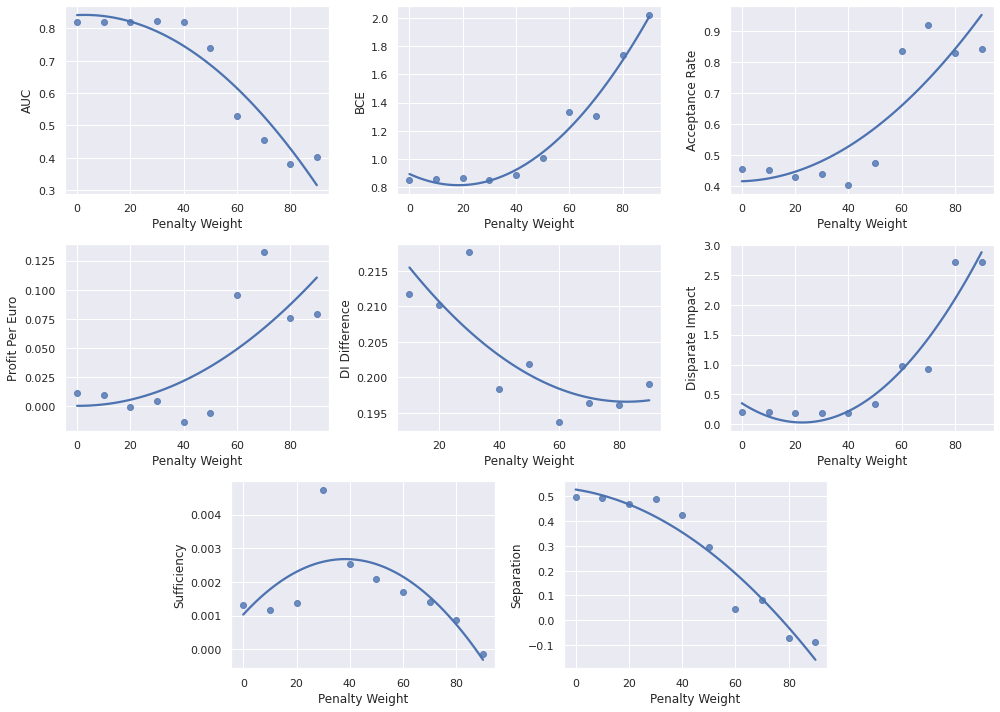

In [ ]:
# Plot all metrics

fig = plt.figure(figsize=(14,10))

plot1 = plt.subplot2grid((6, 6), (0, 0), rowspan=2, colspan=2)
plot2 = plt.subplot2grid((6, 6), (0, 2), rowspan=2, colspan=2)
plot3 = plt.subplot2grid((6, 6), (0, 4), rowspan=2, colspan=2)
plot4 = plt.subplot2grid((6, 6), (2, 0), rowspan=2, colspan=2)
plot5 = plt.subplot2grid((6, 6), (2, 2), rowspan=2, colspan=2)
plot6 = plt.subplot2grid((6, 6), (2, 4), rowspan=2, colspan=2)
plot7 = plt.subplot2grid((6, 6), (4, 1), rowspan=2, colspan=2)
plot8 = plt.subplot2grid((6, 6), (4, 3), rowspan=2, colspan=2)

plot1 = sns.regplot(x="Penalty Weight",y="AUC", data=test_1_metrics, order = 2, ax=plot1, ci=None)

plot2 = sns.regplot(x="Penalty Weight",y="BCE", data=test_1_metrics, order = 2, ax=plot2, ci=None)

plot3 = sns.regplot(x="Penalty Weight",y="Acceptance Rate", data=test_1_metrics, order = 2, ax=plot3, ci=None)

plot4 = sns.regplot(x="Penalty Weight",y="Profit Per Euro", data=test_1_metrics, order = 2, ax=plot4, ci=None)

plot5 = sns.regplot(x="Penalty Weight",y="DI Difference", data=test_1_metrics, order = 2, ax=plot5, ci=None)

plot6 = sns.regplot(x="Penalty Weight",y="Disparate Impact", data=test_1_metrics, order = 2, ax=plot6, ci=None)

plot7 = sns.regplot(x="Penalty Weight",y="Predictive Parity Difference (Sufficiency)", data=test_1_metrics, order = 2, ax=plot7, ci=None)
plot7.set(xlabel='Penalty Weight', ylabel='Sufficiency')

plot8 = sns.regplot(x="Penalty Weight",y="Average Odds Difference (Separation)", data=test_1_metrics, order = 2, ax=plot8, ci=None)
plot8.set(xlabel='Penalty Weight', ylabel='Separation')

plt.tight_layout()
plt.show()
fig.savefig("Alternative Loss 1",dpi=300)

## Equation 17

In [ ]:
# Reformulation of the Loss Function as in Equation 17 in the Paper

def CustomLoss_2(priv):
  '''Wrapper function for the custom loss, that allows inputs in addition to y_true and y_pred.'''

  def binary_crossentropy_adjusted_groupspecific(y_true, y_pred):
    '''Calculates the binary cross-entropy and adds to it a penalty for predicitions in the unprivileged class that decrease the average delayed impact based on Liu et al. (2018).'''

    # Binary tensor that is 1 for predictions smaller than tau
    temp = tf.subtract(y_pred, tau)
    temp = K.relu(temp)
    less_than_tau = tf.multiply((tf.subtract(K.sign(temp), 1.0)), -1.0)

    # Inversion of the priviledged tensor
    temp = tf.subtract(priv, 1.0)
    unpriv = tf.multiply(temp, -1.0)

    # Inversion of the true label tensor
    temp = tf.subtract(y_true, 1.0)
    inverted_y_true = tf.multiply(temp, -1.0)

    # Create a tensor with the individual gain for all true negatives
    gains = tf.multiply(tf.multiply(less_than_tau, unpriv), tf.multiply(inverted_y_true, gain))

    # Create tensor with the individual loss for all false negatives
    losses = tf.multiply(tf.multiply(less_than_tau, unpriv), tf.multiply(y_true, loss))

    # Concatenate the penalty tensors and calculate their mean
    bce = K.mean(K.binary_crossentropy(y_true, y_pred))
    penalty = K.mean(K.concatenate([gains, losses], axis=0))
    
    # Equation 17
    final_loss = bce / (K.mean(K.concatenate([gains, losses], axis=0)) + K.epsilon())

    return final_loss

  # Return the loss function
  return binary_crossentropy_adjusted_groupspecific

In [ ]:
test_2_metrics = rep_test_loop(loss_function=CustomLoss_2, lower_bound=0.000000,upper_bound=0.00001,interval=0.000001,input_features=9,num_hid_units_1=10,num_hid_units_2=15,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 0.0
The current loss parameter is: -0.0
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 2s 20us/sample - loss: 1475462306.9320 - binary_crossentropy: 147.5463 - auc: 0.6167 - val_loss: 7537016.1563 - val_binary_crossentropy: 0.7537 - val_auc: 0.7562
Epoch 2/50
108502/108502 [==============================] - 3s 26us/sample - loss: 5870640.6017 - binary_crossentropy: 0.5871 - auc: 0.7515 - val_loss: 4421417.4288 - val_binary_crossentropy: 0.4421 - val_auc: 0.8099
Epoch 3/50
108502/108502 [==============================] - 3s 27us/sample - loss: 5735986.1168 - binary_crossentropy: 0.5736 - auc: 0.7696 - val_loss: 5858369.7987 - val_binary_crossentropy: 0.5858 - val_auc: 0.8030
Epoch 4/50
108502/108502 [==============================] - 3s 29us/sample - loss: 5581645.9727 - binary_crossentropy: 0.5582 - auc: 0.7857 - val_loss: 4976445.0376 - val_binary_crossentropy: 0.4976

1it [09:46, 586.86s/it]

Penalty Weight                                           0.0
AUC                                                 0.821025
MSE                                                 0.155745
BCE                                                 0.853871
Profit                                        2435139.143403
Profit Per Euro                                     0.011587
DI Difference                                            NaN
Mean DI Privileged                                       NaN
Mean DI Unprivileged                                     NaN
Disparate Impact                                    0.201119
Average Odds Difference (Separation)                0.495717
Predictive Parity Difference (Sufficiency)          0.001534
Acceptance Rate                                      0.45438
Name: 0, dtype: object

The current gain parameter is: 1.36e-07
The current loss parameter is: -2.72e-07
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==

2it [20:00, 602.56s/it]

Penalty Weight                                     0.000001
AUC                                                0.821056
MSE                                                0.155941
BCE                                                0.853205
Profit                                        2343897.11666
Profit Per Euro                                    0.011153
DI Difference                                       0.21132
Mean DI Privileged                                 0.285767
Mean DI Unprivileged                               0.074447
Disparate Impact                                   0.200549
Average Odds Difference (Separation)               0.494696
Predictive Parity Difference (Sufficiency)         0.000627
Acceptance Rate                                    0.453513
Name: 1, dtype: object

The current gain parameter is: 2.72e-07
The current loss parameter is: -5.44e-07
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [===============

3it [30:49, 623.63s/it]

Penalty Weight                                      0.000002
AUC                                                 0.821101
MSE                                                 0.155865
BCE                                                 0.852214
Profit                                        2039256.299642
Profit Per Euro                                     0.009703
DI Difference                                       0.212153
Mean DI Privileged                                  0.285313
Mean DI Unprivileged                                 0.07316
Disparate Impact                                    0.198075
Average Odds Difference (Separation)                0.493715
Predictive Parity Difference (Sufficiency)          0.001296
Acceptance Rate                                     0.451033
Name: 2, dtype: object

The current gain parameter is: 4.0800000000000005e-07
The current loss parameter is: -8.160000000000001e-07
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
E

4it [42:24, 652.01s/it]

Penalty Weight                                       0.000003
AUC                                                   0.49988
MSE                                                  0.225153
BCE                                                  4.067815
Profit                                        30188708.488215
Profit Per Euro                                      0.143644
DI Difference                                         0.22422
Mean DI Privileged                                   0.274567
Mean DI Unprivileged                                 0.050347
Disparate Impact                                     1.000158
Average Odds Difference (Separation)                 -0.00008
Predictive Parity Difference (Sufficiency)           0.001801
Acceptance Rate                                      0.999813
Name: 3, dtype: object

The current gain parameter is: 5.44e-07
The current loss parameter is: -1.088e-06
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108

5it [54:15, 673.18s/it]

Penalty Weight                                      0.000004
AUC                                                 0.819669
MSE                                                 0.154083
BCE                                                 0.824395
Profit                                        1989478.670077
Profit Per Euro                                     0.009466
DI Difference                                       0.201553
Mean DI Privileged                                  0.280447
Mean DI Unprivileged                                0.078893
Disparate Impact                                    0.212858
Average Odds Difference (Separation)                0.487954
Predictive Parity Difference (Sufficiency)          0.002034
Acceptance Rate                                      0.45574
Name: 4, dtype: object

The current gain parameter is: 6.8e-07
The current loss parameter is: -1.36e-06
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [===

6it [1:06:56, 703.20s/it]

Penalty Weight                                       0.000005
AUC                                                   0.49988
MSE                                                  0.225153
BCE                                                  4.067815
Profit                                        30188708.488215
Profit Per Euro                                      0.143644
DI Difference                                         0.22422
Mean DI Privileged                                   0.274567
Mean DI Unprivileged                                 0.050347
Disparate Impact                                     1.000158
Average Odds Difference (Separation)                 -0.00008
Predictive Parity Difference (Sufficiency)           0.001801
Acceptance Rate                                      0.999813
Name: 5, dtype: object

The current gain parameter is: 8.160000000000001e-07
The current loss parameter is: -1.6320000000000002e-06
The current seed is: 1
Train on 108502 samples, validate on 30

7it [1:20:32, 739.89s/it]

Penalty Weight                                       0.000006
AUC                                                   0.49988
MSE                                                  0.225153
BCE                                                  4.067815
Profit                                        30188708.488215
Profit Per Euro                                      0.143644
DI Difference                                         0.22422
Mean DI Privileged                                   0.274567
Mean DI Unprivileged                                 0.050347
Disparate Impact                                     1.000158
Average Odds Difference (Separation)                 -0.00008
Predictive Parity Difference (Sufficiency)           0.001801
Acceptance Rate                                      0.999813
Name: 6, dtype: object

The current gain parameter is: 9.520000000000001e-07
The current loss parameter is: -1.9040000000000001e-06
The current seed is: 1
Train on 108502 samples, validate on 30

8it [1:35:27, 789.45s/it]

Penalty Weight                                       0.000007
AUC                                                   0.49988
MSE                                                  0.225153
BCE                                                  4.067815
Profit                                        30188708.488215
Profit Per Euro                                      0.143644
DI Difference                                         0.22422
Mean DI Privileged                                   0.274567
Mean DI Unprivileged                                 0.050347
Disparate Impact                                     1.000158
Average Odds Difference (Separation)                 -0.00008
Predictive Parity Difference (Sufficiency)           0.001801
Acceptance Rate                                      0.999813
Name: 7, dtype: object

The current gain parameter is: 1.088e-06
The current loss parameter is: -2.176e-06
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
10

9it [1:51:42, 847.28s/it]

Penalty Weight                                       0.000008
AUC                                                   0.49988
MSE                                                  0.225153
BCE                                                  4.067815
Profit                                        30188708.488215
Profit Per Euro                                      0.143644
DI Difference                                         0.22422
Mean DI Privileged                                   0.274567
Mean DI Unprivileged                                 0.050347
Disparate Impact                                     1.000158
Average Odds Difference (Separation)                 -0.00008
Predictive Parity Difference (Sufficiency)           0.001801
Acceptance Rate                                      0.999813
Name: 8, dtype: object

The current gain parameter is: 1.224e-06
The current loss parameter is: -2.448e-06
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
10

10it [2:08:47, 902.36s/it]

Penalty Weight                                       0.000009
AUC                                                   0.49988
MSE                                                  0.225153
BCE                                                  4.067815
Profit                                        30188708.488215
Profit Per Euro                                      0.143644
DI Difference                                         0.22422
Mean DI Privileged                                   0.274567
Mean DI Unprivileged                                 0.050347
Disparate Impact                                     1.000158
Average Odds Difference (Separation)                 -0.00008
Predictive Parity Difference (Sufficiency)           0.001801
Acceptance Rate                                      0.999813
Name: 9, dtype: object

The current gain parameter is: 1.36e-06
The current loss parameter is: -2.72e-06
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
1085

11it [2:27:12, 802.95s/it]

Penalty Weight                                        0.00001
AUC                                                   0.49988
MSE                                                  0.225153
BCE                                                  4.067815
Profit                                        30188708.488215
Profit Per Euro                                      0.143644
DI Difference                                         0.22422
Mean DI Privileged                                   0.274567
Mean DI Unprivileged                                 0.050347
Disparate Impact                                     1.000158
Average Odds Difference (Separation)                 -0.00008
Predictive Parity Difference (Sufficiency)           0.001801
Acceptance Rate                                      0.999813
Name: 10, dtype: object


In [ ]:
test_2_metrics = test_2_metrics.astype('float64')

In [ ]:
test_2_metrics.to_csv('test_2_metrics.csv')

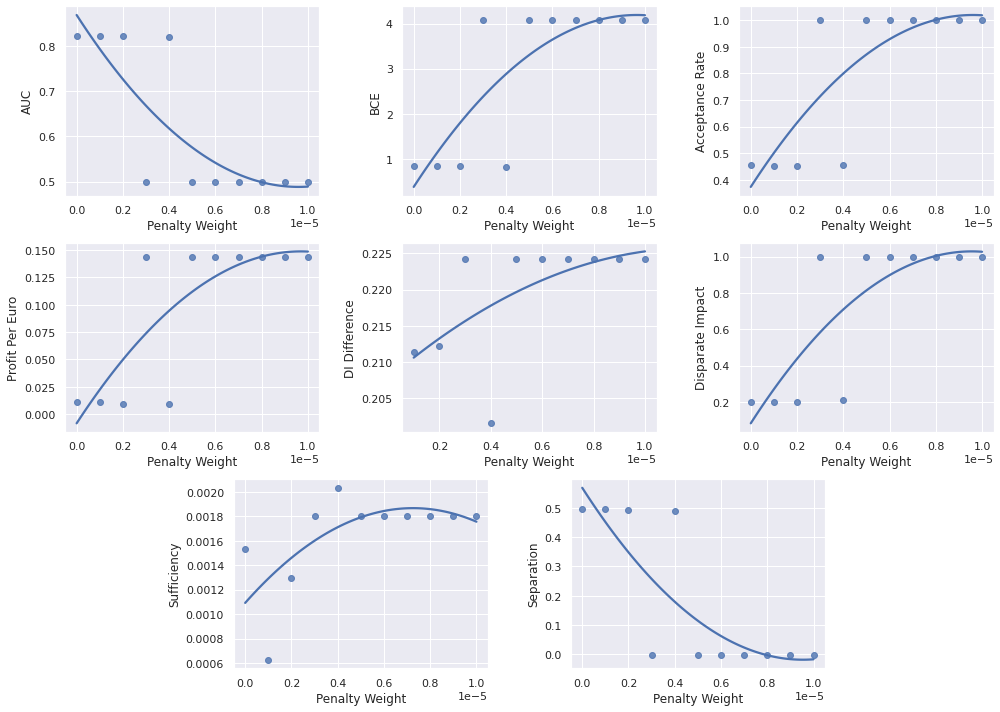

In [ ]:
# Plot all metrics

fig = plt.figure(figsize=(14,10))

plot1 = plt.subplot2grid((6, 6), (0, 0), rowspan=2, colspan=2)
plot2 = plt.subplot2grid((6, 6), (0, 2), rowspan=2, colspan=2)
plot3 = plt.subplot2grid((6, 6), (0, 4), rowspan=2, colspan=2)
plot4 = plt.subplot2grid((6, 6), (2, 0), rowspan=2, colspan=2)
plot5 = plt.subplot2grid((6, 6), (2, 2), rowspan=2, colspan=2)
plot6 = plt.subplot2grid((6, 6), (2, 4), rowspan=2, colspan=2)
plot7 = plt.subplot2grid((6, 6), (4, 1), rowspan=2, colspan=2)
plot8 = plt.subplot2grid((6, 6), (4, 3), rowspan=2, colspan=2)

plot1 = sns.regplot(x="Penalty Weight",y="AUC", data=test_2_metrics, order = 2, ax=plot1, ci=None)

plot2 = sns.regplot(x="Penalty Weight",y="BCE", data=test_2_metrics, order = 2, ax=plot2, ci=None)

plot3 = sns.regplot(x="Penalty Weight",y="Acceptance Rate", data=test_2_metrics, order = 2, ax=plot3, ci=None)

plot4 = sns.regplot(x="Penalty Weight",y="Profit Per Euro", data=test_2_metrics, order = 2, ax=plot4, ci=None)

plot5 = sns.regplot(x="Penalty Weight",y="DI Difference", data=test_2_metrics, order = 2, ax=plot5, ci=None)

plot6 = sns.regplot(x="Penalty Weight",y="Disparate Impact", data=test_2_metrics, order = 2, ax=plot6, ci=None)

plot7 = sns.regplot(x="Penalty Weight",y="Predictive Parity Difference (Sufficiency)", data=test_2_metrics, order = 2, ax=plot7, ci=None)
plot7.set(xlabel='Penalty Weight', ylabel='Sufficiency')

plot8 = sns.regplot(x="Penalty Weight",y="Average Odds Difference (Separation)", data=test_2_metrics, order = 2, ax=plot8, ci=None)
plot8.set(xlabel='Penalty Weight', ylabel='Separation')

plt.tight_layout()
plt.show()
fig.savefig("Alternative Loss 2",dpi=300)

## Equation 18

In [ ]:
# Reformulation of the Loss Function as in Equation 18 in the Paper

def CustomLoss_3(priv):
  '''Wrapper function for the custom loss, that allows inputs in addition to y_true and y_pred.'''

  def binary_crossentropy_adjusted_groupspecific(y_true, y_pred):
    '''Calculates the binary cross-entropy and adds to it a penalty for predicitions in the unprivileged class that decrease the average delayed impact based on Liu et al. (2018).'''

    # Binary tensor that is 1 for predictions smaller than tau
    temp = tf.subtract(y_pred, tau)
    temp = K.relu(temp)
    less_than_tau = tf.multiply((tf.subtract(K.sign(temp), 1.0)), -1.0)

    # Inversion of the priviledged tensor
    temp = tf.subtract(priv, 1.0)
    unpriv = tf.multiply(temp, -1.0)

    # Inversion of the true label tensor
    temp = tf.subtract(y_true, 1.0)
    inverted_y_true = tf.multiply(temp, -1.0)

    # Create a tensor with the individual gain for all true negatives
    gains = tf.multiply(tf.multiply(less_than_tau, unpriv), tf.multiply(inverted_y_true, gain))

    # Create tensor with the individual loss for all false negatives
    losses = tf.multiply(tf.multiply(less_than_tau, unpriv), tf.multiply(y_true, loss))

    # Concatenate the penalty tensors and calculate their mean
    bce = K.mean(K.binary_crossentropy(y_true, y_pred))
    penalty = K.mean(K.concatenate([gains, losses], axis=0))

    final_loss = bce - tf.multiply(penalty, tf.divide(bce, (bce+ tf.multiply(bce, tf.keras.backend.epsilon()))))

    # Return result
    return final_loss

  # Return the loss function
  return binary_crossentropy_adjusted_groupspecific

In [ ]:
test_3_metrics = rep_test_loop(loss_function=CustomLoss_3, lower_bound=0,upper_bound=100,interval=10,input_features=9,num_hid_units_1=10,num_hid_units_2=15,batch_size=128,learning_rate=0.0001,epochs=50)

0it [00:00, ?it/s]


The current gain parameter is: 0.0
The current loss parameter is: -0.0
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==============================] - 4s 36us/sample - loss: 147.5462 - binary_crossentropy: 147.5462 - auc: 0.6167 - val_loss: 0.7537 - val_binary_crossentropy: 0.7537 - val_auc: 0.7562
Epoch 2/50
108502/108502 [==============================] - 3s 29us/sample - loss: 0.5870 - binary_crossentropy: 0.5870 - auc: 0.7515 - val_loss: 0.4421 - val_binary_crossentropy: 0.4421 - val_auc: 0.8099
Epoch 3/50
108502/108502 [==============================] - 4s 36us/sample - loss: 0.5736 - binary_crossentropy: 0.5736 - auc: 0.7696 - val_loss: 0.5860 - val_binary_crossentropy: 0.5860 - val_auc: 0.8030
Epoch 4/50
108502/108502 [==============================] - 5s 42us/sample - loss: 0.5581 - binary_crossentropy: 0.5581 - auc: 0.7857 - val_loss: 0.4979 - val_binary_crossentropy: 0.4979 - val_auc: 0.8144
Epoch 5/50
108502/108502 [====

1it [10:31, 631.36s/it]

Penalty Weight                                             0
AUC                                                 0.821016
MSE                                                 0.155699
BCE                                                  0.85381
Profit                                        2460611.371077
Profit Per Euro                                     0.011708
DI Difference                                            NaN
Mean DI Privileged                                       NaN
Mean DI Unprivileged                                     NaN
Disparate Impact                                    0.201457
Average Odds Difference (Separation)                0.495885
Predictive Parity Difference (Sufficiency)          0.001329
Acceptance Rate                                      0.45468
Name: 0, dtype: object

The current gain parameter is: 1.36
The current loss parameter is: -2.72
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==========

2it [20:38, 617.38s/it]

Penalty Weight                                            10
AUC                                                  0.82102
MSE                                                 0.155558
BCE                                                 0.853399
Profit                                        2486644.362991
Profit Per Euro                                     0.011832
DI Difference                                       0.210933
Mean DI Privileged                                   0.28594
Mean DI Unprivileged                                0.075007
Disparate Impact                                    0.201511
Average Odds Difference (Separation)                0.496334
Predictive Parity Difference (Sufficiency)          0.001192
Acceptance Rate                                     0.454967
Name: 1, dtype: object

The current gain parameter is: 2.72
The current loss parameter is: -5.44
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==========

3it [31:08, 623.14s/it]

Penalty Weight                                            20
AUC                                                 0.821025
MSE                                                 0.155609
BCE                                                 0.853478
Profit                                        2457133.476759
Profit Per Euro                                     0.011692
DI Difference                                       0.210993
Mean DI Privileged                                  0.285853
Mean DI Unprivileged                                 0.07486
Disparate Impact                                    0.201224
Average Odds Difference (Separation)                0.496265
Predictive Parity Difference (Sufficiency)          0.001447
Acceptance Rate                                     0.454673
Name: 2, dtype: object

The current gain parameter is: 4.08
The current loss parameter is: -8.16
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [==========

4it [42:19, 641.66s/it]

Penalty Weight                                            30
AUC                                                 0.821032
MSE                                                 0.155612
BCE                                                 0.853398
Profit                                        2449565.411061
Profit Per Euro                                     0.011655
DI Difference                                        0.21124
Mean DI Privileged                                  0.286013
Mean DI Unprivileged                                0.074773
Disparate Impact                                     0.20102
Average Odds Difference (Separation)                0.495906
Predictive Parity Difference (Sufficiency)           0.00127
Acceptance Rate                                     0.454487
Name: 3, dtype: object

The current gain parameter is: 5.44
The current loss parameter is: -10.88
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=========

5it [54:09, 666.32s/it]

Penalty Weight                                            40
AUC                                                 0.821026
MSE                                                 0.155605
BCE                                                 0.853458
Profit                                        2457623.981895
Profit Per Euro                                     0.011694
DI Difference                                        0.21104
Mean DI Privileged                                   0.28588
Mean DI Unprivileged                                 0.07484
Disparate Impact                                    0.201174
Average Odds Difference (Separation)                0.496265
Predictive Parity Difference (Sufficiency)          0.001571
Acceptance Rate                                      0.45466
Name: 4, dtype: object

The current gain parameter is: 6.800000000000001
The current loss parameter is: -13.600000000000001
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/5

6it [1:09:05, 744.48s/it]

Penalty Weight                                            50
AUC                                                 0.821035
MSE                                                 0.155689
BCE                                                 0.853519
Profit                                        2416530.459875
Profit Per Euro                                     0.011498
DI Difference                                       0.211253
Mean DI Privileged                                  0.285893
Mean DI Unprivileged                                 0.07464
Disparate Impact                                    0.200772
Average Odds Difference (Separation)                0.495778
Predictive Parity Difference (Sufficiency)          0.001553
Acceptance Rate                                     0.454173
Name: 5, dtype: object

The current gain parameter is: 8.16
The current loss parameter is: -16.32
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [=========

7it [1:22:29, 763.97s/it]

Penalty Weight                                            60
AUC                                                 0.821027
MSE                                                 0.155596
BCE                                                 0.853411
Profit                                        2459389.505504
Profit Per Euro                                     0.011702
DI Difference                                        0.21114
Mean DI Privileged                                  0.285973
Mean DI Unprivileged                                0.074833
Disparate Impact                                     0.20118
Average Odds Difference (Separation)                0.496028
Predictive Parity Difference (Sufficiency)          0.001257
Acceptance Rate                                     0.454627
Name: 6, dtype: object

The current gain parameter is: 9.520000000000001
The current loss parameter is: -19.040000000000003
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/5

8it [1:36:19, 785.16s/it]

Penalty Weight                                            70
AUC                                                  0.82102
MSE                                                 0.155563
BCE                                                  0.85341
Profit                                        2480974.138359
Profit Per Euro                                     0.011805
DI Difference                                       0.210953
Mean DI Privileged                                  0.285927
Mean DI Unprivileged                                0.074973
Disparate Impact                                    0.201438
Average Odds Difference (Separation)                0.496366
Predictive Parity Difference (Sufficiency)           0.00128
Acceptance Rate                                      0.45492
Name: 7, dtype: object

The current gain parameter is: 10.88
The current loss parameter is: -21.76
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [========

9it [1:50:51, 812.09s/it]

Penalty Weight                                            80
AUC                                                 0.821023
MSE                                                 0.155578
BCE                                                 0.853409
Profit                                        2475582.887852
Profit Per Euro                                     0.011779
DI Difference                                        0.21098
Mean DI Privileged                                  0.285927
Mean DI Unprivileged                                0.074947
Disparate Impact                                    0.201406
Average Odds Difference (Separation)                0.496226
Predictive Parity Difference (Sufficiency)          0.001341
Acceptance Rate                                     0.454833
Name: 8, dtype: object

The current gain parameter is: 12.24
The current loss parameter is: -24.48
The current seed is: 1
Train on 108502 samples, validate on 30000 samples
Epoch 1/50
108502/108502 [========

10it [2:05:53, 755.39s/it]

Penalty Weight                                            90
AUC                                                 0.821031
MSE                                                 0.155632
BCE                                                 0.853438
Profit                                        2443970.906699
Profit Per Euro                                     0.011629
DI Difference                                       0.211233
Mean DI Privileged                                  0.285993
Mean DI Unprivileged                                 0.07476
Disparate Impact                                    0.201006
Average Odds Difference (Separation)                0.495842
Predictive Parity Difference (Sufficiency)          0.001293
Acceptance Rate                                     0.454433
Name: 9, dtype: object


In [ ]:
test_3_metrics = test_3_metrics.astype('float64')

In [ ]:
test_3_metrics.to_csv('test_3_metrics.csv')

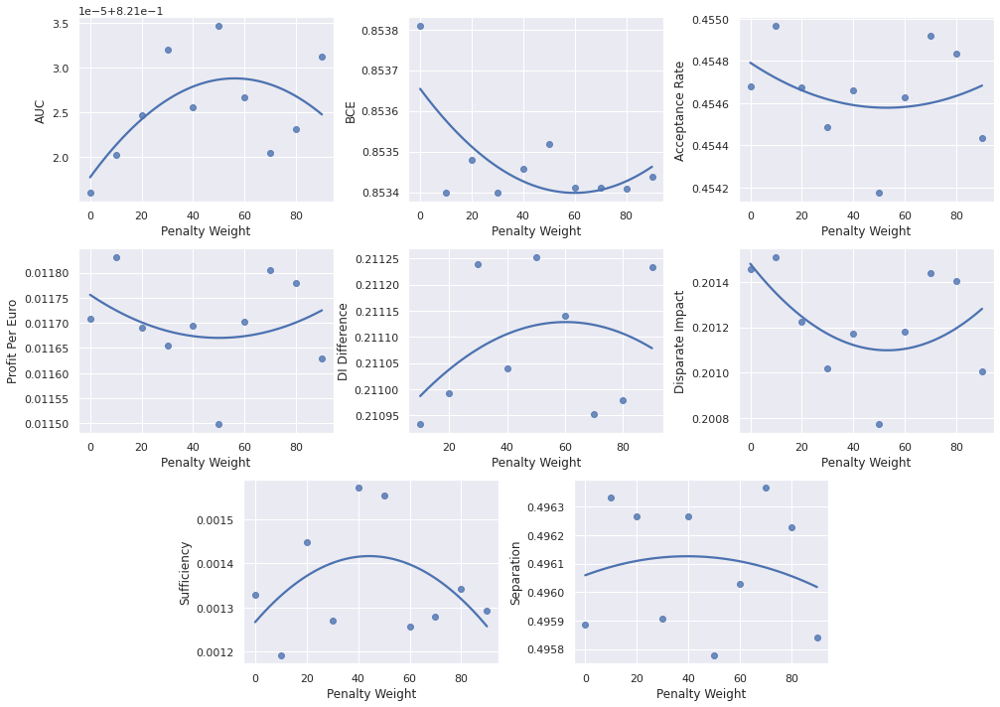

In [ ]:
# Plot all metrics

fig = plt.figure(figsize=(14,10))

plot1 = plt.subplot2grid((6, 6), (0, 0), rowspan=2, colspan=2)
plot2 = plt.subplot2grid((6, 6), (0, 2), rowspan=2, colspan=2)
plot3 = plt.subplot2grid((6, 6), (0, 4), rowspan=2, colspan=2)
plot4 = plt.subplot2grid((6, 6), (2, 0), rowspan=2, colspan=2)
plot5 = plt.subplot2grid((6, 6), (2, 2), rowspan=2, colspan=2)
plot6 = plt.subplot2grid((6, 6), (2, 4), rowspan=2, colspan=2)
plot7 = plt.subplot2grid((6, 6), (4, 1), rowspan=2, colspan=2)
plot8 = plt.subplot2grid((6, 6), (4, 3), rowspan=2, colspan=2)

plot1 = sns.regplot(x="Penalty Weight",y="AUC", data=test_3_metrics, order = 2, ax=plot1, ci=None)

plot2 = sns.regplot(x="Penalty Weight",y="BCE", data=test_3_metrics, order = 2, ax=plot2, ci=None)

plot3 = sns.regplot(x="Penalty Weight",y="Acceptance Rate", data=test_3_metrics, order = 2, ax=plot3, ci=None)

plot4 = sns.regplot(x="Penalty Weight",y="Profit Per Euro", data=test_3_metrics, order = 2, ax=plot4, ci=None)

plot5 = sns.regplot(x="Penalty Weight",y="DI Difference", data=test_3_metrics, order = 2, ax=plot5, ci=None)

plot6 = sns.regplot(x="Penalty Weight",y="Disparate Impact", data=test_3_metrics, order = 2, ax=plot6, ci=None)

plot7 = sns.regplot(x="Penalty Weight",y="Predictive Parity Difference (Sufficiency)", data=test_3_metrics, order = 2, ax=plot7, ci=None)
plot7.set(xlabel='Penalty Weight', ylabel='Sufficiency')

plot8 = sns.regplot(x="Penalty Weight",y="Average Odds Difference (Separation)", data=test_3_metrics, order = 2, ax=plot8, ci=None)
plot8.set(xlabel='Penalty Weight', ylabel='Separation')

plt.tight_layout()
plt.show()
fig.savefig("Alternative Loss 3",dpi=300)